# CZ4046 Assignment 1 Part 2

## Experiment 3

### Import required libraries

In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt

### Define grid

In [2]:
class Grid:
    def __init__(self, width, height, start):
        self.width = width
        self.height = height
        self.i = start[0]
        self.j = start[1]
        
    def set(self, rewards, actions):  
        self.rewards = rewards
        self.actions = actions 
    
    def set_state(self, s):
        self.i = s[0]
        self.j = s[1]
        
    def current_state(self):
        return (self.i, self.j)

    def is_terminal(self, s):
        return s not in self.actions
    
    def move(self, action):
        if action in self.actions[(self.i, self.j)]:
            if action == 'U':
                self.i -= 1
            elif action == 'D':
                self.i += 1
            elif action == 'R':
                self.j += 1
            elif action == 'L':
                self.j -= 1
        
        else:
            pass
        
        return self.rewards.get((self.i, self.j), 0)
    
    def undo_move(self, action):
        if action == 'U':
            self.i += 1
        elif action == 'D':
            self.i -= 1
        elif action == 'R':
            self.j -= 1
        elif action == 'L':
            self.j += 1
            
        assert(self.current_state() in self.all_states())
    
    def end_game(self):
        return (self.i, self.j) not in self.actions
    
    def all_states(self):
        return set(list(self.actions.keys()) + list(self.rewards.keys()))
    
def stand_grid():    
    grid = Grid(6, 6, (3, 2))
    rewards = {(0,0):1, (0,2):1, (1,3):1, (2,4):1, (1,1):-1, (1,5):-1, (2,2):-1, (3,3):-1, (4,4):-1}
    actions = {
        (0,0): ('D'),
        (0,2): ('R', 'D'),
        (0,3): ('R', 'D', 'L'),
        (0,4): ('R', 'L'),
        (0,5): ('D', 'L'),
        (1,0): ('U', 'R', 'D'),
        (1,1): ('R', 'D', 'L'),
        (1,2): ('U', 'R', 'D', 'L'),
        (1,3): ('U', 'D', 'L'),
        (1,5): ('U', 'D'),
        (2,0): ('U', 'R', 'D'),
        (2,1): ('U', 'R', 'D', 'L'),
        (2,2): ('U', 'R', 'D', 'L'),
        (2,3): ('U', 'R', 'D', 'L'),
        (2,4): ('R', 'D', 'L'),
        (2,5): ('U', 'D', 'L'),
        (3,0): ('U', 'R', 'D'),
        (3,1): ('U', 'R', 'L'),
        (3,2): ('U', 'R', 'L'),
        (3,3): ('U', 'R', 'L'),
        (3,4): ('U', 'R', 'D', 'L'),
        (3,5): ('U', 'D', 'L'),
        (4,0): ('U', 'D'),
        (4,4): ('U', 'R', 'D'),
        (4,5): ('U', 'D', 'L'),
        (5,0): ('U', 'R'),
        (5,1): ('R', 'L'),
        (5,2): ('R', 'L'),
        (5,3): ('R', 'L'),
        (5,4): ('U', 'R', 'L'),
        (5,5): ('U', 'L')           
    }
    grid.set(rewards, actions)
    return grid

def negative_grid(step_cost=-0.04):
    grid = stand_grid()
    grid.rewards.update({
        (0,3): step_cost,
        (0,4): step_cost,
        (0,5): step_cost,
        (1,0): step_cost,
        (1,2): step_cost,
        (2,0): step_cost,
        (2,1): step_cost,
        (2,3): step_cost,
        (2,5): step_cost,
        (3,0): step_cost,
        (3,1): step_cost,
        (3,2): step_cost,
        (3,4): step_cost,
        (3,5): step_cost,
        (4,0): step_cost,
        (4,5): step_cost,
        (5,0): step_cost,
        (5,1): step_cost,
        (5,2): step_cost,
        (5,3): step_cost,
        (5,4): step_cost,
        (5,5): step_cost,     
    })
    return grid

def start_game(agent, env):
    pass

### Print utility values

In [3]:
hist = []

def print_values(f, V, g):
    for i in range(g.width):
        
        if f == True:
            print("+----------+------------+------------+------------+------------+------------+")
        
        for j in range(g.height):
            v = V.get((i,j), 0)
            
            if f == True:
                print(f' {v:^9.5f} |', end = ' ')
                    
            hist.append(v)
        
        if f == True:        
            print ("")
    if f == True:
        print("+----------+------------+------------+------------+------------+------------+")

### Print policy

In [4]:
def print_policy(P, g):
    for i in range(g.width):
        print("+------+--------+--------+--------+--------+--------+")
        
        for j in range(g.height):
            a = P.get((i,j), ' ')
            print('   {}   |'.format(a), end = ' ')

        print ("")
    print("+------+--------+--------+--------+--------+--------+")

### Value Iteration

In [5]:
SMALL_ENOUGH = 10e-4
GAMMA = 0.99
ALL_POSSIBLE_ACTIONS = ('U', 'D', 'L', 'R')

In [6]:
if __name__ == '__main__':
    grid = negative_grid()

    policy = {}
    for s in grid.actions.keys():
        policy[s] = np.random.choice(ALL_POSSIBLE_ACTIONS)
    
    hist = []
    
    V = {}
    states = grid.all_states()
    
    for s in states:
        
        if s in grid.actions:
            V[s] = 0
        
        else:
            V[s] = 0

    iter_no = 0
    
    while True:
        iter_no = iter_no + 1
        print("Iteration " + str(iter_no) + " :: ")
        biggest_change = 0
        
        for s in states: 
            old_v = V[s]
            
            if s in policy: 
                new_v = float('-inf')
                
                for a in ALL_POSSIBLE_ACTIONS:
                    grid.set_state(s)
                    r = grid.rewards.get(grid.current_state(), 0)
                    _ = grid.move(a)
                    v_correct = V[grid.current_state()]
                    grid.set_state(s)
                    
                    if a == 'U':
                        r_clockwise = grid.move('R')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('L')
                    
                    elif a == 'R':
                        r_clockwise = grid.move('D')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('U')
                    
                    elif a == 'D':
                        r_clockwise = grid.move('L')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('R')
                    
                    elif a == 'L':
                        r_clockwise = grid.move('U')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('D')
                        
                    v_anticlockwise = V[grid.current_state()]  
                    v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    
                    if v > new_v:
                        new_v = v
                
                V[s] = new_v
                biggest_change = max(biggest_change, np.abs(old_v - V[s]))
                
                print('Utilities:')
                print_values(True, V, grid)
                print('\n')
                                
        if biggest_change < SMALL_ENOUGH:
            break
               
    for s in policy.keys():
        best_a = None
        best_value = float('-inf')
        
        for a in ALL_POSSIBLE_ACTIONS:
            
            grid.set_state(s)
            r = grid.rewards.get(grid.current_state(), 0)    
            _ = grid.move(a)
            v_correct = V[grid.current_state()]      
            grid.set_state(s)
            
            if a == 'U':
                r_clockwise = grid.move('R')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('L')
                
            elif a == 'R':
                r_clockwise = grid.move('D')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('U')
                
            elif a == 'D':
                r_clockwise = grid.move('L')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('R')
                
            elif a == 'L':
                r_clockwise = grid.move('U')
                v_clockwise = V[grid.current_state()]
                grid.set_state(s)
                r_anticlockwise = grid.move('D')
                        
            v_anticlockwise = V[grid.current_state()] 
            v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
            
            if v > best_value:
                best_value = v
                best_a = a
        
        policy[s] = best_a
        
    print('Optimal Utilities:')
    print_values(True, V, grid)
    print('\n')
    print('Optimal Policy:')
    print_policy(policy, grid)
    print('\n')

Iteration 1 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   1.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------------+------------+------------+------------+
  0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  |   0.00000  | 
+----------+------------+------

  0.52575  |   0.33866  |  -0.32997  |   0.71933  |   1.55548  |   1.08816  | 
+----------+------------+------------+------------+------------+------------+
  0.36737  |  -0.05115  |  -0.07267  |  -1.00000  |  -0.14378  |  -0.04831  | 
+----------+------------+------------+------------+------------+------------+
  0.24304  |   0.00000  |   0.00000  |   0.00000  |  -1.00000  |  -0.04396  | 
+----------+------------+------------+------------+------------+------------+
 -0.04396  |  -0.07960  |  -0.04000  |  -0.04831  |  -0.04396  |  -0.04000  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  1.00000  |   0.00000  |   1.97525  |   1.80145  |   0.63399  |   0.36312  | 
+----------+------------+------------+------------+------------+------------+
  0.71933  |  -0.32997  |   1.68453  |   1.94746  |   0.00000  |  -1.00000  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
  1.99000  |   0.00000  |   1.97525  |   1.80145  |   1.51227  |   1.16039  | 
+----------+------------+------------+------------+------------+------------+
  1.64046  |   0.33501  |   1.68453  |   1.94746  |   0.00000  |  -0.33618  | 
+----------+------------+------------+------------+------------+------------+
  0.52575  |   0.33866  |   0.43889  |   1.69983  |   1.55548  |   1.08816  | 
+----------+------------+------------+------------+------------+------------+
  0.36737  |   0.29012  |   0.25782  |  -0.45172  |  -0.14378  |   0.80280  | 
+----------+------------+------------+------------+------------+------------+
  0.24304  |   0.00000  |   0.00000  |   0.00000  |  -1.05340  |  -0.08752  | 
+----------+------------+------------+------------+------------+------------+
  0.14025  |  -0.07960  |  -0.08434  |  -0.09528  |  -0.08752  |  -0.07999  | 
+----------+------------+------------+---------

  1.34482  |   1.08699  |   1.34009  |   2.64032  |   2.62170  |   2.08258  | 
+----------+------------+------------+------------+------------+------------+
  1.09019  |   0.29012  |   1.09890  |   0.49323  |   1.22670  |   1.81033  | 
+----------+------------+------------+------------+------------+------------+
  0.87155  |   0.00000  |   0.00000  |   0.00000  |  -0.14141  |   0.57316  | 
+----------+------------+------------+------------+------------+------------+
  0.66963  |   0.05532  |  -0.01289  |  -0.09528  |  -0.13062  |  -0.11994  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  2.97010  |   0.00000  |   2.93829  |   2.75148  |   2.43860  |   2.06395  | 
+----------+------------+------------+------------+------------+------------+
  2.59402  |   1.20497  |   2.60630  |   2.88902  |   0.00000  |   0.58284  | 
+----------+------------+------------+-------

  1.68234  |   0.00000  |   0.00000  |   0.00000  |   0.83618  |   1.53330  | 
+----------+------------+------------+------------+------------+------------+
  1.40833  |   0.50130  |   0.35448  |  -0.06907  |   0.65394  |   0.38913  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  3.94040  |   0.00000  |   3.89041  |   3.69197  |   3.36688  |   2.98076  | 
+----------+------------+------------+------------+------------+------------+
  3.54718  |   2.11692  |   3.53887  |   3.82189  |   0.00000  |   1.51375  | 
+----------+------------+------------+------------+------------+------------+
  2.25521  |   1.96814  |   2.25902  |   3.56449  |   3.57486  |   3.02821  | 
+----------+------------+------------+------------+------------+------------+
  1.95678  |   1.03761  |   1.99285  |   1.42410  |   2.26444  |   1.81033  | 
+----------+------------+------------+-------

  4.90100  |   0.00000  |   4.83186  |   4.62213  |   4.28737  |   3.89051  | 
+----------+------------+------------+------------+------------+------------+
  3.54718  |   3.03223  |   4.46620  |   4.74533  |   0.00000  |   2.42242  | 
+----------+------------+------------+------------+------------+------------+
  3.18748  |   2.88313  |   3.17554  |   3.56449  |   4.49435  |   3.94280  | 
+----------+------------+------------+------------+------------+------------+
  2.86727  |   1.90978  |   2.89553  |   2.33773  |   3.20569  |   2.76175  | 
+----------+------------+------------+------------+------------+------------+
  2.56398  |   0.00000  |   0.00000  |   0.00000  |   1.77348  |   2.47468  | 
+----------+------------+------------+------------+------------+------------+
  2.24639  |   1.17466  |   0.96052  |   0.46425  |   1.53705  |   1.27764  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

  3.78501  |   2.81395  |   3.79405  |   3.24028  |   4.11464  |   3.67347  | 
+----------+------------+------------+------------+------------+------------+
  3.46540  |   0.00000  |   0.00000  |   0.00000  |   2.67936  |   3.37964  | 
+----------+------------+------------+------------+------------+------------+
  3.12219  |   1.97172  |   1.71179  |   1.26926  |   2.42537  |   2.19860  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  5.85199  |   0.00000  |   5.76278  |   5.54197  |   5.19814  |   4.79000  | 
+----------+------------+------------+------------+------------+------------+
  4.49295  |   3.94110  |   5.38457  |   5.65917  |   0.00000  |   3.31225  | 
+----------+------------+------------+------------+------------+------------+
  4.11941  |   3.80134  |   4.08420  |   5.38086  |   5.39856  |   4.83916  | 
+----------+------------+------------+-------

  6.79347  |   0.00000  |   6.68329  |   6.45160  |   6.09890  |   5.67919  | 
+----------+------------+------------+------------+------------+------------+
  6.35723  |   4.84098  |   6.29312  |   6.56343  |   0.00000  |   4.18837  | 
+----------+------------+------------+------------+------------+------------+
  5.04451  |   4.71380  |   4.98352  |   6.27450  |   6.29191  |   5.72291  | 
+----------+------------+------------+------------+------------+------------+
  4.69835  |   3.72099  |   4.68450  |   4.13307  |   5.00825  |   5.44016  | 
+----------+------------+------------+------------+------------+------------+
  4.36724  |   0.00000  |   0.00000  |   0.00000  |   3.56637  |   4.26205  | 
+----------+------------+------------+------------+------------+------------+
  4.00744  |   2.82317  |   2.53489  |   2.99737  |   3.30201  |   3.09445  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

  6.35723  |   5.73125  |   7.19168  |   7.45812  |   0.00000  |   5.05351  | 
+----------+------------+------------+------------+------------+------------+
  5.96100  |   5.61797  |   5.87317  |   6.27450  |   7.17551  |   6.59623  | 
+----------+------------+------------+------------+------------+------------+
  5.60385  |   4.62223  |   5.56577  |   5.01637  |   5.89095  |   5.44016  | 
+----------+------------+------------+------------+------------+------------+
  5.26296  |   0.00000  |   0.00000  |   0.00000  |   4.44064  |   4.26205  | 
+----------+------------+------------+------------+------------+------------+
  4.89060  |   3.69288  |   2.53489  |   2.99737  |   3.30201  |   3.96880  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  7.72553  |   0.00000  |   7.59352  |   7.35113  |   6.98968  |   5.67919  | 
+----------+------------+------------+-------

  6.15052  |   0.00000  |   0.00000  |   0.00000  |   5.30453  |   5.13017  | 
+----------+------------+------------+------------+------------+------------+
  5.76727  |   4.56454  |   3.38667  |   3.85346  |   4.16664  |   4.82851  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  7.72553  |   0.00000  |   8.49359  |   8.24067  |   7.87057  |   6.55836  | 
+----------+------------+------------+------------+------------+------------+
  7.27538  |   6.61180  |   8.08030  |   8.34330  |   0.00000  |   5.90885  | 
+----------+------------+------------+------------+------------+------------+
  6.86842  |   6.51319  |   6.75311  |   7.15865  |   8.04965  |   7.45991  | 
+----------+------------+------------+------------+------------+------------+
  6.50057  |   5.51522  |   5.56577  |   5.89029  |   6.76392  |   6.30599  | 
+----------+------------+------------+-------

  8.64828  |   0.00000  |   9.38362  |   9.12033  |   7.87057  |   7.42774  | 
+----------+------------+------------+------------+------------+------------+
  8.18426  |   6.61180  |   8.95907  |   9.21902  |   0.00000  |   6.75487  | 
+----------+------------+------------+------------+------------+------------+
  7.76672  |   7.39934  |   7.62343  |   8.03336  |   8.91446  |   8.31429  | 
+----------+------------+------------+------------+------------+------------+
  7.38833  |   6.39932  |   6.43761  |   6.75487  |   7.62752  |   7.16217  | 
+----------+------------+------------+------------+------------+------------+
  7.02936  |   0.00000  |   0.00000  |   0.00000  |   6.15889  |   5.98738  | 
+----------+------------+------------+------------+------------+------------+
  6.63593  |   5.43146  |   4.24568  |   4.69938  |   5.02070  |   5.67708  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

  8.65594  |   8.27646  |   7.62343  |   8.89872  |   9.77002  |   9.15949  | 
+----------+------------+------------+------------+------------+------------+
  8.26712  |   7.27442  |   7.30002  |   7.61019  |   8.48189  |   8.00909  | 
+----------+------------+------------+------------+------------+------------+
  7.89937  |   0.00000  |   0.00000  |   0.00000  |   7.00404  |   6.83492  | 
+----------+------------+------------+------------+------------+------------+
  6.63593  |   6.29108  |   5.10236  |   5.53565  |   5.86511  |   6.51594  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
  9.56179  |   0.00000  |  10.26371  |   9.99022  |   8.74168  |   8.28749  | 
+----------+------------+------------+------------+------------+------------+
  9.08397  |   7.48269  |   9.82810  |  10.08535  |   0.00000  |   7.59178  | 
+----------+------------+------------+-------

  9.53618  |   9.14462  |   9.33552  |   9.75477  |  10.61639  |   9.99561  | 
+----------+------------+------------+------------+------------+------------+
  9.13701  |   8.14055  |   8.99682  |   8.45631  |   9.32711  |   8.84692  | 
+----------+------------+------------+------------+------------+------------+
  8.76059  |   0.00000  |   0.00000  |   0.00000  |   7.84013  |   7.67326  | 
+----------+------------+------------+------------+------------+------------+
  8.34761  |   7.14253  |   5.95281  |   6.36270  |   6.70031  |   7.34563  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 11.36151  |   0.00000  |  11.13400  |  10.85045  |  10.45498  |   9.13771  | 
+----------+------------+------------+------------+------------+------------+
  9.97458  |   9.19586  |  10.68748  |  10.94235  |   0.00000  |   8.41970  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
  8.34761  |   7.98553  |   6.79554  |   7.18081  |   7.52650  |   7.34563  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 11.36151  |   0.00000  |  11.99459  |  11.70113  |  10.45498  |   9.97852  | 
+----------+------------+------------+------------+------------+------------+
 10.85619  |   9.19586  |  11.53733  |  11.79009  |   0.00000  |   8.41970  | 
+----------+------------+------------+------------+------------+------------+
 10.40750  |  10.00391  |   9.33552  |  10.60158  |  11.45364  |  10.82273  | 
+----------+------------+------------+------------+------------+------------+
  9.99809  |   8.99779  |   8.99682  |   9.29330  |  10.16326  |   9.67575  | 
+----------+------------+------------+------------+------------+------------+
  9.61308  |   0.00000  |   0.00000  |   0.000

 10.85044  |   9.84622  |   9.83140  |   9.29330  |  10.99039  |  10.49566  | 
+----------+------------+------------+------------+------------+------------+
 10.45694  |   0.00000  |   0.00000  |   0.00000  |   8.66723  |   9.32301  | 
+----------+------------+------------+------------+------------+------------+
  9.19054  |   8.82004  |   7.63005  |   7.99010  |   8.34382  |   8.16639  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 12.24790  |   0.00000  |  12.84559  |  12.54236  |  11.29738  |  10.81003  | 
+----------+------------+------------+------------+------------+------------+
 11.72889  |  10.03834  |  12.37774  |  12.62865  |   0.00000  |   9.23870  | 
+----------+------------+------------+------------+------------+------------+
 11.27001  |  10.85442  |  10.17751  |  11.43924  |  12.28183  |  11.64092  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 13.12542  |   0.00000  |  13.68712  |  13.37424  |  12.13043  |  11.63233  | 
+----------+------------+------------+------------+------------+------------+
 12.59278  |  10.87155  |  12.37774  |  13.45810  |   0.00000  |  10.04887  | 
+----------+------------+------------+------------+------------+------------+
 12.12380  |  11.69624  |  11.01024  |  12.26781  |  13.10105  |  12.45024  | 
+----------+------------+------------+------------+------------+------------+
 11.69415  |  10.68593  |  10.65689  |  10.12123  |  11.80858  |  11.30672  | 
+----------+------------+------------+------------+------------+------------+
 10.45694  |   0.00000  |   0.00000  |   0.00000  |   9.48542  |  10.13460  | 
+----------+------------+------------+------------+------------+------------+
 10.02494  |   9.64612  |   8.45622  |   8.79068  |   9.15233  |   8.97833  | 
+----------+------------+------------+-------

 13.99416  |   0.00000  |  13.68712  |  13.37424  |  12.95422  |  12.44552  | 
+----------+------------+------------+------------+------------+------------+
 13.44793  |  11.69561  |  13.20883  |  13.45810  |   0.00000  |  10.85027  | 
+----------+------------+------------+------------+------------+------------+
 12.12380  |  11.69624  |  11.83384  |  13.08737  |  13.10105  |  12.45024  | 
+----------+------------+------------+------------+------------+------------+
 11.69415  |  10.68593  |  11.47338  |  10.94018  |  11.80858  |  12.10900  | 
+----------+------------+------------+------------+------------+------------+
 11.29224  |   0.00000  |   0.00000  |   0.00000  |  10.29478  |  10.93743  | 
+----------+------------+------------+------------+------------+------------+
 10.85089  |   9.64612  |   9.27406  |   9.58263  |   9.95211  |   9.78154  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 14.85422  |   0.00000  |  14.51927  |  14.19688  |  13.76887  |  13.24970  | 
+----------+------------+------------+------------+------------+------------+
 14.29444  |  12.51059  |  14.03070  |  14.27851  |   0.00000  |  11.64297  | 
+----------+------------+------------+------------+------------+------------+
 12.96894  |  12.52945  |  12.64838  |  13.89800  |  13.91137  |  13.25077  | 
+----------+------------+------------+------------+------------+------------+
 12.52931  |  11.51701  |  12.28097  |  11.75023  |  12.61790  |  12.10900  | 
+----------+------------+------------+------------+------------+------------+
 12.11907  |   0.00000  |   0.00000  |   0.00000  |  11.09537  |  11.73158  | 
+----------+------------+------------+------------+------------+------------+
 11.66846  |  10.46384  |  10.08362  |   9.582

 14.29444  |  13.31662  |  14.84345  |  15.08998  |   0.00000  |  12.42704  | 
+----------+------------+------------+------------+------------+------------+
 13.80554  |  13.35415  |  13.45397  |  13.89800  |  14.71286  |  14.04260  | 
+----------+------------+------------+------------+------------+------------+
 13.35600  |  12.33954  |  12.28097  |  12.55146  |  13.41843  |  12.90258  | 
+----------+------------+------------+------------+------------+------------+
 12.93753  |   0.00000  |   0.00000  |   0.00000  |  11.88727  |  11.73158  | 
+----------+------------+------------+------------+------------+------------+
 12.47775  |  11.27326  |  10.08362  |  10.36601  |  10.74325  |  11.36202  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 14.85422  |   0.00000  |  15.34216  |  15.01039  |  14.57447  |  13.24970  | 
+----------+------------+------------+-------

 12.47775  |  12.07449  |  10.88498  |  11.14090  |  11.52579  |  12.13944  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 15.70568  |   0.00000  |  16.15589  |  15.81486  |  14.57447  |  14.04497  | 
+----------+------------+------------+------------+------------+------------+
 15.13239  |  13.31662  |  15.64718  |  15.89257  |   0.00000  |  12.42704  | 
+----------+------------+------------+------------+------------+------------+
 14.63366  |  14.17042  |  13.45397  |  14.69978  |  15.50561  |  14.82579  | 
+----------+------------+------------+------------+------------+------------+
 14.17432  |  13.15363  |  13.07976  |  13.34393  |  14.21025  |  13.68752  | 
+----------+------------+------------+------------+------------+------------+
 13.74769  |   0.00000  |   0.00000  |   0.00000  |  12.67055  |  12.51711  | 
+----------+------------+------------+-------

 15.96188  |  14.11378  |  16.44199  |  16.68637  |   0.00000  |  13.20258  | 
+----------+------------+------------+------------+------------+------------+
 15.45341  |  14.97834  |  14.25071  |  15.49279  |  16.28969  |  15.60042  | 
+----------+------------+------------+------------+------------+------------+
 14.98434  |  13.95934  |  13.86982  |  14.12775  |  14.99342  |  14.46390  | 
+----------+------------+------------+------------+------------+------------+
 14.54964  |   0.00000  |   0.00000  |   0.00000  |  12.67055  |  13.29409  | 
+----------+------------+------------+------------+------------+------------+
 13.27884  |  12.86759  |  11.67822  |  11.90736  |  12.29983  |  12.13944  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 16.54862  |   0.00000  |  16.96057  |  16.61040  |  15.37111  |  14.83143  | 
+----------+------------+------------+-------

 15.34346  |   0.00000  |   0.00000  |   0.00000  |  13.44529  |  14.06261  | 
+----------+------------+------------+------------+------------+------------+
 14.07181  |  13.65266  |  12.46342  |  12.66548  |  13.06543  |  12.90841  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 17.38314  |   0.00000  |  17.75630  |  17.39709  |  16.15891  |  15.60917  | 
+----------+------------+------------+------------+------------+------------+
 16.78299  |  14.90218  |  17.22798  |  17.47147  |   0.00000  |  13.96964  | 
+----------+------------+------------+------------+------------+------------+
 16.26487  |  15.77801  |  15.03870  |  16.27712  |  17.06519  |  16.36657  | 
+----------+------------+------------+------------+------------+------------+
 15.78615  |  14.75677  |  14.65127  |  14.12775  |  15.76803  |  15.23181  | 
+----------+------------+------------+-------

 18.20931  |   0.00000  |  18.54318  |  18.17505  |  16.93796  |  16.37828  | 
+----------+------------+------------+------------+------------+------------+
 17.59579  |  15.68190  |  17.22798  |  18.24795  |   0.00000  |  14.72832  | 
+----------+------------+------------+------------+------------+------------+
 17.06811  |  16.56951  |  15.81802  |  17.05284  |  17.83219  |  17.12434  | 
+----------+------------+------------+------------+------------+------------+
 16.57983  |  15.54601  |  15.42419  |  14.90299  |  16.53417  |  15.99131  | 
+----------+------------+------------+------------+------------+------------+
 15.34346  |   0.00000  |   0.00000  |   0.00000  |  14.21156  |  14.82273  | 
+----------+------------+------------+------------+------------+------------+
 14.85674  |  14.42976  |  13.24066  |  13.41532  |  13.82267  |  13.66900  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 17.36547  |  16.32713  |  16.18866  |  15.66973  |  17.29190  |  16.74250  | 
+----------+------------+------------+------------+------------+------------+
 16.12923  |   0.00000  |   0.00000  |   0.00000  |  14.96946  |  15.57455  | 
+----------+------------+------------+------------+------------+------------+
 15.63371  |  15.19899  |  14.01002  |  14.15697  |  14.57163  |  14.42128  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 19.02721  |   0.00000  |  19.32130  |  18.17505  |  17.70836  |  17.13886  | 
+----------+------------+------------+------------+------------+------------+
 18.40039  |  16.45305  |  18.00525  |  19.01589  |   0.00000  |  15.47868  | 
+----------+------------+------------+------------+------------+------------+
 17.86323  |  17.35292  |  16.58877  |  17.820

 16.90704  |   0.00000  |   0.00000  |   0.00000  |  15.71904  |  16.31812  | 
+----------+------------+------------+------------+------------+------------+
 16.40281  |  15.19899  |  14.77159  |  14.89049  |  15.31239  |  15.16534  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 19.83694  |   0.00000  |  20.09077  |  18.94437  |  18.47020  |  17.89100  | 
+----------+------------+------------+------------+------------+------------+
 19.19685  |  17.21571  |  18.77389  |  19.77538  |   0.00000  |  16.22081  | 
+----------+------------+------------+------------+------------+------------+
 18.65031  |  17.35292  |  17.35105  |  18.57882  |  19.34100  |  17.87378  | 
+----------+------------+------------+------------+------------+------------+
 18.14315  |  17.10023  |  16.94479  |  16.42805  |  18.04132  |  17.48544  | 
+----------+------------+------------+-------

 19.98527  |  17.96999  |  19.53401  |  19.77538  |   0.00000  |  16.95480  | 
+----------+------------+------------+------------+------------+------------+
 18.65031  |  18.12832  |  18.10494  |  19.32925  |  19.34100  |  18.61499  | 
+----------+------------+------------+------------+------------+------------+
 18.14315  |  17.86537  |  17.69266  |  17.17805  |  18.04132  |  18.22023  | 
+----------+------------+------------+------------+------------+------------+
 17.67697  |   0.00000  |   0.00000  |   0.00000  |  16.46041  |  17.05354  | 
+----------+------------+------------+------------+------------+------------+
 17.16412  |  15.96043  |  15.52543  |  15.61598  |  16.04502  |  15.90125  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 20.63857  |   0.00000  |  20.09077  |  19.70515  |  19.22358  |  18.63481  | 
+----------+------------+------------+-------

 18.91294  |  18.62266  |  18.43237  |  17.91981  |  19.51554  |  18.94693  | 
+----------+------------+------------+------------+------------+------------+
 18.43909  |   0.00000  |   0.00000  |   0.00000  |  17.19363  |  17.78089  | 
+----------+------------+------------+------------+------------+------------+
 17.91771  |  16.71415  |  16.27164  |  16.33350  |  16.76961  |  16.62909  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 21.43219  |   0.00000  |  20.85169  |  20.45747  |  19.96858  |  19.37035  | 
+----------+------------+------------+------------+------------+------------+
 20.76571  |  18.71598  |  20.28569  |  20.52651  |   0.00000  |  17.68071  | 
+----------+------------+------------+------------+------------+------------+
 20.20064  |  18.89580  |  18.85055  |  20.07141  |  20.81681  |  19.34806  | 
+----------+------------+------------+-------

 19.19349  |   0.00000  |   0.00000  |   0.00000  |  17.91878  |  18.50024  | 
+----------+------------+------------+------------+------------+------------+
 18.66366  |  17.46022  |  17.01028  |  17.04313  |  17.48624  |  17.34893  | 
+----------+------------+------------+------------+------------+------------+


Iteration 26 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 22.21786  |   0.00000  |  21.60414  |  21.20144  |  20.70532  |  20.09774  | 
+----------+------------+------------+------------+------------+------------+
 21.53828  |  19.45376  |  21.02903  |  22.00400  |   0.00000  |  18.39864  | 
+----------+------------+------------+------------+------------+------------+
 20.96407  |  19.65543  |  19.58795  |  20.80540  |  21.54255  |  20.07305  | 
+----------+------------+------------+------------+------------+------------+
 19.67493  |  19.37216  |  19.16399  |  18.65340  |  20.24050  |  19.66564  | 
+----------+------------+---

 19.94024  |   0.00000  |   0.00000  |   0.00000  |  18.63596  |  19.21167  | 
+----------+------------+------------+------------+------------+------------+
 19.40205  |  18.19874  |  17.74144  |  17.74496  |  18.19498  |  18.06087  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 22.99569  |   0.00000  |  22.34823  |  21.93714  |  21.43387  |  20.81706  | 
+----------+------------+------------+------------+------------+------------+
 22.30303  |  20.18343  |  21.76412  |  22.73055  |   0.00000  |  19.10866  | 
+----------+------------+------------+------------+------------+------------+
 21.71977  |  20.40731  |  20.31724  |  21.53129  |  22.26029  |  20.79006  | 
+----------+------------+------------+------------+------------+------------+
 21.17583  |  20.11395  |  19.88761  |  19.37892  |  20.95748  |  20.37644  | 
+----------+------------+------------+-------

 21.71977  |  21.15150  |  21.03851  |  21.53129  |  22.26029  |  21.49917  | 
+----------+------------+------------+------------+------------+------------+
 21.17583  |  20.11395  |  20.60333  |  20.09645  |  20.95748  |  20.37644  | 
+----------+------------+------------+------------+------------+------------+
 20.67942  |   0.00000  |   0.00000  |   0.00000  |  19.34524  |  19.21167  | 
+----------+------------+------------+------------+------------+------------+
 20.13295  |  18.92977  |  17.74144  |  17.74496  |  18.89591  |  18.76497  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 23.76573  |   0.00000  |  23.08405  |  22.66467  |  22.15432  |  20.81706  | 
+----------+------------+------------+------------+------------+------------+
 22.30303  |  20.90507  |  22.49105  |  22.73055  |   0.00000  |  19.81086  | 
+----------+------------+------------+-------

 20.85645  |  19.65339  |  18.46518  |  18.43907  |  18.89591  |  19.46133  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 23.76573  |   0.00000  |  23.81169  |  23.38412  |  22.86678  |  21.52839  | 
+----------+------------+------------+------------+------------+------------+
 23.06006  |  21.61878  |  23.20992  |  23.44906  |   0.00000  |  20.50531  | 
+----------+------------+------------+------------+------------+------------+
 22.46782  |  21.88808  |  21.75184  |  22.24917  |  22.97010  |  22.20046  | 
+----------+------------+------------+------------+------------+------------+
 21.91489  |  20.84812  |  20.60333  |  20.80606  |  21.66655  |  21.07940  | 
+----------+------------+------------+------------+------------+------------+
 21.41112  |   0.00000  |   0.00000  |   0.00000  |  20.04670  |  19.91527  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 23.80944  |  22.32464  |  23.92081  |  24.15964  |   0.00000  |  21.19210  | 
+----------+------------+------------+------------+------------+------------+
 23.20831  |  22.61714  |  22.45733  |  22.95913  |  23.67208  |  22.89400  | 
+----------+------------+------------+------------+------------+------------+
 22.64645  |  21.57475  |  22.01138  |  21.50786  |  22.36781  |  21.77461  | 
+----------+------------+------------+------------+------------+------------+
 22.13539  |   0.00000  |   0.00000  |   0.00000  |  20.74043  |  21.29930  | 
+----------+------------+------------+------------+------------+------------+
 21.57262  |  20.36968  |  19.89074  |  19.12552  |  20.27470  |  20.15000  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 25.28279  |   0.00000  |  24.53125  |  24.095

 25.28279  |   0.00000  |  25.24280  |  24.79914  |  23.57132  |  22.92746  | 
+----------+------------+------------+------------+------------+------------+
 24.55124  |  22.32464  |  24.62381  |  24.86236  |   0.00000  |  21.19210  | 
+----------+------------+------------+------------+------------+------------+
 23.94130  |  23.33875  |  22.45733  |  23.66125  |  24.36631  |  23.57989  | 
+----------+------------+------------+------------+------------+------------+
 23.37061  |  22.29390  |  22.01138  |  22.20191  |  23.06132  |  22.46215  | 
+----------+------------+------------+------------+------------+------------+
 22.85233  |   0.00000  |   0.00000  |   0.00000  |  21.42650  |  21.29930  | 
+----------+------------+------------+------------+------------+------------+
 21.57262  |  21.07871  |  19.89074  |  19.80441  |  20.27470  |  20.83109  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 25.28555  |  23.02273  |  25.31901  |  25.55731  |   0.00000  |  21.87131  | 
+----------+------------+------------+------------+------------+------------+
 24.66688  |  24.05298  |  23.15506  |  24.35561  |  25.05288  |  24.25820  | 
+----------+------------+------------+------------+------------+------------+
 24.08742  |  23.00566  |  22.70389  |  22.20191  |  23.74718  |  23.14210  | 
+----------+------------+------------+------------+------------+------------+
 23.56200  |   0.00000  |   0.00000  |   0.00000  |  21.42650  |  21.97988  | 
+----------+------------+------------+------------+------------+------------+
 22.28153  |  21.78055  |  20.59271  |  20.47581  |  20.95270  |  20.83109  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 26.02996  |   0.00000  |  25.94645  |  25.494

 26.01245  |  23.71316  |  25.31901  |  26.24457  |   0.00000  |  22.54302  | 
+----------+------------+------------+------------+------------+------------+
 25.38512  |  24.75992  |  23.84511  |  25.04229  |  25.73185  |  24.92902  | 
+----------+------------+------------+------------+------------+------------+
 24.79697  |  23.71011  |  23.38883  |  22.88830  |  24.42546  |  23.81454  | 
+----------+------------+------------+------------+------------+------------+
 24.26448  |   0.00000  |   0.00000  |   0.00000  |  22.10500  |  22.65294  | 
+----------+------------+------------+------------+------------+------------+
 22.98325  |  22.47528  |  21.28755  |  21.13980  |  21.62322  |  21.50466  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 26.76966  |   0.00000  |  26.64228  |  26.18289  |  24.95701  |  24.29564  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 24.96007  |   0.00000  |   0.00000  |   0.00000  |  22.77600  |  23.31858  | 
+----------+------------+------------+------------+------------+------------+
 23.67786  |  23.16297  |  21.97536  |  21.79646  |  22.28634  |  22.17079  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 27.50197  |   0.00000  |  27.33038  |  26.86326  |  25.63834  |  24.96836  | 
+----------+------------+------------+------------+------------+------------+
 26.73246  |  24.40069  |  26.68683  |  26.92422  |   0.00000  |  23.20730  | 
+----------+------------+------------+------------+------------+------------+
 26.09647  |  25.46039  |  24.52757  |  25.72138  |  26.40331  |  25.59242  | 
+----------+------------+------------+------------+------------+------------+
 25.49963  |  24.40732  |  24.06628  |  23.567

 24.96007  |   0.00000  |   0.00000  |   0.00000  |  23.43959  |  23.97686  | 
+----------+------------+------------+------------+------------+------------+
 24.36562  |  23.16297  |  22.65620  |  22.44587  |  22.94213  |  22.82957  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 28.22695  |   0.00000  |  27.33038  |  26.86326  |  26.31210  |  25.63361  | 
+----------+------------+------------+------------+------------+------------+
 27.44798  |  25.10835  |  26.68683  |  26.92422  |   0.00000  |  23.86424  | 
+----------+------------+------------+------------+------------+------------+
 26.80293  |  25.46039  |  25.20296  |  26.39300  |  27.06739  |  25.59242  | 
+----------+------------+------------+------------+------------+------------+
 25.49963  |  25.09803  |  24.73667  |  24.23842  |  25.75961  |  25.13720  | 
+----------+------------+------------+-------

 25.65019  |   0.00000  |   0.00000  |   0.00000  |  24.09584  |  24.62786  | 
+----------+------------+------------+------------+------------+------------+
 25.04769  |  23.84384  |  23.33025  |  23.08809  |  23.59067  |  23.48107  | 
+----------+------------+------------+------------+------------+------------+


Iteration 35 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 28.94468  |   0.00000  |  28.01083  |  27.53608  |  26.97837  |  26.29148  | 
+----------+------------+------------+------------+------------+------------+
 28.15714  |  25.81421  |  27.36234  |  28.26107  |   0.00000  |  24.51394  | 
+----------+------------+------------+------------+------------+------------+
 27.50362  |  26.15835  |  25.87356  |  27.05747  |  27.72434  |  26.24852  | 
+----------+------------+------------+------------+------------+------------+
 26.19709  |  25.78572  |  25.40190  |  24.90239  |  26.41568  |  25.78761  | 
+----------+------------+---

 25.72437  |  24.51885  |  23.99832  |  23.72324  |  24.23207  |  24.12537  | 
+----------+------------+------------+------------+------------+------------+


Iteration 36 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 29.65523  |   0.00000  |  28.68372  |  28.20143  |  27.63725  |  26.94206  | 
+----------+------------+------------+------------+------------+------------+
 28.85942  |  26.51434  |  28.03096  |  28.91847  |   0.00000  |  25.15660  | 
+----------+------------+------------+------------+------------+------------+
 28.19779  |  26.85126  |  26.53748  |  27.71469  |  28.37415  |  26.89753  | 
+----------+------------+------------+------------+------------+------------+
 26.88917  |  26.46825  |  26.06086  |  25.55945  |  27.06473  |  26.43097  | 
+----------+------------+------------+------------+------------+------------+
 26.33496  |   0.00000  |   0.00000  |   0.00000  |  24.74487  |  25.27169  | 
+----------+------------+---

 27.01375  |   0.00000  |   0.00000  |   0.00000  |  25.38690  |  25.90853  | 
+----------+------------+------------+------------+------------+------------+
 26.39526  |  25.18844  |  24.66091  |  24.35149  |  24.86652  |  24.76256  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 30.35868  |   0.00000  |  30.00716  |  28.85939  |  28.28881  |  27.58544  | 
+----------+------------+------------+------------+------------+------------+
 29.55473  |  27.20783  |  28.69236  |  29.56861  |   0.00000  |  25.79229  | 
+----------+------------+------------+------------+------------+------------+
 28.88518  |  28.21810  |  27.19436  |  28.36471  |  29.01686  |  27.53950  | 
+----------+------------+------------+------------+------------+------------+
 28.25445  |  27.14604  |  26.71303  |  26.20947  |  27.70673  |  27.06736  | 
+----------+------------+------------+-------

 30.24311  |  27.89451  |  29.34654  |  30.21158  |   0.00000  |  26.42104  | 
+----------+------------+------------+------------+------------+------------+
 29.56577  |  28.21810  |  27.84416  |  29.00758  |  29.65250  |  28.17445  | 
+----------+------------+------------+------------+------------+------------+
 28.25445  |  27.81858  |  27.35842  |  26.85240  |  28.34172  |  27.69680  | 
+----------+------------+------------+------------+------------+------------+
 27.68625  |   0.00000  |   0.00000  |   0.00000  |  26.02198  |  26.53847  | 
+----------+------------+------------+------------+------------+------------+
 27.06002  |  25.85235  |  25.31792  |  24.97292  |  25.49410  |  25.39283  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 31.05509  |   0.00000  |  30.00716  |  29.51004  |  28.93314  |  28.22169  | 
+----------+------------+------------+-------

 30.23958  |  29.55860  |  28.48691  |  29.64338  |  30.28116  |  29.42354  | 
+----------+------------+------------+------------+------------+------------+
 29.59354  |  28.48475  |  27.99702  |  27.48832  |  28.96974  |  28.31935  | 
+----------+------------+------------+------------+------------+------------+
 28.35231  |   0.00000  |   0.00000  |   0.00000  |  26.65013  |  27.16154  | 
+----------+------------+------------+------------+------------+------------+
 27.71849  |  27.16209  |  25.96911  |  25.58758  |  26.11483  |  26.01627  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 31.74454  |   0.00000  |  31.30136  |  30.78977  |  29.57032  |  28.85088  | 
+----------+------------+------------+------------+------------+------------+
 30.92461  |  28.57437  |  29.99354  |  30.84746  |   0.00000  |  27.04291  | 
+----------+------------+------------+-------

 29.01184  |   0.00000  |   0.00000  |   0.00000  |  27.27139  |  27.77779  | 
+----------+------------+------------+------------+------------+------------+
 28.37056  |  27.80757  |  26.61426  |  26.19553  |  26.72877  |  26.63292  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 32.42710  |   0.00000  |  31.93770  |  30.78977  |  30.20042  |  29.47311  | 
+----------+------------+------------+------------+------------+------------+
 31.59929  |  29.24745  |  30.63344  |  31.47632  |   0.00000  |  27.65794  | 
+----------+------------+------------+------------+------------+------------+
 30.90666  |  30.21887  |  29.12268  |  30.27217  |  30.90289  |  30.03779  | 
+----------+------------+------------+------------+------------+------------+
 30.25313  |  29.14437  |  28.62876  |  28.11726  |  29.59086  |  28.93506  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 32.26723  |  29.91381  |  31.26631  |  32.09824  |   0.00000  |  28.26620  | 
+----------+------------+------------+------------+------------+------------+
 31.56708  |  30.87254  |  29.75153  |  30.89404  |  31.51777  |  30.64528  | 
+----------+------------+------------+------------+------------+------------+
 30.90613  |  29.79744  |  29.25370  |  28.73930  |  30.20513  |  29.54400  | 
+----------+------------+------------+------------+------------+------------+
 29.66482  |   0.00000  |   0.00000  |   0.00000  |  27.88583  |  28.38727  | 
+----------+------------+------------+------------+------------+------------+
 29.01617  |  28.44671  |  27.25322  |  26.79680  |  27.33597  |  27.24281  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 33.10282  |   0.00000  |  32.56697  |  32.041

 31.55261  |  30.44398  |  29.87189  |  29.35450  |  30.81265  |  30.14623  | 
+----------+------------+------------+------------+------------+------------+
 30.31129  |   0.00000  |   0.00000  |   0.00000  |  28.49350  |  28.99004  | 
+----------+------------+------------+------------+------------+------------+
 29.65537  |  28.44671  |  27.88593  |  27.39147  |  27.93649  |  27.84602  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 33.77180  |   0.00000  |  33.18926  |  32.04125  |  31.43973  |  30.69693  | 
+----------+------------+------------+------------+------------+------------+
 32.92849  |  30.57350  |  31.89223  |  32.71328  |   0.00000  |  28.86777  | 
+----------+------------+------------+------------+------------+------------+
 32.22089  |  31.51967  |  30.37354  |  31.50904  |  32.12587  |  30.64528  | 
+----------+------------+------------+-------

 30.28818  |  29.07950  |  28.51238  |  27.97959  |  28.53040  |  28.44258  | 
+----------+------------+------------+------------+------------+------------+


Iteration 43 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 34.43408  |   0.00000  |  33.18926  |  32.65659  |  32.04908  |  31.29868  | 
+----------+------------+------------+------------+------------+------------+
 33.58314  |  31.22659  |  32.51128  |  33.32153  |   0.00000  |  29.46271  | 
+----------+------------+------------+------------+------------+------------+
 32.86817  |  31.51967  |  30.98878  |  32.11727  |  32.72727  |  31.24608  | 
+----------+------------+------------+------------+------------+------------+
 31.55261  |  31.08407  |  30.48340  |  29.96293  |  31.41346  |  30.74182  | 
+----------+------------+------------+------------+------------+------------+
 30.95130  |   0.00000  |   0.00000  |   0.00000  |  29.09449  |  29.58618  | 
+----------+------------+---

 34.23125  |  31.87316  |  33.12353  |  33.32153  |   0.00000  |  30.05109  | 
+----------+------------+------------+------------+------------+------------+
 33.50897  |  32.16034  |  31.59732  |  32.71879  |  32.72727  |  31.84025  | 
+----------+------------+------------+------------+------------+------------+
 32.19262  |  31.71775  |  31.08830  |  30.56467  |  32.00766  |  31.33085  | 
+----------+------------+------------+------------+------------+------------+
 31.58491  |   0.00000  |   0.00000  |   0.00000  |  29.68885  |  30.17575  | 
+----------+------------+------------+------------+------------+------------+
 30.91467  |  29.70598  |  29.13259  |  28.57297  |  29.11777  |  29.03258  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 35.08974  |   0.00000  |  33.80463  |  33.26510  |  32.65168  |  31.89376  | 
+----------+------------+------------+-------

 32.21219  |   0.00000  |   0.00000  |   0.00000  |  30.27666  |  30.75882  | 
+----------+------------+------------+------------+------------+------------+
 31.53490  |  30.32620  |  29.74661  |  29.17676  |  29.69983  |  29.61608  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 35.73884  |   0.00000  |  34.41317  |  33.86695  |  33.24766  |  32.48229  | 
+----------+------------+------------+------------+------------+------------+
 34.87287  |  32.51325  |  33.72915  |  33.92402  |   0.00000  |  30.63299  | 
+----------+------------+------------+------------+------------+------------+
 34.14336  |  32.79460  |  32.19931  |  33.31444  |  33.32204  |  32.42787  | 
+----------+------------+------------+------------+------------+------------+
 32.82623  |  32.34510  |  31.68673  |  31.15978  |  32.00766  |  31.91338  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 36.38145  |   0.00000  |  35.01496  |  34.46219  |  33.83709  |  33.06440  | 
+----------+------------+------------+------------+------------+------------+
 35.50807  |  33.14695  |  34.32817  |  34.52029  |   0.00000  |  31.20884  | 
+----------+------------+------------+------------+------------+------------+
 34.77142  |  33.42252  |  32.79487  |  33.90394  |  34.49362  |  33.00948  | 
+----------+------------+------------+------------+------------+------------+
 33.45351  |  32.96617  |  32.27885  |  31.74896  |  33.17704  |  32.48987  | 
+----------+------------+------------+------------+------------+------------+
 32.83319  |   0.00000  |   0.00000  |   0.00000  |  30.85799  |  31.33546  | 
+----------+------------+------------+------------+------------+------------+
 32.14892  |  30.94023  |  30.35449  |  29.77775  |  30.27716  |  30.19326  | 
+----------+------------+------------+---------

+----------+------------+------------+------------+------------+------------+
 36.13692  |  33.77431  |  34.92063  |  35.11005  |   0.00000  |  31.77877  | 
+----------+------------+------------+------------+------------+------------+
 34.77142  |  34.04416  |  33.38400  |  34.48704  |  34.49362  |  33.58512  | 
+----------+------------+------------+------------+------------+------------+
 34.07451  |  32.96617  |  32.86465  |  32.33205  |  33.17704  |  32.48987  | 
+----------+------------+------------+------------+------------+------------+
 33.44798  |   0.00000  |   0.00000  |   0.00000  |  31.43337  |  31.90609  | 
+----------+------------+------------+------------+------------+------------+
 32.75681  |  31.54811  |  30.95629  |  29.77775  |  30.84888  |  30.76426  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 37.01764  |   0.00000  |  35.61009  |  35.050

 34.05663  |   0.00000  |   0.00000  |   0.00000  |  32.00283  |  31.90609  | 
+----------+------------+------------+------------+------------+------------+
 33.35862  |  32.14992  |  30.95629  |  30.37338  |  30.84888  |  31.32933  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 37.01764  |   0.00000  |  36.19862  |  35.63298  |  34.99648  |  33.64012  | 
+----------+------------+------------+------------+------------+------------+
 36.13692  |  34.39540  |  35.50660  |  35.69330  |   0.00000  |  32.34266  | 
+----------+------------+------------+------------+------------+------------+
 35.39319  |  34.65958  |  33.96674  |  34.48704  |  35.07013  |  34.15463  | 
+----------+------------+------------+------------+------------+------------+
 34.68930  |  33.58103  |  33.44416  |  32.90887  |  33.75280  |  33.06044  | 
+----------+------------+------------+-------

 36.00874  |  35.26885  |  33.96674  |  35.06375  |  35.64035  |  34.71795  | 
+----------+------------+------------+------------+------------+------------+
 35.29795  |  34.18975  |  33.44416  |  33.47938  |  34.32240  |  33.62498  | 
+----------+------------+------------+------------+------------+------------+
 34.65919  |   0.00000  |   0.00000  |   0.00000  |  32.56623  |  32.47085  | 
+----------+------------+------------+------------+------------+------------+
 33.35862  |  32.74571  |  31.55208  |  30.96318  |  31.41481  |  31.88858  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 37.64746  |   0.00000  |  36.78064  |  36.20867  |  34.99648  |  34.20951  | 
+----------+------------+------------+------------+------------+------------+
 36.75949  |  34.39540  |  36.08615  |  36.27011  |   0.00000  |  32.90046  | 
+----------+------------+------------+-------

 35.25572  |   0.00000  |   0.00000  |   0.00000  |  32.56623  |  33.02965  | 
+----------+------------+------------+------------+------------+------------+
 33.95440  |  33.33554  |  32.14191  |  31.54710  |  31.97478  |  31.88858  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 38.27099  |   0.00000  |  37.35621  |  36.77799  |  35.56657  |  34.77261  | 
+----------+------------+------------+------------+------------+------------+
 37.37583  |  35.01028  |  36.65935  |  36.84054  |   0.00000  |  32.90046  | 
+----------+------------+------------+------------+------------+------------+
 36.61814  |  35.87203  |  34.54316  |  35.63409  |  36.20429  |  35.27510  | 
+----------+------------+------------+------------+------------+------------+
 35.90051  |  34.79238  |  34.01742  |  34.04362  |  34.88577  |  34.18341  | 
+----------+------------+------------+-------

 38.88828  |   0.00000  |  37.92540  |  37.34100  |  36.13035  |  35.32949  | 
+----------+------------+------------+------------+------------+------------+
 37.98600  |  35.61900  |  37.22626  |  37.40465  |   0.00000  |  33.45217  | 
+----------+------------+------------+------------+------------+------------+
 37.22144  |  36.46917  |  35.11331  |  36.19815  |  36.76201  |  35.82611  | 
+----------+------------+------------+------------+------------+------------+
 36.49704  |  35.38898  |  34.58450  |  34.04362  |  35.44295  |  34.73573  | 
+----------+------------+------------+------------+------------+------------+
 35.84629  |   0.00000  |   0.00000  |   0.00000  |  33.12352  |  33.58242  | 
+----------+------------+------------+------------+------------+------------+
 34.54423  |  33.91947  |  32.72584  |  32.12520  |  32.52875  |  32.44196  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 37.08761  |  35.97961  |  35.14546  |  34.60165  |  35.99399  |  35.28197  | 
+----------+------------+------------+------------+------------+------------+
 35.84629  |   0.00000  |   0.00000  |   0.00000  |  33.67471  |  34.12915  | 
+----------+------------+------------+------------+------------+------------+
 35.12817  |  34.49756  |  33.30394  |  32.69751  |  33.07671  |  32.98938  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 39.49939  |   0.00000  |  38.48829  |  37.89777  |  36.68788  |  35.88020  | 
+----------+------------+------------+------------+------------+------------+
 38.59008  |  36.22164  |  37.22626  |  37.96253  |   0.00000  |  33.99781  | 
+----------+------------+------------+------------+------------+------------+
 37.81871  |  37.06034  |  35.67726  |  36.75597  |  37.31357  |  36.37105  | 
+----------+------------+------------+-------

 36.43095  |   0.00000  |   0.00000  |   0.00000  |  34.21982  |  34.66987  | 
+----------+------------+------------+------------+------------+------------+
 35.70626  |  34.49756  |  33.87625  |  33.26410  |  33.61870  |  33.53083  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 40.10440  |   0.00000  |  39.04495  |  37.89777  |  37.23924  |  36.42482  | 
+----------+------------+------------+------------+------------+------------+
 39.18811  |  36.81826  |  37.78696  |  38.51424  |   0.00000  |  34.53744  | 
+----------+------------+------------+------------+------------+------------+
 38.41001  |  37.06034  |  36.23509  |  37.30764  |  37.85905  |  36.37105  | 
+----------+------------+------------+------------+------------+------------+
 37.67227  |  36.56434  |  35.70037  |  35.15354  |  36.53895  |  35.82219  | 
+----------+------------+------------+-------

 37.67227  |  36.56434  |  36.24929  |  35.69934  |  36.53895  |  35.82219  | 
+----------+------------+------------+------------+------------+------------+
 37.00977  |   0.00000  |   0.00000  |   0.00000  |  34.75893  |  35.20463  | 
+----------+------------+------------+------------+------------+------------+
 36.27857  |  35.06988  |  34.44284  |  33.26410  |  34.15478  |  34.06634  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 40.70336  |   0.00000  |  39.04495  |  38.44839  |  37.78449  |  36.96341  | 
+----------+------------+------------+------------+------------+------------+
 39.78016  |  37.40890  |  38.34151  |  38.51424  |   0.00000  |  35.07111  | 
+----------+------------+------------+------------+------------+------------+
 38.41001  |  37.64560  |  36.78685  |  37.85322  |  37.85905  |  36.90997  | 
+----------+------------+------------+-------

 36.84516  |  35.63646  |  35.00376  |  33.82502  |  34.68501  |  34.59596  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 41.29632  |   0.00000  |  39.59544  |  38.99290  |  38.32371  |  37.49604  | 
+----------+------------+------------+------------+------------+------------+
 39.78016  |  37.99365  |  38.88999  |  39.05984  |   0.00000  |  35.59889  | 
+----------+------------+------------+------------+------------+------------+
 38.99539  |  38.22501  |  37.33262  |  38.39278  |  38.39851  |  37.44295  | 
+----------+------------+------------+------------+------------+------------+
 38.25109  |  37.14322  |  36.79229  |  36.23914  |  37.07789  |  36.35645  | 
+----------+------------+------------+------------+------------+------------+
 37.58279  |   0.00000  |   0.00000  |   0.00000  |  35.29208  |  35.73348  | 
+----------+------------+------------+-------

 41.29632  |   0.00000  |  40.13983  |  39.53139  |  38.85695  |  37.49604  | 
+----------+------------+------------+------------+------------+------------+
 40.36629  |  38.57254  |  39.43246  |  39.59941  |   0.00000  |  36.12085  | 
+----------+------------+------------+------------+------------+------------+
 39.57492  |  38.79863  |  37.87246  |  38.39278  |  38.93201  |  37.97004  | 
+----------+------------+------------+------------+------------+------------+
 38.82411  |  37.71632  |  37.32943  |  36.77299  |  37.61089  |  36.88481  | 
+----------+------------+------------+------------+------------+------------+
 38.15009  |   0.00000  |   0.00000  |   0.00000  |  35.81936  |  35.73348  | 
+----------+------------+------------+------------+------------+------------+
 37.40608  |  36.19739  |  35.00376  |  34.38033  |  34.68501  |  35.11973  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 39.39141  |  38.28368  |  37.32943  |  37.30097  |  38.13800  |  37.40734  | 
+----------+------------+------------+------------+------------+------------+
 38.71172  |   0.00000  |   0.00000  |   0.00000  |  36.34081  |  36.25650  | 
+----------+------------+------------+------------+------------+------------+
 37.40608  |  36.75270  |  35.55908  |  34.93009  |  35.20944  |  35.63774  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 41.88336  |   0.00000  |  40.67820  |  40.06391  |  38.85695  |  38.02278  | 
+----------+------------+------------+------------+------------+------------+
 40.94656  |  38.57254  |  39.96898  |  40.13301  |   0.00000  |  36.63705  | 
+----------+------------+------------+------------+------------+------------+
 40.14866  |  39.36650  |  37.87246  |  38.92638  |  39.45962  |  38.49131  | 
+----------+------------+------------+-------

 41.52103  |  39.14564  |  40.49962  |  40.66071  |   0.00000  |  36.63705  | 
+----------+------------+------------+------------+------------+------------+
 40.71666  |  39.92870  |  38.40643  |  39.45408  |  39.98141  |  39.00683  | 
+----------+------------+------------+------------+------------+------------+
 39.95303  |  38.84537  |  37.86077  |  37.30097  |  38.65930  |  37.92411  | 
+----------+------------+------------+------------+------------+------------+
 39.26772  |   0.00000  |   0.00000  |   0.00000  |  36.34081  |  36.77375  | 
+----------+------------+------------+------------+------------+------------+
 37.96140  |  37.30246  |  36.10884  |  35.47436  |  35.72814  |  35.63774  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 42.46453  |   0.00000  |  41.21060  |  40.59053  |  39.38429  |  38.54368  | 
+----------+------------+------------+-------

 41.27898  |  40.48528  |  38.93460  |  39.97597  |  40.49744  |  39.51666  | 
+----------+------------+------------+------------+------------+------------+
 40.50904  |  39.40144  |  38.38638  |  37.82312  |  39.17485  |  38.43517  | 
+----------+------------+------------+------------+------------+------------+
 39.26772  |   0.00000  |   0.00000  |   0.00000  |  36.85651  |  37.28529  | 
+----------+------------+------------+------------+------------+------------+
 38.51116  |  37.84673  |  36.65310  |  36.01318  |  36.24117  |  36.15003  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 43.03988  |   0.00000  |  41.73711  |  41.11133  |  39.90579  |  39.05882  | 
+----------+------------+------------+------------+------------+------------+
 42.08976  |  39.71302  |  40.49962  |  41.18258  |   0.00000  |  37.14754  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 43.60948  |   0.00000  |  42.25778  |  41.11133  |  40.42152  |  39.56825  | 
+----------+------------+------------+------------+------------+------------+
 42.65279  |  40.27472  |  41.02445  |  41.69867  |   0.00000  |  37.65241  | 
+----------+------------+------------+------------+------------+------------+
 41.83567  |  41.03629  |  39.45703  |  40.49209  |  41.00777  |  40.02086  | 
+----------+------------+------------+------------+------------+------------+
 41.05949  |  39.95195  |  38.90632  |  38.33953  |  39.68470  |  38.94058  | 
+----------+------------+------------+------------+------------+------------+
 39.81817  |   0.00000  |   0.00000  |   0.00000  |  37.36652  |  37.79118  | 
+----------+------------+------------+------------+------------+------------+
 39.05542  |  38.38555  |  37.19192  |  36.54661  |  36.74860  |  36.65668  | 
+----------+------------+------------+---------

 39.59424  |  38.38555  |  37.72535  |  37.07471  |  37.25048  |  37.15774  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 44.17339  |   0.00000  |  42.77269  |  41.62635  |  40.93153  |  40.07205  | 
+----------+------------+------------+------------+------------+------------+
 43.21020  |  40.83080  |  41.54353  |  42.20905  |   0.00000  |  38.15170  | 
+----------+------------+------------+------------+------------+------------+
 42.38680  |  41.58179  |  39.97379  |  41.00252  |  41.51247  |  40.02086  | 
+----------+------------+------------+------------+------------+------------+
 41.60443  |  40.49695  |  39.42066  |  38.85025  |  40.18893  |  39.44042  | 
+----------+------------+------------+------------+------------+------------+
 40.36311  |   0.00000  |   0.00000  |   0.00000  |  37.87090  |  38.29149  | 
+----------+------------+------------+-------

 44.73165  |   0.00000  |  43.28190  |  42.13568  |  41.43590  |  40.57027  | 
+----------+------------+------------+------------+------------+------------+
 43.76203  |  41.38132  |  42.05692  |  42.71379  |   0.00000  |  38.64548  | 
+----------+------------+------------+------------+------------+------------+
 42.93242  |  42.12184  |  40.48493  |  41.50731  |  42.01160  |  40.51949  | 
+----------+------------+------------+------------+------------+------------+
 42.14393  |  41.03651  |  39.94424  |  39.35534  |  40.68759  |  39.93475  | 
+----------+------------+------------+------------+------------+------------+
 40.90261  |   0.00000  |   0.00000  |   0.00000  |  38.36971  |  38.78627  | 
+----------+------------+------------+------------+------------+------------+
 40.12767  |  38.91898  |  38.25345  |  37.59753  |  37.74688  |  37.65327  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 41.43671  |   0.00000  |   0.00000  |   0.00000  |  38.86302  |  39.27560  | 
+----------+------------+------------+------------+------------+------------+
 40.65577  |  39.44708  |  38.77627  |  38.11511  |  38.23785  |  38.14334  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 45.28434  |   0.00000  |  43.28190  |  42.63936  |  41.93469  |  41.06297  | 
+----------+------------+------------+------------+------------+------------+
 44.30834  |  41.92634  |  42.56468  |  43.21295  |   0.00000  |  39.13380  | 
+----------+------------+------------+------------+------------+------------+
 43.47258  |  42.12184  |  40.99052  |  42.00653  |  42.50523  |  41.01263  | 
+----------+------------+------------+------------+------------+------------+
 42.67803  |  41.57067  |  40.47345  |  39.85634  |  41.18090  |  40.42361  | 
+----------+------------+------------+-------

 42.67803  |  42.09949  |  40.99841  |  40.35295  |  41.66889  |  40.90710  | 
+----------+------------+------------+------------+------------+------------+
 41.96547  |   0.00000  |   0.00000  |   0.00000  |  39.35099  |  39.75953  | 
+----------+------------+------------+------------+------------+------------+
 41.17859  |  39.96989  |  39.29386  |  38.62753  |  38.72356  |  38.62801  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 45.83149  |   0.00000  |  43.78547  |  43.13747  |  42.42795  |  41.55023  | 
+----------+------------+------------+------------+------------+------------+
 44.84919  |  42.46591  |  43.06688  |  43.21295  |   0.00000  |  39.61675  | 
+----------+------------+------------+------------+------------+------------+
 44.00734  |  42.65649  |  41.49061  |  42.50024  |  42.99343  |  41.50033  | 
+----------+------------+------------+-------

 41.69618  |  40.48748  |  39.80627  |  39.13482  |  39.20404  |  39.10736  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 46.37318  |   0.00000  |  44.28347  |  43.63007  |  42.91575  |  42.03209  | 
+----------+------------+------------+------------+------------+------------+
 45.38463  |  43.00008  |  43.56358  |  43.70658  |   0.00000  |  40.09438  | 
+----------+------------+------------+------------+------------+------------+
 44.53675  |  43.18579  |  41.98527  |  42.98850  |  42.99343  |  41.98266  | 
+----------+------------+------------+------------+------------+------------+
 43.20679  |  42.62302  |  41.51818  |  40.84425  |  41.66889  |  41.38529  | 
+----------+------------+------------+------------+------------+------------+
 42.48894  |   0.00000  |   0.00000  |   0.00000  |  39.83370  |  40.23816  | 
+----------+------------+------------+-------

 45.91472  |  43.52891  |  44.05484  |  44.19476  |   0.00000  |  40.56675  | 
+----------+------------+------------+------------+------------+------------+
 44.53675  |  43.70979  |  42.47456  |  43.47138  |  43.47625  |  42.45967  | 
+----------+------------+------------+------------+------------+------------+
 43.73026  |  42.62302  |  42.03271  |  41.33020  |  42.15152  |  41.85821  | 
+----------+------------+------------+------------+------------+------------+
 43.00717  |   0.00000  |   0.00000  |   0.00000  |  40.31112  |  40.71153  | 
+----------+------------+------------+------------+------------+------------+
 42.20859  |  40.99990  |  40.31356  |  39.63703  |  39.67932  |  39.58145  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 46.90945  |   0.00000  |  44.77595  |  44.11721  |  43.39815  |  42.50862  | 
+----------+------------+------------+-------

 43.52023  |   0.00000  |   0.00000  |   0.00000  |  40.78328  |  41.17968  | 
+----------+------------+------------+------------+------------+------------+
 42.71588  |  41.50718  |  40.81577  |  39.63703  |  40.14941  |  40.05034  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 47.44035  |   0.00000  |  45.26297  |  44.59895  |  43.87520  |  42.97987  | 
+----------+------------+------------+------------+------------+------------+
 46.43951  |  44.05245  |  44.54071  |  44.67754  |   0.00000  |  41.03391  | 
+----------+------------+------------+------------+------------+------------+
 45.06087  |  44.22856  |  42.95854  |  43.94892  |  43.95374  |  42.93143  | 
+----------+------------+------------+------------+------------+------------+
 44.24849  |  43.14131  |  42.54205  |  41.81083  |  42.62884  |  42.32591  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 45.57974  |  44.74214  |  43.43725  |  43.94892  |  44.42596  |  43.39798  | 
+----------+------------+------------+------------+------------+------------+
 44.76155  |  43.65442  |  43.04625  |  42.28620  |  43.10090  |  42.32591  | 
+----------+------------+------------+------------+------------+------------+
 44.02815  |   0.00000  |   0.00000  |   0.00000  |  41.25024  |  41.64268  | 
+----------+------------+------------+------------+------------+------------+
 43.21810  |  42.00940  |  41.31297  |  40.13423  |  40.61438  |  40.51409  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 47.96595  |   0.00000  |  45.74460  |  45.07536  |  44.34698  |  43.44591  | 
+----------+------------+------------+------------+------------+------------+
 46.43951  |  44.57075  |  45.02126  |  45.154

Utilities:
+----------+------------+------------+------------+------------+------------+
 48.48629  |   0.00000  |  46.22090  |  45.54650  |  44.81353  |  43.44591  | 
+----------+------------+------------+------------+------------+------------+
 46.95905  |  45.08388  |  45.49655  |  45.62714  |   0.00000  |  41.95282  | 
+----------+------------+------------+------------+------------+------------+
 46.09343  |  45.25058  |  43.91077  |  44.42120  |  44.89297  |  43.85938  | 
+----------+------------+------------+------------+------------+------------+
 45.26947  |  44.16240  |  43.54537  |  42.75638  |  43.56775  |  42.78845  | 
+----------+------------+------------+------------+------------+------------+
 44.53099  |   0.00000  |   0.00000  |   0.00000  |  41.71206  |  42.10057  | 
+----------+------------+------------+------------+------------+------------+
 43.71529  |  42.50659  |  41.80519  |  40.62645  |  41.07427  |  40.97272  | 
+----------+------------+------------+---------

 44.20751  |  42.99882  |  41.80519  |  41.11375  |  41.52914  |  41.42631  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 49.00143  |   0.00000  |  46.69193  |  46.01242  |  45.27492  |  43.90679  | 
+----------+------------+------------+------------+------------+------------+
 47.47339  |  45.59187  |  45.96662  |  46.09407  |   0.00000  |  42.40469  | 
+----------+------------+------------+------------+------------+------------+
 46.60198  |  45.75394  |  44.37914  |  44.88826  |  45.35482  |  44.31569  | 
+----------+------------+------------+------------+------------+------------+
 45.77231  |  44.66530  |  44.03945  |  43.22141  |  44.02945  |  43.24589  | 
+----------+------------+------------+------------+------------+------------+
 45.02881  |   0.00000  |   0.00000  |   0.00000  |  42.16878  |  42.55341  | 
+----------+------------+------------+-------

 45.52164  |   0.00000  |   0.00000  |   0.00000  |  42.62046  |  42.55341  | 
+----------+------------+------------+------------+------------+------------+
 44.69481  |  43.48612  |  42.29249  |  41.59617  |  41.52914  |  41.87489  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 49.51141  |   0.00000  |  47.15774  |  46.47319  |  45.73120  |  44.36257  | 
+----------+------------+------------+------------+------------+------------+
 47.98259  |  46.09478  |  46.43155  |  46.55585  |   0.00000  |  42.85157  | 
+----------+------------+------------+------------+------------+------------+
 47.10545  |  46.25226  |  44.84243  |  45.35017  |  45.81158  |  44.76697  | 
+----------+------------+------------+------------+------------+------------+
 46.27013  |  45.16318  |  44.52854  |  43.68136  |  44.48607  |  43.69829  | 
+----------+------------+------------+-------

 48.48670  |  46.59266  |  46.89139  |  47.01252  |   0.00000  |  43.29352  | 
+----------+------------+------------+------------+------------+------------+
 47.60388  |  46.74561  |  45.30068  |  45.80698  |  46.26330  |  45.21326  | 
+----------+------------+------------+------------+------------+------------+
 46.76296  |  45.65607  |  45.01270  |  44.13628  |  44.93765  |  44.14569  | 
+----------+------------+------------+------------+------------+------------+
 46.00955  |   0.00000  |   0.00000  |   0.00000  |  43.06717  |  43.00126  | 
+----------+------------+------------+------------+------------+------------+
 45.17724  |  43.96854  |  42.77492  |  42.07378  |  42.42404  |  42.31854  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 50.01630  |   0.00000  |  47.61839  |  46.92885  |  46.18243  |  44.81331  | 
+----------+------------+------------+-------

 45.65484  |  44.44614  |  43.72534  |  42.54660  |  42.86417  |  42.75729  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 50.51613  |   0.00000  |  48.07394  |  47.37947  |  46.62866  |  45.69987  | 
+----------+------------+------------+------------+------------+------------+
 48.98576  |  47.08557  |  47.34618  |  47.46414  |   0.00000  |  43.73059  | 
+----------+------------+------------+------------+------------+------------+
 48.09732  |  47.23401  |  45.75396  |  46.70553  |  46.71004  |  45.65463  | 
+----------+------------+------------+------------+------------+------------+
 47.25087  |  46.14403  |  45.49197  |  44.58623  |  45.38425  |  44.58816  | 
+----------+------------+------------+------------+------------+------------+
 46.49258  |   0.00000  |   0.00000  |   0.00000  |  43.50895  |  43.88218  | 
+----------+------------+------------+-------

 48.58584  |  47.71754  |  46.20232  |  46.70553  |  47.15184  |  46.09113  | 
+----------+------------+------------+------------+------------+------------+
 47.73390  |  46.62712  |  45.96641  |  45.03125  |  45.82593  |  45.02574  | 
+----------+------------+------------+------------+------------+------------+
 46.97078  |   0.00000  |   0.00000  |   0.00000  |  43.94586  |  43.88218  | 
+----------+------------+------------+------------+------------+------------+
 46.12767  |  44.91897  |  43.72534  |  43.01470  |  42.86417  |  43.19121  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 51.01097  |   0.00000  |  48.52445  |  47.82510  |  47.06995  |  45.69987  | 
+----------+------------+------------+------------+------------+------------+
 49.47984  |  47.57354  |  47.79600  |  47.91076  |   0.00000  |  44.16283  | 
+----------+------------+------------+-------

 49.96898  |  48.05664  |  48.24089  |  48.35245  |   0.00000  |  44.59031  | 
+----------+------------+------------+------------+------------+------------+
 49.06946  |  48.19623  |  46.64580  |  47.14738  |  47.58877  |  46.52282  | 
+----------+------------+------------+------------+------------+------------+
 48.21210  |  47.10537  |  45.96641  |  45.47141  |  46.26274  |  45.45849  | 
+----------+------------+------------+------------+------------+------------+
 47.44420  |   0.00000  |   0.00000  |   0.00000  |  44.37795  |  44.31536  | 
+----------+------------+------------+------------+------------+------------+
 46.59577  |  45.38707  |  44.19344  |  43.47812  |  43.29951  |  43.62035  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 51.01097  |   0.00000  |  48.96997  |  48.26579  |  47.50636  |  46.13581  | 
+----------+------------+------------+-------

 51.50086  |   0.00000  |  49.41056  |  48.70161  |  47.50636  |  46.56692  | 
+----------+------------+------------+------------+------------+------------+
 50.45322  |  48.05664  |  48.68090  |  48.78925  |   0.00000  |  45.01308  | 
+----------+------------+------------+------------+------------+------------+
 49.54825  |  48.67013  |  46.64580  |  47.58436  |  48.02088  |  46.94974  | 
+----------+------------+------------+------------+------------+------------+
 48.68552  |  47.57884  |  46.43606  |  45.90676  |  46.69474  |  45.88647  | 
+----------+------------+------------+------------+------------+------------+
 47.91288  |   0.00000  |   0.00000  |   0.00000  |  44.80528  |  44.74377  | 
+----------+------------+------------+------------+------------+------------+
 47.05918  |  45.85049  |  44.65686  |  43.93690  |  43.73009  |  44.04476  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 48.37688  |   0.00000  |   0.00000  |   0.00000  |  44.80528  |  45.16744  | 
+----------+------------+------------+------------+------------+------------+
 47.05918  |  46.30927  |  45.11564  |  44.39110  |  44.15597  |  44.04476  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 51.98585  |   0.00000  |  49.84626  |  49.13260  |  47.93793  |  46.99326  | 
+----------+------------+------------+------------+------------+------------+
 50.93262  |  48.53490  |  49.11610  |  49.22122  |   0.00000  |  45.01308  | 
+----------+------------+------------+------------+------------+------------+
 50.02225  |  49.13929  |  47.08447  |  48.01651  |  48.44822  |  47.37195  | 
+----------+------------+------------+------------+------------+------------+
 49.15420  |  48.04758  |  46.90098  |  46.33735  |  47.12197  |  46.30973  | 
+----------+------------+------------+-------

 47.51797  |  46.30927  |  45.56984  |  44.84075  |  44.57720  |  44.46449  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 52.46600  |   0.00000  |  50.27715  |  49.13260  |  48.36473  |  47.41489  | 
+----------+------------+------------+------------+------------+------------+
 51.40723  |  49.00838  |  49.11610  |  49.64841  |   0.00000  |  45.43117  | 
+----------+------------+------------+------------+------------+------------+
 50.49152  |  49.60376  |  47.51837  |  48.44390  |  48.87085  |  47.37195  | 
+----------+------------+------------+------------+------------+------------+
 49.61820  |  48.51163  |  47.36120  |  46.33735  |  47.54449  |  46.72832  | 
+----------+------------+------------+------------+------------+------------+
 48.37688  |   0.00000  |   0.00000  |   0.00000  |  45.22790  |  45.58645  | 
+----------+------------+------------+-------

 51.87709  |  49.47713  |  49.54652  |  50.07089  |   0.00000  |  45.84466  | 
+----------+------------+------------+------------+------------+------------+
 50.95609  |  50.06359  |  47.94757  |  48.86657  |  49.28881  |  48.20244  | 
+----------+------------+------------+------------+------------+------------+
 50.07756  |  48.97104  |  47.81678  |  46.76323  |  47.96236  |  47.14229  | 
+----------+------------+------------+------------+------------+------------+
 48.83624  |   0.00000  |   0.00000  |   0.00000  |  45.64586  |  46.00083  | 
+----------+------------+------------+------------+------------+------------+
 47.97216  |  47.21312  |  46.01949  |  45.28591  |  44.99383  |  44.87959  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 52.94134  |   0.00000  |  50.70326  |  49.98033  |  48.78680  |  47.83184  | 
+----------+------------+------------+-------

 49.29100  |   0.00000  |   0.00000  |   0.00000  |  46.05921  |  46.41064  | 
+----------+------------+------------+------------+------------+------------+
 48.42181  |  47.21312  |  46.46465  |  45.72661  |  45.40592  |  45.29013  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 53.41192  |   0.00000  |  51.12466  |  49.98033  |  49.20421  |  48.24419  | 
+----------+------------+------------+------------+------------+------------+
 52.34225  |  49.94119  |  49.97224  |  50.48869  |   0.00000  |  46.25358  | 
+----------+------------+------------+------------+------------+------------+
 51.41601  |  50.51882  |  48.37210  |  49.28457  |  49.70216  |  48.20244  | 
+----------+------------+------------+------------+------------+------------+
 50.53232  |  49.42585  |  48.26776  |  47.18446  |  48.37561  |  47.55170  | 
+----------+------------+------------+-------

 52.80276  |  50.40060  |  50.39329  |  50.48869  |   0.00000  |  46.65799  | 
+----------+------------+------------+------------+------------+------------+
 51.41601  |  50.51882  |  48.79202  |  49.69796  |  49.70216  |  48.61083  | 
+----------+------------+------------+------------+------------+------------+
 50.53232  |  49.42585  |  48.71419  |  47.60107  |  48.37561  |  47.95658  | 
+----------+------------+------------+------------+------------+------------+
 49.74121  |   0.00000  |   0.00000  |   0.00000  |  46.46800  |  46.81593  | 
+----------+------------+------------+------------+------------+------------+
 48.86697  |  47.65827  |  46.90535  |  46.16291  |  45.81351  |  45.69614  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 53.87780  |   0.00000  |  51.12466  |  50.39716  |  49.61699  |  48.65197  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 54.33903  |   0.00000  |  51.54139  |  50.80939  |  50.02520  |  49.05524  | 
+----------+------------+------------+------------+------------+------------+
 53.25867  |  50.85543  |  50.80973  |  50.90187  |   0.00000  |  47.05793  | 
+----------+------------+------------+------------+------------+------------+
 51.87134  |  50.96949  |  49.22071  |  50.10811  |  50.11095  |  49.01471  | 
+----------+------------+------------+------------+------------+------------+
 50.98253  |  49.87612  |  49.15744  |  48.01314  |  48.78432  |  48.35700  | 
+----------+------------+------------+------------+------------+------------+
 50.18693  |   0.00000  |   0.00000  |   0.00000  |  46.87229  |  47.21675  | 
+----------+------------+------------+------------+------------+------------+
 49.30768  |  48.09898  |  47.34165  |  46.16291  |  46.21665  |  46.09767  | 
+----------+------------+------------+---------

+----------+------------+------------+------------+------------+------------+
 54.79563  |   0.00000  |  51.95354  |  51.21707  |  50.42891  |  49.45412  | 
+----------+------------+------------+------------+------------+------------+
 53.71002  |  51.30570  |  51.22163  |  51.31048  |   0.00000  |  47.45412  | 
+----------+------------+------------+------------+------------+------------+
 52.32211  |  51.41566  |  49.65873  |  50.51523  |  50.51627  |  49.41497  | 
+----------+------------+------------+------------+------------+------------+
 51.42825  |  50.76319  |  49.59773  |  48.42188  |  49.18852  |  48.75366  | 
+----------+------------+------------+------------+------------+------------+
 50.62818  |   0.00000  |   0.00000  |   0.00000  |  47.27212  |  47.61314  | 
+----------+------------+------------+------------+------------+------------+
 49.74397  |  48.53528  |  47.77359  |  47.02246  |  46.61539  |  46.49478  | 
+----------+------------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 55.24768  |   0.00000  |  52.36155  |  51.62058  |  50.82842  |  49.45412  | 
+----------+------------+------------+------------+------------+------------+
 53.71002  |  51.75148  |  51.62936  |  51.71460  |   0.00000  |  47.84704  | 
+----------+------------+------------+------------+------------+------------+
 52.76837  |  51.85737  |  50.09252  |  50.51523  |  50.91851  |  49.81203  | 
+----------+------------+------------+------------+------------+------------+
 51.86950  |  50.76319  |  50.03378  |  48.82757  |  49.58927  |  48.75366  | 
+----------+------------+------------+------------+------------+------------+
 51.06503  |   0.00000  |   0.00000  |   0.00000  |  47.66834  |  48.00577  | 
+----------+------------+------------+------------+------------+------------+
 50.17591  |  48.96721  |  47.77359  |  47.02246  |  47.01041  |  46.88752  | 
+----------+------------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 50.60352  |  49.39483  |  48.20120  |  47.44580  |  47.01041  |  47.27646  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 55.24768  |   0.00000  |  52.76544  |  52.02001  |  51.22388  |  49.84893  | 
+----------+------------+------------+------------+------------+------------+
 54.15685  |  52.19279  |  52.03297  |  52.11455  |   0.00000  |  48.23629  | 
+----------+------------+------------+------------+------------+------------+
 53.21017  |  52.29466  |  50.52198  |  50.91806  |  51.31674  |  50.20528  | 
+----------+------------+------------+------------+------------+------------+
 52.30635  |  51.20008  |  50.46548  |  49.22915  |  49.98695  |  49.14708  | 
+----------+------------+------------+------------+------------+------------+
 51.49750  |   0.00000  |   0.00000  |   0.000

 52.73882  |  51.63261  |  50.46548  |  49.62664  |  50.38069  |  49.53685  | 
+----------+------------+------------+------------+------------+------------+
 51.92565  |   0.00000  |   0.00000  |   0.00000  |  48.45070  |  48.39513  | 
+----------+------------+------------+------------+------------+------------+
 51.02686  |  49.81817  |  48.62454  |  47.86490  |  47.40213  |  47.66213  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 55.69520  |   0.00000  |  53.16528  |  52.41541  |  51.61534  |  50.23975  | 
+----------+------------+------------+------------+------------+------------+
 54.59921  |  52.62969  |  52.43252  |  52.51045  |   0.00000  |  48.62170  | 
+----------+------------+------------+------------+------------+------------+
 53.64756  |  52.72758  |  50.94715  |  51.31676  |  51.71092  |  50.59459  | 
+----------+------------+------------+-------

 53.16697  |  52.06080  |  50.89287  |  50.02012  |  50.77044  |  49.92275  | 
+----------+------------+------------+------------+------------+------------+
 52.34952  |   0.00000  |   0.00000  |   0.00000  |  48.45070  |  48.78092  | 
+----------+------------+------------+------------+------------+------------+
 51.02686  |  50.23727  |  49.04365  |  48.27982  |  47.79013  |  48.04426  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 56.13825  |   0.00000  |  53.56108  |  52.80684  |  51.61534  |  50.62663  | 
+----------+------------+------------+------------+------------+------------+
 55.03716  |  52.62969  |  52.82805  |  52.90236  |   0.00000  |  48.62170  | 
+----------+------------+------------+------------+------------+------------+
 54.08057  |  53.15617  |  50.94715  |  51.71143  |  52.10110  |  50.97998  | 
+----------+------------+------------+-------

 56.57687  |   0.00000  |  53.95290  |  53.19431  |  52.38646  |  51.00961  | 
+----------+------------+------------+------------+------------+------------+
 55.47072  |  53.06223  |  53.21960  |  53.29032  |   0.00000  |  49.38093  | 
+----------+------------+------------+------------+------------+------------+
 54.50925  |  53.58047  |  51.78476  |  52.10212  |  52.48735  |  51.36148  | 
+----------+------------+------------+------------+------------+------------+
 53.59084  |  52.48472  |  51.31599  |  50.40963  |  51.15624  |  50.30477  | 
+----------+------------+------------+------------+------------+------------+
 52.76915  |   0.00000  |   0.00000  |   0.00000  |  49.21764  |  49.16290  | 
+----------+------------+------------+------------+------------+------------+
 51.86088  |  50.65219  |  49.45856  |  48.69059  |  48.17429  |  48.42266  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 57.44099  |   0.00000  |  54.34077  |  53.57789  |  52.76621  |  51.38874  | 
+----------+------------+------------+------------+------------+------------+
 55.89994  |  53.91436  |  53.60721  |  53.67438  |   0.00000  |  49.75482  | 
+----------+------------+------------+------------+------------+------------+
 54.93364  |  54.00053  |  52.19729  |  52.48888  |  52.86971  |  51.73914  | 
+----------+------------+------------+------------+------------+------------+
 54.01047  |  52.90440  |  52.14957  |  50.79522  |  51.53815  |  50.68293  | 
+----------+------------+------------+------------+------------+------------+
 53.18458  |   0.00000  |   0.00000  |   0.00000  |  49.59532  |  49.91538  | 
+----------+------------+------------+------------+------------+------------+
 52.27165  |  51.06295  |  49.86933  |  49.09724  |  48.93105  |  48.79726  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 54.42590  |  53.31988  |  52.56012  |  51.17693  |  51.91621  |  51.05728  | 
+----------+------------+------------+------------+------------+------------+
 53.59586  |   0.00000  |   0.00000  |   0.00000  |  49.96920  |  49.91538  | 
+----------+------------+------------+------------+------------+------------+
 52.67831  |  51.46961  |  50.27599  |  49.49984  |  48.93105  |  49.16808  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 57.86658  |   0.00000  |  54.72474  |  53.95761  |  53.14214  |  51.76405  | 
+----------+------------+------------+------------+------------+------------+
 56.32488  |  54.33405  |  53.99092  |  54.05457  |   0.00000  |  50.12494  | 
+----------+------------+------------+------------+------------+------------+
 55.35379  |  54.41639  |  52.60569  |  52.87174  |  53.24823  |  52.11299  | 
+----------+------------+------------+-------

 53.08090  |  51.87220  |  50.67858  |  49.89840  |  49.30373  |  49.53517  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 57.86658  |   0.00000  |  55.10485  |  54.33350  |  53.51428  |  52.13558  | 
+----------+------------+------------+------------+------------+------------+
 56.74556  |  54.74954  |  54.37077  |  54.43093  |   0.00000  |  50.49135  | 
+----------+------------+------------+------------+------------+------------+
 55.76973  |  54.82809  |  53.01000  |  53.25076  |  53.62293  |  52.48309  | 
+----------+------------+------------+------------+------------+------------+
 54.83718  |  53.73121  |  52.96656  |  51.55481  |  52.29047  |  51.42787  | 
+----------+------------+------------+------------+------------+------------+
 54.00303  |   0.00000  |   0.00000  |   0.00000  |  50.33931  |  50.28594  | 
+----------+------------+------------+-------

 57.16204  |  54.74954  |  54.74680  |  54.80350  |   0.00000  |  50.85406  | 
+----------+------------+------------+------------+------------+------------+
 56.18152  |  55.23567  |  53.41028  |  53.62596  |  53.99386  |  52.84946  | 
+----------+------------+------------+------------+------------+------------+
 55.24435  |  54.13842  |  52.96656  |  51.92888  |  52.66096  |  51.79472  | 
+----------+------------+------------+------------+------------+------------+
 54.40612  |   0.00000  |   0.00000  |   0.00000  |  50.70570  |  50.65277  | 
+----------+------------+------------+------------+------------+------------+
 53.47947  |  52.27077  |  51.07714  |  50.29298  |  49.67266  |  49.89857  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 58.28791  |   0.00000  |  55.48112  |  54.70561  |  53.88267  |  52.50337  | 
+----------+------------+------------+-------

 54.80519  |   0.00000  |   0.00000  |   0.00000  |  51.06840  |  51.01591  | 
+----------+------------+------------+------------+------------+------------+
 53.87405  |  52.66535  |  51.47172  |  50.68362  |  50.03788  |  50.25831  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 58.70503  |   0.00000  |  55.85362  |  55.07398  |  53.88267  |  52.86746  | 
+----------+------------+------------+------------+------------+------------+
 57.57435  |  55.16087  |  55.11905  |  55.17233  |   0.00000  |  51.21312  | 
+----------+------------+------------+------------+------------+------------+
 56.58919  |  55.63918  |  53.80654  |  53.99738  |  54.36107  |  53.21215  | 
+----------+------------+------------+------------+------------+------------+
 55.64744  |  54.54156  |  53.36893  |  52.29920  |  53.02773  |  52.15789  | 
+----------+------------+------------+-------

 54.26468  |  53.05598  |  52.24909  |  51.07034  |  50.75734  |  50.61443  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 59.52680  |   0.00000  |  56.22236  |  55.43864  |  54.60838  |  53.58469  | 
+----------+------------+------------+------------+------------+------------+
 57.98254  |  55.97124  |  55.48755  |  55.53744  |   0.00000  |  51.56858  | 
+----------+------------+------------+------------+------------+------------+
 56.99278  |  56.03865  |  54.19884  |  54.36508  |  54.72458  |  53.57119  | 
+----------+------------+------------+------------+------------+------------+
 56.04651  |  54.94067  |  54.16166  |  52.66579  |  53.39081  |  52.51740  | 
+----------+------------+------------+------------+------------+------------+
 55.20026  |   0.00000  |   0.00000  |   0.00000  |  51.42746  |  51.73126  | 
+----------+------------+------------+-------

 55.59138  |   0.00000  |   0.00000  |   0.00000  |  51.78290  |  52.08355  | 
+----------+------------+------------+------------+------------+------------+
 54.65141  |  53.44271  |  52.63195  |  51.45320  |  51.11165  |  50.96696  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 59.93153  |   0.00000  |  56.58739  |  55.79963  |  54.96576  |  53.93789  | 
+----------+------------+------------+------------+------------+------------+
 58.78672  |  56.37036  |  55.85235  |  55.89888  |   0.00000  |  51.92046  | 
+----------+------------+------------+------------+------------+------------+
 57.39234  |  56.43413  |  54.58722  |  55.08940  |  55.08443  |  53.92661  | 
+----------+------------+------------+------------+------------+------------+
 56.44158  |  55.33579  |  54.55208  |  53.02870  |  53.75023  |  53.22561  | 
+----------+------------+------------+-------

 58.17951  |  56.82565  |  54.97171  |  55.44611  |  55.44066  |  54.27847  | 
+----------+------------+------------+------------+------------+------------+
 56.83270  |  56.11421  |  54.93860  |  53.38796  |  54.10604  |  53.57438  | 
+----------+------------+------------+------------+------------+------------+
 55.97860  |   0.00000  |   0.00000  |   0.00000  |  52.13477  |  52.43229  | 
+----------+------------+------------+------------+------------+------------+
 55.03427  |  53.82557  |  53.01098  |  52.20748  |  51.46240  |  51.31595  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 60.33222  |   0.00000  |  56.94875  |  56.15698  |  55.31955  |  54.28755  | 
+----------+------------+------------+------------+------------+------------+
 59.18279  |  56.76549  |  56.21348  |  56.25668  |   0.00000  |  52.26880  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 60.72890  |   0.00000  |  57.30647  |  56.51074  |  55.66978  |  54.63368  | 
+----------+------------+------------+------------+------------+------------+
 59.57489  |  57.15666  |  56.57098  |  56.61087  |   0.00000  |  52.61363  | 
+----------+------------+------------+------------+------------+------------+
 58.56720  |  57.21326  |  55.35235  |  55.79923  |  56.14242  |  54.62678  | 
+----------+------------+------------+------------+------------+------------+
 57.21992  |  56.49759  |  55.32126  |  53.74361  |  54.80697  |  53.91964  | 
+----------+------------+------------+------------+------------+------------+
 56.36193  |   0.00000  |   0.00000  |   0.00000  |  52.48309  |  52.77753  | 
+----------+------------+------------+------------+------------+------------+
 55.41330  |  54.20460  |  53.38622  |  52.57897  |  51.80963  |  51.66143  | 
+----------+------------+------------+---------

 59.96308  |  57.54393  |  56.92489  |  56.96151  |   0.00000  |  52.95500  | 
+----------+------------+------------+------------+------------+------------+
 58.56720  |  57.59699  |  55.72919  |  56.14881  |  56.14242  |  54.97159  | 
+----------+------------+------------+------------+------------+------------+
 57.60325  |  56.87714  |  55.70009  |  54.09569  |  54.80697  |  54.26143  | 
+----------+------------+------------+------------+------------+------------+
 56.74144  |   0.00000  |   0.00000  |   0.00000  |  52.82792  |  53.11930  | 
+----------+------------+------------+------------+------------+------------+
 55.78854  |  54.57985  |  53.75771  |  52.94674  |  52.15337  |  52.00344  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 61.12161  |   0.00000  |  57.66059  |  56.86094  |  56.01648  |  54.97633  | 
+----------+------------+------------+-------

 57.98276  |  56.87714  |  56.07513  |  54.44423  |  55.15215  |  54.26143  | 
+----------+------------+------------+------------+------------+------------+
 57.11715  |   0.00000  |   0.00000  |   0.00000  |  53.16928  |  53.45763  | 
+----------+------------+------------+------------+------------+------------+
 56.16003  |  54.95134  |  54.12548  |  52.94674  |  52.49366  |  52.34201  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 61.51039  |   0.00000  |  58.01115  |  57.20762  |  56.35970  |  55.31554  | 
+----------+------------+------------+------------+------------+------------+
 60.34738  |  57.92732  |  57.27523  |  57.30862  |   0.00000  |  53.29294  | 
+----------+------------+------------+------------+------------+------------+
 58.95101  |  57.97689  |  56.10225  |  56.49486  |  56.48802  |  55.31294  | 
+----------+------------+------------+-------

 58.35847  |  57.25290  |  56.44642  |  54.78926  |  55.49387  |  54.93474  | 
+----------+------------+------------+------------+------------+------------+
 57.48911  |   0.00000  |   0.00000  |   0.00000  |  53.50721  |  53.79255  | 
+----------+------------+------------+------------+------------+------------+
 56.52781  |  55.31911  |  54.48958  |  53.31084  |  52.83052  |  52.67717  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 61.89529  |   0.00000  |  58.35818  |  57.55081  |  56.69946  |  55.65133  | 
+----------+------------+------------+------------+------------+------------+
 60.72784  |  58.30687  |  57.62206  |  57.65223  |   0.00000  |  53.62747  | 
+----------+------------+------------+------------+------------+------------+
 59.33099  |  58.35298  |  56.47158  |  56.83744  |  56.83014  |  55.65085  | 
+----------+------------+------------+-------

 59.70716  |  58.72532  |  56.83722  |  57.17657  |  57.16882  |  55.98536  | 
+----------+------------+------------+------------+------------+------------+
 58.73042  |  57.62489  |  56.81399  |  55.13083  |  55.83214  |  54.93474  | 
+----------+------------+------------+------------+------------+------------+
 57.85734  |   0.00000  |   0.00000  |   0.00000  |  53.84173  |  54.12411  | 
+----------+------------+------------+------------+------------+------------+
 56.89190  |  55.68321  |  54.85004  |  53.67129  |  53.16400  |  53.00896  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 62.27634  |   0.00000  |  58.70172  |  57.89054  |  57.03580  |  55.98374  | 
+----------+------------+------------+------------+------------+------------+
 61.10449  |  58.68264  |  57.96539  |  57.99239  |   0.00000  |  53.95865  | 
+----------+------------+------------+-------

 58.22189  |   0.00000  |   0.00000  |   0.00000  |  54.17290  |  54.12411  | 
+----------+------------+------------+------------+------------+------------+
 57.25236  |  56.04366  |  54.85004  |  54.02815  |  53.16400  |  53.33742  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 62.65357  |   0.00000  |  59.04181  |  58.22686  |  57.36876  |  55.98374  | 
+----------+------------+------------+------------+------------+------------+
 61.10449  |  59.05464  |  58.30528  |  58.32913  |   0.00000  |  54.28649  | 
+----------+------------+------------+------------+------------+------------+
 60.07958  |  59.09393  |  57.19920  |  57.17657  |  57.50409  |  56.31651  | 
+----------+------------+------------+------------+------------+------------+
 59.09866  |  57.99317  |  57.17789  |  55.46897  |  56.16702  |  55.26633  | 
+----------+------------+------------+-------

 62.65357  |   0.00000  |  59.37848  |  58.55980  |  57.69837  |  56.31281  | 
+----------+------------+------------+------------+------------+------------+
 61.47738  |  59.42292  |  58.64175  |  58.66248  |   0.00000  |  54.61104  | 
+----------+------------+------------+------------+------------+------------+
 60.44826  |  59.45885  |  57.55756  |  57.51230  |  57.83600  |  56.64434  | 
+----------+------------+------------+------------+------------+------------+
 59.46321  |  58.35776  |  57.53816  |  55.80371  |  56.49853  |  55.59458  | 
+----------+------------+------------+------------+------------+------------+
 58.58280  |   0.00000  |   0.00000  |   0.00000  |  54.50074  |  54.45234  | 
+----------+------------+------------+------------+------------+------------+
 57.60921  |  56.40051  |  55.20689  |  54.38143  |  53.49413  |  53.66257  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 60.81327  |  59.82013  |  57.91233  |  57.84465  |  58.16457  |  56.96886  | 
+----------+------------+------------+------------+------------+------------+
 59.82412  |  58.71871  |  57.53816  |  56.13508  |  56.82671  |  55.91953  | 
+----------+------------+------------+------------+------------+------------+
 58.94009  |   0.00000  |   0.00000  |   0.00000  |  54.82528  |  54.77726  | 
+----------+------------+------------+------------+------------+------------+
 57.96249  |  56.75380  |  55.56017  |  54.73118  |  53.82094  |  53.98446  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 63.02704  |   0.00000  |  59.71175  |  58.88938  |  58.02467  |  56.63857  | 
+----------+------------+------------+------------+------------+------------+
 61.84654  |  59.78752  |  58.97483  |  58.99248  |   0.00000  |  54.93233  | 
+----------+------------+------------+-------

 58.31224  |  57.10355  |  55.90992  |  55.07743  |  54.14447  |  54.30311  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 63.39677  |   0.00000  |  60.04168  |  59.21566  |  58.02467  |  56.96106  | 
+----------+------------+------------+------------+------------+------------+
 62.21201  |  59.78752  |  59.30457  |  59.31916  |   0.00000  |  55.25038  | 
+----------+------------+------------+------------+------------+------------+
 61.17462  |  60.17779  |  58.26355  |  58.17366  |  58.48983  |  57.29013  | 
+----------+------------+------------+------------+------------+------------+
 60.18141  |  59.07605  |  57.89481  |  56.46313  |  57.15159  |  56.24122  | 
+----------+------------+------------+------------+------------+------------+
 59.29382  |   0.00000  |   0.00000  |   0.00000  |  55.14656  |  55.09892  | 
+----------+------------+------------+-------

 62.57382  |  60.14848  |  59.63100  |  59.64255  |   0.00000  |  55.56524  | 
+----------+------------+------------+------------+------------+------------+
 61.53236  |  60.53188  |  58.26355  |  58.49936  |  58.81183  |  57.60817  | 
+----------+------------+------------+------------+------------+------------+
 60.53514  |  59.42981  |  58.24791  |  56.78788  |  57.47321  |  56.55967  | 
+----------+------------+------------+------------+------------+------------+
 59.64401  |   0.00000  |   0.00000  |   0.00000  |  55.46461  |  55.41735  | 
+----------+------------+------------+------------+------------+------------+
 58.31224  |  57.44980  |  56.25617  |  55.42022  |  54.46475  |  54.61856  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 63.76280  |   0.00000  |  60.36829  |  59.53865  |  58.34769  |  57.28030  | 
+----------+------------+------------+-------

 60.88533  |  59.78004  |  58.59747  |  57.10937  |  57.79159  |  56.87492  | 
+----------+------------+------------+------------+------------+------------+
 59.99069  |   0.00000  |   0.00000  |   0.00000  |  55.46461  |  55.73257  | 
+----------+------------+------------+------------+------------+------------+
 58.65849  |  57.79259  |  56.59896  |  55.75958  |  54.78181  |  54.93083  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 64.12517  |   0.00000  |  60.69162  |  59.85839  |  58.66745  |  57.59633  | 
+----------+------------+------------+------------+------------+------------+
 62.93202  |  60.50582  |  59.95414  |  59.96269  |   0.00000  |  55.56524  | 
+----------+------------+------------+------------+------------+------------+
 61.88652  |  60.88242  |  58.61126  |  58.82179  |  59.13059  |  57.92301  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 59.00128  |  58.13195  |  56.93832  |  56.09555  |  55.09568  |  54.93083  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 64.48392  |   0.00000  |  61.01169  |  60.17492  |  58.98400  |  57.90918  | 
+----------+------------+------------+------------+------------+------------+
 63.28663  |  60.85960  |  60.27404  |  60.27961  |   0.00000  |  55.87694  | 
+----------+------------+------------+------------+------------+------------+
 62.23714  |  61.22946  |  58.95549  |  59.14097  |  59.44615  |  58.23468  | 
+----------+------------+------------+------------+------------+------------+
 61.23201  |  60.12676  |  58.94353  |  57.42763  |  58.10677  |  57.18701  | 
+----------+------------+------------+------------+------------+------------+
 60.33391  |   0.00000  |   0.00000  |   0.000

+----------+------------+------------+------------+------------+------------+
 64.83908  |   0.00000  |  61.32855  |  60.48827  |  59.29737  |  58.21889  | 
+----------+------------+------------+------------+------------+------------+
 63.63770  |  61.20983  |  60.59072  |  60.59335  |   0.00000  |  56.18550  | 
+----------+------------+------------+------------+------------+------------+
 62.58425  |  61.57303  |  59.29627  |  59.45695  |  59.75854  |  58.54322  | 
+----------+------------+------------+------------+------------+------------+
 61.57523  |  60.47002  |  59.28614  |  57.74269  |  58.41879  |  57.49595  | 
+----------+------------+------------+------------+------------+------------+
 60.67370  |   0.00000  |   0.00000  |   0.00000  |  56.09115  |  56.35355  | 
+----------+------------+------------+------------+------------+------------+
 59.34065  |  58.46792  |  57.27429  |  56.42816  |  55.40641  |  55.54600  | 
+----------+------------+------------+------------+-------

 61.91502  |  60.80984  |  59.62531  |  58.05459  |  58.72766  |  57.80179  | 
+----------+------------+------------+------------+------------+------------+
 61.01008  |   0.00000  |   0.00000  |   0.00000  |  56.70516  |  56.65937  | 
+----------+------------+------------+------------+------------+------------+
 60.00922  |  58.80053  |  57.60690  |  56.75744  |  55.71991  |  55.84954  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 65.19069  |   0.00000  |  61.64222  |  60.79846  |  59.91468  |  58.52548  | 
+----------+------------+------------+------------+------------+------------+
 63.98526  |  61.89983  |  60.90422  |  60.90393  |   0.00000  |  56.79336  | 
+----------+------------+------------+------------+------------+------------+
 62.92790  |  61.91317  |  59.96765  |  59.76976  |  60.06778  |  58.84867  | 
+----------+------------+------------+-------

 60.00922  |  59.12981  |  57.93618  |  57.08343  |  56.04197  |  56.15125  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 65.53878  |   0.00000  |  61.95273  |  61.10554  |  59.91468  |  58.82900  | 
+----------+------------+------------+------------+------------+------------+
 64.32934  |  61.89983  |  61.21457  |  61.21139  |   0.00000  |  57.09271  | 
+----------+------------+------------+------------+------------+------------+
 63.26810  |  62.24990  |  59.96765  |  60.07942  |  60.37392  |  59.15104  | 
+----------+------------+------------+------------+------------+------------+
 62.25140  |  61.14627  |  59.96110  |  58.36336  |  59.03344  |  58.10456  | 
+----------+------------+------------+------------+------------+------------+
 61.34311  |   0.00000  |   0.00000  |   0.00000  |  57.00754  |  56.96211  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 63.60491  |  62.58327  |  60.29831  |  60.38597  |  60.67699  |  59.45038  | 
+----------+------------+------------+------------+------------+------------+
 62.58443  |  61.47933  |  60.29353  |  58.66903  |  59.33614  |  58.40429  | 
+----------+------------+------------+------------+------------+------------+
 61.67280  |   0.00000  |   0.00000  |   0.00000  |  57.30689  |  57.26181  | 
+----------+------------+------------+------------+------------+------------+
 60.33851  |  59.45580  |  58.26217  |  57.40616  |  56.36198  |  56.45016  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 65.88339  |   0.00000  |  62.26013  |  61.40953  |  60.21869  |  59.12946  | 
+----------+------------+------------+------------+------------+------------+
 64.66998  |  62.23966  |  61.52181  |  61.515

 61.99920  |   0.00000  |   0.00000  |   0.00000  |  57.30689  |  57.55850  | 
+----------+------------+------------+------------+------------+------------+
 60.66450  |  59.77853  |  58.58490  |  57.72566  |  56.67890  |  56.74611  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 66.22456  |   0.00000  |  62.56443  |  61.71046  |  60.51965  |  59.42689  | 
+----------+------------+------------+------------+------------+------------+
 65.00721  |  62.57609  |  61.82595  |  61.81707  |   0.00000  |  57.38905  | 
+----------+------------+------------+------------+------------+------------+
 63.93834  |  62.91330  |  60.62566  |  60.68944  |  60.97701  |  59.74670  | 
+----------+------------+------------+------------+------------+------------+
 62.91412  |  61.80906  |  60.62263  |  58.97162  |  59.63581  |  58.70100  | 
+----------+------------+------------+-------

 65.34107  |  62.90916  |  62.12704  |  62.11535  |   0.00000  |  57.97284  | 
+----------+------------+------------+------------+------------+------------+
 64.26844  |  63.24003  |  60.94974  |  60.98986  |  61.27401  |  60.04005  | 
+----------+------------+------------+------------+------------+------------+
 63.24052  |  62.13550  |  60.94844  |  59.27118  |  59.93246  |  58.99473  | 
+----------+------------+------------+------------+------------+------------+
 62.32233  |   0.00000  |   0.00000  |   0.00000  |  57.89659  |  57.85220  | 
+----------+------------+------------+------------+------------+------------+
 61.30673  |  60.09803  |  58.90441  |  58.04197  |  56.99266  |  57.03908  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 66.56231  |   0.00000  |  62.86568  |  62.00837  |  60.81758  |  59.72134  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 66.89669  |   0.00000  |  63.16390  |  62.30331  |  61.11251  |  60.01283  | 
+----------+------------+------------+------------+------------+------------+
 65.67160  |  63.23890  |  62.42514  |  62.41089  |   0.00000  |  58.26034  | 
+----------+------------+------------+------------+------------+------------+
 64.59524  |  63.56349  |  61.27058  |  61.28727  |  61.56803  |  60.33046  | 
+----------+------------+------------+------------+------------+------------+
 63.56365  |  62.45867  |  61.27100  |  59.56773  |  60.22613  |  59.28551  | 
+----------+------------+------------+------------+------------+------------+
 62.64223  |   0.00000  |   0.00000  |   0.00000  |  58.18701  |  58.14296  | 
+----------+------------+------------+------------+------------+------------+
 61.62304  |  60.41434  |  59.22071  |  58.35511  |  57.30328  |  57.32912  | 
+----------+------------+------------+---------

 63.88355  |  62.77861  |  61.59033  |  59.86147  |  60.51685  |  59.57337  | 
+----------+------------+------------+------------+------------+------------+
 62.95894  |   0.00000  |   0.00000  |   0.00000  |  58.18701  |  58.43079  | 
+----------+------------+------------+------------+------------+------------+
 61.62304  |  60.72748  |  59.53386  |  58.66513  |  57.61079  |  57.32912  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 67.22772  |   0.00000  |  63.45912  |  62.59548  |  61.40450  |  60.30141  | 
+----------+------------+------------+------------+------------+------------+
 65.99881  |  63.56534  |  62.72042  |  62.70534  |   0.00000  |  58.26034  | 
+----------+------------+------------+------------+------------+------------+
 64.91878  |  63.88372  |  61.58820  |  61.58189  |  61.85926  |  60.61807  | 
+----------+------------+------------+-------

 63.88355  |  63.09535  |  61.90646  |  59.86147  |  60.80481  |  59.85845  | 
+----------+------------+------------+------------+------------+------------+
 62.95894  |   0.00000  |   0.00000  |   0.00000  |  58.47451  |  58.71574  | 
+----------+------------+------------+------------+------------+------------+
 61.93618  |  60.72748  |  59.84387  |  58.97204  |  57.91523  |  57.61624  | 
+----------+------------+------------+------------+------------+------------+


Iteration 113 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 67.55545  |   0.00000  |  63.45912  |  62.59548  |  61.69371  |  60.58722  | 
+----------+------------+------------+------------+------------+------------+
 66.32276  |  63.88852  |  62.72042  |  62.99716  |   0.00000  |  58.54506  | 
+----------+------------+------------+------------+------------+------------+
 65.23907  |  63.88372  |  61.90267  |  61.87506  |  62.14879  |  60.61807  | 
+----------+------------+--



Utilities:
+----------+------------+------------+------------+------------+------------+
 67.87989  |   0.00000  |  63.75140  |  62.88478  |  61.98010  |  60.87032  | 
+----------+------------+------------+------------+------------+------------+
 66.32276  |  64.20846  |  63.01279  |  62.99716  |   0.00000  |  58.82772  | 
+----------+------------+------------+------------+------------+------------+
 65.23907  |  64.20075  |  62.21400  |  62.16567  |  62.14879  |  60.90379  | 
+----------+------------+------------+------------+------------+------------+
 64.20026  |  63.09535  |  62.21944  |  60.15347  |  60.80481  |  59.85845  | 
+----------+------------+------------+------------+------------+------------+
 63.27247  |   0.00000  |   0.00000  |   0.00000  |  58.75924  |  58.99791  | 
+----------+------------+------------+------------+------------+------------+
 62.24619  |  61.03750  |  60.15078  |  58.97204  |  58.21663  |  57.90048  | 
+----------+------------+------------+-------

 63.58287  |   0.00000  |   0.00000  |   0.00000  |  59.04206  |  58.99791  | 
+----------+------------+------------+------------+------------+------------+
 62.55311  |  61.34441  |  60.15078  |  59.27588  |  58.51511  |  58.18194  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 68.20109  |   0.00000  |  64.04076  |  63.17120  |  62.26365  |  60.87032  | 
+----------+------------+------------+------------+------------+------------+
 66.64347  |  64.52521  |  63.31232  |  63.28612  |   0.00000  |  59.10817  | 
+----------+------------+------------+------------+------------+------------+
 65.55617  |  64.51461  |  62.52321  |  62.16567  |  62.43595  |  61.18722  | 
+----------+------------+------------+------------+------------+------------+
 64.51379  |  63.40892  |  62.52938  |  60.44294  |  61.09104  |  60.14146  | 
+----------+------------+------------+-------

 64.82419  |  63.71935  |  62.83637  |  60.72975  |  61.37493  |  60.42230  | 
+----------+------------+------------+------------+------------+------------+
 63.89017  |   0.00000  |   0.00000  |   0.00000  |  59.32263  |  59.55592  | 
+----------+------------+------------+------------+------------+------------+
 62.85695  |  61.64825  |  60.45463  |  59.57669  |  58.81067  |  58.46118  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 68.51908  |   0.00000  |  64.32824  |  63.45636  |  62.54564  |  61.15068  | 
+----------+------------+------------+------------+------------+------------+
 66.96096  |  64.83879  |  63.62226  |  63.58021  |   0.00000  |  59.38620  | 
+----------+------------+------------+------------+------------+------------+
 65.87009  |  64.82532  |  62.83067  |  62.45357  |  62.72050  |  61.46815  | 
+----------+------------+------------+-------

 64.19439  |   0.00000  |   0.00000  |   0.00000  |  59.60073  |  59.55592  | 
+----------+------------+------------+------------+------------+------------+
 62.85695  |  61.94906  |  60.75543  |  59.87449  |  58.81067  |  58.73820  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 68.51908  |   0.00000  |  64.61506  |  63.74171  |  62.54564  |  61.42930  | 
+----------+------------+------------+------------+------------+------------+
 67.27529  |  64.83879  |  63.92945  |  63.88277  |   0.00000  |  59.66484  | 
+----------+------------+------------+------------+------------+------------+
 66.18087  |  65.13293  |  62.83067  |  62.74509  |  63.00741  |  61.75047  | 
+----------+------------+------------+------------+------------+------------+
 65.13149  |  64.02668  |  62.83637  |  61.01888  |  61.65625  |  60.70070  | 
+----------+------------+------------+-------

 63.15775  |  62.24685  |  61.05323  |  60.16931  |  59.10332  |  58.73820  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 68.83389  |   0.00000  |  64.90104  |  64.02625  |  62.82747  |  61.70767  | 
+----------+------------+------------+------------+------------+------------+
 67.58647  |  65.14923  |  64.23377  |  64.18383  |   0.00000  |  59.66484  | 
+----------+------------+------------+------------+------------+------------+
 66.48855  |  65.43747  |  63.13510  |  63.04326  |  63.30003  |  62.03744  | 
+----------+------------+------------+------------+------------+------------+
 65.43571  |  64.33094  |  63.14031  |  61.01888  |  61.93973  |  60.97971  | 
+----------+------------+------------+------------+------------+------------+
 64.49557  |   0.00000  |   0.00000  |   0.00000  |  59.60073  |  59.83147  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 69.14555  |   0.00000  |  65.18597  |  64.30965  |  63.10863  |  61.98588  | 
+----------+------------+------------+------------+------------+------------+
 67.89454  |  65.45657  |  64.23377  |  64.48245  |   0.00000  |  59.94729  | 
+----------+------------+------------+------------+------------+------------+
 66.79315  |  65.73896  |  63.43651  |  63.34051  |  63.59303  |  62.32546  | 
+----------+------------+------------+------------+------------+------------+
 65.73689  |  64.63216  |  63.44121  |  61.31319  |  62.22864  |  61.26268  | 
+----------+------------+------------+------------+------------+------------+
 64.49557  |   0.00000  |   0.00000  |   0.00000  |  59.88006  |  60.10737  | 
+----------+------------+------------+------------+------------+------------+
 63.45555  |  62.54167  |  61.34805  |  60.461

+----------+------------+------------+------------+------------+------------+
 67.09470  |  66.03743  |  63.73492  |  63.63557  |  63.88436  |  62.32546  | 
+----------+------------+------------+------------+------------+------------+
 66.03506  |  64.93036  |  63.73911  |  61.60700  |  62.51796  |  61.54741  | 
+----------+------------+------------+------------+------------+------------+
 64.79374  |   0.00000  |   0.00000  |   0.00000  |  60.16384  |  60.38689  | 
+----------+------------+------------+------------+------------+------------+
 63.75037  |  62.83355  |  61.63992  |  60.75013  |  59.68142  |  59.28726  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 69.45410  |   0.00000  |  65.46968  |  64.30965  |  63.38875  |  62.26339  | 
+----------+------------+------------+------------+------------+------------+
 68.19953  |  65.76083  |  64.53523  |  64.778

 64.04224  |  62.83355  |  61.92887  |  60.75013  |  59.96699  |  59.56432  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 69.75956  |   0.00000  |  65.46968  |  64.59171  |  63.66761  |  62.53980  | 
+----------+------------+------------+------------+------------+------------+
 68.50147  |  66.06205  |  64.83383  |  64.77848  |   0.00000  |  60.51491  | 
+----------+------------+------------+------------+------------+------------+
 67.09470  |  66.03743  |  64.03037  |  63.92811  |  63.88436  |  62.61251  | 
+----------+------------+------------+------------+------------+------------+
 66.03506  |  64.93036  |  64.03402  |  61.89882  |  62.51796  |  61.54741  | 
+----------+------------+------------+------------+------------+------------+
 65.08893  |   0.00000  |   0.00000  |   0.00000  |  60.44875  |  60.66827  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 69.75956  |   0.00000  |  65.75204  |  64.87231  |  63.94506  |  62.53980  | 
+----------+------------+------------+------------+------------+------------+
 68.50147  |  66.06205  |  65.12960  |  65.07186  |   0.00000  |  60.79687  | 
+----------+------------+------------+------------+------------+------------+
 67.39324  |  66.33292  |  64.32287  |  63.92811  |  64.17338  |  62.89762  | 
+----------+------------+------------+------------+------------+------------+
 66.33025  |  65.22558  |  64.03402  |  62.18820  |  62.80572  |  61.83158  | 
+----------+------------+------------+------------+------------+------------+
 65.38117  |   0.00000  |   0.00000  |   0.00000  |  60.73272  |  60.66827  | 
+----------+------------+------------+------------+------------+------------+
 64.33119  |  63.12250  |  61.92887  |  61.03619  |  59.96699  |  59.84287  | 
+----------+------------+------------+---------

 66.62249  |  65.51785  |  64.61505  |  62.47500  |  63.09124  |  62.11401  | 
+----------+------------+------------+------------+------------+------------+
 65.67048  |   0.00000  |   0.00000  |   0.00000  |  61.01478  |  60.94931  | 
+----------+------------+------------+------------+------------+------------+
 64.61726  |  63.40856  |  62.21493  |  61.31939  |  60.24994  |  60.12104  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 70.36134  |   0.00000  |  66.03290  |  65.15131  |  64.22096  |  62.81481  | 
+----------+------------+------------+------------+------------+------------+
 68.80038  |  66.65549  |  65.42255  |  65.36259  |   0.00000  |  61.07666  | 
+----------+------------+------------+------------+------------+------------+
 67.68879  |  66.62546  |  64.61247  |  64.21804  |  64.45989  |  63.18041  | 
+----------+------------+------------+-------

 64.61726  |  63.69176  |  62.49814  |  61.59976  |  60.53017  |  60.12104  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 70.36134  |   0.00000  |  66.31214  |  65.42861  |  64.22096  |  63.08826  | 
+----------+------------+------------+------------+------------+------------+
 69.09631  |  66.65549  |  65.71269  |  65.65067  |   0.00000  |  61.07666  | 
+----------+------------+------------+------------+------------+------------+
 67.98139  |  66.91507  |  64.61247  |  64.50534  |  64.74381  |  63.46071  | 
+----------+------------+------------+------------+------------+------------+
 66.91180  |  65.80720  |  64.61505  |  62.47500  |  63.37428  |  62.39420  | 
+----------+------------+------------+------------+------------+------------+
 65.95690  |   0.00000  |   0.00000  |   0.00000  |  61.01478  |  61.22874  | 
+----------+------------+------------+-------

 69.38928  |  66.94777  |  65.71269  |  65.93609  |   0.00000  |  61.35406  | 
+----------+------------+------------+------------+------------+------------+
 68.27106  |  66.91507  |  64.89918  |  64.78998  |  65.02513  |  63.46071  | 
+----------+------------+------------+------------+------------+------------+
 66.91180  |  66.09365  |  64.90121  |  62.75917  |  63.65478  |  62.67196  | 
+----------+------------+------------+------------+------------+------------+
 65.95690  |   0.00000  |   0.00000  |   0.00000  |  61.29454  |  61.50601  | 
+----------+------------+------------+------------+------------+------------+
 64.90046  |  63.69176  |  62.77851  |  61.87733  |  60.80766  |  60.39763  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 70.65773  |   0.00000  |  66.31214  |  65.42861  |  64.49521  |  63.36000  | 
+----------+------------+------------+-------

 69.67933  |  67.23712  |  66.00003  |  65.93609  |   0.00000  |  61.62898  | 
+----------+------------+------------+------------+------------+------------+
 68.27106  |  67.20178  |  65.18303  |  65.07199  |  65.02513  |  63.73848  | 
+----------+------------+------------+------------+------------+------------+
 67.19822  |  66.37724  |  65.18451  |  63.04071  |  63.65478  |  62.94722  | 
+----------+------------+------------+------------+------------+------------+
 66.24046  |   0.00000  |   0.00000  |   0.00000  |  61.57184  |  61.78090  | 
+----------+------------+------------+------------+------------+------------+
 65.18083  |  63.97213  |  63.05607  |  62.15212  |  61.08242  |  60.67209  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 70.95115  |   0.00000  |  66.58968  |  65.70413  |  64.76772  |  63.62994  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 66.52118  |   0.00000  |   0.00000  |   0.00000  |  61.84662  |  62.05332  | 
+----------+------------+------------+------------+------------+------------+
 65.45840  |  64.24970  |  63.33086  |  62.15212  |  61.35446  |  60.94417  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 71.24164  |   0.00000  |  66.86540  |  65.97778  |  65.03841  |  63.89802  | 
+----------+------------+------------+------------+------------+------------+
 69.96647  |  67.52358  |  66.28459  |  66.21886  |   0.00000  |  61.90138  | 
+----------+------------+------------+------------+------------+------------+
 68.55784  |  67.48563  |  65.46406  |  65.35136  |  65.30384  |  64.01369  | 
+----------+------------+------------+------------+------------+------------+
 67.48178  |  66.37724  |  65.46498  |  63.319

+----------+------------+------------+------------+------------+------------+
 71.52922  |   0.00000  |  67.13925  |  66.24948  |  65.30720  |  64.16416  | 
+----------+------------+------------+------------+------------+------------+
 70.25073  |  67.80717  |  66.56640  |  66.49898  |   0.00000  |  62.17125  | 
+----------+------------+------------+------------+------------+------------+
 68.84174  |  67.76664  |  65.74228  |  65.62810  |  65.57995  |  64.28633  | 
+----------+------------+------------+------------+------------+------------+
 67.76250  |  66.65799  |  65.74265  |  63.59591  |  64.20806  |  63.21995  | 
+----------+------------+------------+------------+------------+------------+
 66.79909  |   0.00000  |   0.00000  |   0.00000  |  62.11888  |  62.32325  | 
+----------+------------+------------+------------+------------+------------+
 65.73319  |  64.52449  |  63.60291  |  62.42416  |  61.62380  |  61.21380  | 
+----------+------------+------------+------------+-------

 69.12281  |  68.04483  |  66.01773  |  65.62810  |  65.85347  |  64.55643  | 
+----------+------------+------------+------------+------------+------------+
 68.04041  |  66.93594  |  66.01754  |  63.86958  |  64.48084  |  63.49015  | 
+----------+------------+------------+------------+------------+------------+
 67.07423  |   0.00000  |   0.00000  |   0.00000  |  62.38860  |  62.59067  | 
+----------+------------+------------+------------+------------+------------+
 66.00523  |  64.79653  |  63.87223  |  62.69349  |  61.89047  |  61.48094  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 71.81393  |   0.00000  |  67.41115  |  66.51920  |  65.57403  |  64.42830  | 
+----------+------------+------------+------------+------------+------------+
 70.25073  |  68.08793  |  66.84547  |  66.77647  |   0.00000  |  62.43860  | 
+----------+------------+------------+-------

 67.34661  |   0.00000  |   0.00000  |   0.00000  |  62.65579  |  62.85559  | 
+----------+------------+------------+------------+------------+------------+
 66.27455  |  65.06586  |  63.87223  |  62.96012  |  62.15449  |  61.74558  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.09579  |   0.00000  |  67.68103  |  66.78686  |  65.83885  |  64.42830  | 
+----------+------------+------------+------------+------------+------------+
 70.53216  |  68.36588  |  67.12182  |  67.05133  |   0.00000  |  62.70343  | 
+----------+------------+------------+------------+------------+------------+
 69.40107  |  68.32025  |  66.29043  |  65.90221  |  66.12440  |  64.82397  | 
+----------+------------+------------+------------+------------+------------+
 68.31555  |  67.21110  |  66.28968  |  64.14064  |  64.75106  |  63.75782  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 70.81077  |  68.64105  |  67.39547  |  67.32358  |   0.00000  |  62.96575  | 
+----------+------------+------------+------------+------------+------------+
 69.67654  |  68.59291  |  66.56042  |  66.17372  |  66.39276  |  65.08898  | 
+----------+------------+------------+------------+------------+------------+
 68.58793  |  67.48352  |  66.55910  |  64.40912  |  65.01872  |  64.02296  | 
+----------+------------+------------+------------+------------+------------+
 67.61627  |   0.00000  |   0.00000  |   0.00000  |  62.92046  |  62.85559  | 
+----------+------------+------------+------------+------------+------------+
 66.54118  |  65.33248  |  64.13886  |  63.22408  |  62.41589  |  62.00774  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.37483  |   0.00000  |  67.94886  |  67.052

 68.85759  |  67.75321  |  66.82583  |  64.67502  |  65.28384  |  64.28560  | 
+----------+------------+------------+------------+------------+------------+
 67.88323  |   0.00000  |   0.00000  |   0.00000  |  63.18261  |  63.11802  | 
+----------+------------+------------+------------+------------+------------+
 66.80514  |  65.59645  |  64.40282  |  63.48540  |  62.41589  |  62.26741  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.65108  |   0.00000  |  68.21459  |  67.31587  |  66.36229  |  64.95044  | 
+----------+------------+------------+------------+------------+------------+
 71.08660  |  68.91347  |  67.66644  |  67.59322  |   0.00000  |  63.22557  | 
+----------+------------+------------+------------+------------+------------+
 69.94926  |  68.86285  |  66.82770  |  66.44264  |  66.65855  |  65.35146  | 
+----------+------------+------------+-------

 67.06647  |  65.85777  |  64.66414  |  63.74411  |  62.67469  |  62.52461  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.65108  |   0.00000  |  68.47817  |  67.57715  |  66.62084  |  65.20836  | 
+----------+------------+------------+------------+------------+------------+
 71.35967  |  69.18317  |  67.93475  |  67.86028  |   0.00000  |  63.48291  | 
+----------+------------+------------+------------+------------+------------+
 70.21925  |  69.13008  |  67.09232  |  66.70897  |  66.92180  |  65.61142  | 
+----------+------------+------------+------------+------------+------------+
 69.12455  |  68.02020  |  66.82583  |  64.93836  |  65.54643  |  64.54573  | 
+----------+------------+------------+------------+------------+------------+
 68.14752  |   0.00000  |   0.00000  |   0.00000  |  63.44227  |  63.37795  | 
+----------+------------+------------+-------

 71.63000  |  69.18317  |  68.20043  |  68.12476  |   0.00000  |  63.73778  | 
+----------+------------+------------+------------+------------+------------+
 70.48655  |  69.39465  |  67.35430  |  66.97274  |  67.18251  |  65.86889  | 
+----------+------------+------------+------------+------------+------------+
 69.38884  |  68.28452  |  67.08990  |  65.19915  |  65.80650  |  64.80337  | 
+----------+------------+------------+------------+------------+------------+
 68.40917  |   0.00000  |   0.00000  |   0.00000  |  63.69944  |  63.63542  | 
+----------+------------+------------+------------+------------+------------+
 67.32518  |  66.11648  |  64.92285  |  64.00024  |  62.93092  |  62.77935  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 72.92457  |   0.00000  |  68.73959  |  67.83625  |  66.87723  |  65.46414  | 
+----------+------------+------------+-------

 68.66821  |   0.00000  |   0.00000  |   0.00000  |  63.95413  |  63.89042  | 
+----------+------------+------------+------------+------------+------------+
 67.32518  |  66.37260  |  65.17898  |  64.25380  |  63.18459  |  63.03164  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 73.19533  |   0.00000  |  68.99882  |  68.09314  |  66.87723  |  65.71776  | 
+----------+------------+------------+------------+------------+------------+
 71.89764  |  69.45017  |  68.46349  |  68.38669  |   0.00000  |  63.99019  | 
+----------+------------+------------+------------+------------+------------+
 70.75117  |  69.65656  |  67.35430  |  67.23396  |  67.44070  |  66.12387  | 
+----------+------------+------------+------------+------------+------------+
 69.65049  |  68.54620  |  67.35132  |  65.45742  |  66.06406  |  65.05854  | 
+----------+------------+------------+-------

 72.16259  |  69.71449  |  68.46349  |  68.64608  |   0.00000  |  63.99019  | 
+----------+------------+------------+------------+------------+------------+
 71.01314  |  69.65656  |  67.61366  |  67.49264  |  67.69640  |  66.12387  | 
+----------+------------+------------+------------+------------+------------+
 69.90953  |  68.80526  |  67.61012  |  65.45742  |  66.31913  |  65.31124  | 
+----------+------------+------------+------------+------------+------------+
 68.66821  |   0.00000  |   0.00000  |   0.00000  |  63.95413  |  64.14297  | 
+----------+------------+------------+------------+------------+------------+
 67.58130  |  66.37260  |  65.43254  |  64.50482  |  63.43574  |  63.03164  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 73.46338  |   0.00000  |  69.25583  |  68.09314  |  67.13146  |  65.96920  | 
+----------+------------+------------+-------

 73.72874  |   0.00000  |  69.25583  |  68.34780  |  67.38349  |  65.96920  | 
+----------+------------+------------+------------+------------+------------+
 72.16259  |  69.97618  |  68.72396  |  68.64608  |   0.00000  |  64.24016  | 
+----------+------------+------------+------------+------------+------------+
 71.01314  |  69.91586  |  67.87044  |  67.49264  |  67.69640  |  66.37639  | 
+----------+------------+------------+------------+------------+------------+
 69.90953  |  68.80526  |  67.86635  |  65.71317  |  66.31913  |  65.31124  | 
+----------+------------+------------+------------+------------+------------+
 68.92465  |   0.00000  |   0.00000  |   0.00000  |  64.20637  |  64.39309  | 
+----------+------------+------------+------------+------------+------------+
 67.83486  |  66.62617  |  65.68357  |  64.50482  |  63.68439  |  63.28151  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 73.72874  |   0.00000  |  69.51062  |  68.60023  |  67.63332  |  66.21845  | 
+----------+------------+------------+------------+------------+------------+
 72.42490  |  69.97618  |  68.98186  |  68.90294  |   0.00000  |  64.48770  | 
+----------+------------+------------+------------+------------+------------+
 71.27249  |  70.17257  |  68.12465  |  67.74881  |  67.94960  |  66.62645  | 
+----------+------------+------------+------------+------------+------------+
 70.16597  |  69.06174  |  67.86635  |  65.96643  |  66.57174  |  65.56151  | 
+----------+------------+------------+------------+------------+------------+
 69.17853  |   0.00000  |   0.00000  |   0.00000  |  64.45616  |  64.39309  | 
+----------+------------+------------+------------+------------+------------+
 68.08589  |  66.87719  |  65.68357  |  64.75334  |  63.68439  |  63.52895  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 68.08589  |  66.87719  |  65.93208  |  64.99937  |  63.93056  |  63.52895  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 73.99145  |   0.00000  |  69.51062  |  68.60023  |  67.63332  |  66.46549  | 
+----------+------------+------------+------------+------------+------------+
 72.68459  |  70.23525  |  68.98186  |  68.90294  |   0.00000  |  64.48770  | 
+----------+------------+------------+------------+------------+------------+
 71.52925  |  70.17257  |  68.12465  |  68.00248  |  67.94960  |  66.62645  | 
+----------+------------+------------+------------+------------+------------+
 70.16597  |  69.31564  |  68.12000  |  65.96643  |  66.57174  |  65.80934  | 
+----------+------------+------------+------------+------------+------------+
 69.17853  |   0.00000  |   0.00000  |   0.00000  |  64.45616  |  64.64079  | 
+----------+------------+------------+-------

 74.25154  |   0.00000  |  69.76317  |  68.85042  |  67.88093  |  66.71033  | 
+----------+------------+------------+------------+------------+------------+
 72.94167  |  70.49173  |  69.23721  |  69.15730  |   0.00000  |  64.73283  | 
+----------+------------+------------+------------+------------+------------+
 71.52925  |  70.42671  |  68.37632  |  68.25367  |  68.20034  |  66.87408  | 
+----------+------------+------------+------------+------------+------------+
 70.41985  |  69.31564  |  68.37113  |  66.21721  |  66.82189  |  66.05476  | 
+----------+------------+------------+------------+------------+------------+
 69.42987  |   0.00000  |   0.00000  |   0.00000  |  64.70353  |  64.88608  | 
+----------+------------+------------+------------+------------+------------+
 68.33440  |  67.12571  |  66.17811  |  65.24294  |  64.17428  |  63.77400  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 74.25154  |   0.00000  |  70.01346  |  69.09836  |  68.12633  |  66.71033  | 
+----------+------------+------------+------------+------------+------------+
 72.94167  |  70.74564  |  69.49004  |  69.40918  |   0.00000  |  64.97558  | 
+----------+------------+------------+------------+------------+------------+
 71.78345  |  70.67830  |  68.62547  |  68.25367  |  68.44863  |  67.11929  | 
+----------+------------+------------+------------+------------+------------+
 70.67119  |  69.56701  |  68.37113  |  66.46554  |  67.06960  |  66.05476  | 
+----------+------------+------------+------------+------------+------------+
 69.67870  |   0.00000  |   0.00000  |   0.00000  |  64.94849  |  64.88608  | 
+----------+------------+------------+------------+------------+------------+
 68.58043  |  67.37174  |  66.17811  |  65.24294  |  64.17428  |  64.01666  | 
+----------+------------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 72.03510  |  70.67830  |  68.62547  |  68.50240  |  68.44863  |  67.11929  | 
+----------+------------+------------+------------+------------+------------+
 70.67119  |  69.81587  |  68.61974  |  66.46554  |  67.31489  |  66.29779  | 
+----------+------------+------------+------------+------------+------------+
 69.67870  |   0.00000  |   0.00000  |   0.00000  |  64.94849  |  65.12899  | 
+----------+------------+------------+------------+------------+------------+
 68.58043  |  67.37174  |  66.42168  |  65.48407  |  64.41556  |  64.01666  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 74.50902  |   0.00000  |  70.01346  |  69.09836  |  68.12633  |  66.95296  | 
+----------+------------+------------+------------+------------+------------+
 73.19619  |  70.74564  |  69.49004  |  69.409

Utilities:
+----------+------------+------------+------------+------------+------------+
 74.50902  |   0.00000  |  70.26151  |  69.34405  |  68.12633  |  66.95296  | 
+----------+------------+------------+------------+------------+------------+
 73.19619  |  70.74564  |  69.74036  |  69.65858  |   0.00000  |  65.21595  | 
+----------+------------+------------+------------+------------+------------+
 72.03510  |  70.92739  |  68.87214  |  68.50240  |  68.69449  |  67.36210  | 
+----------+------------+------------+------------+------------+------------+
 70.92001  |  69.81587  |  68.61974  |  66.71143  |  67.31489  |  66.29779  | 
+----------+------------+------------+------------+------------+------------+
 69.92503  |   0.00000  |   0.00000  |   0.00000  |  65.19106  |  65.12899  | 
+----------+------------+------------+------------+------------+------------+
 68.82401  |  67.61531  |  66.42168  |  65.48407  |  64.41556  |  64.25695  | 
+----------+------------+------------+---------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 74.76393  |   0.00000  |  70.50730  |  69.34405  |  68.36950  |  67.19337  | 
+----------+------------+------------+------------+------------+------------+
 73.44816  |  70.99701  |  69.74036  |  69.90555  |   0.00000  |  65.21595  | 
+----------+------------+------------+------------+------------+------------+
 72.28423  |  71.17398  |  68.87214  |  68.74869  |  68.93794  |  67.36210  | 
+----------+------------+------------+------------+------------+------------+
 71.16635  |  70.06223  |  68.86586  |  66.71143  |  67.55777  |  66.53844  | 
+----------+------------+------------+------------+------------+------------+
 69.92503  |   0.00000  |   0.00000  |   0.00000  |  65.19106  |  65.36953  | 
+----------+------------+------------+------------+------------+------------+
 68.82401  |  67.61531  |  66.66282  |  65.722

 72.53087  |  71.17398  |  69.11634  |  68.99257  |  69.17900  |  67.60253  | 
+----------+------------+------------+------------+------------+------------+
 71.41023  |  70.30614  |  69.10953  |  66.95491  |  67.79828  |  66.77673  | 
+----------+------------+------------+------------+------------+------------+
 70.16891  |   0.00000  |   0.00000  |   0.00000  |  65.43126  |  65.60772  | 
+----------+------------+------------+------------+------------+------------+
 69.06514  |  67.85644  |  66.90154  |  65.95913  |  64.89094  |  64.49490  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 75.01629  |   0.00000  |  70.75084  |  69.58749  |  68.61046  |  67.43157  | 
+----------+------------+------------+------------+------------+------------+
 73.69761  |  71.24587  |  69.98820  |  70.15008  |   0.00000  |  65.45396  | 
+----------+------------+------------+-------

 70.41034  |   0.00000  |   0.00000  |   0.00000  |  65.66910  |  65.84358  | 
+----------+------------+------------+------------+------------+------------+
 69.30386  |  68.09517  |  67.13788  |  66.19311  |  65.12508  |  64.73051  | 
+----------+------------+------------+------------+------------+------------+


Iteration 140 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 75.26613  |   0.00000  |  70.75084  |  69.82868  |  68.84919  |  67.66756  | 
+----------+------------+------------+------------+------------+------------+
 73.94457  |  71.49224  |  70.23358  |  70.39221  |   0.00000  |  65.68964  | 
+----------+------------+------------+------------+------------+------------+
 72.77505  |  71.41810  |  69.35810  |  69.23404  |  69.41768  |  67.84061  | 
+----------+------------+------------+------------+------------+------------+
 71.41023  |  70.54760  |  69.35076  |  67.19599  |  68.03642  |  67.01269  | 
+----------+------------+--

+----------+------------+------------+------------+------------+------------+
 72.77505  |  71.65978  |  69.59745  |  69.23404  |  69.41768  |  68.07634  | 
+----------+------------+------------+------------+------------+------------+
 71.65166  |  70.54760  |  69.58957  |  67.43469  |  68.03642  |  67.01269  | 
+----------+------------+------------+------------+------------+------------+
 70.64937  |   0.00000  |   0.00000  |   0.00000  |  65.90460  |  66.07712  | 
+----------+------------+------------+------------+------------+------------+
 69.54020  |  68.33150  |  67.13788  |  66.19311  |  65.35688  |  64.96382  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 75.51347  |   0.00000  |  70.99212  |  70.06763  |  69.08570  |  67.66756  | 
+----------+------------+------------+------------+------------+------------+
 73.94457  |  71.73615  |  70.47653  |  70.392

 70.88600  |   0.00000  |   0.00000  |   0.00000  |  66.13779  |  66.07712  | 
+----------+------------+------------+------------+------------+------------+
 69.77417  |  68.56548  |  67.37185  |  66.42474  |  65.35688  |  65.19483  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 75.51347  |   0.00000  |  71.23116  |  70.30433  |  69.08570  |  67.90134  | 
+----------+------------+------------+------------+------------+------------+
 74.18906  |  71.73615  |  70.71706  |  70.63195  |   0.00000  |  66.15407  | 
+----------+------------+------------+------------+------------+------------+
 73.01678  |  71.89905  |  69.83440  |  69.47313  |  69.65402  |  68.30974  | 
+----------+------------+------------+------------+------------+------------+
 71.89069  |  70.78665  |  69.58957  |  67.67103  |  68.27222  |  67.24632  | 
+----------+------------+------------+-------

 75.75834  |   0.00000  |  71.46795  |  70.53881  |  69.55210  |  68.13293  | 
+----------+------------+------------+------------+------------+------------+
 74.43110  |  72.21667  |  70.95521  |  70.86932  |   0.00000  |  66.38286  | 
+----------+------------+------------+------------+------------+------------+
 73.25610  |  72.13592  |  70.06899  |  69.70985  |  69.88802  |  68.54085  | 
+----------+------------+------------+------------+------------+------------+
 72.12732  |  71.02331  |  69.82600  |  67.90504  |  68.50570  |  67.47765  | 
+----------+------------+------------+------------+------------+------------+
 71.12026  |   0.00000  |   0.00000  |   0.00000  |  66.36868  |  66.30836  | 
+----------+------------+------------+------------+------------+------------+
 70.00581  |  68.79711  |  67.60348  |  66.65406  |  65.58637  |  65.42356  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 73.49303  |  72.37043  |  70.30123  |  69.94424  |  70.11971  |  68.76967  | 
+----------+------------+------------+------------+------------+------------+
 72.36158  |  71.25760  |  70.06006  |  68.13674  |  68.73687  |  67.70671  | 
+----------+------------+------------+------------+------------+------------+
 71.35219  |   0.00000  |   0.00000  |   0.00000  |  66.59730  |  66.53733  | 
+----------+------------+------------+------------+------------+------------+
 70.23512  |  69.02643  |  67.83280  |  66.88108  |  65.81356  |  65.65004  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.00075  |   0.00000  |  71.70251  |  70.77106  |  69.78199  |  68.36232  | 
+----------+------------+------------+------------+------------+------------+
 74.67073  |  72.21667  |  71.19098  |  71.10435  |   0.00000  |  66.60939  | 
+----------+------------+------------+-------

 70.23512  |  69.25345  |  68.05982  |  67.10583  |  66.03849  |  65.87428  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.24074  |   0.00000  |  71.93484  |  71.00110  |  69.78199  |  68.58954  | 
+----------+------------+------------+------------+------------+------------+
 74.90795  |  72.45334  |  71.42442  |  71.33705  |   0.00000  |  66.83368  | 
+----------+------------+------------+------------+------------+------------+
 73.72758  |  72.60259  |  70.30123  |  70.17632  |  70.34910  |  68.99624  | 
+----------+------------+------------+------------+------------+------------+
 72.59351  |  71.48955  |  70.29179  |  68.36614  |  68.96576  |  67.93350  | 
+----------+------------+------------+------------+------------+------------+
 71.58179  |   0.00000  |   0.00000  |   0.00000  |  66.82365  |  66.76404  | 
+----------+------------+------------+-------

 75.14281  |  72.68763  |  71.65552  |  71.56745  |   0.00000  |  66.83368  | 
+----------+------------+------------+------------+------------+------------+
 73.95979  |  72.83243  |  70.53115  |  70.40609  |  70.57623  |  69.22055  | 
+----------+------------+------------+------------+------------+------------+
 72.82311  |  71.71918  |  70.52119  |  68.59327  |  69.19238  |  68.15804  | 
+----------+------------+------------+------------+------------+------------+
 71.80910  |   0.00000  |   0.00000  |   0.00000  |  67.04777  |  66.98851  | 
+----------+------------+------------+------------+------------+------------+
 70.46215  |  69.47820  |  68.28458  |  67.32834  |  66.26117  |  66.09631  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.47834  |   0.00000  |  72.16496  |  71.22894  |  70.00970  |  68.81458  | 
+----------+------------+------------+-------

 73.05042  |  71.94651  |  70.74831  |  68.81814  |  69.41676  |  68.38037  | 
+----------+------------+------------+------------+------------+------------+
 72.03413  |   0.00000  |   0.00000  |   0.00000  |  67.04777  |  67.21076  | 
+----------+------------+------------+------------+------------+------------+
 70.68690  |  69.70071  |  68.50708  |  67.54862  |  66.48163  |  66.09631  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 76.71355  |   0.00000  |  72.39288  |  71.45458  |  70.23524  |  69.03747  | 
+----------+------------+------------+------------+------------+------------+
 75.37531  |  72.91959  |  71.88433  |  71.79556  |   0.00000  |  67.05575  | 
+----------+------------+------------+------------+------------+------------+
 74.18968  |  73.05997  |  70.75878  |  70.63358  |  70.80111  |  69.44265  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 76.94642  |   0.00000  |  72.61860  |  71.67806  |  70.45861  |  69.25821  | 
+----------+------------+------------+------------+------------+------------+
 75.60549  |  73.14922  |  72.11085  |  72.02142  |   0.00000  |  67.27562  | 
+----------+------------+------------+------------+------------+------------+
 74.41726  |  73.28523  |  70.98412  |  70.85882  |  71.02375  |  69.66255  | 
+----------+------------+------------+------------+------------+------------+
 73.27545  |  72.17157  |  70.97315  |  68.81814  |  69.63892  |  68.60050  | 
+----------+------------+------------+------------+------------+------------+
 72.25691  |   0.00000  |   0.00000  |   0.00000  |  67.26967  |  67.43082  | 
+----------+------------+------------+------------+------------+------------+
 70.90940  |  69.92099  |  68.72736  |  67.76670  |  66.69989  |  66.31614  | 
+----------+------------+------------+---------

 74.64258  |  73.50824  |  71.20722  |  71.08183  |  71.24419  |  69.88026  | 
+----------+------------+------------+------------+------------+------------+
 73.49823  |  72.39438  |  71.19574  |  69.04078  |  69.85887  |  68.81844  | 
+----------+------------+------------+------------+------------+------------+
 72.25691  |   0.00000  |   0.00000  |   0.00000  |  67.48937  |  67.64869  | 
+----------+------------+------------+------------+------------+------------+
 71.12969  |  70.13907  |  68.94544  |  67.98260  |  66.91596  |  66.53379  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 77.17695  |   0.00000  |  72.84215  |  71.89937  |  70.67983  |  69.47682  | 
+----------+------------+------------+------------+------------+------------+
 75.83337  |  73.37656  |  72.11085  |  72.24503  |   0.00000  |  67.49331  | 
+----------+------------+------------+-------

 77.40518  |   0.00000  |  72.84215  |  71.89937  |  70.89890  |  69.69331  | 
+----------+------------+------------+------------+------------+------------+
 76.05897  |  73.60163  |  72.33512  |  72.46641  |   0.00000  |  67.70884  | 
+----------+------------+------------+------------+------------+------------+
 74.86564  |  73.50824  |  71.42808  |  71.30261  |  71.46243  |  69.88026  | 
+----------+------------+------------+------------+------------+------------+
 73.71879  |  72.61496  |  71.41611  |  69.26121  |  70.07664  |  69.03422  | 
+----------+------------+------------+------------+------------+------------+
 72.47747  |   0.00000  |   0.00000  |   0.00000  |  67.70690  |  67.86441  | 
+----------+------------+------------+------------+------------+------------+
 71.34776  |  70.13907  |  69.16134  |  68.19633  |  67.12988  |  66.74929  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 72.69582  |   0.00000  |   0.00000  |   0.00000  |  67.92226  |  67.86441  | 
+----------+------------+------------+------------+------------+------------+
 71.56366  |  70.35496  |  69.16134  |  68.19633  |  67.12988  |  66.96265  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 77.63113  |   0.00000  |  73.06353  |  72.11853  |  71.11586  |  69.69331  | 
+----------+------------+------------+------------+------------+------------+
 76.05897  |  73.82444  |  72.55716  |  72.46641  |   0.00000  |  67.92223  | 
+----------+------------+------------+------------+------------+------------+
 74.86564  |  73.72903  |  71.64674  |  71.30261  |  71.46243  |  70.09581  | 
+----------+------------+------------+------------+------------+------------+
 73.71879  |  72.61496  |  71.63427  |  69.479

 77.63113  |   0.00000  |  73.28277  |  72.11853  |  71.11586  |  69.90770  | 
+----------+------------+------------+------------+------------+------------+
 76.28231  |  73.82444  |  72.55716  |  72.68560  |   0.00000  |  67.92223  | 
+----------+------------+------------+------------+------------+------------+
 75.08646  |  73.94760  |  71.64674  |  71.52121  |  71.67851  |  70.09581  | 
+----------+------------+------------+------------+------------+------------+
 73.93714  |  72.83334  |  71.63427  |  69.47945  |  70.29225  |  69.24786  | 
+----------+------------+------------+------------+------------+------------+
 72.69582  |   0.00000  |   0.00000  |   0.00000  |  67.92226  |  68.07798  | 
+----------+------------+------------+------------+------------+------------+
 71.56366  |  70.35496  |  69.37508  |  68.40793  |  67.34166  |  66.96265  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 76.50343  |  74.04503  |  72.77698  |  72.68560  |   0.00000  |  68.13350  | 
+----------+------------+------------+------------+------------+------------+
 75.08646  |  73.94760  |  71.86321  |  71.73763  |  71.67851  |  70.30922  | 
+----------+------------+------------+------------+------------+------------+
 73.93714  |  73.04953  |  71.85025  |  69.69552  |  70.29225  |  69.45937  | 
+----------+------------+------------+------------+------------+------------+
 72.91199  |   0.00000  |   0.00000  |   0.00000  |  68.13549  |  68.28944  | 
+----------+------------+------------+------------+------------+------------+
 71.77740  |  70.56870  |  69.58668  |  68.61742  |  67.55132  |  67.17389  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 77.85482  |   0.00000  |  73.28277  |  72.33556  |  71.33070  |  70.12000  | 
+----------+------------+------------+-------

 78.07627  |   0.00000  |  73.49987  |  72.55047  |  71.54345  |  70.12000  | 
+----------+------------+------------+------------+------------+------------+
 76.50343  |  74.26340  |  72.99460  |  72.90261  |   0.00000  |  68.34268  | 
+----------+------------+------------+------------+------------+------------+
 75.30509  |  74.16399  |  72.07752  |  71.73763  |  71.89244  |  70.52051  | 
+----------+------------+------------+------------+------------+------------+
 74.15331  |  73.04953  |  72.06408  |  69.90944  |  70.50572  |  69.45937  | 
+----------+------------+------------+------------+------------+------------+
 73.12599  |   0.00000  |   0.00000  |   0.00000  |  68.34659  |  68.49879  | 
+----------+------------+------------+------------+------------+------------+
 71.98900  |  70.78030  |  69.79616  |  68.61742  |  67.75889  |  67.38303  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 74.36731  |  73.26356  |  72.27576  |  70.12123  |  70.71706  |  69.66879  | 
+----------+------------+------------+------------+------------+------------+
 73.33786  |   0.00000  |   0.00000  |   0.00000  |  68.55560  |  68.49879  | 
+----------+------------+------------+------------+------------+------------+
 72.19848  |  70.98979  |  69.79616  |  68.82481  |  67.96438  |  67.59009  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.29551  |   0.00000  |  73.71485  |  72.76328  |  71.75412  |  70.33022  | 
+----------+------------+------------+------------+------------+------------+
 76.72232  |  74.47960  |  73.21006  |  73.11746  |   0.00000  |  68.54977  | 
+----------+------------+------------+------------+------------+------------+
 75.52152  |  74.37821  |  72.28968  |  71.95189  |  72.10424  |  70.72969  | 
+----------+------------+------------+-------

 72.40587  |  71.19718  |  70.00355  |  69.03012  |  67.96438  |  67.79509  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.51256  |   0.00000  |  73.92772  |  72.97401  |  71.96273  |  70.53838  | 
+----------+------------+------------+------------+------------+------------+
 76.93903  |  74.69364  |  73.42337  |  73.33017  |   0.00000  |  68.75480  | 
+----------+------------+------------+------------+------------+------------+
 75.73579  |  74.59029  |  72.49973  |  72.16403  |  72.31393  |  70.93680  | 
+----------+------------+------------+------------+------------+------------+
 74.57918  |  73.47545  |  72.48533  |  70.33091  |  70.92630  |  69.87612  | 
+----------+------------+------------+------------+------------+------------+
 73.54761  |   0.00000  |   0.00000  |   0.00000  |  68.76253  |  68.70606  | 
+----------+------------+------------+-------

 74.78892  |  73.68522  |  72.48533  |  70.33091  |  71.13345  |  70.08138  | 
+----------+------------+------------+------------+------------+------------+
 73.75525  |   0.00000  |   0.00000  |   0.00000  |  68.76253  |  68.91127  | 
+----------+------------+------------+------------+------------+------------+
 72.40587  |  71.40249  |  70.20887  |  69.23339  |  68.16782  |  67.79509  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.51256  |   0.00000  |  74.13852  |  73.18267  |  71.96273  |  70.74451  | 
+----------+------------+------------+------------+------------+------------+
 77.15358  |  74.69364  |  73.63455  |  73.54076  |   0.00000  |  68.75480  | 
+----------+------------+------------+------------+------------+------------+
 75.94792  |  74.80026  |  72.49973  |  72.37405  |  72.52154  |  71.14184  | 
+----------+------------+------------+-------

 77.36598  |  74.90553  |  73.63455  |  73.54076  |   0.00000  |  68.95779  | 
+----------+------------+------------+------------+------------+------------+
 75.94792  |  74.80026  |  72.70767  |  72.58198  |  72.52154  |  71.14184  | 
+----------+------------+------------+------------+------------+------------+
 74.78892  |  73.68522  |  72.69280  |  70.53851  |  71.13345  |  70.28461  | 
+----------+------------+------------+------------+------------+------------+
 73.75525  |   0.00000  |   0.00000  |   0.00000  |  68.96740  |  69.11444  | 
+----------+------------+------------+------------+------------+------------+
 72.61119  |  71.40249  |  70.41213  |  69.23339  |  68.36923  |  67.99806  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.72743  |   0.00000  |  74.13852  |  73.18267  |  72.16929  |  70.94861  | 
+----------+------------+------------+-------

 74.99657  |  73.89289  |  72.89820  |  70.74403  |  71.33855  |  70.28461  | 
+----------+------------+------------+------------+------------+------------+
 73.96083  |   0.00000  |   0.00000  |   0.00000  |  69.17023  |  69.11444  | 
+----------+------------+------------+------------+------------+------------+
 72.81445  |  71.60576  |  70.41213  |  69.43462  |  68.36923  |  68.19900  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.94016  |   0.00000  |  74.34724  |  73.38927  |  72.37382  |  70.94861  | 
+----------+------------+------------+------------+------------+------------+
 77.36598  |  75.11530  |  73.84361  |  73.74926  |   0.00000  |  69.15875  | 
+----------+------------+------------+------------+------------+------------+
 76.15792  |  75.00812  |  72.91353  |  72.58198  |  72.72707  |  71.34484  | 
+----------+------------+------------+-------

 72.81445  |  71.80699  |  70.61336  |  69.63384  |  68.56862  |  68.19900  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 78.94016  |   0.00000  |  74.55391  |  73.59384  |  72.37382  |  71.15070  | 
+----------+------------+------------+------------+------------+------------+
 77.57625  |  75.11530  |  74.05060  |  73.95568  |   0.00000  |  69.15875  | 
+----------+------------+------------+------------+------------+------------+
 76.36583  |  75.21390  |  72.91353  |  72.78783  |  72.93056  |  71.54582  | 
+----------+------------+------------+------------+------------+------------+
 75.20215  |  74.09849  |  72.89820  |  70.74403  |  71.54160  |  70.48580  | 
+----------+------------+------------+------------+------------+------------+
 74.16434  |   0.00000  |   0.00000  |   0.00000  |  69.17023  |  69.31559  | 
+----------+------------+------------+-------

 76.36583  |  75.21390  |  73.11734  |  72.99164  |  72.93056  |  71.54582  | 
+----------+------------+------------+------------+------------+------------+
 75.20215  |  74.09849  |  73.10154  |  70.94750  |  71.54160  |  70.48580  | 
+----------+------------+------------+------------+------------+------------+
 74.16434  |   0.00000  |   0.00000  |   0.00000  |  69.37104  |  69.51473  | 
+----------+------------+------------+------------+------------+------------+
 73.01568  |  71.80699  |  70.81258  |  69.63384  |  68.76602  |  68.39794  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.15075  |   0.00000  |  74.55391  |  73.59384  |  72.57634  |  71.35080  | 
+----------+------------+------------+------------+------------+------------+
 77.78442  |  75.32298  |  74.05060  |  73.95568  |   0.00000  |  69.35772  | 
+----------+------------+------------+-------

 77.78442  |  75.52858  |  74.25551  |  74.16004  |   0.00000  |  69.55470  | 
+----------+------------+------------+------------+------------+------------+
 76.57165  |  75.41763  |  73.31911  |  72.99164  |  73.13202  |  71.74479  | 
+----------+------------+------------+------------+------------+------------+
 75.40566  |  74.30203  |  73.30285  |  71.14895  |  71.74262  |  70.68500  | 
+----------+------------+------------+------------+------------+------------+
 74.36583  |   0.00000  |   0.00000  |   0.00000  |  69.56985  |  69.71189  | 
+----------+------------+------------+------------+------------+------------+
 73.21490  |  72.00620  |  71.00980  |  69.83106  |  68.96145  |  68.59490  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.35925  |   0.00000  |  74.75854  |  73.79640  |  72.77686  |  71.54892  | 
+----------+------------+------------+-------

 76.77542  |  75.61931  |  73.51886  |  73.19341  |  73.33147  |  71.94178  | 
+----------+------------+------------+------------+------------+------------+
 75.60715  |  74.50353  |  73.50215  |  71.34839  |  71.94165  |  70.88221  | 
+----------+------------+------------+------------+------------+------------+
 74.56529  |   0.00000  |   0.00000  |   0.00000  |  69.76668  |  69.71189  | 
+----------+------------+------------+------------+------------+------------+
 73.41213  |  72.20343  |  71.00980  |  70.02631  |  69.15493  |  68.78990  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.56565  |   0.00000  |  74.96115  |  73.99695  |  72.97540  |  71.54892  | 
+----------+------------+------------+------------+------------+------------+
 77.99051  |  75.73213  |  74.45838  |  74.36236  |   0.00000  |  69.74972  | 
+----------+------------+------------+-------

 78.19454  |  75.73213  |  74.45838  |  74.56266  |   0.00000  |  69.74972  | 
+----------+------------+------------+------------+------------+------------+
 76.97715  |  75.81899  |  73.51886  |  73.39317  |  73.52894  |  72.13681  | 
+----------+------------+------------+------------+------------+------------+
 75.80661  |  74.70302  |  73.50215  |  71.34839  |  72.13869  |  71.07745  | 
+----------+------------+------------+------------+------------+------------+
 74.56529  |   0.00000  |   0.00000  |   0.00000  |  69.76668  |  69.90709  | 
+----------+------------+------------+------------+------------+------------+
 73.41213  |  72.39868  |  71.20506  |  70.21962  |  69.15493  |  68.78990  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.56565  |   0.00000  |  75.16177  |  74.19552  |  72.97540  |  71.74509  | 
+----------+------------+------------+-------

 73.60738  |  72.39868  |  71.20506  |  70.21962  |  69.34647  |  68.98295  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.77000  |   0.00000  |  75.16177  |  74.19552  |  73.17198  |  71.74509  | 
+----------+------------+------------+------------+------------+------------+
 78.19454  |  75.93363  |  74.65923  |  74.56266  |   0.00000  |  69.94280  | 
+----------+------------+------------+------------+------------+------------+
 76.97715  |  75.81899  |  73.71661  |  73.39317  |  73.52894  |  72.13681  | 
+----------+------------+------------+------------+------------+------------+
 75.80661  |  74.70302  |  73.69945  |  71.54583  |  72.13869  |  71.07745  | 
+----------+------------+------------+------------+------------+------------+
 74.76276  |   0.00000  |   0.00000  |   0.00000  |  69.96154  |  70.10034  | 
+----------+------------+------------+-------

 78.39653  |  75.93363  |  74.85806  |  74.76097  |   0.00000  |  70.13395  | 
+----------+------------+------------+------------+------------+------------+
 77.17687  |  76.01666  |  73.71661  |  73.59094  |  73.72443  |  72.32989  | 
+----------+------------+------------+------------+------------+------------+
 76.00408  |  74.90052  |  73.69945  |  71.74131  |  72.33376  |  71.27075  | 
+----------+------------+------------+------------+------------+------------+
 74.95826  |   0.00000  |   0.00000  |   0.00000  |  70.15446  |  70.10034  | 
+----------+------------+------------+------------+------------+------------+
 73.60738  |  72.59198  |  71.39836  |  70.41098  |  69.34647  |  69.17408  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.77000  |   0.00000  |  75.36040  |  74.39213  |  73.17198  |  71.93931  | 
+----------+------------+------------+-------

 75.15180  |   0.00000  |   0.00000  |   0.00000  |  70.34546  |  70.29166  | 
+----------+------------+------------+------------+------------+------------+
 73.99205  |  72.78335  |  71.58973  |  70.60044  |  69.53609  |  69.36330  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 79.97230  |   0.00000  |  75.55706  |  74.58679  |  73.55933  |  72.13161  | 
+----------+------------+------------+------------+------------+------------+
 78.59650  |  76.13313  |  75.05491  |  74.95729  |   0.00000  |  70.32319  | 
+----------+------------+------------+------------+------------+------------+
 77.37458  |  76.21236  |  74.10621  |  73.78673  |  73.91797  |  72.52104  | 
+----------+------------+------------+------------+------------+------------+
 76.19958  |  75.09604  |  73.89478  |  71.93484  |  72.52689  |  71.46212  | 
+----------+------------+------------+-------

 80.17257  |   0.00000  |  75.75178  |  74.77952  |  73.55933  |  72.32201  | 
+----------+------------+------------+------------+------------+------------+
 78.79446  |  76.33063  |  75.24980  |  75.15166  |   0.00000  |  70.51054  | 
+----------+------------+------------+------------+------------+------------+
 77.57032  |  76.40610  |  74.10621  |  73.98057  |  74.10958  |  72.71029  | 
+----------+------------+------------+------------+------------+------------+
 76.39312  |  75.28960  |  74.08816  |  72.12643  |  72.71809  |  71.65158  | 
+----------+------------+------------+------------+------------+------------+
 75.34341  |   0.00000  |   0.00000  |   0.00000  |  70.53455  |  70.48107  | 
+----------+------------+------------+------------+------------+------------+
 74.18150  |  72.97281  |  71.77918  |  70.78800  |  69.72382  |  69.55063  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 80.37085  |   0.00000  |  75.94457  |  74.77952  |  73.75012  |  72.51052  | 
+----------+------------+------------+------------+------------+------------+
 78.99045  |  76.52615  |  75.24980  |  75.34409  |   0.00000  |  70.51054  | 
+----------+------------+------------+------------+------------+------------+
 77.76410  |  76.59790  |  74.29809  |  74.17247  |  74.29928  |  72.89765  | 
+----------+------------+------------+------------+------------+------------+
 76.58473  |  75.48123  |  74.27960  |  72.12643  |  72.90738  |  71.83915  | 
+----------+------------+------------+------------+------------+------------+
 75.34341  |   0.00000  |   0.00000  |   0.00000  |  70.53455  |  70.66860  | 
+----------+------------+------------+------------+------------+------------+
 74.18150  |  73.16037  |  71.96674  |  70.97368  |  69.90967  |  69.55063  | 
+----------+------------+------------+---------

 79.18448  |  76.71972  |  75.44273  |  75.34409  |   0.00000  |  70.69602  | 
+----------+------------+------------+------------+------------+------------+
 77.95595  |  76.59790  |  74.48805  |  74.36246  |  74.48708  |  72.89765  | 
+----------+------------+------------+------------+------------+------------+
 76.58473  |  75.67094  |  74.46913  |  72.31611  |  73.09478  |  72.02484  | 
+----------+------------+------------+------------+------------+------------+
 75.53310  |   0.00000  |   0.00000  |   0.00000  |  70.72176  |  70.85425  | 
+----------+------------+------------+------------+------------+------------+
 74.36906  |  73.16037  |  72.15242  |  71.15751  |  70.09367  |  69.73610  | 
+----------+------------+------------+------------+------------+------------+


Iteration 164 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 80.56714  |   0.00000  |  75.94457  |  74.97033  |  73.93903  |  72.69716  | 
+----------+------------+--

 80.76147  |   0.00000  |  76.13544  |  75.15926  |  74.12606  |  72.88194  | 
+----------+------------+------------+------------+------------+------------+
 79.18448  |  76.91135  |  75.63374  |  75.53459  |   0.00000  |  70.87966  | 
+----------+------------+------------+------------+------------+------------+
 77.95595  |  76.78779  |  74.67611  |  74.36246  |  74.48708  |  73.08313  | 
+----------+------------+------------+------------+------------+------------+
 76.77442  |  75.67094  |  74.65676  |  72.50390  |  73.09478  |  72.02484  | 
+----------+------------+------------+------------+------------+------------+
 75.72090  |   0.00000  |   0.00000  |   0.00000  |  70.90709  |  71.03805  | 
+----------+------------+------------+------------+------------+------------+
 74.55475  |  73.34605  |  72.33625  |  71.15751  |  70.27582  |  69.91971  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 74.73857  |  73.52988  |  72.51824  |  71.51967  |  70.45616  |  70.10149  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 80.95385  |   0.00000  |  76.32442  |  75.34630  |  74.31123  |  73.06489  | 
+----------+------------+------------+------------+------------+------------+
 79.56674  |  77.10107  |  75.82284  |  75.72320  |   0.00000  |  71.06145  | 
+----------+------------+------------+------------+------------+------------+
 78.33390  |  76.97577  |  74.86229  |  74.73677  |  74.67301  |  73.26677  | 
+----------+------------+------------+------------+------------+------------+
 76.96222  |  76.04469  |  74.84252  |  72.68981  |  73.28031  |  72.39069  | 
+----------+------------+------------+------------+------------+------------+
 75.90681  |   0.00000  |   0.00000  |   0.00000  |  71.09058  |  71.22001  | 
+----------+------------+------------+-------

 79.75501  |  77.28889  |  76.01005  |  75.90992  |   0.00000  |  71.24144  | 
+----------+------------+------------+------------+------------+------------+
 78.33390  |  77.16188  |  75.04661  |  74.92112  |  74.85708  |  73.44857  | 
+----------+------------+------------+------------+------------+------------+
 77.14813  |  76.04469  |  75.02642  |  72.87386  |  73.46399  |  72.57088  | 
+----------+------------+------------+------------+------------+------------+
 76.09087  |   0.00000  |   0.00000  |   0.00000  |  71.27223  |  71.40016  | 
+----------+------------+------------+------------+------------+------------+
 74.92056  |  73.71187  |  72.69841  |  71.69803  |  70.63469  |  70.28146  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.14432  |   0.00000  |  76.51152  |  75.53149  |  74.49456  |  73.24602  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 75.10073  |  73.89204  |  72.69841  |  71.69803  |  70.63469  |  70.45963  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.14432  |   0.00000  |  76.69676  |  75.71483  |  74.67607  |  73.24602  | 
+----------+------------+------------+------------+------------+------------+
 79.75501  |  77.28889  |  76.19539  |  76.09477  |   0.00000  |  71.41962  | 
+----------+------------+------------+------------+------------+------------+
 78.52005  |  77.34613  |  75.22909  |  74.92112  |  75.03932  |  73.62856  | 
+----------+------------+------------+------------+------------+------------+
 77.33219  |  76.22877  |  75.02642  |  73.05608  |  73.64584  |  72.57088  | 
+----------+------------+------------+------------+------------+------------+
 76.27309  |   0.00000  |   0.00000  |   0.000

 79.94139  |  77.47483  |  76.37888  |  76.27778  |   0.00000  |  71.59603  | 
+----------+------------+------------+------------+------------+------------+
 78.70433  |  77.52853  |  75.22909  |  75.10363  |  75.21973  |  73.80675  | 
+----------+------------+------------+------------+------------+------------+
 77.51441  |  76.41101  |  75.20848  |  73.23648  |  73.82587  |  72.74927  | 
+----------+------------+------------+------------+------------+------------+
 76.45348  |   0.00000  |   0.00000  |   0.00000  |  71.63012  |  71.57851  | 
+----------+------------+------------+------------+------------+------------+
 75.27910  |  74.07040  |  72.87678  |  71.87462  |  70.81143  |  70.63601  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.33287  |   0.00000  |  76.88015  |  75.89635  |  74.67607  |  73.42535  | 
+----------+------------+------------+-------

 76.45348  |   0.00000  |   0.00000  |   0.00000  |  71.63012  |  71.75508  | 
+----------+------------+------------+------------+------------+------------+
 75.27910  |  74.07040  |  73.05336  |  72.04944  |  70.98641  |  70.63601  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.51954  |   0.00000  |  77.06173  |  75.89635  |  74.85577  |  73.60289  | 
+----------+------------+------------+------------+------------+------------+
 80.12591  |  77.65891  |  76.37888  |  76.45896  |   0.00000  |  71.59603  | 
+----------+------------+------------+------------+------------+------------+
 78.88677  |  77.70911  |  75.40974  |  75.28432  |  75.39834  |  73.80675  | 
+----------+------------+------------+------------+------------+------------+
 77.69480  |  76.59142  |  75.38872  |  73.23648  |  74.00410  |  72.92588  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 78.88677  |  77.70911  |  75.58859  |  75.28432  |  75.39834  |  73.98315  | 
+----------+------------+------------+------------+------------+------------+
 77.69480  |  76.59142  |  75.56716  |  73.41507  |  74.00410  |  72.92588  | 
+----------+------------+------------+------------+------------+------------+
 76.63207  |   0.00000  |   0.00000  |   0.00000  |  71.80638  |  71.92988  | 
+----------+------------+------------+------------+------------+------------+
 75.45568  |  74.24699  |  73.22818  |  72.04944  |  71.15964  |  70.81064  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.70435  |   0.00000  |  77.06173  |  76.07606  |  75.03369  |  73.77866  | 
+----------+------------+------------+------------+------------+------------+
 80.12591  |  77.84115  |  76.56053  |  76.458

 76.80888  |   0.00000  |   0.00000  |   0.00000  |  71.98088  |  71.92988  | 
+----------+------------+------------+------------+------------+------------+
 75.63050  |  74.42180  |  73.22818  |  72.22251  |  71.15964  |  70.98353  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.70435  |   0.00000  |  77.24149  |  76.25399  |  75.20983  |  73.77866  | 
+----------+------------+------------+------------+------------+------------+
 80.30858  |  78.02157  |  76.74037  |  76.63833  |   0.00000  |  71.94357  | 
+----------+------------+------------+------------+------------+------------+
 79.06739  |  77.88788  |  75.76565  |  75.46320  |  75.57517  |  74.15780  | 
+----------+------------+------------+------------+------------+------------+
 77.87339  |  76.77004  |  75.56716  |  73.59188  |  74.18055  |  73.10073  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 79.24620  |  78.06487  |  75.76565  |  75.64030  |  75.75023  |  74.33070  | 
+----------+------------+------------+------------+------------+------------+
 78.05020  |  76.94686  |  75.74382  |  73.59188  |  74.35524  |  73.27382  | 
+----------+------------+------------+------------+------------+------------+
 76.98391  |   0.00000  |   0.00000  |   0.00000  |  71.98088  |  72.10294  | 
+----------+------------+------------+------------+------------+------------+
 75.63050  |  74.59487  |  73.40125  |  72.39385  |  71.33114  |  70.98353  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 81.88730  |   0.00000  |  77.41947  |  76.43014  |  75.20983  |  73.95268  | 
+----------+------------+------------+------------+------------+------------+
 80.48943  |  78.02157  |  76.91841  |  76.815

 76.98391  |   0.00000  |   0.00000  |   0.00000  |  72.15365  |  72.27427  | 
+----------+------------+------------+------------+------------+------------+
 75.80357  |  74.76621  |  73.57259  |  72.56347  |  71.50092  |  71.15468  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.06843  |   0.00000  |  77.59567  |  76.60453  |  75.38421  |  74.12497  | 
+----------+------------+------------+------------+------------+------------+
 80.66847  |  78.20019  |  76.91841  |  76.99171  |   0.00000  |  72.11474  | 
+----------+------------+------------+------------+------------+------------+
 79.42322  |  78.24008  |  75.94093  |  75.81562  |  75.92354  |  74.50187  | 
+----------+------------+------------+------------+------------+------------+
 78.22523  |  77.12192  |  75.91870  |  73.76692  |  74.52818  |  73.44519  | 
+----------+------------+------------+-------

 80.84572  |  78.37701  |  77.09467  |  76.99171  |   0.00000  |  72.28420  | 
+----------+------------+------------+------------+------------+------------+
 79.42322  |  78.24008  |  76.11447  |  75.98920  |  75.92354  |  74.50187  | 
+----------+------------+------------+------------+------------+------------+
 78.22523  |  77.12192  |  76.09184  |  73.94022  |  74.52818  |  73.61485  | 
+----------+------------+------------+------------+------------+------------+
 77.15720  |   0.00000  |   0.00000  |   0.00000  |  72.32468  |  72.44389  | 
+----------+------------+------------+------------+------------+------------+
 75.97491  |  74.76621  |  73.74221  |  72.73140  |  71.66900  |  71.32413  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.24775  |   0.00000  |  77.59567  |  76.60453  |  75.55686  |  74.29554  | 
+----------+------------+------------+-------

 77.32875  |   0.00000  |   0.00000  |   0.00000  |  72.49401  |  72.44389  | 
+----------+------------+------------+------------+------------+------------+
 76.14454  |  74.93584  |  73.74221  |  72.73140  |  71.66900  |  71.49188  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.24775  |   0.00000  |  77.77011  |  76.77719  |  75.72779  |  74.29554  | 
+----------+------------+------------+------------+------------+------------+
 80.84572  |  78.37701  |  77.26917  |  77.16576  |   0.00000  |  72.45197  | 
+----------+------------+------------+------------+------------+------------+
 79.59848  |  78.41354  |  76.28627  |  75.98920  |  76.09512  |  74.67134  | 
+----------+------------+------------+------------+------------+------------+
 78.39852  |  77.29522  |  76.09184  |  74.11178  |  74.69939  |  73.61485  | 
+----------+------------+------------+-------

 78.39852  |  77.29522  |  76.26325  |  74.11178  |  74.69939  |  73.78281  | 
+----------+------------+------------+------------+------------+------------+
 77.32875  |   0.00000  |   0.00000  |   0.00000  |  72.49401  |  72.61181  | 
+----------+------------+------------+------------+------------+------------+
 76.14454  |  74.93584  |  73.91014  |  72.73140  |  71.83541  |  71.49188  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.42527  |   0.00000  |  77.77011  |  76.77719  |  75.72779  |  74.46441  | 
+----------+------------+------------+------------+------------+------------+
 81.02120  |  78.55207  |  77.26917  |  77.16576  |   0.00000  |  72.45197  | 
+----------+------------+------------+------------+------------+------------+
 79.59848  |  78.41354  |  76.28627  |  76.16104  |  76.09512  |  74.67134  | 
+----------+------------+------------+-------

 77.49859  |   0.00000  |   0.00000  |   0.00000  |  72.49401  |  72.61181  | 
+----------+------------+------------+------------+------------+------------+
 76.14454  |  75.10377  |  73.91014  |  72.89765  |  71.83541  |  71.65796  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.42527  |   0.00000  |  77.94282  |  76.94812  |  75.72779  |  74.46441  | 
+----------+------------+------------+------------+------------+------------+
 81.02120  |  78.55207  |  77.44192  |  77.33807  |   0.00000  |  72.45197  | 
+----------+------------+------------+------------+------------+------------+
 79.77198  |  78.58527  |  76.28627  |  76.16104  |  76.26498  |  74.83911  | 
+----------+------------+------------+------------+------------+------------+
 78.57007  |  77.46679  |  76.26325  |  74.28162  |  74.86890  |  73.78281  | 
+----------+------------+------------+-------

 79.94374  |  78.58527  |  76.45635  |  76.33116  |  76.26498  |  74.83911  | 
+----------+------------+------------+------------+------------+------------+
 78.57007  |  77.63665  |  76.43294  |  74.28162  |  74.86890  |  73.94909  | 
+----------+------------+------------+------------+------------+------------+
 77.49859  |   0.00000  |   0.00000  |   0.00000  |  72.66164  |  72.77806  | 
+----------+------------+------------+------------+------------+------------+
 76.31247  |  75.10377  |  74.07639  |  73.06224  |  72.00015  |  71.65796  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.60102  |   0.00000  |  77.94282  |  76.94812  |  75.89701  |  74.63160  | 
+----------+------------+------------+------------+------------+------------+
 81.19492  |  78.72538  |  77.44192  |  77.33807  |   0.00000  |  72.61806  | 
+----------+------------+------------+-------

 79.94374  |  78.75529  |  76.62473  |  76.33116  |  76.43315  |  75.00520  | 
+----------+------------+------------+------------+------------+------------+
 78.73991  |  77.63665  |  76.60094  |  74.44977  |  75.03670  |  73.94909  | 
+----------+------------+------------+------------+------------+------------+
 77.66673  |   0.00000  |   0.00000  |   0.00000  |  72.82760  |  72.94264  | 
+----------+------------+------------+------------+------------+------------+
 76.47872  |  75.27002  |  74.24098  |  73.06224  |  72.16324  |  71.82237  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.77501  |   0.00000  |  78.11380  |  77.11735  |  76.06455  |  74.79712  | 
+----------+------------+------------+------------+------------+------------+
 81.19492  |  78.89696  |  77.61295  |  77.50865  |   0.00000  |  72.78249  | 
+----------+------------+------------+-------

 76.64330  |  75.43461  |  74.24098  |  73.22518  |  72.32470  |  71.98515  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 82.94726  |   0.00000  |  78.28308  |  77.28489  |  76.23041  |  74.79712  | 
+----------+------------+------------+------------+------------+------------+
 81.36690  |  79.06682  |  77.78227  |  77.67753  |   0.00000  |  72.94528  | 
+----------+------------+------------+------------+------------+------------+
 80.11379  |  78.92360  |  76.79143  |  76.49958  |  76.59963  |  75.16963  | 
+----------+------------+------------+------------+------------+------------+
 78.90805  |  77.80481  |  76.76725  |  74.61624  |  75.20284  |  74.11371  | 
+----------+------------+------------+------------+------------+------------+
 77.83319  |   0.00000  |   0.00000  |   0.00000  |  72.99190  |  73.10558  | 
+----------+------------+------------+-------

 82.94726  |   0.00000  |  78.45067  |  77.45076  |  76.39462  |  74.96099  | 
+----------+------------+------------+------------+------------+------------+
 81.53717  |  79.06682  |  77.94989  |  77.84472  |   0.00000  |  73.10644  | 
+----------+------------+------------+------------+------------+------------+
 80.28214  |  79.09022  |  76.95646  |  76.66632  |  76.76445  |  75.33242  | 
+----------+------------+------------+------------+------------+------------+
 79.07451  |  77.97129  |  76.76725  |  74.78105  |  75.36731  |  74.27669  | 
+----------+------------+------------+------------+------------+------------+
 77.99798  |   0.00000  |   0.00000  |   0.00000  |  73.15456  |  73.10558  | 
+----------+------------+------------+------------+------------+------------+
 76.80624  |  75.59755  |  74.40392  |  73.38649  |  72.32470  |  72.14629  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 83.11778  |   0.00000  |  78.61658  |  77.61497  |  76.39462  |  75.12322  | 
+----------+------------+------------+------------+------------+------------+
 81.70573  |  79.23498  |  77.94989  |  78.01025  |   0.00000  |  73.10644  | 
+----------+------------+------------+------------+------------+------------+
 80.44880  |  79.25519  |  76.95646  |  76.83139  |  76.92763  |  75.49358  | 
+----------+------------+------------+------------+------------+------------+
 79.23930  |  78.13610  |  76.93191  |  74.78105  |  75.53014  |  74.43803  | 
+----------+------------+------------+------------+------------+------------+
 77.99798  |   0.00000  |   0.00000  |   0.00000  |  73.15456  |  73.26689  | 
+----------+------------+------------+------------+------------+------------+
 76.80624  |  75.75886  |  74.56523  |  73.54619  |  72.48455  |  72.14629  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 78.16113  |   0.00000  |   0.00000  |   0.00000  |  73.31559  |  73.26689  | 
+----------+------------+------------+------------+------------+------------+
 76.96756  |  75.75886  |  74.56523  |  73.54619  |  72.64280  |  72.30583  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.28661  |   0.00000  |  78.61658  |  77.61497  |  76.55719  |  75.12322  | 
+----------+------------+------------+------------+------------+------------+
 81.70573  |  79.40146  |  78.11584  |  78.01025  |   0.00000  |  73.26599  | 
+----------+------------+------------+------------+------------+------------+
 80.44880  |  79.25519  |  77.11983  |  76.83139  |  76.92763  |  75.49358  | 
+----------+------------+------------+------------+------------+------------+
 79.23930  |  78.13610  |  77.09491  |  74.94420  |  75.53014  |  74.43803  | 
+----------+------------+------------+-------

 83.28661  |   0.00000  |  78.78084  |  77.61497  |  76.55719  |  75.28383  | 
+----------+------------+------------+------------+------------+------------+
 81.87260  |  79.40146  |  78.11584  |  78.17411  |   0.00000  |  73.26599  | 
+----------+------------+------------+------------+------------+------------+
 80.61380  |  79.41850  |  77.11983  |  76.99481  |  77.08917  |  75.65313  | 
+----------+------------+------------+------------+------------+------------+
 79.40245  |  78.29926  |  77.09491  |  74.94420  |  75.69133  |  74.59777  | 
+----------+------------+------------+------------+------------+------------+
 78.16113  |   0.00000  |   0.00000  |   0.00000  |  73.31559  |  73.42659  | 
+----------+------------+------------+------------+------------+------------+
 76.96756  |  75.91856  |  74.72493  |  73.70429  |  72.64280  |  72.30583  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 83.45374  |   0.00000  |  78.78084  |  77.77755  |  76.71814  |  75.44284  | 
+----------+------------+------------+------------+------------+------------+
 82.03781  |  79.56628  |  78.28013  |  78.33634  |   0.00000  |  73.42395  | 
+----------+------------+------------+------------+------------+------------+
 80.77714  |  79.41850  |  77.28158  |  77.15660  |  77.24910  |  75.65313  | 
+----------+------------+------------+------------+------------+------------+
 79.40245  |  78.46080  |  77.25629  |  75.10573  |  75.85092  |  74.75590  | 
+----------+------------+------------+------------+------------+------------+
 78.32264  |   0.00000  |   0.00000  |   0.00000  |  73.47501  |  73.58469  | 
+----------+------------+------------+------------+------------+------------+
 77.12726  |  75.91856  |  74.88304  |  73.86081  |  72.79946  |  72.46377  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 83.61920  |   0.00000  |  78.94346  |  77.93850  |  76.87748  |  75.60026  | 
+----------+------------+------------+------------+------------+------------+
 82.03781  |  79.72945  |  78.44277  |  78.33634  |   0.00000  |  73.58033  | 
+----------+------------+------------+------------+------------+------------+
 80.77714  |  79.58018  |  77.44171  |  77.31677  |  77.24910  |  75.81109  | 
+----------+------------+------------+------------+------------+------------+
 79.56396  |  78.46080  |  77.41605  |  75.26564  |  75.85092  |  74.75590  | 
+----------+------------+------------+------------+------------+------------+
 78.48254  |   0.00000  |   0.00000  |   0.00000  |  73.63284  |  73.74121  | 
+----------+------------+------------+------------+------------+------------+
 77.28536  |  76.07666  |  75.03956  |  73.86081  |  72.95456  |  72.62013  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 82.20137  |  79.89098  |  78.60379  |  78.49695  |   0.00000  |  73.73514  | 
+----------+------------+------------+------------+------------+------------+
 80.93886  |  79.74024  |  77.60024  |  77.31677  |  77.40743  |  75.96747  | 
+----------+------------+------------+------------+------------+------------+
 79.72386  |  78.62071  |  77.57422  |  75.42395  |  76.00892  |  74.91246  | 
+----------+------------+------------+------------+------------+------------+
 78.64084  |   0.00000  |   0.00000  |   0.00000  |  73.78909  |  73.89617  | 
+----------+------------+------------+------------+------------+------------+
 77.44188  |  76.23318  |  75.03956  |  74.01577  |  73.10811  |  72.77493  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.78301  |   0.00000  |  79.10446  |  78.09784  |  77.03523  |  75.60026  | 
+----------+------------+------------+-------

 83.78301  |   0.00000  |  79.26385  |  78.09784  |  77.03523  |  75.75611  | 
+----------+------------+------------+------------+------------+------------+
 82.36329  |  79.89098  |  78.60379  |  78.65595  |   0.00000  |  73.73514  | 
+----------+------------+------------+------------+------------+------------+
 81.09895  |  79.74024  |  77.60024  |  77.47534  |  77.56417  |  75.96747  | 
+----------+------------+------------+------------+------------+------------+
 79.88216  |  78.77903  |  77.57422  |  75.42395  |  76.16533  |  75.06745  | 
+----------+------------+------------+------------+------------+------------+
 78.64084  |   0.00000  |   0.00000  |   0.00000  |  73.78909  |  73.89617  | 
+----------+------------+------------+------------+------------+------------+
 77.44188  |  76.23318  |  75.19451  |  74.16918  |  73.10811  |  72.77493  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 79.88216  |  78.77903  |  77.57422  |  75.58069  |  76.16533  |  75.06745  | 
+----------+------------+------------+------------+------------+------------+
 78.79755  |   0.00000  |   0.00000  |   0.00000  |  73.94378  |  73.89617  | 
+----------+------------+------------+------------+------------+------------+
 77.44188  |  76.38814  |  75.19451  |  74.16918  |  73.10811  |  72.92819  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.78301  |   0.00000  |  79.26385  |  78.25559  |  77.03523  |  75.75611  | 
+----------+------------+------------+------------+------------+------------+
 82.36329  |  79.89098  |  78.76320  |  78.65595  |   0.00000  |  73.88840  | 
+----------+------------+------------+------------+------------+------------+
 81.09895  |  79.89870  |  77.60024  |  77.47534  |  77.56417  |  76.12228  | 
+----------+------------+------------+-------

 82.52359  |  80.05090  |  78.76320  |  78.65595  |   0.00000  |  73.88840  | 
+----------+------------+------------+------------+------------+------------+
 81.25745  |  79.89870  |  77.75718  |  77.63232  |  77.56417  |  76.12228  | 
+----------+------------+------------+------------+------------+------------+
 79.88216  |  78.93576  |  77.73080  |  75.58069  |  76.32018  |  75.22089  | 
+----------+------------+------------+------------+------------+------------+
 78.79755  |   0.00000  |   0.00000  |   0.00000  |  73.94378  |  74.04958  | 
+----------+------------+------------+------------+------------+------------+
 77.59684  |  76.38814  |  75.34792  |  74.32105  |  73.26013  |  72.92819  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 83.94518  |   0.00000  |  79.26385  |  78.25559  |  77.19141  |  75.91040  | 
+----------+------------+------------+-------

 84.10573  |   0.00000  |  79.42165  |  78.41177  |  77.34602  |  76.06315  | 
+----------+------------+------------+------------+------------+------------+
 82.68229  |  80.20922  |  78.92102  |  78.81336  |   0.00000  |  74.04014  | 
+----------+------------+------------+------------+------------+------------+
 81.41436  |  80.05558  |  77.91255  |  77.78774  |  77.71935  |  76.27555  | 
+----------+------------+------------+------------+------------+------------+
 80.03887  |  79.09093  |  77.88582  |  75.73585  |  76.32018  |  75.37280  | 
+----------+------------+------------+------------+------------+------------+
 78.95270  |   0.00000  |   0.00000  |   0.00000  |  74.09693  |  74.20145  | 
+----------+------------+------------+------------+------------+------------+
 77.75024  |  76.54154  |  75.49979  |  74.47140  |  73.41062  |  73.07991  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 79.10630  |   0.00000  |   0.00000  |   0.00000  |  74.24854  |  74.20145  | 
+----------+------------+------------+------------+------------+------------+
 77.90211  |  76.69342  |  75.49979  |  74.47140  |  73.41062  |  73.23011  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.10573  |   0.00000  |  79.57787  |  78.56639  |  77.49909  |  76.06315  | 
+----------+------------+------------+------------+------------+------------+
 82.68229  |  80.36596  |  79.07726  |  78.96920  |   0.00000  |  74.19035  | 
+----------+------------+------------+------------+------------+------------+
 81.41436  |  80.21089  |  78.06637  |  77.78774  |  77.87298  |  76.42728  | 
+----------+------------+------------+------------+------------+------------+
 80.19402  |  79.09093  |  78.03928  |  75.889

+----------+------------+------------+------------+------------+------------+
 84.26467  |   0.00000  |  79.73253  |  78.71946  |  77.65063  |  76.21438  | 
+----------+------------+------------+------------+------------+------------+
 82.83940  |  80.36596  |  79.23193  |  79.12348  |   0.00000  |  74.33907  | 
+----------+------------+------------+------------+------------+------------+
 81.56970  |  80.36464  |  78.21865  |  77.94160  |  78.02507  |  76.57750  | 
+----------+------------+------------+------------+------------+------------+
 80.34762  |  79.24455  |  78.03928  |  76.04154  |  76.62525  |  75.52319  | 
+----------+------------+------------+------------+------------+------------+
 79.25836  |   0.00000  |   0.00000  |   0.00000  |  74.39863  |  74.35181  | 
+----------+------------+------------+------------+------------+------------+
 78.05247  |  76.84377  |  75.65015  |  74.62025  |  73.55961  |  73.37881  | 
+----------+------------+------------+------------+-------

 81.72349  |  80.51686  |  78.21865  |  78.09392  |  78.17564  |  76.72621  | 
+----------+------------+------------+------------+------------+------------+
 80.49968  |  79.39663  |  78.19122  |  76.19209  |  76.77550  |  75.67207  | 
+----------+------------+------------+------------+------------+------------+
 79.40891  |   0.00000  |   0.00000  |   0.00000  |  74.54723  |  74.50066  | 
+----------+------------+------------+------------+------------+------------+
 78.20132  |  76.99262  |  75.79900  |  74.76761  |  73.70711  |  73.52603  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.42203  |   0.00000  |  79.88565  |  78.87100  |  77.65063  |  76.36409  | 
+----------+------------+------------+------------+------------+------------+
 82.99494  |  80.52113  |  79.38506  |  79.27622  |   0.00000  |  74.48630  | 
+----------+------------+------------+-------

 83.14892  |  80.67475  |  79.38506  |  79.27622  |   0.00000  |  74.48630  | 
+----------+------------+------------+------------+------------+------------+
 81.72349  |  80.51686  |  78.36941  |  78.24472  |  78.17564  |  76.72621  | 
+----------+------------+------------+------------+------------+------------+
 80.49968  |  79.54719  |  78.34163  |  76.19209  |  76.77550  |  75.81947  | 
+----------+------------+------------+------------+------------+------------+
 79.40891  |   0.00000  |   0.00000  |   0.00000  |  74.54723  |  74.64802  | 
+----------+------------+------------+------------+------------+------------+
 78.20132  |  76.99262  |  75.94636  |  74.91350  |  73.85313  |  73.52603  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.57780  |   0.00000  |  79.88565  |  78.87100  |  77.80066  |  76.51231  | 
+----------+------------+------------+-------

 79.55794  |   0.00000  |   0.00000  |   0.00000  |  74.69434  |  74.64802  | 
+----------+------------+------------+------------+------------+------------+
 78.20132  |  77.13998  |  75.94636  |  74.91350  |  73.85313  |  73.67177  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.57780  |   0.00000  |  80.03723  |  79.02103  |  77.80066  |  76.51231  | 
+----------+------------+------------+------------+------------+------------+
 83.14892  |  80.67475  |  79.53666  |  79.42743  |   0.00000  |  74.63205  | 
+----------+------------+------------+------------+------------+------------+
 81.87574  |  80.66756  |  78.36941  |  78.24472  |  78.32471  |  76.87344  | 
+----------+------------+------------+------------+------------+------------+
 80.65023  |  79.54719  |  78.34163  |  76.34114  |  76.92425  |  75.81947  | 
+----------+------------+------------+-------

 82.02647  |  80.66756  |  78.51866  |  78.39401  |  78.47229  |  76.87344  | 
+----------+------------+------------+------------+------------+------------+
 80.65023  |  79.69624  |  78.49054  |  76.34114  |  77.07152  |  75.96539  | 
+----------+------------+------------+------------+------------+------------+
 79.55794  |   0.00000  |   0.00000  |   0.00000  |  74.69434  |  74.79392  | 
+----------+------------+------------+------------+------------+------------+
 78.34868  |  77.13998  |  76.09224  |  75.05793  |  73.99769  |  73.67177  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 84.73203  |   0.00000  |  80.03723  |  79.02103  |  77.94919  |  76.65905  | 
+----------+------------+------------+------------+------------+------------+
 83.30136  |  80.82683  |  79.53666  |  79.57712  |   0.00000  |  74.63205  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 84.88471  |   0.00000  |  80.18730  |  79.16956  |  78.09623  |  76.80432  | 
+----------+------------+------------+------------+------------+------------+
 83.45228  |  80.97740  |  79.68674  |  79.57712  |   0.00000  |  74.77635  | 
+----------+------------+------------+------------+------------+------------+
 82.17569  |  80.81675  |  78.66641  |  78.54181  |  78.47229  |  77.01920  | 
+----------+------------+------------+------------+------------+------------+
 80.79926  |  79.84380  |  78.63796  |  76.48870  |  77.07152  |  76.10986  | 
+----------+------------+------------+------------+------------+------------+
 79.70549  |   0.00000  |   0.00000  |   0.00000  |  74.83998  |  74.93835  | 
+----------+------------+------------+------------+------------+------------+
 78.49457  |  77.28587  |  76.23667  |  75.20092  |  74.14081  |  73.81606  | 
+----------+------------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 82.17569  |  80.96444  |  78.81269  |  78.54181  |  78.61839  |  77.16350  | 
+----------+------------+------------+------------+------------+------------+
 80.94681  |  79.84380  |  78.78391  |  76.63479  |  77.21731  |  76.10986  | 
+----------+------------+------------+------------+------------+------------+
 79.85156  |   0.00000  |   0.00000  |   0.00000  |  74.98416  |  74.93835  | 
+----------+------------+------------+------------+------------+------------+
 78.63900  |  77.43030  |  76.23667  |  75.20092  |  74.14081  |  73.95890  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.03586  |   0.00000  |  80.33587  |  79.31661  |  78.24181  |  76.80432  | 
+----------+------------+------------+------------+------------+------------+
 83.45228  |  81.12645  |  79.83532  |  79.725

+----------+------------+------------+------------+------------+------------+
 82.32342  |  81.11066  |  78.81269  |  78.68813  |  78.76303  |  77.30635  | 
+----------+------------+------------+------------+------------+------------+
 81.09288  |  79.98989  |  78.78391  |  76.77941  |  77.36164  |  76.25288  | 
+----------+------------+------------+------------+------------+------------+
 79.99617  |   0.00000  |   0.00000  |   0.00000  |  75.12690  |  75.08134  | 
+----------+------------+------------+------------+------------+------------+
 78.63900  |  77.57328  |  76.37966  |  75.34247  |  74.28250  |  74.10032  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.03586  |   0.00000  |  80.48296  |  79.46218  |  78.24181  |  76.94814  | 
+----------+------------+------------+------------+------------+------------+
 83.60170  |  81.12645  |  79.98242  |  79.872

 81.09288  |  79.98989  |  78.92839  |  76.77941  |  77.36164  |  76.39447  | 
+----------+------------+------------+------------+------------+------------+
 79.99617  |   0.00000  |   0.00000  |   0.00000  |  75.12690  |  75.22290  | 
+----------+------------+------------+------------+------------+------------+
 78.78198  |  77.57328  |  76.52121  |  75.48261  |  74.42277  |  74.10032  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.18550  |   0.00000  |  80.48296  |  79.46218  |  78.38592  |  77.09052  | 
+----------+------------+------------+------------+------------+------------+
 83.74961  |  81.27402  |  79.98242  |  79.87205  |   0.00000  |  75.06063  | 
+----------+------------+------------+------------+------------+------------+
 82.32342  |  81.11066  |  78.95751  |  78.83299  |  78.76303  |  77.30635  | 
+----------+------------+------------+-------

 83.74961  |  81.42011  |  80.12804  |  80.01730  |   0.00000  |  75.20065  | 
+----------+------------+------------+------------+------------+------------+
 82.46967  |  81.25542  |  79.10088  |  78.97640  |  78.90622  |  77.44778  | 
+----------+------------+------------+------------+------------+------------+
 81.23749  |  80.13451  |  79.07143  |  76.92259  |  77.50453  |  76.39447  | 
+----------+------------+------------+------------+------------+------------+
 80.13933  |   0.00000  |   0.00000  |   0.00000  |  75.26822  |  75.36304  | 
+----------+------------+------------+------------+------------+------------+
 78.92354  |  77.71484  |  76.66135  |  75.48261  |  74.56164  |  74.24032  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.33365  |   0.00000  |  80.62858  |  79.60630  |  78.52860  |  77.23148  | 
+----------+------------+------------+-------

 82.61446  |  81.39873  |  79.10088  |  78.97640  |  79.04798  |  77.58779  | 
+----------+------------+------------+------------+------------+------------+
 81.38065  |  80.27769  |  79.07143  |  77.06434  |  77.64599  |  76.53464  | 
+----------+------------+------------+------------+------------+------------+
 80.28106  |   0.00000  |   0.00000  |   0.00000  |  75.40812  |  75.36304  | 
+----------+------------+------------+------------+------------+------------+
 79.06368  |  77.85498  |  76.66135  |  75.62135  |  74.56164  |  74.37892  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.33365  |   0.00000  |  80.77274  |  79.74898  |  78.52860  |  77.23148  | 
+----------+------------+------------+------------+------------+------------+
 83.89605  |  81.42011  |  80.27221  |  80.16110  |   0.00000  |  75.33926  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 81.52238  |  80.41944  |  79.21304  |  77.06434  |  77.78604  |  76.67342  | 
+----------+------------+------------+------------+------------+------------+
 80.28106  |   0.00000  |   0.00000  |   0.00000  |  75.40812  |  75.50178  | 
+----------+------------+------------+------------+------------+------------+
 79.06368  |  77.85498  |  76.80009  |  75.75870  |  74.69911  |  74.37892  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.48031  |   0.00000  |  80.91546  |  79.74898  |  78.66986  |  77.37103  | 
+----------+------------+------------+------------+------------+------------+
 84.04102  |  81.56474  |  80.27221  |  80.30346  |   0.00000  |  75.33926  | 
+----------+------------+------------+------------+------------+------------+
 82.75780  |  81.54061  |  79.24282  |  79.118

 82.89970  |  81.54061  |  79.38333  |  79.25894  |  79.32726  |  77.72641  | 
+----------+------------+------------+------------+------------+------------+
 81.52238  |  80.55977  |  79.35324  |  77.20467  |  77.92468  |  76.81080  | 
+----------+------------+------------+------------+------------+------------+
 80.42138  |   0.00000  |   0.00000  |   0.00000  |  75.54662  |  75.63914  | 
+----------+------------+------------+------------+------------+------------+
 79.20241  |  77.99372  |  76.93744  |  75.89468  |  74.83522  |  74.51614  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.62551  |   0.00000  |  80.91546  |  79.89024  |  78.80970  |  77.50919  | 
+----------+------------+------------+------------+------------+------------+
 84.18455  |  81.70792  |  80.41494  |  80.44440  |   0.00000  |  75.47649  | 
+----------+------------+------------+-------

 79.33976  |  78.13107  |  77.07342  |  76.02929  |  74.96996  |  74.65198  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.76925  |   0.00000  |  81.05675  |  80.03008  |  78.94814  |  77.64596  | 
+----------+------------+------------+------------+------------+------------+
 84.32663  |  81.84967  |  80.55624  |  80.44440  |   0.00000  |  75.61234  | 
+----------+------------+------------+------------+------------+------------+
 83.04019  |  81.68107  |  79.52244  |  79.39809  |  79.46482  |  77.86364  | 
+----------+------------+------------+------------+------------+------------+
 81.66270  |  80.69870  |  79.49203  |  77.34359  |  78.06194  |  76.94681  | 
+----------+------------+------------+------------+------------+------------+
 80.56029  |   0.00000  |   0.00000  |   0.00000  |  75.68374  |  75.77512  | 
+----------+------------+------------+-------

 83.04019  |  81.82012  |  79.66016  |  79.39809  |  79.46482  |  77.99949  | 
+----------+------------+------------+------------+------------+------------+
 81.80161  |  80.69870  |  79.62944  |  77.48113  |  78.06194  |  76.94681  | 
+----------+------------+------------+------------+------------+------------+
 80.69781  |   0.00000  |   0.00000  |   0.00000  |  75.81949  |  75.77512  | 
+----------+------------+------------+------------+------------+------------+
 79.47574  |  78.26704  |  77.07342  |  76.02929  |  74.96996  |  74.78647  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 85.91156  |   0.00000  |  81.19663  |  80.16852  |  79.08520  |  77.64596  | 
+----------+------------+------------+------------+------------+------------+
 84.32663  |  81.99000  |  80.69613  |  80.58393  |   0.00000  |  75.74684  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 85.91156  |   0.00000  |  81.33512  |  80.30558  |  79.08520  |  77.78137  | 
+----------+------------+------------+------------+------------+------------+
 84.46730  |  81.99000  |  80.69613  |  80.72207  |   0.00000  |  75.74684  | 
+----------+------------+------------+------------+------------+------------+
 83.17927  |  81.95778  |  79.66016  |  79.53585  |  79.60099  |  78.13399  | 
+----------+------------+------------+------------+------------+------------+
 81.93913  |  80.83624  |  79.62944  |  77.48113  |  78.19783  |  77.08146  | 
+----------+------------+------------+------------+------------+------------+
 80.83396  |   0.00000  |   0.00000  |   0.00000  |  75.81949  |  75.90974  | 
+----------+------------+------------+------------+------------+------------+
 79.47574  |  78.40166  |  77.20804  |  76.16256  |  75.10336  |  74.78647  | 
+----------+------------+------------+---------

 81.93913  |  80.83624  |  79.76547  |  77.61729  |  78.19783  |  77.21477  | 
+----------+------------+------------+------------+------------+------------+
 80.83396  |   0.00000  |   0.00000  |   0.00000  |  75.95388  |  76.04302  | 
+----------+------------+------------+------------+------------+------------+
 79.61036  |  78.40166  |  77.34131  |  76.29450  |  75.23542  |  74.91961  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.05244  |   0.00000  |  81.33512  |  80.30558  |  79.22089  |  77.91542  | 
+----------+------------+------------+------------+------------+------------+
 84.60656  |  82.12893  |  80.83462  |  80.72207  |   0.00000  |  75.87999  | 
+----------+------------+------------+------------+------------+------------+
 83.17927  |  81.95778  |  79.79651  |  79.67223  |  79.60099  |  78.13399  | 
+----------+------------+------------+-------

 83.31697  |  82.09407  |  79.79651  |  79.67223  |  79.73581  |  78.26714  | 
+----------+------------+------------+------------+------------+------------+
 82.07528  |  80.97240  |  79.76547  |  77.61729  |  78.33236  |  77.21477  | 
+----------+------------+------------+------------+------------+------------+
 80.83396  |   0.00000  |   0.00000  |   0.00000  |  75.95388  |  76.04302  | 
+----------+------------+------------+------------+------------+------------+
 79.61036  |  78.53493  |  77.34131  |  76.29450  |  75.23542  |  74.91961  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.05244  |   0.00000  |  81.47222  |  80.44127  |  79.22089  |  77.91542  | 
+----------+------------+------------+------------+------------+------------+
 84.60656  |  82.12893  |  80.83462  |  80.85882  |   0.00000  |  75.87999  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.19192  |   0.00000  |  81.47222  |  80.44127  |  79.35522  |  78.04813  | 
+----------+------------+------------+------------+------------+------------+
 84.74443  |  82.26647  |  80.97172  |  80.85882  |   0.00000  |  76.01181  | 
+----------+------------+------------+------------+------------+------------+
 83.31697  |  82.09407  |  79.93148  |  79.80725  |  79.73581  |  78.26714  | 
+----------+------------+------------+------------+------------+------------+
 82.07528  |  80.97240  |  79.90014  |  77.75209  |  78.33236  |  77.34674  | 
+----------+------------+------------+------------+------------+------------+
 80.96874  |   0.00000  |   0.00000  |   0.00000  |  76.08692  |  76.17496  | 
+----------+------------+------------+------------+------------+------------+
 79.74363  |  78.53493  |  77.47325  |  76.294

 82.21006  |  81.10720  |  79.90014  |  77.88554  |  78.46554  |  77.34674  | 
+----------+------------+------------+------------+------------+------------+
 81.10218  |   0.00000  |   0.00000  |   0.00000  |  76.21864  |  76.17496  | 
+----------+------------+------------+------------+------------+------------+
 79.87557  |  78.66687  |  77.47325  |  76.42512  |  75.36616  |  75.18191  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.19192  |   0.00000  |  81.60795  |  80.57561  |  79.35522  |  78.04813  | 
+----------+------------+------------+------------+------------+------------+
 84.74443  |  82.26647  |  81.10745  |  80.99420  |   0.00000  |  76.14232  | 
+----------+------------+------------+------------+------------+------------+
 83.45328  |  82.22899  |  80.06511  |  79.80725  |  79.86927  |  78.39896  | 
+----------+------------+------------+-------

 86.33000  |   0.00000  |  81.74232  |  80.57561  |  79.48821  |  78.17952  | 
+----------+------------+------------+------------+------------+------------+
 84.88092  |  82.40264  |  81.10745  |  81.12824  |   0.00000  |  76.14232  | 
+----------+------------+------------+------------+------------+------------+
 83.58823  |  82.22899  |  80.06511  |  79.94091  |  80.00140  |  78.39896  | 
+----------+------------+------------+------------+------------+------------+
 82.34350  |  81.24065  |  80.03346  |  77.88554  |  78.59739  |  77.47739  | 
+----------+------------+------------+------------+------------+------------+
 81.10218  |   0.00000  |   0.00000  |   0.00000  |  76.21864  |  76.30558  | 
+----------+------------+------------+------------+------------+------------+
 79.87557  |  78.66687  |  77.60386  |  76.55443  |  75.49559  |  75.18191  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 82.34350  |  81.37277  |  80.16545  |  78.01766  |  78.72793  |  77.60674  | 
+----------+------------+------------+------------+------------+------------+
 81.23429  |   0.00000  |   0.00000  |   0.00000  |  76.34903  |  76.43490  | 
+----------+------------+------------+------------+------------+------------+
 80.00619  |  78.79749  |  77.73318  |  76.68245  |  75.62373  |  75.31110  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.46670  |   0.00000  |  81.74232  |  80.70860  |  79.61987  |  78.30959  | 
+----------+------------+------------+------------+------------+------------+
 85.01604  |  82.53744  |  81.24183  |  81.26093  |   0.00000  |  76.27151  | 
+----------+------------+------------+------------+------------+------------+
 83.72184  |  82.36257  |  80.19741  |  80.07325  |  80.13221  |  78.52946  | 
+----------+------------+------------+-------

 80.13550  |  78.92680  |  77.86120  |  76.80919  |  75.75059  |  75.43899  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.60203  |   0.00000  |  81.87535  |  80.84026  |  79.75022  |  78.43837  | 
+----------+------------+------------+------------+------------+------------+
 85.14982  |  82.67090  |  81.37486  |  81.26093  |   0.00000  |  76.39942  | 
+----------+------------+------------+------------+------------+------------+
 83.85410  |  82.49481  |  80.32838  |  80.20425  |  80.26172  |  78.65866  | 
+----------+------------+------------+------------+------------+------------+
 82.47561  |  81.50357  |  80.29613  |  78.14846  |  78.85716  |  77.73479  | 
+----------+------------+------------+------------+------------+------------+
 81.36507  |   0.00000  |   0.00000  |   0.00000  |  76.47813  |  76.56293  | 
+----------+------------+------------+-------

 85.28225  |  82.80302  |  81.50656  |  81.39229  |   0.00000  |  76.52605  | 
+----------+------------+------------+------------+------------+------------+
 83.98505  |  82.62572  |  80.45804  |  80.33395  |  80.26172  |  78.78657  | 
+----------+------------+------------+------------+------------+------------+
 82.60639  |  81.63306  |  80.42549  |  78.27794  |  78.85716  |  77.86156  | 
+----------+------------+------------+------------+------------+------------+
 81.49454  |   0.00000  |   0.00000  |   0.00000  |  76.60593  |  76.68967  | 
+----------+------------+------------+------------+------------+------------+
 80.26352  |  79.05482  |  77.98794  |  76.93467  |  75.87618  |  75.56561  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.73601  |   0.00000  |  82.00704  |  80.97060  |  79.87926  |  78.56585  | 
+----------+------------+------------+-------

 81.62272  |   0.00000  |   0.00000  |   0.00000  |  76.73246  |  76.81515  | 
+----------+------------+------------+------------+------------+------------+
 80.39026  |  79.18156  |  78.11341  |  77.05888  |  76.00051  |  75.69096  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.86865  |   0.00000  |  82.13743  |  81.09964  |  80.00701  |  78.69206  | 
+----------+------------+------------+------------+------------+------------+
 85.41336  |  82.93382  |  81.63694  |  81.52235  |   0.00000  |  76.65141  | 
+----------+------------+------------+------------+------------+------------+
 83.98505  |  82.75533  |  80.58640  |  80.46235  |  80.38992  |  78.91319  | 
+----------+------------+------------+------------+------------+------------+
 82.73586  |  81.76125  |  80.55356  |  78.40614  |  78.98509  |  77.98707  | 
+----------+------------+------------+-------

 85.41336  |  83.06331  |  81.76602  |  81.65110  |   0.00000  |  76.77551  | 
+----------+------------+------------+------------+------------+------------+
 84.11468  |  82.88364  |  80.71348  |  80.46235  |  80.51685  |  79.03855  | 
+----------+------------+------------+------------+------------+------------+
 82.86404  |  81.76125  |  80.68035  |  78.53305  |  79.11175  |  77.98707  | 
+----------+------------+------------+------------+------------+------------+
 81.74962  |   0.00000  |   0.00000  |   0.00000  |  76.85772  |  76.81515  | 
+----------+------------+------------+------------+------------+------------+
 80.51573  |  79.30703  |  78.11341  |  77.05888  |  76.00051  |  75.81505  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.99997  |   0.00000  |  82.26650  |  81.22739  |  80.13348  |  78.69206  | 
+----------+------------+------------+-------

 85.54316  |  83.06331  |  81.76602  |  81.77856  |   0.00000  |  76.77551  | 
+----------+------------+------------+------------+------------+------------+
 84.24302  |  83.01067  |  80.71348  |  80.58947  |  80.64251  |  79.03855  | 
+----------+------------+------------+------------+------------+------------+
 82.99094  |  81.88817  |  80.68035  |  78.53305  |  79.23714  |  78.11132  | 
+----------+------------+------------+------------+------------+------------+
 81.74962  |   0.00000  |   0.00000  |   0.00000  |  76.85772  |  76.93937  | 
+----------+------------+------------+------------+------------+------------+
 80.51573  |  79.30703  |  78.23763  |  77.18186  |  76.12360  |  75.81505  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 86.99997  |   0.00000  |  82.39429  |  81.22739  |  80.13348  |  78.81701  | 
+----------+------------+------------+-------

 81.87525  |   0.00000  |   0.00000  |   0.00000  |  76.98172  |  76.93937  | 
+----------+------------+------------+------------+------------+------------+
 80.63995  |  79.43125  |  78.23763  |  77.18186  |  76.12360  |  75.93791  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.12997  |   0.00000  |  82.39429  |  81.35387  |  80.25869  |  78.81701  | 
+----------+------------+------------+------------+------------+------------+
 85.54316  |  83.19151  |  81.89381  |  81.77856  |   0.00000  |  76.89838  | 
+----------+------------+------------+------------+------------+------------+
 84.24302  |  83.01067  |  80.83929  |  80.58947  |  80.64251  |  79.16266  | 
+----------+------------+------------+------------+------------+------------+
 82.99094  |  81.88817  |  80.80587  |  78.65869  |  79.23714  |  78.11132  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 87.12997  |   0.00000  |  82.52080  |  81.35387  |  80.25869  |  78.94071  | 
+----------+------------+------------+------------+------------+------------+
 85.67167  |  83.19151  |  81.89381  |  81.90475  |   0.00000  |  76.89838  | 
+----------+------------+------------+------------+------------+------------+
 84.37007  |  83.13643  |  80.83929  |  80.71532  |  80.76691  |  79.16266  | 
+----------+------------+------------+------------+------------+------------+
 83.11657  |  82.01381  |  80.80587  |  78.65869  |  79.36127  |  78.23432  | 
+----------+------------+------------+------------+------------+------------+
 81.87525  |   0.00000  |   0.00000  |   0.00000  |  76.98172  |  77.06235  | 
+----------+------------+------------+------------+------------+------------+
 80.63995  |  79.43125  |  78.36060  |  77.30360  |  76.24546  |  75.93791  | 
+----------+------------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 87.25867  |   0.00000  |  82.64605  |  81.47908  |  80.38265  |  79.06317  | 
+----------+------------+------------+------------+------------+------------+
 85.79888  |  83.31842  |  82.02032  |  82.02968  |   0.00000  |  77.02002  | 
+----------+------------+------------+------------+------------+------------+
 84.49586  |  83.13643  |  80.96384  |  80.83991  |  80.89006  |  79.28553  | 
+----------+------------+------------+------------+------------+------------+
 83.24094  |  82.13820  |  80.93014  |  78.78308  |  79.48417  |  78.35610  | 
+----------+------------+------------+------------+------------+------------+
 81.99962  |   0.00000  |   0.00000  |   0.00000  |  77.10449  |  77.18410  | 
+----------+------------+------------+------------+------------+------------+
 80.76292  |  79.55423  |  78.48235  |  77.42413  |  76.36610  |  76.05954  | 
+----------+------------+------------+---------


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.38608  |   0.00000  |  82.64605  |  81.60303  |  80.50537  |  79.18441  | 
+----------+------------+------------+------------+------------+------------+
 85.92483  |  83.44407  |  82.14557  |  82.02968  |   0.00000  |  77.14044  | 
+----------+------------+------------+------------+------------+------------+
 84.62038  |  83.26093  |  81.08715  |  80.96325  |  81.01199  |  79.40716  | 
+----------+------------+------------+------------+------------+------------+
 83.24094  |  82.26134  |  81.05316  |  78.90622  |  79.60583  |  78.47666  | 
+----------+------------+------------+------------+------------+------------+
 82.12275  |   0.00000  |   0.00000  |   0.00000  |  77.22603  |  77.30464  | 
+----------+------------+------------+------------+------------+------------+
 80.88467  |  79.67597  |  78.60288  |  77.54346  |  76.48553  |  76.17995  | 
+----------+------------+------------+--------

 87.51222  |   0.00000  |  82.77004  |  81.72575  |  80.62686  |  79.30443  | 
+----------+------------+------------+------------+------------+------------+
 86.04951  |  83.56846  |  82.26957  |  82.15335  |   0.00000  |  77.25965  | 
+----------+------------+------------+------------+------------+------------+
 84.74367  |  83.38418  |  81.20922  |  81.08536  |  81.01199  |  79.52759  | 
+----------+------------+------------+------------+------------+------------+
 83.36407  |  82.38325  |  81.17496  |  79.02813  |  79.60583  |  78.59601  | 
+----------+------------+------------+------------+------------+------------+
 82.24465  |   0.00000  |   0.00000  |   0.00000  |  77.34636  |  77.42396  | 
+----------+------------+------------+------------+------------+------------+
 81.00520  |  79.79650  |  78.72220  |  77.66158  |  76.60377  |  76.29915  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 81.12452  |  79.91582  |  78.72220  |  77.66158  |  76.60377  |  76.41717  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.51222  |   0.00000  |  82.89279  |  81.84724  |  80.74714  |  79.30443  | 
+----------+------------+------------+------------+------------+------------+
 86.04951  |  83.69161  |  82.39232  |  82.27580  |   0.00000  |  77.37768  | 
+----------+------------+------------+------------+------------+------------+
 84.74367  |  83.50620  |  81.33007  |  81.08536  |  81.13269  |  79.64680  | 
+----------+------------+------------+------------+------------+------------+
 83.48597  |  82.38325  |  81.29553  |  79.14882  |  79.72628  |  78.59601  | 
+----------+------------+------------+------------+------------+------------+
 82.36533  |   0.00000  |   0.00000  |   0.00000  |  77.46548  |  77.42396  | 
+----------+------------+------------+-------

 82.36533  |   0.00000  |   0.00000  |   0.00000  |  77.46548  |  77.54210  | 
+----------+------------+------------+------------+------------+------------+
 81.12452  |  79.91582  |  78.84033  |  77.77853  |  76.72083  |  76.41717  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.63710  |   0.00000  |  82.89279  |  81.84724  |  80.74714  |  79.42326  | 
+----------+------------+------------+------------+------------+------------+
 86.17295  |  83.69161  |  82.39232  |  82.27580  |   0.00000  |  77.37768  | 
+----------+------------+------------+------------+------------+------------+
 84.74367  |  83.50620  |  81.33007  |  81.20624  |  81.13269  |  79.64680  | 
+----------+------------+------------+------------+------------+------------+
 83.48597  |  82.50394  |  81.29553  |  79.14882  |  79.72628  |  78.71417  | 
+----------+------------+------------+-------

 86.17295  |  83.69161  |  82.51385  |  82.39701  |   0.00000  |  77.49452  | 
+----------+------------+------------+------------+------------+------------+
 84.86571  |  83.62701  |  81.44972  |  81.20624  |  81.25219  |  79.76483  | 
+----------+------------+------------+------------+------------+------------+
 83.60665  |  82.50394  |  81.29553  |  79.26831  |  79.84553  |  78.71417  | 
+----------+------------+------------+------------+------------+------------+
 82.48480  |   0.00000  |   0.00000  |   0.00000  |  77.58341  |  77.54210  | 
+----------+------------+------------+------------+------------+------------+
 81.24265  |  80.03395  |  78.84033  |  77.77853  |  76.72083  |  76.53400  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.63710  |   0.00000  |  83.01432  |  81.96752  |  80.86621  |  79.42326  | 
+----------+------------+------------+-------

 82.60308  |   0.00000  |   0.00000  |   0.00000  |  77.70016  |  77.65905  | 
+----------+------------+------------+------------+------------+------------+
 81.35960  |  80.15090  |  78.95728  |  77.89431  |  76.83672  |  76.64967  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 87.76073  |   0.00000  |  83.13463  |  82.08659  |  80.86621  |  79.54090  | 
+----------+------------+------------+------------+------------+------------+
 86.29516  |  83.81352  |  82.63416  |  82.51702  |   0.00000  |  77.61020  | 
+----------+------------+------------+------------+------------+------------+
 84.98654  |  83.74660  |  81.56816  |  81.32592  |  81.37049  |  79.88167  | 
+----------+------------+------------+------------+------------+------------+
 83.72612  |  82.62343  |  81.41490  |  79.38660  |  79.96358  |  78.83115  | 
+----------+------------+------------+-------

 87.88312  |   0.00000  |  83.25373  |  82.20448  |  80.98409  |  79.65736  | 
+----------+------------+------------+------------+------------+------------+
 86.41614  |  83.93421  |  82.75327  |  82.63582  |   0.00000  |  77.72472  | 
+----------+------------+------------+------------+------------+------------+
 85.10616  |  83.86500  |  81.56816  |  81.44440  |  81.48761  |  79.99735  | 
+----------+------------+------------+------------+------------+------------+
 83.84440  |  82.74172  |  81.53308  |  79.50371  |  80.08045  |  78.94696  | 
+----------+------------+------------+------------+------------+------------+
 82.72017  |   0.00000  |   0.00000  |   0.00000  |  77.81574  |  77.77484  | 
+----------+------------+------------+------------+------------+------------+
 81.35960  |  80.26668  |  79.07305  |  78.00893  |  76.95145  |  76.76418  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 85.22459  |  83.98221  |  81.68543  |  81.56170  |  81.60356  |  80.11187  | 
+----------+------------+------------+------------+------------+------------+
 83.96149  |  82.85883  |  81.65007  |  79.61964  |  80.19616  |  79.06161  | 
+----------+------------+------------+------------+------------+------------+
 82.83609  |   0.00000  |   0.00000  |   0.00000  |  77.81574  |  77.88946  | 
+----------+------------+------------+------------+------------+------------+
 81.47538  |  80.38130  |  79.18768  |  78.12241  |  77.06503  |  76.87754  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.00429  |   0.00000  |  83.37165  |  82.32118  |  81.10080  |  79.77266  | 
+----------+------------+------------+------------+------------+------------+
 86.53591  |  84.05370  |  82.87118  |  82.75344  |   0.00000  |  77.72472  | 
+----------+------------+------------+-------

 81.59000  |  80.49478  |  79.30115  |  78.23475  |  77.17747  |  76.87754  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.12424  |   0.00000  |  83.48839  |  82.43672  |  81.21633  |  79.88680  | 
+----------+------------+------------+------------+------------+------------+
 86.65448  |  84.17200  |  82.98792  |  82.86988  |   0.00000  |  77.83809  | 
+----------+------------+------------+------------+------------+------------+
 85.34182  |  84.09825  |  81.80152  |  81.67783  |  81.71835  |  80.22524  | 
+----------+------------+------------+------------+------------+------------+
 84.07741  |  82.97476  |  81.76590  |  79.73442  |  80.31070  |  79.17512  | 
+----------+------------+------------+------------+------------+------------+
 82.95086  |   0.00000  |   0.00000  |   0.00000  |  77.93017  |  78.00294  | 
+----------+------------+------------+-------

 86.77187  |  84.28911  |  82.98792  |  82.98515  |   0.00000  |  77.95033  | 
+----------+------------+------------+------------+------------+------------+
 85.45789  |  84.21314  |  81.91645  |  81.79279  |  81.83199  |  80.33748  | 
+----------+------------+------------+------------+------------+------------+
 84.19218  |  83.08954  |  81.88056  |  79.73442  |  80.42410  |  79.28749  | 
+----------+------------+------------+------------+------------+------------+
 83.06448  |   0.00000  |   0.00000  |   0.00000  |  78.04345  |  78.11529  | 
+----------+------------+------------+------------+------------+------------+
 81.70347  |  80.60712  |  79.41349  |  78.34596  |  77.28879  |  76.98978  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.24300  |   0.00000  |  83.60396  |  82.55110  |  81.33071  |  79.99980  | 
+----------+------------+------------+-------

 81.81581  |  80.60712  |  79.52471  |  78.45607  |  77.39900  |  77.10088  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.36057  |   0.00000  |  83.60396  |  82.55110  |  81.44395  |  80.11167  | 
+----------+------------+------------+------------+------------+------------+
 86.88809  |  84.40505  |  83.10349  |  82.98515  |   0.00000  |  78.06145  | 
+----------+------------+------------+------------+------------+------------+
 85.45789  |  84.21314  |  82.03023  |  81.90660  |  81.83199  |  80.33748  | 
+----------+------------+------------+------------+------------+------------+
 84.19218  |  83.20317  |  81.99408  |  79.84805  |  80.42410  |  79.39873  | 
+----------+------------+------------+------------+------------+------------+
 83.06448  |   0.00000  |   0.00000  |   0.00000  |  78.15560  |  78.22651  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.47697  |   0.00000  |  83.71837  |  82.66434  |  81.55606  |  80.22243  | 
+----------+------------+------------+------------+------------+------------+
 86.88809  |  84.51983  |  83.21791  |  83.09928  |   0.00000  |  78.17146  | 
+----------+------------+------------+------------+------------+------------+
 85.57280  |  84.32687  |  82.14287  |  81.90660  |  81.94450  |  80.44860  | 
+----------+------------+------------+------------+------------+------------+
 84.30579  |  83.20317  |  82.10647  |  79.96054  |  80.53637  |  79.39873  | 
+----------+------------+------------+------------+------------+------------+
 83.17696  |   0.00000  |   0.00000  |   0.00000  |  78.26663  |  78.33662  | 
+----------+------------+------------+------------+------------+------------+
 81.92703  |  80.71833  |  79.63481  |  78.456

 83.28831  |   0.00000  |   0.00000  |   0.00000  |  78.37655  |  78.33662  | 
+----------+------------+------------+------------+------------+------------+
 82.03713  |  80.82844  |  79.63481  |  78.56507  |  77.50810  |  77.31978  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.47697  |   0.00000  |  83.83164  |  82.77644  |  81.55606  |  80.22243  | 
+----------+------------+------------+------------+------------+------------+
 87.00314  |  84.51983  |  83.33118  |  83.21226  |   0.00000  |  78.28036  | 
+----------+------------+------------+------------+------------+------------+
 85.68655  |  84.43946  |  82.25438  |  82.01928  |  82.05588  |  80.55861  | 
+----------+------------+------------+------------+------------+------------+
 84.41828  |  83.31566  |  82.10647  |  80.07191  |  80.64751  |  79.50887  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 87.11704  |  84.63346  |  83.44332  |  83.32411  |   0.00000  |  78.38818  | 
+----------+------------+------------+------------+------------+------------+
 85.79917  |  84.55093  |  82.25438  |  82.13083  |  82.16614  |  80.66751  | 
+----------+------------+------------+------------+------------+------------+
 84.52963  |  83.42703  |  82.21773  |  80.18217  |  80.75755  |  79.61790  | 
+----------+------------+------------+------------+------------+------------+
 83.39855  |   0.00000  |   0.00000  |   0.00000  |  78.48537  |  78.44563  | 
+----------+------------+------------+------------+------------+------------+
 82.03713  |  80.93744  |  79.74381  |  78.67299  |  77.61612  |  77.42759  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.59220  |   0.00000  |  83.94378  |  82.887

 84.63987  |  83.53729  |  82.32788  |  80.29132  |  80.86648  |  79.72584  | 
+----------+------------+------------+------------+------------+------------+
 83.50769  |   0.00000  |   0.00000  |   0.00000  |  78.48537  |  78.55354  | 
+----------+------------+------------+------------+------------+------------+
 82.14614  |  81.04535  |  79.85173  |  78.77982  |  77.72305  |  77.53432  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.70627  |   0.00000  |  84.05480  |  82.99730  |  81.77692  |  80.44062  | 
+----------+------------+------------+------------+------------+------------+
 87.22981  |  84.74595  |  83.55433  |  83.43485  |   0.00000  |  78.38818  | 
+----------+------------+------------+------------+------------+------------+
 85.91067  |  84.66129  |  82.36478  |  82.24126  |  82.27531  |  80.77533  | 
+----------+------------+------------+-------

 88.81921  |   0.00000  |  84.05480  |  82.99730  |  81.88569  |  80.54809  | 
+----------+------------+------------+------------+------------+------------+
 87.34144  |  84.85732  |  83.55433  |  83.43485  |   0.00000  |  78.49492  | 
+----------+------------+------------+------------+------------+------------+
 86.02105  |  84.66129  |  82.47408  |  82.35059  |  82.38338  |  80.77533  | 
+----------+------------+------------+------------+------------+------------+
 84.63987  |  83.64644  |  82.43692  |  80.29132  |  80.97432  |  79.83270  | 
+----------+------------+------------+------------+------------+------------+
 83.50769  |   0.00000  |   0.00000  |   0.00000  |  78.59310  |  78.66038  | 
+----------+------------+------------+------------+------------+------------+
 82.25405  |  81.04535  |  79.95856  |  78.88559  |  77.82892  |  77.53432  | 
+----------+------------+------------+------------+------------+------------+


Iteration 219 :: 
Utilities:
+----------+------------+--

 83.61574  |   0.00000  |   0.00000  |   0.00000  |  78.69976  |  78.66038  | 
+----------+------------+------------+------------+------------+------------+
 82.36088  |  81.15219  |  79.95856  |  78.88559  |  77.82892  |  77.63998  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.81921  |   0.00000  |  84.16470  |  83.10608  |  81.99338  |  80.54809  | 
+----------+------------+------------+------------+------------+------------+
 87.34144  |  84.96758  |  83.66424  |  83.54447  |   0.00000  |  78.60059  | 
+----------+------------+------------+------------+------------+------------+
 86.02105  |  84.77054  |  82.58228  |  82.35059  |  82.38338  |  80.88207  | 
+----------+------------+------------+------------+------------+------------+
 84.74901  |  83.64644  |  82.43692  |  80.39938  |  80.97432  |  79.83270  | 
+----------+------------+------------+-------

 86.13032  |  84.87870  |  82.58228  |  82.45882  |  82.49037  |  80.88207  | 
+----------+------------+------------+------------+------------+------------+
 84.85706  |  83.75450  |  82.54488  |  80.39938  |  81.08109  |  79.93849  | 
+----------+------------+------------+------------+------------+------------+
 83.61574  |   0.00000  |   0.00000  |   0.00000  |  78.69976  |  78.76615  | 
+----------+------------+------------+------------+------------+------------+
 82.36088  |  81.15219  |  80.06433  |  78.99029  |  77.93372  |  77.63998  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 88.93102  |   0.00000  |  84.27351  |  83.10608  |  81.99338  |  80.65448  | 
+----------+------------+------------+------------+------------+------------+
 87.45196  |  84.96758  |  83.66424  |  83.65300  |   0.00000  |  78.60059  | 
+----------+------------+------------+-------

 82.46665  |  81.25795  |  80.16904  |  79.09396  |  78.03748  |  77.74459  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.04171  |   0.00000  |  84.27351  |  83.21377  |  82.09999  |  80.75980  | 
+----------+------------+------------+------------+------------+------------+
 87.56137  |  85.07673  |  83.77305  |  83.65300  |   0.00000  |  78.70521  | 
+----------+------------+------------+------------+------------+------------+
 86.13032  |  84.87870  |  82.68940  |  82.56598  |  82.49037  |  80.98774  | 
+----------+------------+------------+------------+------------+------------+
 84.85706  |  83.86148  |  82.65176  |  80.50636  |  81.08109  |  80.04323  | 
+----------+------------+------------+------------+------------+------------+
 83.72271  |   0.00000  |   0.00000  |   0.00000  |  78.80534  |  78.87087  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 86.23850  |  84.98578  |  82.79545  |  82.56598  |  82.59629  |  81.09236  | 
+----------+------------+------------+------------+------------+------------+
 84.96403  |  83.86148  |  82.65176  |  80.61227  |  81.18678  |  80.04323  | 
+----------+------------+------------+------------+------------+------------+
 83.82861  |   0.00000  |   0.00000  |   0.00000  |  78.90988  |  78.87087  | 
+----------+------------+------------+------------+------------+------------+
 82.57136  |  81.36266  |  80.16904  |  79.09396  |  78.03748  |  77.84815  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.04171  |   0.00000  |  84.38123  |  83.32038  |  82.20554  |  80.75980  | 
+----------+------------+------------+------------+------------+------------+
 87.56137  |  85.18480  |  83.88077  |  83.760

 83.82861  |   0.00000  |   0.00000  |   0.00000  |  78.90988  |  78.97453  | 
+----------+------------+------------+------------+------------+------------+
 82.57136  |  81.36266  |  80.27270  |  79.19658  |  78.14020  |  77.84815  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.15129  |   0.00000  |  84.48787  |  83.32038  |  82.20554  |  80.86408  | 
+----------+------------+------------+------------+------------+------------+
 87.66969  |  85.18480  |  83.88077  |  83.86682  |   0.00000  |  78.80878  | 
+----------+------------+------------+------------+------------+------------+
 86.34560  |  84.98578  |  82.79545  |  82.67206  |  82.70115  |  81.09236  | 
+----------+------------+------------+------------+------------+------------+
 85.06993  |  83.96739  |  82.75757  |  80.61227  |  81.29142  |  80.14692  | 
+----------+------------+------------+-------

 86.34560  |  85.09178  |  82.90044  |  82.67206  |  82.70115  |  81.19593  | 
+----------+------------+------------+------------+------------+------------+
 85.06993  |  83.96739  |  82.86232  |  80.71712  |  81.29142  |  80.14692  | 
+----------+------------+------------+------------+------------+------------+
 83.93345  |   0.00000  |   0.00000  |   0.00000  |  79.01336  |  78.97453  | 
+----------+------------+------------+------------+------------+------------+
 82.67502  |  81.46632  |  80.27270  |  79.19658  |  78.14020  |  77.95068  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.25978  |   0.00000  |  84.48787  |  83.42593  |  82.31003  |  80.86408  | 
+----------+------------+------------+------------+------------+------------+
 87.66969  |  85.29178  |  83.98741  |  83.86682  |   0.00000  |  78.91131  | 
+----------+------------+------------+-------

 87.77693  |  85.29178  |  84.09298  |  83.97213  |   0.00000  |  79.01282  | 
+----------+------------+------------+------------+------------+------------+
 86.45163  |  85.19673  |  82.90044  |  82.77708  |  82.80497  |  81.29846  | 
+----------+------------+------------+------------+------------+------------+
 85.17477  |  84.07224  |  82.86232  |  80.82092  |  81.39502  |  80.24957  | 
+----------+------------+------------+------------+------------+------------+
 84.03724  |   0.00000  |   0.00000  |   0.00000  |  79.11581  |  79.07716  | 
+----------+------------+------------+------------+------------+------------+
 82.67502  |  81.56895  |  80.37532  |  79.29818  |  78.24189  |  78.05218  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.25978  |   0.00000  |  84.59345  |  83.53042  |  82.31003  |  80.96731  | 
+----------+------------+------------+-------

 85.27856  |  84.17604  |  82.96602  |  80.82092  |  81.49757  |  80.35120  | 
+----------+------------+------------+------------+------------+------------+
 84.03724  |   0.00000  |   0.00000  |   0.00000  |  79.11581  |  79.17876  | 
+----------+------------+------------+------------+------------+------------+
 82.77764  |  81.56895  |  80.47692  |  79.39876  |  78.34257  |  78.05218  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.36718  |   0.00000  |  84.69797  |  83.53042  |  82.41348  |  81.06951  | 
+----------+------------+------------+------------+------------+------------+
 87.88310  |  85.39769  |  84.09298  |  84.07638  |   0.00000  |  79.01282  | 
+----------+------------+------------+------------+------------+------------+
 86.55660  |  85.30063  |  83.00438  |  82.88105  |  82.90774  |  81.29846  | 
+----------+------------+------------+-------

 86.55660  |  85.30063  |  83.10728  |  82.88105  |  82.90774  |  81.39997  | 
+----------+------------+------------+------------+------------+------------+
 85.27856  |  84.17604  |  82.96602  |  80.92369  |  81.49757  |  80.35120  | 
+----------+------------+------------+------------+------------+------------+
 84.13999  |   0.00000  |   0.00000  |   0.00000  |  79.21724  |  79.17876  | 
+----------+------------+------------+------------+------------+------------+
 82.87924  |  81.67055  |  80.47692  |  79.39876  |  78.34257  |  78.15266  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.36718  |   0.00000  |  84.69797  |  83.63386  |  82.51589  |  81.06951  | 
+----------+------------+------------+------------+------------+------------+
 87.88310  |  85.39769  |  84.19750  |  84.07638  |   0.00000  |  79.11331  | 
+----------+------------+------------+-------

 82.87924  |  81.77113  |  80.57750  |  79.49834  |  78.44224  |  78.15266  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.47351  |   0.00000  |  84.80144  |  83.63386  |  82.51589  |  81.17068  | 
+----------+------------+------------+------------+------------+------------+
 87.98820  |  85.50255  |  84.19750  |  84.17959  |   0.00000  |  79.11331  | 
+----------+------------+------------+------------+------------+------------+
 86.66052  |  85.40348  |  83.10728  |  82.98398  |  83.00949  |  81.50046  | 
+----------+------------+------------+------------+------------+------------+
 85.38131  |  84.27881  |  83.06868  |  80.92369  |  81.59911  |  80.45180  | 
+----------+------------+------------+------------+------------+------------+
 84.13999  |   0.00000  |   0.00000  |   0.00000  |  79.21724  |  79.27935  | 
+----------+------------+------------+-------

 84.24172  |   0.00000  |   0.00000  |   0.00000  |  79.31765  |  79.27935  | 
+----------+------------+------------+------------+------------+------------+
 82.97983  |  81.77113  |  80.57750  |  79.49834  |  78.44224  |  78.25214  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.57877  |   0.00000  |  84.80144  |  83.73627  |  82.61727  |  81.17068  | 
+----------+------------+------------+------------+------------+------------+
 87.98820  |  85.60635  |  84.30098  |  84.17959  |   0.00000  |  79.21280  | 
+----------+------------+------------+------------+------------+------------+
 86.66052  |  85.40348  |  83.20916  |  82.98398  |  83.00949  |  81.50046  | 
+----------+------------+------------+------------+------------+------------+
 85.38131  |  84.27881  |  83.17032  |  81.02542  |  81.59911  |  80.45180  | 
+----------+------------+------------+-------

 86.76340  |  85.50531  |  83.20916  |  83.08588  |  83.11022  |  81.59995  | 
+----------+------------+------------+------------+------------+------------+
 85.48303  |  84.38054  |  83.17032  |  81.02542  |  81.69962  |  80.55141  | 
+----------+------------+------------+------------+------------+------------+
 84.34242  |   0.00000  |   0.00000  |   0.00000  |  79.31765  |  79.37893  | 
+----------+------------+------------+------------+------------+------------+
 82.97983  |  81.87070  |  80.67708  |  79.59692  |  78.54091  |  78.25214  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.57877  |   0.00000  |  84.90388  |  83.83766  |  82.61727  |  81.27085  | 
+----------+------------+------------+------------+------------+------------+
 88.09225  |  85.60635  |  84.40342  |  84.28177  |   0.00000  |  79.21280  | 
+----------+------------+------------+-------

 84.34242  |   0.00000  |   0.00000  |   0.00000  |  79.41706  |  79.47752  | 
+----------+------------+------------+------------+------------+------------+
 83.07940  |  81.96929  |  80.77566  |  79.69451  |  78.63860  |  78.35063  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.68299  |   0.00000  |  85.00530  |  83.93803  |  82.71765  |  81.37001  | 
+----------+------------+------------+------------+------------+------------+
 88.19526  |  85.70912  |  84.40342  |  84.38293  |   0.00000  |  79.31130  | 
+----------+------------+------------+------------+------------+------------+
 86.86525  |  85.60612  |  83.31001  |  83.18676  |  83.20994  |  81.69844  | 
+----------+------------+------------+------------+------------+------------+
 85.58374  |  84.48126  |  83.27094  |  81.12614  |  81.79913  |  80.65001  | 
+----------+------------+------------+-------

 89.78616  |   0.00000  |  85.10570  |  83.93803  |  82.81702  |  81.46818  | 
+----------+------------+------------+------------+------------+------------+
 88.29724  |  85.81086  |  84.50484  |  84.48307  |   0.00000  |  79.40880  | 
+----------+------------+------------+------------+------------+------------+
 86.96608  |  85.70593  |  83.40985  |  83.28664  |  83.30867  |  81.69844  | 
+----------+------------+------------+------------+------------+------------+
 85.68344  |  84.58098  |  83.37056  |  81.22585  |  81.89765  |  80.74763  | 
+----------+------------+------------+------------+------------+------------+
 84.44212  |   0.00000  |   0.00000  |   0.00000  |  79.51548  |  79.57512  | 
+----------+------------+------------+------------+------------+------------+
 83.17798  |  82.06688  |  80.87325  |  79.79113  |  78.73531  |  78.44813  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 84.54083  |   0.00000  |   0.00000  |   0.00000  |  79.61291  |  79.67174  | 
+----------+------------+------------+------------+------------+------------+
 83.27558  |  82.06688  |  80.96987  |  79.79113  |  78.83105  |  78.54465  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.88830  |   0.00000  |  85.10570  |  84.03740  |  82.91539  |  81.56537  | 
+----------+------------+------------+------------+------------+------------+
 88.29724  |  85.91158  |  84.60524  |  84.48307  |   0.00000  |  79.50534  | 
+----------+------------+------------+------------+------------+------------+
 86.96608  |  85.70593  |  83.50870  |  83.38551  |  83.30867  |  81.79595  | 
+----------+------------+------------+------------+------------+------------+
 85.68344  |  84.58098  |  83.46918  |  81.32457  |  81.89765  |  80.74763  | 
+----------+------------+------------+-------

 84.54083  |   0.00000  |   0.00000  |   0.00000  |  79.61291  |  79.67174  | 
+----------+------------+------------+------------+------------+------------+
 83.27558  |  82.16350  |  80.96987  |  79.88678  |  78.83105  |  78.54465  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.88830  |   0.00000  |  85.20510  |  84.13578  |  82.91539  |  81.56537  | 
+----------+------------+------------+------------+------------+------------+
 88.39820  |  85.91158  |  84.60524  |  84.58222  |   0.00000  |  79.50534  | 
+----------+------------+------------+------------+------------+------------+
 87.06591  |  85.80473  |  83.50870  |  83.38551  |  83.40641  |  81.89249  | 
+----------+------------+------------+------------+------------+------------+
 85.78215  |  84.67969  |  83.46918  |  81.32457  |  81.99518  |  80.84428  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 83.37220  |  82.16350  |  80.96987  |  79.88678  |  78.92583  |  78.64021  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.98941  |   0.00000  |  85.20510  |  84.13578  |  83.01278  |  81.56537  | 
+----------+------------+------------+------------+------------+------------+
 88.39820  |  86.01129  |  84.70463  |  84.58222  |   0.00000  |  79.60091  | 
+----------+------------+------------+------------+------------+------------+
 87.06591  |  85.80473  |  83.60656  |  83.38551  |  83.40641  |  81.89249  | 
+----------+------------+------------+------------+------------+------------+
 85.78215  |  84.67969  |  83.56681  |  81.42230  |  81.99518  |  80.84428  | 
+----------+------------+------------+------------+------------+------------+
 84.63855  |   0.00000  |   0.00000  |   0.000

 87.16473  |  85.80473  |  83.60656  |  83.48340  |  83.50317  |  81.89249  | 
+----------+------------+------------+------------+------------+------------+
 85.87986  |  84.77742  |  83.56681  |  81.42230  |  82.09174  |  80.93996  | 
+----------+------------+------------+------------+------------+------------+
 84.63855  |   0.00000  |   0.00000  |   0.00000  |  79.70936  |  79.76740  | 
+----------+------------+------------+------------+------------+------------+
 83.37220  |  82.16350  |  81.06553  |  79.98148  |  78.92583  |  78.64021  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 89.98941  |   0.00000  |  85.30350  |  84.13578  |  83.01278  |  81.66159  | 
+----------+------------+------------+------------+------------+------------+
 88.49815  |  86.01129  |  84.70463  |  84.68037  |   0.00000  |  79.60091  | 
+----------+------------+------------+-------

 84.73528  |   0.00000  |   0.00000  |   0.00000  |  79.80486  |  79.76740  | 
+----------+------------+------------+------------+------------+------------+
 83.46785  |  82.25915  |  81.06553  |  79.98148  |  79.01967  |  78.73482  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.08952  |   0.00000  |  85.30350  |  84.23317  |  83.10920  |  81.66159  | 
+----------+------------+------------+------------+------------+------------+
 88.49815  |  86.11001  |  84.80304  |  84.68037  |   0.00000  |  79.69552  | 
+----------+------------+------------+------------+------------+------------+
 87.16473  |  85.90255  |  83.70343  |  83.48340  |  83.50317  |  81.98805  | 
+----------+------------+------------+------------+------------+------------+
 85.87986  |  84.77742  |  83.66347  |  81.51905  |  82.09174  |  80.93996  | 
+----------+------------+------------+-------

 87.26257  |  85.99939  |  83.79934  |  83.58031  |  83.59896  |  82.08267  | 
+----------+------------+------------+------------+------------+------------+
 85.97660  |  84.87417  |  83.75916  |  81.61483  |  82.18733  |  81.03468  | 
+----------+------------+------------+------------+------------+------------+
 84.83106  |   0.00000  |   0.00000  |   0.00000  |  79.89939  |  79.95585  | 
+----------+------------+------------+------------+------------+------------+
 83.56255  |  82.35385  |  81.16022  |  80.07523  |  79.11257  |  78.82848  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.18862  |   0.00000  |  85.40092  |  84.32959  |  83.20465  |  81.75684  | 
+----------+------------+------------+------------+------------+------------+
 88.59711  |  86.20774  |  84.90046  |  84.77754  |   0.00000  |  79.78918  | 
+----------+------------+------------+-------

 87.35943  |  86.09526  |  83.79934  |  83.67624  |  83.69380  |  82.17633  | 
+----------+------------+------------+------------+------------+------------+
 86.07238  |  84.96995  |  83.75916  |  81.61483  |  82.28196  |  81.12845  | 
+----------+------------+------------+------------+------------+------------+
 84.92587  |   0.00000  |   0.00000  |   0.00000  |  79.89939  |  79.95585  | 
+----------+------------+------------+------------+------------+------------+
 83.56255  |  82.44760  |  81.25397  |  80.16804  |  79.11257  |  78.82848  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.18862  |   0.00000  |  85.49736  |  84.42504  |  83.20465  |  81.85114  | 
+----------+------------+------------+------------+------------+------------+
 88.69507  |  86.20774  |  84.99690  |  84.87374  |   0.00000  |  79.78918  | 
+----------+------------+------------+-------

 83.65629  |  82.54041  |  81.34678  |  80.25993  |  79.20454  |  78.92120  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.28674  |   0.00000  |  85.59284  |  84.51954  |  83.29915  |  81.94450  | 
+----------+------------+------------+------------+------------+------------+
 88.79205  |  86.30449  |  84.99690  |  84.96898  |   0.00000  |  79.88191  | 
+----------+------------+------------+------------+------------+------------+
 87.45532  |  86.19017  |  83.89430  |  83.77122  |  83.78768  |  82.26906  | 
+----------+------------+------------+------------+------------+------------+
 86.16719  |  85.06478  |  83.85390  |  81.70966  |  82.37565  |  81.22129  | 
+----------+------------+------------+------------+------------+------------+
 84.92587  |   0.00000  |   0.00000  |   0.00000  |  79.99298  |  80.04867  | 
+----------+------------+------------+-------

 87.45532  |  86.19017  |  83.98830  |  83.86525  |  83.78768  |  82.26906  | 
+----------+------------+------------+------------+------------+------------+
 86.16719  |  85.06478  |  83.94768  |  81.80353  |  82.37565  |  81.31319  | 
+----------+------------+------------+------------+------------+------------+
 85.01974  |   0.00000  |   0.00000  |   0.00000  |  80.08564  |  80.14056  | 
+----------+------------+------------+------------+------------+------------+
 83.74911  |  82.54041  |  81.43867  |  80.25993  |  79.29559  |  79.01299  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.38387  |   0.00000  |  85.59284  |  84.51954  |  83.39271  |  82.03693  | 
+----------+------------+------------+------------+------------+------------+
 88.88807  |  86.40028  |  85.09238  |  84.96898  |   0.00000  |  79.97372  | 
+----------+------------+------------+-------

 87.55025  |  86.28413  |  83.98830  |  83.86525  |  83.88063  |  82.36087  | 
+----------+------------+------------+------------+------------+------------+
 86.26106  |  85.15866  |  83.94768  |  81.89647  |  82.46840  |  81.31319  | 
+----------+------------+------------+------------+------------+------------+
 85.11267  |   0.00000  |   0.00000  |   0.00000  |  80.17737  |  80.14056  | 
+----------+------------+------------+------------+------------+------------+
 83.74911  |  82.63229  |  81.43867  |  80.35089  |  79.29559  |  79.10387  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.38387  |   0.00000  |  85.68737  |  84.61309  |  83.39271  |  82.03693  | 
+----------+------------+------------+------------+------------+------------+
 88.88807  |  86.40028  |  85.18691  |  85.06326  |   0.00000  |  80.06460  | 
+----------+------------+------------+-------

 87.64423  |  86.37716  |  84.08136  |  83.95834  |  83.97265  |  82.45175  | 
+----------+------------+------------+------------+------------+------------+
 86.35399  |  85.25159  |  84.04053  |  81.98848  |  82.56023  |  81.40418  | 
+----------+------------+------------+------------+------------+------------+
 85.20466  |   0.00000  |   0.00000  |   0.00000  |  80.26818  |  80.23152  | 
+----------+------------+------------+------------+------------+------------+
 83.84099  |  82.72326  |  81.52963  |  80.44095  |  79.38573  |  79.19384  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.48003  |   0.00000  |  85.78095  |  84.70571  |  83.48533  |  82.12843  | 
+----------+------------+------------+------------+------------+------------+
 88.98312  |  86.49510  |  85.28049  |  85.15661  |   0.00000  |  80.15458  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.57523  |   0.00000  |  85.78095  |  84.70571  |  83.57702  |  82.21902  | 
+----------+------------+------------+------------+------------+------------+
 89.07722  |  86.58898  |  85.28049  |  85.24901  |   0.00000  |  80.15458  | 
+----------+------------+------------+------------+------------+------------+
 87.73728  |  86.37716  |  84.17349  |  84.05050  |  84.06375  |  82.45175  | 
+----------+------------+------------+------------+------------+------------+
 86.44598  |  85.34360  |  84.13245  |  81.98848  |  82.65113  |  81.49426  | 
+----------+------------+------------+------------+------------+------------+
 85.20466  |   0.00000  |   0.00000  |   0.00000  |  80.26818  |  80.32158  | 
+----------+------------+------------+------------+------------+------------+
 83.93195  |  82.72326  |  81.61969  |  80.530

 86.44598  |  85.34360  |  84.22345  |  82.07957  |  82.65113  |  81.49426  | 
+----------+------------+------------+------------+------------+------------+
 85.29574  |   0.00000  |   0.00000  |   0.00000  |  80.35808  |  80.41074  | 
+----------+------------+------------+------------+------------+------------+
 84.02201  |  82.81331  |  81.61969  |  80.53010  |  79.56331  |  79.28291  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.66948  |   0.00000  |  85.87360  |  84.79741  |  83.66780  |  82.21902  | 
+----------+------------+------------+------------+------------+------------+
 89.07722  |  86.68192  |  85.37314  |  85.24901  |   0.00000  |  80.24365  | 
+----------+------------+------------+------------+------------+------------+
 87.73728  |  86.46925  |  84.26470  |  84.05050  |  84.06375  |  82.54172  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 90.66948  |   0.00000  |  85.96531  |  84.88818  |  83.75766  |  82.30870  | 
+----------+------------+------------+------------+------------+------------+
 89.17038  |  86.77393  |  85.46485  |  85.34050  |   0.00000  |  80.33184  | 
+----------+------------+------------+------------+------------+------------+
 87.82939  |  86.56042  |  84.35500  |  84.14174  |  84.15394  |  82.63080  | 
+----------+------------+------------+------------+------------+------------+
 86.53706  |  85.43469  |  84.31354  |  82.16975  |  82.74113  |  81.58344  | 
+----------+------------+------------+------------+------------+------------+
 85.38591  |   0.00000  |   0.00000  |   0.00000  |  80.44709  |  80.41074  | 
+----------+------------+------------+------------+------------+------------+
 84.11116  |  82.90247  |  81.70884  |  80.61836  |  79.56331  |  79.37108  | 
+----------+------------+------------+---------

 86.62723  |  85.52487  |  84.31354  |  82.16975  |  82.83022  |  81.67173  | 
+----------+------------+------------+------------+------------+------------+
 85.47518  |   0.00000  |   0.00000  |   0.00000  |  80.44709  |  80.49901  | 
+----------+------------+------------+------------+------------+------------+
 84.11116  |  82.99073  |  81.79711  |  80.70574  |  79.65077  |  79.37108  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.76278  |   0.00000  |  86.05612  |  84.97805  |  83.75766  |  82.39748  | 
+----------+------------+------------+------------+------------+------------+
 89.26261  |  86.77393  |  85.55566  |  85.43107  |   0.00000  |  80.33184  | 
+----------+------------+------------+------------+------------+------------+
 87.92058  |  86.65068  |  84.35500  |  84.23206  |  84.24322  |  82.71899  | 
+----------+------------+------------+-------

 90.85516  |   0.00000  |  86.05612  |  84.97805  |  83.84663  |  82.48538  | 
+----------+------------+------------+------------+------------+------------+
 89.35392  |  86.86503  |  85.55566  |  85.43107  |   0.00000  |  80.41914  | 
+----------+------------+------------+------------+------------+------------+
 87.92058  |  86.65068  |  84.44439  |  84.32148  |  84.24322  |  82.71899  | 
+----------+------------+------------+------------+------------+------------+
 86.62723  |  85.61415  |  84.40273  |  82.25902  |  82.83022  |  81.75913  | 
+----------+------------+------------+------------+------------+------------+
 85.47518  |   0.00000  |   0.00000  |   0.00000  |  80.53520  |  80.58639  | 
+----------+------------+------------+------------+------------+------------+
 84.19943  |  82.99073  |  81.88449  |  80.79225  |  79.73736  |  79.45838  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 86.71650  |  85.61415  |  84.49103  |  82.34741  |  82.91843  |  81.75913  | 
+----------+------------+------------+------------+------------+------------+
 85.56355  |   0.00000  |   0.00000  |   0.00000  |  80.62243  |  80.67290  | 
+----------+------------+------------+------------+------------+------------+
 84.28681  |  83.07811  |  81.97099  |  80.79225  |  79.82308  |  79.54480  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.94660  |   0.00000  |  86.14601  |  85.06702  |  83.93471  |  82.57240  | 
+----------+------------+------------+------------+------------+------------+
 89.35392  |  86.95521  |  85.64555  |  85.52073  |   0.00000  |  80.50557  | 
+----------+------------+------------+------------+------------+------------+
 88.01086  |  86.74004  |  84.53289  |  84.41001  |  84.33162  |  82.80629  | 
+----------+------------+------------+-------

 89.44431  |  86.95521  |  85.64555  |  85.60950  |   0.00000  |  80.50557  | 
+----------+------------+------------+------------+------------+------------+
 88.10024  |  86.82850  |  84.53289  |  84.41001  |  84.41913  |  82.80629  | 
+----------+------------+------------+------------+------------+------------+
 86.80487  |  85.70253  |  84.49103  |  82.34741  |  83.00575  |  81.84566  | 
+----------+------------+------------+------------+------------+------------+
 85.56355  |   0.00000  |   0.00000  |   0.00000  |  80.62243  |  80.67290  | 
+----------+------------+------------+------------+------------+------------+
 84.28681  |  83.16462  |  81.97099  |  80.87789  |  79.82308  |  79.54480  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 90.94660  |   0.00000  |  86.23500  |  85.06702  |  83.93471  |  82.57240  | 
+----------+------------+------------+-------

 85.65104  |   0.00000  |   0.00000  |   0.00000  |  80.70880  |  80.75855  | 
+----------+------------+------------+------------+------------+------------+
 84.37331  |  83.16462  |  82.05663  |  80.96268  |  79.90795  |  79.63036  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.03714  |   0.00000  |  86.23500  |  85.15510  |  84.02191  |  82.65854  | 
+----------+------------+------------+------------+------------+------------+
 89.53380  |  87.04448  |  85.73454  |  85.69738  |   0.00000  |  80.59114  | 
+----------+------------+------------+------------+------------+------------+
 88.18872  |  86.82850  |  84.62051  |  84.49765  |  84.50576  |  82.89272  | 
+----------+------------+------------+------------+------------+------------+
 86.89236  |  85.79003  |  84.57845  |  82.43491  |  83.09220  |  81.93132  | 
+----------+------------+------------+-------

 88.18872  |  86.91608  |  84.62051  |  84.49765  |  84.50576  |  82.97828  | 
+----------+------------+------------+------------+------------+------------+
 86.89236  |  85.79003  |  84.57845  |  82.52153  |  83.09220  |  81.93132  | 
+----------+------------+------------+------------+------------+------------+
 85.73765  |   0.00000  |   0.00000  |   0.00000  |  80.79429  |  80.75855  | 
+----------+------------+------------+------------+------------+------------+
 84.37331  |  83.25026  |  82.05663  |  80.96268  |  79.90795  |  79.71506  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.03714  |   0.00000  |  86.32311  |  85.24230  |  84.02191  |  82.65854  | 
+----------+------------+------------+------------+------------+------------+
 89.53380  |  87.04448  |  85.82265  |  85.69738  |   0.00000  |  80.67585  | 
+----------+------------+------------+-------

 84.45896  |  83.33505  |  82.14142  |  81.04661  |  79.99196  |  79.79892  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.12677  |   0.00000  |  86.41033  |  85.32862  |  84.10824  |  82.74383  | 
+----------+------------+------------+------------+------------+------------+
 89.62240  |  87.13287  |  85.90987  |  85.78438  |   0.00000  |  80.67585  | 
+----------+------------+------------+------------+------------+------------+
 88.27632  |  87.00278  |  84.70724  |  84.58441  |  84.59153  |  83.06299  | 
+----------+------------+------------+------------+------------+------------+
 86.97897  |  85.87665  |  84.66499  |  82.60729  |  83.17779  |  82.01613  | 
+----------+------------+------------+------------+------------+------------+
 85.82340  |   0.00000  |   0.00000  |   0.00000  |  80.87893  |  80.84334  | 
+----------+------------+------------+-------

 88.36304  |  87.00278  |  84.79312  |  84.67031  |  84.67644  |  83.06299  | 
+----------+------------+------------+------------+------------+------------+
 86.97897  |  85.96241  |  84.75066  |  82.60729  |  83.26252  |  82.10009  | 
+----------+------------+------------+------------+------------+------------+
 85.82340  |   0.00000  |   0.00000  |   0.00000  |  80.87893  |  80.92728  | 
+----------+------------+------------+------------+------------+------------+
 84.54374  |  83.33505  |  82.22536  |  81.12971  |  80.07514  |  79.79892  | 
+----------+------------+------------+------------+------------+------------+


Iteration 243 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 91.21550  |   0.00000  |  86.41033  |  85.32862  |  84.19370  |  82.82826  | 
+----------+------------+------------+------------+------------+------------+
 89.71011  |  87.22037  |  85.90987  |  85.87051  |   0.00000  |  80.75971  | 
+----------+------------+--

Utilities:
+----------+------------+------------+------------+------------+------------+
 91.30334  |   0.00000  |  86.49668  |  85.41409  |  84.27831  |  82.82826  | 
+----------+------------+------------+------------+------------+------------+
 89.71011  |  87.30700  |  85.99622  |  85.87051  |   0.00000  |  80.84273  | 
+----------+------------+------------+------------+------------+------------+
 88.36304  |  87.08862  |  84.87813  |  84.67031  |  84.67644  |  83.14686  | 
+----------+------------+------------+------------+------------+------------+
 87.06472  |  85.96241  |  84.83548  |  82.69219  |  83.26252  |  82.10009  | 
+----------+------------+------------+------------+------------+------------+
 85.90829  |   0.00000  |   0.00000  |   0.00000  |  80.96273  |  80.92728  | 
+----------+------------+------------+------------+------------+------------+
 84.62768  |  83.41898  |  82.22536  |  81.12971  |  80.15748  |  79.88194  | 
+----------+------------+------------+---------

 87.14961  |  86.04731  |  84.83548  |  82.69219  |  83.34640  |  82.18321  | 
+----------+------------+------------+------------+------------+------------+
 85.99234  |   0.00000  |   0.00000  |   0.00000  |  80.96273  |  81.01038  | 
+----------+------------+------------+------------+------------+------------+
 84.62768  |  83.50208  |  82.30845  |  81.21198  |  80.15748  |  79.88194  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.30334  |   0.00000  |  86.58217  |  85.49870  |  84.27831  |  82.91185  | 
+----------+------------+------------+------------+------------+------------+
 89.79694  |  87.30700  |  86.08171  |  85.95578  |   0.00000  |  80.84273  | 
+----------+------------+------------+------------+------------+------------+
 88.44889  |  87.17360  |  84.87813  |  84.75535  |  84.76050  |  83.22988  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 91.39031  |   0.00000  |  86.66680  |  85.49870  |  84.36207  |  82.99460  | 
+----------+------------+------------+------------+------------+------------+
 89.88291  |  87.39276  |  86.08171  |  86.04020  |   0.00000  |  80.92493  | 
+----------+------------+------------+------------+------------+------------+
 88.53389  |  87.25773  |  84.96229  |  84.83954  |  84.84372  |  83.22988  | 
+----------+------------+------------+------------+------------+------------+
 87.23366  |  86.13136  |  84.91945  |  82.77624  |  83.42945  |  82.26550  | 
+----------+------------+------------+------------+------------+------------+
 85.99234  |   0.00000  |   0.00000  |   0.00000  |  81.04569  |  81.09265  | 
+----------+------------+------------+------------+------------+------------+
 84.71078  |  83.50208  |  82.39072  |  81.29342  |  80.23900  |  79.96413  | 
+----------+------------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 89.88291  |  87.47766  |  86.16634  |  86.04020  |   0.00000  |  81.00630  | 
+----------+------------+------------+------------+------------+------------+
 88.53389  |  87.25773  |  85.04561  |  84.92288  |  84.84372  |  83.31208  | 
+----------+------------+------------+------------+------------+------------+
 87.23366  |  86.13136  |  85.00258  |  82.85945  |  83.42945  |  82.26550  | 
+----------+------------+------------+------------+------------+------------+
 86.07554  |   0.00000  |   0.00000  |   0.00000  |  81.12782  |  81.17410  | 
+----------+------------+------------+------------+------------+------------+
 84.79304  |  83.58435  |  82.47217  |  81.29342  |  80.31971  |  80.04549  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.47641  |   0.00000  |  86.66680  |  85.582

 86.15791  |   0.00000  |   0.00000  |   0.00000  |  81.12782  |  81.17410  | 
+----------+------------+------------+------------+------------+------------+
 84.79304  |  83.66579  |  82.47217  |  81.37405  |  80.31971  |  80.12604  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.47641  |   0.00000  |  86.75059  |  85.66538  |  84.44500  |  83.07653  | 
+----------+------------+------------+------------+------------+------------+
 89.96801  |  87.47766  |  86.25013  |  86.12377  |   0.00000  |  81.00630  | 
+----------+------------+------------+------------+------------+------------+
 88.61803  |  87.34101  |  85.04561  |  84.92288  |  84.92611  |  83.39345  | 
+----------+------------+------------+------------+------------+------------+
 87.31686  |  86.21458  |  85.00258  |  82.94183  |  83.51166  |  82.34696  | 
+----------+------------+------------+-------

 84.87449  |  83.66579  |  82.55280  |  81.37405  |  80.39960  |  80.12604  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.56164  |   0.00000  |  86.75059  |  85.66538  |  84.52709  |  83.15763  | 
+----------+------------+------------+------------+------------+------------+
 90.05226  |  87.56171  |  86.25013  |  86.12377  |   0.00000  |  81.08686  | 
+----------+------------+------------+------------+------------+------------+
 88.61803  |  87.34101  |  85.12810  |  85.00540  |  84.92611  |  83.39345  | 
+----------+------------+------------+------------+------------+------------+
 87.31686  |  86.21458  |  85.08488  |  82.94183  |  83.51166  |  82.42761  | 
+----------+------------+------------+------------+------------+------------+
 86.15791  |   0.00000  |   0.00000  |   0.00000  |  81.20912  |  81.25473  | 
+----------+------------+------------+-------

 91.56164  |   0.00000  |  86.83354  |  85.74748  |  84.60837  |  83.15763  | 
+----------+------------+------------+------------+------------+------------+
 90.05226  |  87.64493  |  86.33308  |  86.20651  |   0.00000  |  81.16661  | 
+----------+------------+------------+------------+------------+------------+
 88.70134  |  87.42347  |  85.20977  |  85.00540  |  85.00767  |  83.47401  | 
+----------+------------+------------+------------+------------+------------+
 87.39923  |  86.29696  |  85.08488  |  83.02339  |  83.59305  |  82.42761  | 
+----------+------------+------------+------------+------------+------------+
 86.23945  |   0.00000  |   0.00000  |   0.00000  |  81.28962  |  81.25473  | 
+----------+------------+------------+------------+------------+------------+
 84.95512  |  83.74642  |  82.55280  |  81.45388  |  80.39960  |  80.20579  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 88.78381  |  87.42347  |  85.20977  |  85.08708  |  85.08842  |  83.47401  | 
+----------+------------+------------+------------+------------+------------+
 87.39923  |  86.37851  |  85.16636  |  83.02339  |  83.67363  |  82.50746  | 
+----------+------------+------------+------------+------------+------------+
 86.23945  |   0.00000  |   0.00000  |   0.00000  |  81.28962  |  81.33456  | 
+----------+------------+------------+------------+------------+------------+
 84.95512  |  83.74642  |  82.63262  |  81.53290  |  80.47870  |  80.20579  | 
+----------+------------+------------+------------+------------+------------+


Iteration 248 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 91.64603  |   0.00000  |  86.83354  |  85.74748  |  84.60837  |  83.23793  | 
+----------+------------+------------+------------+------------+------------+
 90.13568  |  87.64493  |  86.33308  |  86.28842  |   0.00000  |  81.16661  | 
+----------+------------+--

 87.48077  |  86.37851  |  85.16636  |  83.02339  |  83.67363  |  82.50746  | 
+----------+------------+------------+------------+------------+------------+
 86.32019  |   0.00000  |   0.00000  |   0.00000  |  81.28962  |  81.33456  | 
+----------+------------+------------+------------+------------+------------+
 84.95512  |  83.82625  |  82.63262  |  81.53290  |  80.47870  |  80.20579  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.64603  |   0.00000  |  86.91566  |  85.82876  |  84.60837  |  83.23793  | 
+----------+------------+------------+------------+------------+------------+
 90.13568  |  87.64493  |  86.41520  |  86.28842  |   0.00000  |  81.16661  | 
+----------+------------+------------+------------+------------+------------+
 88.78381  |  87.50510  |  85.20977  |  85.08708  |  85.08842  |  83.55376  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 87.48077  |  86.45925  |  85.24702  |  83.10413  |  83.75340  |  82.58651  | 
+----------+------------+------------+------------+------------+------------+
 86.32019  |   0.00000  |   0.00000  |   0.00000  |  81.36931  |  81.41359  | 
+----------+------------+------------+------------+------------+------------+
 85.03494  |  83.82625  |  82.71164  |  81.61114  |  80.55701  |  80.28474  | 
+----------+------------+------------+------------+------------+------------+


Iteration 249 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 91.72957  |   0.00000  |  86.91566  |  85.82876  |  84.68883  |  83.31742  | 
+----------+------------+------------+------------+------------+------------+
 90.21825  |  87.72731  |  86.41520  |  86.36951  |   0.00000  |  81.24557  | 
+----------+------------+------------+------------+------------+------------+
 88.86546  |  87.50510  |  8

 91.81227  |   0.00000  |  86.99696  |  85.90922  |  84.76849  |  83.31742  | 
+----------+------------+------------+------------+------------+------------+
 90.21825  |  87.80886  |  86.49650  |  86.36951  |   0.00000  |  81.32373  | 
+----------+------------+------------+------------+------------+------------+
 88.86546  |  87.58591  |  85.37065  |  85.16795  |  85.16836  |  83.63272  | 
+----------+------------+------------+------------+------------+------------+
 87.56150  |  86.45925  |  85.32688  |  83.18406  |  83.75340  |  82.58651  | 
+----------+------------+------------+------------+------------+------------+
 86.40011  |   0.00000  |   0.00000  |   0.00000  |  81.44820  |  81.41359  | 
+----------+------------+------------+------------+------------+------------+
 85.11397  |  83.90527  |  82.71164  |  81.61114  |  80.63454  |  80.36290  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 88.94629  |  87.66592  |  85.44989  |  85.24801  |  85.24750  |  83.71088  | 
+----------+------------+------------+------------+------------+------------+
 87.64143  |  86.53918  |  85.40593  |  83.26319  |  83.83237  |  82.66476  | 
+----------+------------+------------+------------+------------+------------+
 86.47923  |   0.00000  |   0.00000  |   0.00000  |  81.52630  |  81.49183  | 
+----------+------------+------------+------------+------------+------------+
 85.19220  |  83.98351  |  82.78988  |  81.68859  |  80.63454  |  80.44027  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.89415  |   0.00000  |  87.07744  |  85.98887  |  84.84735  |  83.39612  | 
+----------+------------+------------+------------+------------+------------+
 90.30000  |  87.88961  |  86.57698  |  86.44979  |   0.00000  |  81.40112  | 
+----------+------------+------------+-------

 86.55757  |   0.00000  |   0.00000  |   0.00000  |  81.60362  |  81.56929  | 
+----------+------------+------------+------------+------------+------------+
 85.26965  |  84.06096  |  82.86733  |  81.76527  |  80.71129  |  80.51688  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.89415  |   0.00000  |  87.15712  |  86.06774  |  84.84735  |  83.47403  | 
+----------+------------+------------+------------+------------+------------+
 90.38094  |  87.88961  |  86.65666  |  86.52927  |   0.00000  |  81.47773  | 
+----------+------------+------------+------------+------------+------------+
 89.02631  |  87.74512  |  85.52833  |  85.32728  |  85.32585  |  83.78827  | 
+----------+------------+------------+------------+------------+------------+
 87.72055  |  86.61832  |  85.40593  |  83.34154  |  83.91056  |  82.74223  | 
+----------+------------+------------+-------

 85.26965  |  84.06096  |  82.94401  |  81.76527  |  80.78727  |  80.51688  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.97521  |   0.00000  |  87.15712  |  86.06774  |  84.92542  |  83.55116  | 
+----------+------------+------------+------------+------------+------------+
 90.46106  |  87.96954  |  86.65666  |  86.52927  |   0.00000  |  81.47773  | 
+----------+------------+------------+------------+------------+------------+
 89.02631  |  87.74512  |  85.52833  |  85.40574  |  85.32585  |  83.78827  | 
+----------+------------+------------+------------+------------+------------+
 87.72055  |  86.61832  |  85.48420  |  83.34154  |  83.91056  |  82.81893  | 
+----------+------------+------------+------------+------------+------------+
 86.55757  |   0.00000  |   0.00000  |   0.00000  |  81.60362  |  81.64597  | 
+----------+------------+------------+-------

 89.10553  |  87.82354  |  85.52833  |  85.40574  |  85.40342  |  83.86488  | 
+----------+------------+------------+------------+------------+------------+
 87.79889  |  86.69666  |  85.48420  |  83.34154  |  83.98796  |  82.81893  | 
+----------+------------+------------+------------+------------+------------+
 86.63512  |   0.00000  |   0.00000  |   0.00000  |  81.60362  |  81.64597  | 
+----------+------------+------------+------------+------------+------------+
 85.26965  |  84.13764  |  82.94401  |  81.84118  |  80.78727  |  80.51688  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 91.97521  |   0.00000  |  87.23600  |  86.14581  |  84.92542  |  83.55116  | 
+----------+------------+------------+------------+------------+------------+
 90.46106  |  87.96954  |  86.73555  |  86.60795  |   0.00000  |  81.47773  | 
+----------+------------+------------+-------

 86.63512  |   0.00000  |   0.00000  |   0.00000  |  81.68017  |  81.72188  | 
+----------+------------+------------+------------+------------+------------+
 85.34633  |  84.13764  |  83.01992  |  81.91633  |  80.86249  |  80.59272  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.05545  |   0.00000  |  87.31410  |  86.14581  |  85.00271  |  83.62752  | 
+----------+------------+------------+------------+------------+------------+
 90.54038  |  88.04867  |  86.73555  |  86.68585  |   0.00000  |  81.55357  | 
+----------+------------+------------+------------+------------+------------+
 89.18396  |  87.90116  |  85.60599  |  85.48343  |  85.48021  |  83.86488  | 
+----------+------------+------------+------------+------------+------------+
 87.87643  |  86.77422  |  85.56168  |  83.41909  |  84.06459  |  82.89486  | 
+----------+------------+------------+-------

 85.42224  |  84.21355  |  83.01992  |  81.91633  |  80.93696  |  80.66780  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.13490  |   0.00000  |  87.31410  |  86.22310  |  85.07923  |  83.62752  | 
+----------+------------+------------+------------+------------+------------+
 90.54038  |  88.12702  |  86.81364  |  86.68585  |   0.00000  |  81.62866  | 
+----------+------------+------------+------------+------------+------------+
 89.18396  |  87.90116  |  85.68288  |  85.48343  |  85.48021  |  83.94072  | 
+----------+------------+------------+------------+------------+------------+
 87.87643  |  86.77422  |  85.63839  |  83.49588  |  84.06459  |  82.89486  | 
+----------+------------+------------+------------+------------+------------+
 86.71189  |   0.00000  |   0.00000  |   0.00000  |  81.75596  |  81.79704  | 
+----------+------------+------------+-------

 87.95321  |  86.85100  |  85.63839  |  83.49588  |  84.14045  |  82.97004  | 
+----------+------------+------------+------------+------------+------------+
 86.71189  |   0.00000  |   0.00000  |   0.00000  |  81.75596  |  81.79704  | 
+----------+------------+------------+------------+------------+------------+
 85.42224  |  84.28870  |  83.09507  |  81.99073  |  80.93696  |  80.66780  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.13490  |   0.00000  |  87.39141  |  86.22310  |  85.07923  |  83.70311  | 
+----------+------------+------------+------------+------------+------------+
 90.61891  |  88.12702  |  86.81364  |  86.76296  |   0.00000  |  81.62866  | 
+----------+------------+------------+------------+------------+------------+
 89.26161  |  87.97802  |  85.68288  |  85.56034  |  85.55623  |  84.01581  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 89.33848  |  88.05410  |  85.75899  |  85.63647  |  85.63149  |  84.09014  | 
+----------+------------+------------+------------+------------+------------+
 88.02922  |  86.92701  |  85.71433  |  83.64715  |  84.21555  |  83.04446  | 
+----------+------------+------------+------------+------------+------------+
 86.86314  |   0.00000  |   0.00000  |   0.00000  |  81.83098  |  81.87144  | 
+----------+------------+------------+------------+------------+------------+
 85.49740  |  84.36310  |  83.16948  |  82.06439  |  81.01069  |  80.74213  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.21355  |   0.00000  |  87.46795  |  86.37537  |  85.15499  |  83.77795  | 
+----------+------------+------------+------------+------------+------------+
 90.69666  |  88.20458  |  86.96749  |  86.839

 85.57180  |  84.36310  |  83.24313  |  82.13731  |  81.08367  |  80.81571  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.29142  |   0.00000  |  87.46795  |  86.37537  |  85.22998  |  83.85204  | 
+----------+------------+------------+------------+------------+------------+
 90.77363  |  88.28136  |  86.96749  |  86.83931  |   0.00000  |  81.77658  | 
+----------+------------+------------+------------+------------+------------+
 89.41458  |  88.05410  |  85.83435  |  85.71185  |  85.63149  |  84.09014  | 
+----------+------------+------------+------------+------------+------------+
 88.02922  |  87.00227  |  85.78951  |  83.64715  |  84.28991  |  83.11813  | 
+----------+------------+------------+------------+------------+------------+
 86.86314  |   0.00000  |   0.00000  |   0.00000  |  81.90526  |  81.94510  | 
+----------+------------+------------+-------

 89.41458  |  88.12942  |  85.83435  |  85.71185  |  85.70600  |  84.16373  | 
+----------+------------+------------+------------+------------+------------+
 88.10446  |  87.00227  |  85.78951  |  83.72165  |  84.28991  |  83.11813  | 
+----------+------------+------------+------------+------------+------------+
 86.93764  |   0.00000  |   0.00000  |   0.00000  |  81.97879  |  81.94510  | 
+----------+------------+------------+------------+------------+------------+
 85.57180  |  84.43676  |  83.24313  |  82.13731  |  81.08367  |  80.88856  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.29142  |   0.00000  |  87.54373  |  86.45037  |  85.22998  |  83.85204  | 
+----------+------------+------------+------------+------------+------------+
 90.77363  |  88.28136  |  87.04327  |  86.91489  |   0.00000  |  81.84944  | 
+----------+------------+------------+-------

 86.93764  |   0.00000  |   0.00000  |   0.00000  |  81.97879  |  82.01803  | 
+----------+------------+------------+------------+------------+------------+
 85.64545  |  84.43676  |  83.31605  |  82.13731  |  81.15593  |  80.88856  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.36850  |   0.00000  |  87.54373  |  86.45037  |  85.30423  |  83.92540  | 
+----------+------------+------------+------------+------------+------------+
 90.84982  |  88.35738  |  87.04327  |  86.91489  |   0.00000  |  81.84944  | 
+----------+------------+------------+------------+------------+------------+
 89.41458  |  88.12942  |  85.90895  |  85.78647  |  85.70600  |  84.16373  | 
+----------+------------+------------+------------+------------+------------+
 88.10446  |  87.00227  |  85.86394  |  83.72165  |  84.28991  |  83.19107  | 
+----------+------------+------------+-------

 87.01138  |   0.00000  |   0.00000  |   0.00000  |  82.05159  |  82.09022  | 
+----------+------------+------------+------------+------------+------------+
 85.71837  |  84.50968  |  83.38824  |  82.20950  |  81.22747  |  80.96068  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.44482  |   0.00000  |  87.61874  |  86.52461  |  85.37773  |  83.99801  | 
+----------+------------+------------+------------+------------+------------+
 90.92526  |  88.43264  |  87.11829  |  86.98972  |   0.00000  |  81.92157  | 
+----------+------------+------------+------------+------------+------------+
 89.48992  |  88.20399  |  85.98280  |  85.86035  |  85.77977  |  84.23659  | 
+----------+------------+------------+------------+------------+------------+
 88.17896  |  87.07677  |  85.93763  |  83.79541  |  84.36351  |  83.26328  | 
+----------+------------+------------+-------

 89.56450  |  88.27782  |  85.98280  |  85.86035  |  85.85280  |  84.23659  | 
+----------+------------+------------+------------+------------+------------+
 88.25270  |  87.15053  |  85.93763  |  83.79541  |  84.43639  |  83.26328  | 
+----------+------------+------------+------------+------------+------------+
 87.01138  |   0.00000  |   0.00000  |   0.00000  |  82.05159  |  82.09022  | 
+----------+------------+------------+------------+------------+------------+
 85.71837  |  84.58187  |  83.38824  |  82.28097  |  81.22747  |  80.96068  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.44482  |   0.00000  |  87.69301  |  86.52461  |  85.37773  |  83.99801  | 
+----------+------------+------------+------------+------------+------------+
 90.92526  |  88.43264  |  87.11829  |  87.06379  |   0.00000  |  81.92157  | 
+----------+------------+------------+-------

 85.79057  |  84.58187  |  83.45971  |  82.35172  |  81.29829  |  81.03208  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.52037  |   0.00000  |  87.69301  |  86.59812  |  85.45050  |  84.06990  | 
+----------+------------+------------+------------+------------+------------+
 90.99994  |  88.50714  |  87.19255  |  87.06379  |   0.00000  |  81.99297  | 
+----------+------------+------------+------------+------------+------------+
 89.63834  |  88.27782  |  86.05592  |  85.93349  |  85.85280  |  84.30871  | 
+----------+------------+------------+------------+------------+------------+
 88.25270  |  87.22355  |  86.01058  |  83.86842  |  84.50853  |  83.33477  | 
+----------+------------+------------+------------+------------+------------+
 87.08440  |   0.00000  |   0.00000  |   0.00000  |  82.12366  |  82.16169  | 
+----------+------------+------------+-------

 89.63834  |  88.35090  |  86.12831  |  85.93349  |  85.92509  |  84.38012  | 
+----------+------------+------------+------------+------------+------------+
 88.32572  |  87.22355  |  86.08280  |  83.94071  |  84.50853  |  83.33477  | 
+----------+------------+------------+------------+------------+------------+
 87.15668  |   0.00000  |   0.00000  |   0.00000  |  82.19501  |  82.23245  | 
+----------+------------+------------+------------+------------+------------+
 85.86203  |  84.65334  |  83.53047  |  82.35172  |  81.36840  |  81.10277  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.59516  |   0.00000  |  87.76654  |  86.67089  |  85.52254  |  84.14108  | 
+----------+------------+------------+------------+------------+------------+
 90.99994  |  88.58090  |  87.26608  |  87.13713  |   0.00000  |  82.06366  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 92.59516  |   0.00000  |  87.83933  |  86.67089  |  85.52254  |  84.14108  | 
+----------+------------+------------+------------+------------+------------+
 91.07387  |  88.58090  |  87.26608  |  87.20973  |   0.00000  |  82.06366  | 
+----------+------------+------------+------------+------------+------------+
 89.71144  |  88.42326  |  86.12831  |  86.00589  |  85.99667  |  84.38012  | 
+----------+------------+------------+------------+------------+------------+
 88.39800  |  87.29584  |  86.08280  |  83.94071  |  84.57995  |  83.40554  | 
+----------+------------+------------+------------+------------+------------+
 87.15668  |   0.00000  |   0.00000  |   0.00000  |  82.19501  |  82.23245  | 
+----------+------------+------------+------------+------------+------------+
 85.86203  |  84.72409  |  83.53047  |  82.42177  |  81.36840  |  81.10277  | 
+----------+------------+------------+---------

 87.22824  |   0.00000  |   0.00000  |   0.00000  |  82.26564  |  82.23245  | 
+----------+------------+------------+------------+------------+------------+
 85.93279  |  84.72409  |  83.53047  |  82.42177  |  81.36840  |  81.17275  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.66921  |   0.00000  |  87.83933  |  86.74293  |  85.59386  |  84.14108  | 
+----------+------------+------------+------------+------------+------------+
 91.07387  |  88.65392  |  87.33887  |  87.20973  |   0.00000  |  82.13365  | 
+----------+------------+------------+------------+------------+------------+
 89.71144  |  88.42326  |  86.19997  |  86.00589  |  85.99667  |  84.45081  | 
+----------+------------+------------+------------+------------+------------+
 88.39800  |  87.29584  |  86.15430  |  84.01228  |  84.57995  |  83.40554  | 
+----------+------------+------------+-------

 89.78381  |  88.49489  |  86.19997  |  86.07758  |  86.06753  |  84.52080  | 
+----------+------------+------------+------------+------------+------------+
 88.46956  |  87.36740  |  86.15430  |  84.08313  |  84.65066  |  83.47561  | 
+----------+------------+------------+------------+------------+------------+
 87.29908  |   0.00000  |   0.00000  |   0.00000  |  82.26564  |  82.30250  | 
+----------+------------+------------+------------+------------+------------+
 85.93279  |  84.79414  |  83.60051  |  82.49112  |  81.43781  |  81.17275  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.66921  |   0.00000  |  87.91139  |  86.81425  |  85.59386  |  84.21154  | 
+----------+------------+------------+------------+------------+------------+
 91.14707  |  88.65392  |  87.41093  |  87.28161  |   0.00000  |  82.13365  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 92.74252  |   0.00000  |  87.91139  |  86.81425  |  85.66447  |  84.28129  | 
+----------+------------+------------+------------+------------+------------+
 91.21953  |  88.72621  |  87.41093  |  87.28161  |   0.00000  |  82.20293  | 
+----------+------------+------------+------------+------------+------------+
 89.85546  |  88.49489  |  86.27091  |  86.14854  |  86.06753  |  84.52080  | 
+----------+------------+------------+------------+------------+------------+
 88.46956  |  87.43825  |  86.22508  |  84.08313  |  84.72066  |  83.54497  | 
+----------+------------+------------+------------+------------+------------+
 87.29908  |   0.00000  |   0.00000  |   0.00000  |  82.33557  |  82.37185  | 
+----------+------------+------------+------------+------------+------------+
 86.00284  |  84.79414  |  83.66986  |  82.55977  |  81.50653  |  81.24203  | 
+----------+------------+------------+---------

 88.54040  |  87.43825  |  86.29515  |  84.15327  |  84.72066  |  83.54497  | 
+----------+------------+------------+------------+------------+------------+
 87.36921  |   0.00000  |   0.00000  |   0.00000  |  82.40480  |  82.37185  | 
+----------+------------+------------+------------+------------+------------+
 86.07218  |  84.86349  |  83.66986  |  82.55977  |  81.50653  |  81.31061  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.81510  |   0.00000  |  87.98273  |  86.88486  |  85.73437  |  84.28129  | 
+----------+------------+------------+------------+------------+------------+
 91.21953  |  88.79778  |  87.48227  |  87.35277  |   0.00000  |  82.27153  | 
+----------+------------+------------+------------+------------+------------+
 89.85546  |  88.56581  |  86.34115  |  86.14854  |  86.13768  |  84.59008  | 
+----------+------------+------------+-------

 92.81510  |   0.00000  |  88.05336  |  86.95476  |  85.73437  |  84.35035  | 
+----------+------------+------------+------------+------------+------------+
 91.29127  |  88.79778  |  87.48227  |  87.42322  |   0.00000  |  82.27153  | 
+----------+------------+------------+------------+------------+------------+
 89.92639  |  88.63601  |  86.34115  |  86.21880  |  86.20712  |  84.65867  | 
+----------+------------+------------+------------+------------+------------+
 88.61053  |  87.50840  |  86.29515  |  84.15327  |  84.78996  |  83.61364  | 
+----------+------------+------------+------------+------------+------------+
 87.36921  |   0.00000  |   0.00000  |   0.00000  |  82.40480  |  82.44051  | 
+----------+------------+------------+------------+------------+------------+
 86.07218  |  84.93214  |  83.73851  |  82.62774  |  81.57456  |  81.31061  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 91.36229  |  88.86863  |  87.55290  |  87.42322  |   0.00000  |  82.33943  | 
+----------+------------+------------+------------+------------+------------+
 89.92639  |  88.63601  |  86.41068  |  86.28835  |  86.20712  |  84.65867  | 
+----------+------------+------------+------------+------------+------------+
 88.61053  |  87.57784  |  86.36453  |  84.22272  |  84.78996  |  83.68163  | 
+----------+------------+------------+------------+------------+------------+
 87.43865  |   0.00000  |   0.00000  |   0.00000  |  82.47334  |  82.50848  | 
+----------+------------+------------+------------+------------+------------+
 86.14084  |  84.93214  |  83.80648  |  82.69502  |  81.64191  |  81.37851  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.88694  |   0.00000  |  88.05336  |  86.95476  |  85.80357  |  84.41872  | 
+----------+------------+------------+-------

 92.95808  |   0.00000  |  88.12328  |  87.02396  |  85.87208  |  84.48640  | 
+----------+------------+------------+------------+------------+------------+
 91.43260  |  88.93877  |  87.62282  |  87.49296  |   0.00000  |  82.40666  | 
+----------+------------+------------+------------+------------+------------+
 89.99661  |  88.70552  |  86.47952  |  86.35721  |  86.27588  |  84.72658  | 
+----------+------------+------------+------------+------------+------------+
 88.67997  |  87.57784  |  86.43321  |  84.29146  |  84.85857  |  83.68163  | 
+----------+------------+------------+------------+------------+------------+
 87.50738  |   0.00000  |   0.00000  |   0.00000  |  82.54119  |  82.57577  | 
+----------+------------+------------+------------+------------+------------+
 86.20880  |  85.00010  |  83.87377  |  82.69502  |  81.70859  |  81.44573  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 88.74870  |  87.64658  |  86.43321  |  84.35952  |  84.92649  |  83.74893  | 
+----------+------------+------------+------------+------------+------------+
 87.57544  |   0.00000  |   0.00000  |   0.00000  |  82.60836  |  82.57577  | 
+----------+------------+------------+------------+------------+------------+
 86.27609  |  85.06739  |  83.87377  |  82.76164  |  81.70859  |  81.51228  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 92.95808  |   0.00000  |  88.19250  |  87.09247  |  85.93991  |  84.48640  | 
+----------+------------+------------+------------+------------+------------+
 91.43260  |  88.93877  |  87.69204  |  87.56201  |   0.00000  |  82.47321  | 
+----------+------------+------------+------------+------------+------------+
 90.06613  |  88.77433  |  86.54767  |  86.35721  |  86.34394  |  84.79381  | 
+----------+------------+------------+-------

 93.02849  |   0.00000  |  88.26103  |  87.16029  |  85.93991  |  84.55341  | 
+----------+------------+------------+------------+------------+------------+
 91.50221  |  89.00822  |  87.76057  |  87.63036  |   0.00000  |  82.47321  | 
+----------+------------+------------+------------+------------+------------+
 90.13495  |  88.84245  |  86.54767  |  86.42538  |  86.41133  |  84.86036  | 
+----------+------------+------------+------------+------------+------------+
 88.81676  |  87.71464  |  86.50120  |  84.42690  |  84.99374  |  83.81556  | 
+----------+------------+------------+------------+------------+------------+
 87.64281  |   0.00000  |   0.00000  |   0.00000  |  82.67486  |  82.64238  | 
+----------+------------+------------+------------+------------+------------+
 86.27609  |  85.13401  |  83.94038  |  82.82758  |  81.77459  |  81.57817  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 90.20309  |  88.90989  |  86.61513  |  86.49287  |  86.47804  |  84.92625  | 
+----------+------------+------------+------------+------------+------------+
 88.88413  |  87.78202  |  86.56852  |  84.49360  |  85.06031  |  83.88153  | 
+----------+------------+------------+------------+------------+------------+
 87.70950  |   0.00000  |   0.00000  |   0.00000  |  82.67486  |  82.70833  | 
+----------+------------+------------+------------+------------+------------+
 86.34270  |  85.19995  |  84.00633  |  82.89287  |  81.83994  |  81.57817  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.09821  |   0.00000  |  88.32887  |  87.22744  |  86.00705  |  84.61975  | 
+----------+------------+------------+------------+------------+------------+
 91.57112  |  89.07697  |  87.82841  |  87.69803  |   0.00000  |  82.53910  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 86.40865  |  85.26524  |  84.07162  |  82.95751  |  81.90464  |  81.64339  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.16723  |   0.00000  |  88.39604  |  87.29392  |  86.07353  |  84.68542  | 
+----------+------------+------------+------------+------------+------------+
 91.63934  |  89.14503  |  87.89558  |  87.76503  |   0.00000  |  82.60433  | 
+----------+------------+------------+------------+------------+------------+
 90.27054  |  88.97665  |  86.68193  |  86.55968  |  86.54409  |  84.99148  | 
+----------+------------+------------+------------+------------+------------+
 88.95082  |  87.84873  |  86.63516  |  84.55964  |  85.12621  |  83.94683  | 
+----------+------------+------------+------------+------------+------------+
 87.77553  |   0.00000  |   0.00000  |   0.000

 91.70688  |  89.21241  |  87.89558  |  87.83135  |   0.00000  |  82.66891  | 
+----------+------------+------------+------------+------------+------------+
 90.33732  |  89.04275  |  86.74805  |  86.62582  |  86.60947  |  85.05606  | 
+----------+------------+------------+------------+------------+------------+
 89.01685  |  87.91476  |  86.70113  |  84.55964  |  85.19146  |  84.01149  | 
+----------+------------+------------+------------+------------+------------+
 87.77553  |   0.00000  |   0.00000  |   0.00000  |  82.80588  |  82.83826  | 
+----------+------------+------------+------------+------------+------------+
 86.47394  |  85.32988  |  84.13625  |  83.02150  |  81.96869  |  81.70797  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.23556  |   0.00000  |  88.46253  |  87.35973  |  86.13934  |  84.75044  | 
+----------+------------+------------+-------

 86.53857  |  85.32988  |  84.20024  |  83.08485  |  82.03210  |  81.77189  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.30320  |   0.00000  |  88.46253  |  87.35973  |  86.20449  |  84.81480  | 
+----------+------------+------------+------------+------------+------------+
 91.77375  |  89.27911  |  87.96207  |  87.83135  |   0.00000  |  82.73284  | 
+----------+------------+------------+------------+------------+------------+
 90.40344  |  89.04275  |  86.81352  |  86.69131  |  86.60947  |  85.05606  | 
+----------+------------+------------+------------+------------+------------+
 89.01685  |  87.98014  |  86.76644  |  84.62502  |  85.19146  |  84.07549  | 
+----------+------------+------------+------------+------------+------------+
 87.84090  |   0.00000  |   0.00000  |   0.00000  |  82.87041  |  82.90226  | 
+----------+------------+------------+-------

 90.40344  |  89.10819  |  86.87832  |  86.69131  |  86.67420  |  85.11999  | 
+----------+------------+------------+------------+------------+------------+
 89.08222  |  87.98014  |  86.76644  |  84.68974  |  85.25605  |  84.07549  | 
+----------+------------+------------+------------+------------+------------+
 87.90562  |   0.00000  |   0.00000  |   0.00000  |  82.93429  |  82.90226  | 
+----------+------------+------------+------------+------------+------------+
 86.60256  |  85.39387  |  84.20024  |  83.08485  |  82.03210  |  81.83518  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.30320  |   0.00000  |  88.52836  |  87.42488  |  86.26899  |  84.81480  | 
+----------+------------+------------+------------+------------+------------+
 91.77375  |  89.27911  |  88.02790  |  87.89701  |   0.00000  |  82.79614  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 93.37017  |   0.00000  |  88.59353  |  87.42488  |  86.26899  |  84.87853  | 
+----------+------------+------------+------------+------------+------------+
 91.83994  |  89.34515  |  88.02790  |  87.96202  |   0.00000  |  82.79614  | 
+----------+------------+------------+------------+------------+------------+
 90.46889  |  89.17297  |  86.87832  |  86.75614  |  86.73829  |  85.11999  | 
+----------+------------+------------+------------+------------+------------+
 89.14694  |  88.04487  |  86.83110  |  84.68974  |  85.32000  |  84.13886  | 
+----------+------------+------------+------------+------------+------------+
 87.90562  |   0.00000  |   0.00000  |   0.00000  |  82.93429  |  82.96561  | 
+----------+------------+------------+------------+------------+------------+
 86.60256  |  85.39387  |  84.26359  |  83.14756  |  82.09487  |  81.83518  | 
+----------+------------+------------+---------

 89.14694  |  88.04487  |  86.89512  |  84.75382  |  85.32000  |  84.13886  | 
+----------+------------+------------+------------+------------+------------+
 87.96969  |   0.00000  |   0.00000  |   0.00000  |  82.99753  |  83.02833  | 
+----------+------------+------------+------------+------------+------------+
 86.66591  |  85.45721  |  84.32630  |  83.14756  |  82.15702  |  81.89784  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.43647  |   0.00000  |  88.59353  |  87.48938  |  86.33285  |  84.94161  | 
+----------+------------+------------+------------+------------+------------+
 91.83994  |  89.41053  |  88.09307  |  87.96202  |   0.00000  |  82.85880  | 
+----------+------------+------------+------------+------------+------------+
 90.46889  |  89.17297  |  86.94249  |  86.82032  |  86.73829  |  85.18329  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 88.03312  |   0.00000  |   0.00000  |   0.00000  |  83.06014  |  83.02833  | 
+----------+------------+------------+------------+------------+------------+
 86.66591  |  85.51993  |  84.32630  |  83.20965  |  82.15702  |  81.95986  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.43647  |   0.00000  |  88.65805  |  87.55324  |  86.33285  |  84.94161  | 
+----------+------------+------------+------------+------------+------------+
 91.90548  |  89.41053  |  88.15759  |  88.02637  |   0.00000  |  82.92083  | 
+----------+------------+------------+------------+------------+------------+
 90.53368  |  89.23710  |  86.94249  |  86.82032  |  86.80173  |  85.24595  | 
+----------+------------+------------+------------+------------+------------+
 89.21101  |  88.10894  |  86.89512  |  84.817

 86.72863  |  85.51993  |  84.38839  |  83.27112  |  82.21854  |  81.95986  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.50210  |   0.00000  |  88.65805  |  87.55324  |  86.39607  |  85.00407  | 
+----------+------------+------------+------------+------------+------------+
 91.97036  |  89.47525  |  88.15759  |  88.02637  |   0.00000  |  82.92083  | 
+----------+------------+------------+------------+------------+------------+
 90.59783  |  89.23710  |  87.00600  |  86.88385  |  86.86454  |  85.24595  | 
+----------+------------+------------+------------+------------+------------+
 89.21101  |  88.17238  |  86.95849  |  84.81725  |  85.44598  |  84.26369  | 
+----------+------------+------------+------------+------------+------------+
 88.03312  |   0.00000  |   0.00000  |   0.00000  |  83.06014  |  83.09042  | 
+----------+------------+------------+-------

 90.59783  |  89.30060  |  87.06889  |  86.88385  |  86.86454  |  85.30798  | 
+----------+------------+------------+------------+------------+------------+
 89.27444  |  88.17238  |  87.02123  |  84.88006  |  85.44598  |  84.26369  | 
+----------+------------+------------+------------+------------+------------+
 88.09591  |   0.00000  |   0.00000  |   0.00000  |  83.12212  |  83.09042  | 
+----------+------------+------------+------------+------------+------------+
 86.79072  |  85.58202  |  84.38839  |  83.27112  |  82.27945  |  82.02127  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.56708  |   0.00000  |  88.72193  |  87.61645  |  86.45865  |  85.00407  | 
+----------+------------+------------+------------+------------+------------+
 91.97036  |  89.53933  |  88.22147  |  88.09009  |   0.00000  |  82.98224  | 
+----------+------------+------------+-------

 88.15808  |   0.00000  |   0.00000  |   0.00000  |  83.18349  |  83.15189  | 
+----------+------------+------------+------------+------------+------------+
 86.85218  |  85.64349  |  84.44986  |  83.33197  |  82.27945  |  82.08207  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.63141  |   0.00000  |  88.78516  |  87.67904  |  86.52061  |  85.06590  | 
+----------+------------+------------+------------+------------+------------+
 92.03459  |  89.60277  |  88.28470  |  88.15316  |   0.00000  |  83.04304  | 
+----------+------------+------------+------------+------------+------------+
 90.66134  |  89.36346  |  87.13114  |  86.94676  |  86.92671  |  85.36939  | 
+----------+------------+------------+------------+------------+------------+
 89.33723  |  88.23518  |  87.08335  |  84.94223  |  85.50803  |  84.32518  | 
+----------+------------+------------+-------

 93.63141  |   0.00000  |  88.84776  |  87.74100  |  86.58195  |  85.12711  | 
+----------+------------+------------+------------+------------+------------+
 92.09817  |  89.66557  |  88.34730  |  88.21560  |   0.00000  |  83.10323  | 
+----------+------------+------------+------------+------------+------------+
 90.72421  |  89.42569  |  87.19278  |  87.00903  |  86.98827  |  85.43019  | 
+----------+------------+------------+------------+------------+------------+
 89.39940  |  88.29735  |  87.08335  |  85.00378  |  85.56946  |  84.38605  | 
+----------+------------+------------+------------+------------+------------+
 88.21962  |   0.00000  |   0.00000  |   0.00000  |  83.24424  |  83.21274  | 
+----------+------------+------------+------------+------------+------------+
 86.91304  |  85.70434  |  84.51071  |  83.39222  |  82.33975  |  82.14225  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.69510  |   0.00000  |  88.90974  |  87.80234  |  86.58195  |  85.18771  | 
+----------+------------+------------+------------+------------+------------+
 92.16113  |  89.66557  |  88.40928  |  88.27742  |   0.00000  |  83.10323  | 
+----------+------------+------------+------------+------------+------------+
 90.78645  |  89.48729  |  87.19278  |  87.07068  |  87.04922  |  85.49038  | 
+----------+------------+------------+------------+------------+------------+
 89.46094  |  88.35890  |  87.14484  |  85.06472  |  85.63027  |  84.44631  | 
+----------+------------+------------+------------+------------+------------+
 88.28055  |   0.00000  |   0.00000  |   0.00000  |  83.24424  |  83.27299  | 
+----------+------------+------------+------------+------------+------------+
 86.91304  |  85.76458  |  84.57096  |  83.45186  |  82.39945  |  82.20184  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.22345  |  89.72775  |  88.40928  |  88.27742  |   0.00000  |  83.16282  | 
+----------+------------+------------+------------+------------+------------+
 90.84807  |  89.48729  |  87.25379  |  87.13172  |  87.04922  |  85.49038  | 
+----------+------------+------------+------------+------------+------------+
 89.46094  |  88.41984  |  87.20572  |  85.06472  |  85.69048  |  84.50596  | 
+----------+------------+------------+------------+------------+------------+
 88.28055  |   0.00000  |   0.00000  |   0.00000  |  83.30438  |  83.33263  | 
+----------+------------+------------+------------+------------+------------+
 86.97328  |  85.76458  |  84.63060  |  83.51090  |  82.45855  |  82.20184  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.75814  |   0.00000  |  88.90974  |  87.80234  |  86.64268  |  85.24770  | 
+----------+------------+------------+-------

 90.84807  |  89.54828  |  87.31420  |  87.19214  |  87.10955  |  85.54997  | 
+----------+------------+------------+------------+------------+------------+
 89.52187  |  88.41984  |  87.26598  |  85.12504  |  85.69048  |  84.56503  | 
+----------+------------+------------+------------+------------+------------+
 88.34087  |   0.00000  |   0.00000  |   0.00000  |  83.36392  |  83.39168  | 
+----------+------------+------------+------------+------------+------------+
 87.03292  |  85.82423  |  84.68965  |  83.51090  |  82.51706  |  82.26083  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.82056  |   0.00000  |  88.97110  |  87.86306  |  86.70280  |  85.30710  | 
+----------+------------+------------+------------+------------+------------+
 92.28515  |  89.78930  |  88.47064  |  88.33862  |   0.00000  |  83.22182  | 
+----------+------------+------------+-------

 93.82056  |   0.00000  |  89.03184  |  87.92318  |  86.76232  |  85.30710  | 
+----------+------------+------------+------------+------------+------------+
 92.28515  |  89.85024  |  88.53138  |  88.39921  |   0.00000  |  83.28022  | 
+----------+------------+------------+------------+------------+------------+
 90.90908  |  89.60867  |  87.37400  |  87.19214  |  87.16928  |  85.60897  | 
+----------+------------+------------+------------+------------+------------+
 89.58219  |  88.48017  |  87.32565  |  85.18477  |  85.75008  |  84.56503  | 
+----------+------------+------------+------------+------------+------------+
 88.40059  |   0.00000  |   0.00000  |   0.00000  |  83.42287  |  83.39168  | 
+----------+------------+------------+------------+------------+------------+
 87.09197  |  85.88327  |  84.68965  |  83.56936  |  82.51706  |  82.31922  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 90.96947  |  89.66844  |  87.43321  |  87.25196  |  87.22841  |  85.66737  | 
+----------+------------+------------+------------+------------+------------+
 89.64191  |  88.53989  |  87.38472  |  85.24389  |  85.80909  |  84.62350  | 
+----------+------------+------------+------------+------------+------------+
 88.45971  |   0.00000  |   0.00000  |   0.00000  |  83.48122  |  83.45014  | 
+----------+------------+------------+------------+------------+------------+
 87.15042  |  85.94173  |  84.74810  |  83.62723  |  82.63233  |  82.37704  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 93.94353  |   0.00000  |  89.09198  |  87.98270  |  86.82124  |  85.36590  | 
+----------+------------+------------+------------+------------+------------+
 92.34623  |  89.91056  |  88.59152  |  88.45919  |   0.00000  |  83.33804  | 
+----------+------------+------------+-------

 87.20829  |  85.99960  |  84.80597  |  83.68452  |  82.63233  |  82.43427  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.00410  |   0.00000  |  89.15151  |  88.04162  |  86.87957  |  85.42411  | 
+----------+------------+------------+------------+------------+------------+
 92.40670  |  89.97029  |  88.65105  |  88.51858  |   0.00000  |  83.39528  | 
+----------+------------+------------+------------+------------+------------+
 91.02926  |  89.72762  |  87.49182  |  87.31118  |  87.28695  |  85.72519  | 
+----------+------------+------------+------------+------------+------------+
 89.70103  |  88.59901  |  87.44320  |  85.30243  |  85.86750  |  84.68138  | 
+----------+------------+------------+------------+------------+------------+
 88.51823  |   0.00000  |   0.00000  |   0.00000  |  83.53900  |  83.50801  | 
+----------+------------+------------+-------

 92.46657  |  90.02942  |  88.70999  |  88.57737  |   0.00000  |  83.45195  | 
+----------+------------+------------+------------+------------+------------+
 91.08845  |  89.78621  |  87.54984  |  87.36981  |  87.34491  |  85.78243  | 
+----------+------------+------------+------------+------------+------------+
 89.75955  |  88.65755  |  87.44320  |  85.36038  |  85.92534  |  84.73869  | 
+----------+------------+------------+------------+------------+------------+
 88.57618  |   0.00000  |   0.00000  |   0.00000  |  83.59619  |  83.56531  | 
+----------+------------+------------+------------+------------+------------+
 87.26559  |  86.05689  |  84.86326  |  83.74124  |  82.68910  |  82.49094  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.00410  |   0.00000  |  89.21045  |  88.09996  |  86.93732  |  85.48174  | 
+----------+------------+------------+-------

 89.81750  |  88.71550  |  87.50109  |  85.41775  |  85.98259  |  84.79542  | 
+----------+------------+------------+------------+------------+------------+
 88.63354  |   0.00000  |   0.00000  |   0.00000  |  83.65282  |  83.62203  | 
+----------+------------+------------+------------+------------+------------+
 87.32230  |  86.11361  |  84.91998  |  83.79739  |  82.74531  |  82.54704  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.06406  |   0.00000  |  89.26880  |  88.15771  |  86.99449  |  85.53879  | 
+----------+------------+------------+------------+------------+------------+
 92.52584  |  90.02942  |  88.76834  |  88.63557  |   0.00000  |  83.50805  | 
+----------+------------+------------+------------+------------+------------+
 91.14705  |  89.84421  |  87.60729  |  87.42785  |  87.40228  |  85.83910  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.12342  |   0.00000  |  89.32657  |  88.21488  |  86.99449  |  85.59528  | 
+----------+------------+------------+------------+------------+------------+
 92.58451  |  90.08795  |  88.82611  |  88.69319  |   0.00000  |  83.56359  | 
+----------+------------+------------+------------+------------+------------+
 91.20507  |  89.90164  |  87.60729  |  87.48532  |  87.45909  |  85.89520  | 
+----------+------------+------------+------------+------------+------------+
 89.87486  |  88.77287  |  87.55841  |  85.47454  |  86.03927  |  84.85159  | 
+----------+------------+------------+------------+------------+------------+
 88.69033  |   0.00000  |   0.00000  |   0.00000  |  83.70887  |  83.67818  | 
+----------+------------+------------+------------+------------+------------+
 87.37846  |  86.16976  |  84.97613  |  83.852

 91.26250  |  89.95848  |  87.66416  |  87.54221  |  87.51532  |  85.95074  | 
+----------+------------+------------+------------+------------+------------+
 89.93165  |  88.82967  |  87.61515  |  85.53077  |  86.09539  |  84.90719  | 
+----------+------------+------------+------------+------------+------------+
 88.74655  |   0.00000  |   0.00000  |   0.00000  |  83.76437  |  83.73378  | 
+----------+------------+------------+------------+------------+------------+
 87.37846  |  86.22535  |  85.03172  |  83.90802  |  82.85603  |  82.65755  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.18218  |   0.00000  |  89.38376  |  88.27148  |  87.05110  |  85.65120  | 
+----------+------------+------------+------------+------------+------------+
 92.64260  |  90.14590  |  88.88330  |  88.75023  |   0.00000  |  83.61858  | 
+----------+------------+------------+-------

 88.80221  |   0.00000  |   0.00000  |   0.00000  |  83.76437  |  83.78881  | 
+----------+------------+------------+------------+------------+------------+
 87.43405  |  86.28038  |  85.08676  |  83.96250  |  82.91057  |  82.65755  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.24036  |   0.00000  |  89.44037  |  88.32752  |  87.10713  |  85.70655  | 
+----------+------------+------------+------------+------------+------------+
 92.70011  |  90.20327  |  88.93992  |  88.80670  |   0.00000  |  83.61858  | 
+----------+------------+------------+------------+------------+------------+
 91.31936  |  90.01476  |  87.72046  |  87.59852  |  87.57099  |  86.00573  | 
+----------+------------+------------+------------+------------+------------+
 89.98787  |  88.88589  |  87.67132  |  85.58644  |  86.15094  |  84.96224  | 
+----------+------------+------------+-------

 94.29796  |   0.00000  |  89.49643  |  88.38299  |  87.16260  |  85.76136  | 
+----------+------------+------------+------------+------------+------------+
 92.75704  |  90.26007  |  88.99597  |  88.86261  |   0.00000  |  83.67301  | 
+----------+------------+------------+------------+------------+------------+
 91.37565  |  90.07048  |  87.77620  |  87.65428  |  87.62611  |  86.06016  | 
+----------+------------+------------+------------+------------+------------+
 90.04353  |  88.94156  |  87.72693  |  85.58644  |  86.20594  |  85.01674  | 
+----------+------------+------------+------------+------------+------------+
 88.85732  |   0.00000  |   0.00000  |   0.00000  |  83.81931  |  83.84330  | 
+----------+------------+------------+------------+------------+------------+
 87.48908  |  86.33487  |  85.14124  |  84.01644  |  82.96456  |  82.71198  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.35498  |   0.00000  |  89.55192  |  88.38299  |  87.21752  |  85.81562  | 
+----------+------------+------------+------------+------------+------------+
 92.81340  |  90.31630  |  88.99597  |  88.91796  |   0.00000  |  83.72691  | 
+----------+------------+------------+------------+------------+------------+
 91.43138  |  90.07048  |  87.83139  |  87.70948  |  87.68067  |  86.06016  | 
+----------+------------+------------+------------+------------+------------+
 90.09863  |  88.99667  |  87.78199  |  85.64155  |  86.26039  |  85.07069  | 
+----------+------------+------------+------------+------------+------------+
 88.85732  |   0.00000  |   0.00000  |   0.00000  |  83.87370  |  83.89724  | 
+----------+------------+------------+------------+------------+------------+
 87.54356  |  86.33487  |  85.19518  |  84.06984  |  83.01801  |  82.76587  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.81340  |  90.37197  |  89.05146  |  88.91796  |   0.00000  |  83.78026  | 
+----------+------------+------------+------------+------------+------------+
 91.43138  |  90.12564  |  87.88602  |  87.70948  |  87.68067  |  86.11405  | 
+----------+------------+------------+------------+------------+------------+
 90.09863  |  88.99667  |  87.78199  |  85.69610  |  86.26039  |  85.07069  | 
+----------+------------+------------+------------+------------+------------+
 88.91187  |   0.00000  |   0.00000  |   0.00000  |  83.92755  |  83.89724  | 
+----------+------------+------------+------------+------------+------------+
 87.59750  |  86.38881  |  85.19518  |  84.06984  |  83.01801  |  82.81922  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.35498  |   0.00000  |  89.55192  |  88.43791  |  87.27190  |  85.81562  | 
+----------+------------+------------+-------

 87.59750  |  86.44221  |  85.24858  |  84.12270  |  83.07092  |  82.81922  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.41143  |   0.00000  |  89.60685  |  88.43791  |  87.27190  |  85.86933  | 
+----------+------------+------------+------------+------------+------------+
 92.86920  |  90.37197  |  89.05146  |  88.97276  |   0.00000  |  83.78026  | 
+----------+------------+------------+------------+------------+------------+
 91.48655  |  90.18025  |  87.88602  |  87.76413  |  87.73469  |  86.16741  | 
+----------+------------+------------+------------+------------+------------+
 90.15319  |  89.05123  |  87.83649  |  85.69610  |  86.31429  |  85.12411  | 
+----------+------------+------------+------------+------------+------------+
 88.91187  |   0.00000  |   0.00000  |   0.00000  |  83.92755  |  83.95064  | 
+----------+------------+------------+-------

 91.48655  |  90.18025  |  87.94010  |  87.81823  |  87.73469  |  86.16741  | 
+----------+------------+------------+------------+------------+------------+
 90.15319  |  89.05123  |  87.89045  |  85.75012  |  86.31429  |  85.17699  | 
+----------+------------+------------+------------+------------+------------+
 88.96587  |   0.00000  |   0.00000  |   0.00000  |  83.98086  |  84.00351  | 
+----------+------------+------------+------------+------------+------------+
 87.65090  |  86.44221  |  85.30145  |  84.17504  |  83.12331  |  82.87203  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.46731  |   0.00000  |  89.60685  |  88.49228  |  87.32572  |  85.92251  | 
+----------+------------+------------+------------+------------+------------+
 92.92444  |  90.42708  |  89.10639  |  88.97276  |   0.00000  |  83.83308  | 
+----------+------------+------------+-------

 94.46731  |   0.00000  |  89.66124  |  88.54611  |  87.32572  |  85.92251  | 
+----------+------------+------------+------------+------------+------------+
 92.92444  |  90.42708  |  89.16078  |  89.02700  |   0.00000  |  83.88537  | 
+----------+------------+------------+------------+------------+------------+
 91.54117  |  90.23431  |  87.94010  |  87.81823  |  87.78817  |  86.22023  | 
+----------+------------+------------+------------+------------+------------+
 90.20719  |  89.10524  |  87.89045  |  85.80359  |  86.36766  |  85.17699  | 
+----------+------------+------------+------------+------------+------------+
 89.01934  |   0.00000  |   0.00000  |   0.00000  |  84.03364  |  84.00351  | 
+----------+------------+------------+------------+------------+------------+
 87.70377  |  86.49507  |  85.30145  |  84.17504  |  83.12331  |  82.92432  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 91.59525  |  90.28783  |  87.99364  |  87.87179  |  87.84111  |  86.27252  | 
+----------+------------+------------+------------+------------+------------+
 90.26066  |  89.15871  |  87.94388  |  85.85653  |  86.42049  |  85.22934  | 
+----------+------------+------------+------------+------------+------------+
 89.07227  |   0.00000  |   0.00000  |   0.00000  |  84.08589  |  84.05585  | 
+----------+------------+------------+------------+------------+------------+
 87.70377  |  86.54741  |  85.35378  |  84.22685  |  83.17517  |  82.97608  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.52264  |   0.00000  |  89.71508  |  88.59940  |  87.37901  |  85.97516  | 
+----------+------------+------------+------------+------------+------------+
 92.97913  |  90.48164  |  89.21462  |  89.08071  |   0.00000  |  83.93714  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 87.75611  |  86.59922  |  85.40560  |  84.27815  |  83.22651  |  82.97608  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.57741  |   0.00000  |  89.76838  |  88.65215  |  87.43177  |  86.02728  | 
+----------+------------+------------+------------+------------+------------+
 93.03328  |  90.53565  |  89.26792  |  89.13388  |   0.00000  |  83.93714  | 
+----------+------------+------------+------------+------------+------------+
 91.64878  |  90.34082  |  88.04665  |  87.92481  |  87.89353  |  86.32428  | 
+----------+------------+------------+------------+------------+------------+
 90.31359  |  89.21165  |  87.99676  |  85.90893  |  86.47279  |  85.28117  | 
+----------+------------+------------+------------+------------+------------+
 89.12467  |   0.00000  |   0.00000  |   0.000

 91.70178  |  90.39327  |  88.09913  |  87.97730  |  87.94542  |  86.32428  | 
+----------+------------+------------+------------+------------+------------+
 90.36599  |  89.26406  |  88.04912  |  85.90893  |  86.52457  |  85.33247  | 
+----------+------------+------------+------------+------------+------------+
 89.12467  |   0.00000  |   0.00000  |   0.00000  |  84.13761  |  84.15897  | 
+----------+------------+------------+------------+------------+------------+
 87.80792  |  86.65052  |  85.45689  |  84.32893  |  83.27734  |  83.02733  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.63164  |   0.00000  |  89.82115  |  88.65215  |  87.48400  |  86.07887  | 
+----------+------------+------------+------------+------------+------------+
 93.08688  |  90.58912  |  89.26792  |  89.18651  |   0.00000  |  83.98839  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 94.68532  |   0.00000  |  89.82115  |  88.70438  |  87.53570  |  86.12996  | 
+----------+------------+------------+------------+------------+------------+
 93.08688  |  90.64206  |  89.32069  |  89.18651  |   0.00000  |  84.03912  | 
+----------+------------+------------+------------+------------+------------+
 91.70178  |  90.39327  |  88.15108  |  87.97730  |  87.94542  |  86.37553  | 
+----------+------------+------------+------------+------------+------------+
 90.36599  |  89.26406  |  88.10095  |  85.96082  |  86.52457  |  85.33247  | 
+----------+------------+------------+------------+------------+------------+
 89.17655  |   0.00000  |   0.00000  |   0.00000  |  84.18882  |  84.20975  | 
+----------+------------+------------+------------+------------+------------+
 87.85922  |  86.65052  |  85.50768  |  84.32893  |  83.32767  |  83.07806  | 
+----------+------------+------------+---------

 93.13994  |  90.64206  |  89.32069  |  89.23862  |   0.00000  |  84.03912  | 
+----------+------------+------------+------------+------------+------------+
 91.75424  |  90.44520  |  88.15108  |  88.02927  |  87.99679  |  86.42627  | 
+----------+------------+------------+------------+------------+------------+
 90.41787  |  89.31594  |  88.10095  |  85.96082  |  86.57583  |  85.38327  | 
+----------+------------+------------+------------+------------+------------+
 89.22791  |   0.00000  |   0.00000  |   0.00000  |  84.18882  |  84.20975  | 
+----------+------------+------------+------------+------------+------------+
 87.85922  |  86.70130  |  85.50768  |  84.37921  |  83.32767  |  83.07806  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.68532  |   0.00000  |  89.87340  |  88.75609  |  87.53570  |  86.12996  | 
+----------+------------+------------+-------

 94.73847  |   0.00000  |  89.87340  |  88.75609  |  87.58689  |  86.18053  | 
+----------+------------+------------+------------+------------+------------+
 93.19248  |  90.69447  |  89.37294  |  89.23862  |   0.00000  |  84.08935  | 
+----------+------------+------------+------------+------------+------------+
 91.75424  |  90.44520  |  88.20252  |  88.08072  |  87.99679  |  86.42627  | 
+----------+------------+------------+------------+------------+------------+
 90.41787  |  89.31594  |  88.15227  |  86.01218  |  86.57583  |  85.43356  | 
+----------+------------+------------+------------+------------+------------+
 89.22791  |   0.00000  |   0.00000  |   0.00000  |  84.23952  |  84.26003  | 
+----------+------------+------------+------------+------------+------------+
 87.91000  |  86.70130  |  85.55795  |  84.42898  |  83.37748  |  83.12829  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.73847  |   0.00000  |  89.92512  |  88.80728  |  87.58689  |  86.18053  | 
+----------+------------+------------+------------+------------+------------+
 93.19248  |  90.69447  |  89.42466  |  89.29021  |   0.00000  |  84.08935  | 
+----------+------------+------------+------------+------------+------------+
 91.80619  |  90.49662  |  88.20252  |  88.08072  |  88.04764  |  86.47650  | 
+----------+------------+------------+------------+------------+------------+
 90.46923  |  89.36731  |  88.15227  |  86.06304  |  86.62658  |  85.43356  | 
+----------+------------+------------+------------+------------+------------+
 89.27876  |   0.00000  |   0.00000  |   0.00000  |  84.28971  |  84.26003  | 
+----------+------------+------------+------------+------------+------------+
 87.91000  |  86.75158  |  85.55795  |  84.42898  |  83.37748  |  83.17801  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.24448  |  90.74636  |  89.42466  |  89.29021  |   0.00000  |  84.13908  | 
+----------+------------+------------+------------+------------+------------+
 91.85761  |  90.49662  |  88.25344  |  88.13165  |  88.04764  |  86.47650  | 
+----------+------------+------------+------------+------------+------------+
 90.46923  |  89.41816  |  88.20307  |  86.06304  |  86.67683  |  85.48334  | 
+----------+------------+------------+------------+------------+------------+
 89.27876  |   0.00000  |   0.00000  |   0.00000  |  84.28971  |  84.30980  | 
+----------+------------+------------+------------+------------+------------+
 87.96027  |  86.75158  |  85.60772  |  84.47825  |  83.42680  |  83.17801  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.79109  |   0.00000  |  89.92512  |  88.80728  |  87.63757  |  86.23059  | 
+----------+------------+------------+-------

 94.84317  |   0.00000  |  89.97632  |  88.85795  |  87.68774  |  86.23059  | 
+----------+------------+------------+------------+------------+------------+
 93.24448  |  90.79773  |  89.47586  |  89.34128  |   0.00000  |  84.18831  | 
+----------+------------+------------+------------+------------+------------+
 91.85761  |  90.54751  |  88.30385  |  88.13165  |  88.09799  |  86.52623  | 
+----------+------------+------------+------------+------------+------------+
 90.52008  |  89.41816  |  88.25337  |  86.11338  |  86.67683  |  85.48334  | 
+----------+------------+------------+------------+------------+------------+
 89.32910  |   0.00000  |   0.00000  |   0.00000  |  84.33940  |  84.35908  | 
+----------+------------+------------+------------+------------+------------+
 88.01004  |  86.80135  |  85.60772  |  84.47825  |  83.47563  |  83.22724  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 89.32910  |   0.00000  |   0.00000  |   0.00000  |  84.33940  |  84.35908  | 
+----------+------------+------------+------------+------------+------------+
 88.01004  |  86.80135  |  85.65700  |  84.52704  |  83.47563  |  83.22724  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.84317  |   0.00000  |  90.02701  |  88.85795  |  87.68774  |  86.28016  | 
+----------+------------+------------+------------+------------+------------+
 93.29597  |  90.79773  |  89.47586  |  89.39185  |   0.00000  |  84.18831  | 
+----------+------------+------------+------------+------------+------------+
 91.90852  |  90.54751  |  88.30385  |  88.18208  |  88.14784  |  86.52623  | 
+----------+------------+------------+------------+------------+------------+
 90.57042  |  89.46850  |  88.25337  |  86.11338  |  86.72656  |  85.53263  | 
+----------+------------+------------+-------

 88.05932  |  86.85062  |  85.65700  |  84.52704  |  83.47563  |  83.27597  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.84317  |   0.00000  |  90.02701  |  88.90812  |  87.73741  |  86.28016  | 
+----------+------------+------------+------------+------------+------------+
 93.29597  |  90.79773  |  89.52655  |  89.39185  |   0.00000  |  84.23705  | 
+----------+------------+------------+------------+------------+------------+
 91.90852  |  90.59790  |  88.35375  |  88.18208  |  88.14784  |  86.57546  | 
+----------+------------+------------+------------+------------+------------+
 90.57042  |  89.46850  |  88.25337  |  86.16322  |  86.72656  |  85.53263  | 
+----------+------------+------------+------------+------------+------------+
 89.37893  |   0.00000  |   0.00000  |   0.00000  |  84.38859  |  84.35908  | 
+----------+------------+------------+-------

 89.37893  |   0.00000  |   0.00000  |   0.00000  |  84.38859  |  84.40786  | 
+----------+------------+------------+------------+------------+------------+
 88.05932  |  86.85062  |  85.70578  |  84.57533  |  83.52397  |  83.27597  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.89474  |   0.00000  |  90.02701  |  88.90812  |  87.73741  |  86.32923  | 
+----------+------------+------------+------------+------------+------------+
 93.34695  |  90.84858  |  89.52655  |  89.39185  |   0.00000  |  84.23705  | 
+----------+------------+------------+------------+------------+------------+
 91.95892  |  90.59790  |  88.35375  |  88.23200  |  88.14784  |  86.57546  | 
+----------+------------+------------+------------+------------+------------+
 90.57042  |  89.51834  |  88.30316  |  86.16322  |  86.77581  |  85.58142  | 
+----------+------------+------------+-------

 88.05932  |  86.89940  |  85.70578  |  84.57533  |  83.52397  |  83.32422  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.89474  |   0.00000  |  90.07720  |  88.95779  |  87.73741  |  86.32923  | 
+----------+------------+------------+------------+------------+------------+
 93.34695  |  90.84858  |  89.57674  |  89.44190  |   0.00000  |  84.28530  | 
+----------+------------+------------+------------+------------+------------+
 91.95892  |  90.64779  |  88.35375  |  88.23200  |  88.19718  |  86.62420  | 
+----------+------------+------------+------------+------------+------------+
 90.62025  |  89.51834  |  88.30316  |  86.21256  |  86.77581  |  85.58142  | 
+----------+------------+------------+------------+------------+------------+
 89.42827  |   0.00000  |   0.00000  |   0.00000  |  84.43729  |  84.40786  | 
+----------+------------+------------+-------

 94.94580  |   0.00000  |  90.07720  |  88.95779  |  87.78658  |  86.37781  | 
+----------+------------+------------+------------+------------+------------+
 93.39741  |  90.89892  |  89.57674  |  89.44190  |   0.00000  |  84.28530  | 
+----------+------------+------------+------------+------------+------------+
 91.95892  |  90.64779  |  88.40316  |  88.28142  |  88.19718  |  86.62420  | 
+----------+------------+------------+------------+------------+------------+
 90.62025  |  89.51834  |  88.35245  |  86.21256  |  86.77581  |  85.62973  | 
+----------+------------+------------+------------+------------+------------+
 89.42827  |   0.00000  |   0.00000  |   0.00000  |  84.43729  |  84.45616  | 
+----------+------------+------------+------------+------------+------------+
 88.10810  |  86.89940  |  85.75407  |  84.57533  |  83.57183  |  83.32422  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.94580  |   0.00000  |  90.12688  |  89.00696  |  87.78658  |  86.37781  | 
+----------+------------+------------+------------+------------+------------+
 93.39741  |  90.89892  |  89.62642  |  89.49146  |   0.00000  |  84.28530  | 
+----------+------------+------------+------------+------------+------------+
 92.00881  |  90.69717  |  88.40316  |  88.28142  |  88.24604  |  86.67245  | 
+----------+------------+------------+------------+------------+------------+
 90.66959  |  89.56769  |  88.35245  |  86.26141  |  86.82456  |  85.62973  | 
+----------+------------+------------+------------+------------+------------+
 89.47711  |   0.00000  |   0.00000  |   0.00000  |  84.48550  |  84.45616  | 
+----------+------------+------------+------------+------------+------------+
 88.10810  |  86.94770  |  85.75407  |  84.623

+----------+------------+------------+------------+------------+------------+
 93.39741  |  90.94876  |  89.62642  |  89.49146  |   0.00000  |  84.33307  | 
+----------+------------+------------+------------+------------+------------+
 92.00881  |  90.69717  |  88.45207  |  88.33035  |  88.24604  |  86.67245  | 
+----------+------------+------------+------------+------------+------------+
 90.66959  |  89.56769  |  88.40125  |  86.26141  |  86.82456  |  85.62973  | 
+----------+------------+------------+------------+------------+------------+
 89.47711  |   0.00000  |   0.00000  |   0.00000  |  84.48550  |  84.50397  | 
+----------+------------+------------+------------+------------+------------+
 88.15639  |  86.94770  |  85.80188  |  84.62314  |  83.61920  |  83.37199  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.99634  |   0.00000  |  90.12688  |  89.006

 90.71843  |  89.61653  |  88.40125  |  86.26141  |  86.87282  |  85.67755  | 
+----------+------------+------------+------------+------------+------------+
 89.47711  |   0.00000  |   0.00000  |   0.00000  |  84.48550  |  84.50397  | 
+----------+------------+------------+------------+------------+------------+
 88.15639  |  86.99551  |  85.80188  |  84.67047  |  83.61920  |  83.37199  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 94.99634  |   0.00000  |  90.17606  |  89.05564  |  87.83526  |  86.42590  | 
+----------+------------+------------+------------+------------+------------+
 93.44737  |  90.94876  |  89.62642  |  89.54052  |   0.00000  |  84.33307  | 
+----------+------------+------------+------------+------------+------------+
 92.05821  |  90.74607  |  88.45207  |  88.33035  |  88.29440  |  86.72022  | 
+----------+------------+------------+-------

 95.04637  |   0.00000  |  90.17606  |  89.05564  |  87.88345  |  86.42590  | 
+----------+------------+------------+------------+------------+------------+
 93.44737  |  90.99811  |  89.67561  |  89.54052  |   0.00000  |  84.38036  | 
+----------+------------+------------+------------+------------+------------+
 92.05821  |  90.74607  |  88.50049  |  88.33035  |  88.29440  |  86.72022  | 
+----------+------------+------------+------------+------------+------------+
 90.71843  |  89.61653  |  88.44957  |  86.30977  |  86.87282  |  85.67755  | 
+----------+------------+------------+------------+------------+------------+
 89.52546  |   0.00000  |   0.00000  |   0.00000  |  84.53323  |  84.55131  | 
+----------+------------+------------+------------+------------+------------+
 88.20420  |  86.99551  |  85.84922  |  84.67047  |  83.66611  |  83.41927  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 95.04637  |   0.00000  |  90.22476  |  89.05564  |  87.88345  |  86.47351  | 
+----------+------------+------------+------------+------------+------------+
 93.49683  |  90.99811  |  89.67561  |  89.58909  |   0.00000  |  84.38036  | 
+----------+------------+------------+------------+------------+------------+
 92.10711  |  90.79447  |  88.50049  |  88.37879  |  88.34228  |  86.76751  | 
+----------+------------+------------+------------+------------+------------+
 90.76678  |  89.66489  |  88.44957  |  86.30977  |  86.92060  |  85.72490  | 
+----------+------------+------------+------------+------------+------------+
 89.52546  |   0.00000  |   0.00000  |   0.00000  |  84.53323  |  84.55131  | 
+----------+------------+------------+------------+------------+------------+
 88.20420  |  87.04284  |  85.84922  |  84.71733  |  83.66611  |  83.41927  | 
+----------+------------+------------+-------

 90.76678  |  89.66489  |  88.44957  |  86.35764  |  86.92060  |  85.72490  | 
+----------+------------+------------+------------+------------+------------+
 89.57333  |   0.00000  |   0.00000  |   0.00000  |  84.58048  |  84.55131  | 
+----------+------------+------------+------------+------------+------------+
 88.25154  |  87.04284  |  85.84922  |  84.71733  |  83.66611  |  83.46609  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.04637  |   0.00000  |  90.22476  |  89.10384  |  87.93116  |  86.47351  | 
+----------+------------+------------+------------+------------+------------+
 93.49683  |  91.04695  |  89.72430  |  89.58909  |   0.00000  |  84.42718  | 
+----------+------------+------------+------------+------------+------------+
 92.10711  |  90.79447  |  88.54843  |  88.37879  |  88.34228  |  86.76751  | 
+----------+------------+------------+-------

 90.81465  |  89.71277  |  88.49740  |  86.40504  |  86.96790  |  85.77177  | 
+----------+------------+------------+------------+------------+------------+
 89.62073  |   0.00000  |   0.00000  |   0.00000  |  84.62726  |  84.59817  | 
+----------+------------+------------+------------+------------+------------+
 88.25154  |  87.08970  |  85.89607  |  84.76372  |  83.71254  |  83.51243  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.09591  |   0.00000  |  90.27297  |  89.15155  |  87.93116  |  86.52065  | 
+----------+------------+------------+------------+------------+------------+
 93.54580  |  91.04695  |  89.77251  |  89.63717  |   0.00000  |  84.47353  | 
+----------+------------+------------+------------+------------+------------+
 92.15553  |  90.84239  |  88.54843  |  88.42674  |  88.38969  |  86.81433  | 
+----------+------------+------------+-------

 90.86205  |  89.76017  |  88.54475  |  86.45197  |  87.01473  |  85.81817  | 
+----------+------------+------------+------------+------------+------------+
 89.66764  |   0.00000  |   0.00000  |   0.00000  |  84.67358  |  84.64456  | 
+----------+------------+------------+------------+------------+------------+
 88.29840  |  87.13609  |  85.94247  |  84.80965  |  83.75851  |  83.55832  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.14495  |   0.00000  |  90.32069  |  89.19878  |  87.97840  |  86.56731  | 
+----------+------------+------------+------------+------------+------------+
 93.59427  |  91.09532  |  89.82023  |  89.68478  |   0.00000  |  84.51941  | 
+----------+------------+------------+------------+------------+------------+
 92.20346  |  90.88983  |  88.59589  |  88.47421  |  88.43661  |  86.86068  | 
+----------+------------+------------+-------

 95.19350  |   0.00000  |  90.32069  |  89.19878  |  88.02516  |  86.61351  | 
+----------+------------+------------+------------+------------+------------+
 93.59427  |  91.14319  |  89.82023  |  89.68478  |   0.00000  |  84.51941  | 
+----------+------------+------------+------------+------------+------------+
 92.20346  |  90.88983  |  88.64288  |  88.47421  |  88.43661  |  86.86068  | 
+----------+------------+------------+------------+------------+------------+
 90.86205  |  89.76017  |  88.59163  |  86.45197  |  87.01473  |  85.81817  | 
+----------+------------+------------+------------+------------+------------+
 89.66764  |   0.00000  |   0.00000  |   0.00000  |  84.67358  |  84.69049  | 
+----------+------------+------------+------------+------------+------------+
 88.34479  |  87.13609  |  85.98839  |  84.80965  |  83.80402  |  83.55832  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.25091  |  90.93680  |  88.64288  |  88.52121  |  88.48307  |  86.90656  | 
+----------+------------+------------+------------+------------+------------+
 90.90896  |  89.80709  |  88.59163  |  86.45197  |  87.06109  |  85.86411  | 
+----------+------------+------------+------------+------------+------------+
 89.66764  |   0.00000  |   0.00000  |   0.00000  |  84.67358  |  84.69049  | 
+----------+------------+------------+------------+------------+------------+
 88.34479  |  87.18202  |  85.98839  |  84.85512  |  83.80402  |  83.55832  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.19350  |   0.00000  |  90.36794  |  89.24555  |  88.02516  |  86.61351  | 
+----------+------------+------------+------------+------------+------------+
 93.64226  |  91.14319  |  89.82023  |  89.731

Utilities:
+----------+------------+------------+------------+------------+------------+
 95.19350  |   0.00000  |  90.36794  |  89.24555  |  88.02516  |  86.61351  | 
+----------+------------+------------+------------+------------+------------+
 93.64226  |  91.14319  |  89.86748  |  89.73190  |   0.00000  |  84.56484  | 
+----------+------------+------------+------------+------------+------------+
 92.25091  |  90.93680  |  88.68939  |  88.52121  |  88.48307  |  86.90656  | 
+----------+------------+------------+------------+------------+------------+
 90.90896  |  89.80709  |  88.59163  |  86.49842  |  87.06109  |  85.86411  | 
+----------+------------+------------+------------+------------+------------+
 89.71409  |   0.00000  |   0.00000  |   0.00000  |  84.71943  |  84.69049  | 
+----------+------------+------------+------------+------------+------------+
 88.39071  |  87.18202  |  85.98839  |  84.85512  |  83.80402  |  83.60374  | 
+----------+------------+------------+---------

 93.68977  |  91.19059  |  89.91425  |  89.77856  |   0.00000  |  84.56484  | 
+----------+------------+------------+------------+------------+------------+
 92.29788  |  90.98329  |  88.68939  |  88.56774  |  88.52907  |  86.95199  | 
+----------+------------+------------+------------+------------+------------+
 90.95541  |  89.85354  |  88.63804  |  86.49842  |  87.10699  |  85.90959  | 
+----------+------------+------------+------------+------------+------------+
 89.76008  |   0.00000  |   0.00000  |   0.00000  |  84.71943  |  84.73596  | 
+----------+------------+------------+------------+------------+------------+
 88.39071  |  87.22749  |  86.03386  |  84.90013  |  83.84907  |  83.60374  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.24157  |   0.00000  |  90.41471  |  89.29184  |  88.07145  |  86.65925  | 
+----------+------------+------------+-------

 88.43618  |  87.22749  |  86.07887  |  84.94469  |  83.89368  |  83.64871  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.28915  |   0.00000  |  90.41471  |  89.29184  |  88.11728  |  86.70453  | 
+----------+------------+------------+------------+------------+------------+
 93.73681  |  91.23752  |  89.91425  |  89.77856  |   0.00000  |  84.60981  | 
+----------+------------+------------+------------+------------+------------+
 92.34439  |  90.98329  |  88.73544  |  88.61381  |  88.52907  |  86.95199  | 
+----------+------------+------------+------------+------------+------------+
 90.95541  |  89.89953  |  88.68398  |  86.54441  |  87.10699  |  85.95462  | 
+----------+------------+------------+------------+------------+------------+
 89.76008  |   0.00000  |   0.00000  |   0.00000  |  84.76482  |  84.78097  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.34439  |  91.02932  |  88.73544  |  88.61381  |  88.57460  |  86.99696  | 
+----------+------------+------------+------------+------------+------------+
 91.00140  |  89.89953  |  88.68398  |  86.58994  |  87.15242  |  85.95462  | 
+----------+------------+------------+------------+------------+------------+
 89.80560  |   0.00000  |   0.00000  |   0.00000  |  84.80975  |  84.78097  | 
+----------+------------+------------+------------+------------+------------+
 88.43618  |  87.27250  |  86.07887  |  84.94469  |  83.89368  |  83.69323  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.28915  |   0.00000  |  90.46102  |  89.33767  |  88.11728  |  86.70453  | 
+----------+------------+------------+------------+------------+------------+
 93.73681  |  91.23752  |  89.96056  |  89.824

 93.78337  |  91.28397  |  89.96056  |  89.82475  |   0.00000  |  84.65434  | 
+----------+------------+------------+------------+------------+------------+
 92.34439  |  91.02932  |  88.78103  |  88.65941  |  88.57460  |  86.99696  | 
+----------+------------+------------+------------+------------+------------+
 91.00140  |  89.89953  |  88.72947  |  86.58994  |  87.15242  |  85.99919  | 
+----------+------------+------------+------------+------------+------------+
 89.80560  |   0.00000  |   0.00000  |   0.00000  |  84.80975  |  84.82554  | 
+----------+------------+------------+------------+------------+------------+
 88.48120  |  87.27250  |  86.12344  |  84.98881  |  83.93784  |  83.69323  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.33626  |   0.00000  |  90.46102  |  89.33767  |  88.16266  |  86.74935  | 
+----------+------------+------------+-------

 91.04692  |  89.94506  |  88.72947  |  86.63501  |  87.19741  |  85.99919  | 
+----------+------------+------------+------------+------------+------------+
 89.85067  |   0.00000  |   0.00000  |   0.00000  |  84.85424  |  84.82554  | 
+----------+------------+------------+------------+------------+------------+
 88.48120  |  87.31706  |  86.12344  |  84.98881  |  83.93784  |  83.73730  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.33626  |   0.00000  |  90.50687  |  89.38304  |  88.16266  |  86.74935  | 
+----------+------------+------------+------------+------------+------------+
 93.78337  |  91.28397  |  90.00641  |  89.87048  |   0.00000  |  84.69842  | 
+----------+------------+------------+------------+------------+------------+
 92.39043  |  91.07490  |  88.78103  |  88.65941  |  88.61968  |  87.04149  | 
+----------+------------+------------+-------

 88.52576  |  87.31706  |  86.16755  |  85.03249  |  83.98155  |  83.73730  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.38290  |   0.00000  |  90.50687  |  89.38304  |  88.20758  |  86.79373  | 
+----------+------------+------------+------------+------------+------------+
 93.82947  |  91.32996  |  90.00641  |  89.87048  |   0.00000  |  84.69842  | 
+----------+------------+------------+------------+------------+------------+
 92.43601  |  91.07490  |  88.82617  |  88.70456  |  88.61968  |  87.04149  | 
+----------+------------+------------+------------+------------+------------+
 91.04692  |  89.99014  |  88.77450  |  86.63501  |  87.24194  |  86.04332  | 
+----------+------------+------------+------------+------------+------------+
 89.85067  |   0.00000  |   0.00000  |   0.00000  |  84.85424  |  84.86966  | 
+----------+------------+------------+-------

 92.43601  |  91.12001  |  88.87085  |  88.70456  |  88.66431  |  87.08556  | 
+----------+------------+------------+------------+------------+------------+
 91.09199  |  89.99014  |  88.77450  |  86.67964  |  87.24194  |  86.04332  | 
+----------+------------+------------+------------+------------+------------+
 89.89529  |   0.00000  |   0.00000  |   0.00000  |  84.89828  |  84.86966  | 
+----------+------------+------------+------------+------------+------------+
 88.56988  |  87.36118  |  86.16755  |  85.03249  |  83.98155  |  83.78094  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.38290  |   0.00000  |  90.55225  |  89.42796  |  88.25205  |  86.79373  | 
+----------+------------+------------+------------+------------+------------+
 93.82947  |  91.37549  |  90.05179  |  89.91575  |   0.00000  |  84.74205  | 
+----------+------------+------------+-------

 89.89529  |   0.00000  |   0.00000  |   0.00000  |  84.89828  |  84.91334  | 
+----------+------------+------------+------------+------------+------------+
 88.56988  |  87.36118  |  86.21123  |  85.07573  |  84.02483  |  83.78094  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.42907  |   0.00000  |  90.55225  |  89.42796  |  88.25205  |  86.83766  | 
+----------+------------+------------+------------+------------+------------+
 93.87511  |  91.37549  |  90.05179  |  89.91575  |   0.00000  |  84.74205  | 
+----------+------------+------------+------------+------------+------------+
 92.43601  |  91.12001  |  88.87085  |  88.74925  |  88.66431  |  87.08556  | 
+----------+------------+------------+------------+------------+------------+
 91.09199  |  90.03476  |  88.81908  |  86.67964  |  87.24194  |  86.08701  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.42907  |   0.00000  |  90.59718  |  89.47243  |  88.29607  |  86.83766  | 
+----------+------------+------------+------------+------------+------------+
 93.87511  |  91.42057  |  90.09672  |  89.96056  |   0.00000  |  84.78525  | 
+----------+------------+------------+------------+------------+------------+
 92.48114  |  91.16467  |  88.91509  |  88.74925  |  88.70849  |  87.12920  | 
+----------+------------+------------+------------+------------+------------+
 91.13661  |  90.03476  |  88.81908  |  86.72381  |  87.28603  |  86.08701  | 
+----------+------------+------------+------------+------------+------------+
 89.93946  |   0.00000  |   0.00000  |   0.00000  |  84.94189  |  84.91334  | 
+----------+------------+------------+------------+------------+------------+
 88.61355  |  87.40485  |  86.21123  |  85.07573  |  84.02483  |  83.82413  | 
+----------+------------+------------+------------+-------

 89.98319  |   0.00000  |   0.00000  |   0.00000  |  84.98505  |  84.95658  | 
+----------+------------+------------+------------+------------+------------+
 88.65679  |  87.44809  |  86.25447  |  85.11853  |  84.11010  |  83.86690  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.52003  |   0.00000  |  90.64167  |  89.51646  |  88.33966  |  86.88116  | 
+----------+------------+------------+------------+------------+------------+
 93.92030  |  91.46519  |  90.14121  |  90.00493  |   0.00000  |  84.82802  | 
+----------+------------+------------+------------+------------+------------+
 92.52581  |  91.20889  |  88.95888  |  88.79350  |  88.75223  |  87.17240  | 
+----------+------------+------------+------------+------------+------------+
 91.18078  |  90.07894  |  88.90691  |  86.76755  |  87.32968  |  86.13026  | 
+----------+------------+------------+-------

 95.56483  |   0.00000  |  90.68570  |  89.56004  |  88.38281  |  86.92422  | 
+----------+------------+------------+------------+------------+------------+
 93.96503  |  91.50937  |  90.18525  |  90.04886  |   0.00000  |  84.87036  | 
+----------+------------+------------+------------+------------+------------+
 92.57004  |  91.25267  |  89.00224  |  88.83731  |  88.79553  |  87.21517  | 
+----------+------------+------------+------------+------------+------------+
 91.22451  |  90.12267  |  88.95016  |  86.81085  |  87.37289  |  86.17308  | 
+----------+------------+------------+------------+------------+------------+
 90.02648  |   0.00000  |   0.00000  |   0.00000  |  85.02779  |  84.99939  | 
+----------+------------+------------+------------+------------+------------+
 88.69960  |  87.49090  |  86.29727  |  85.16091  |  84.11010  |  83.90924  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 90.02648  |   0.00000  |   0.00000  |   0.00000  |  85.02779  |  85.04177  | 
+----------+------------+------------+------------+------------+------------+
 88.69960  |  87.53328  |  86.33965  |  85.20287  |  84.15209  |  83.90924  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.56483  |   0.00000  |  90.72930  |  89.60319  |  88.38281  |  86.96685  | 
+----------+------------+------------+------------+------------+------------+
 94.00931  |  91.50937  |  90.18525  |  90.09235  |   0.00000  |  84.87036  | 
+----------+------------+------------+------------+------------+------------+
 92.61382  |  91.29601  |  89.00224  |  88.88068  |  88.83840  |  87.25751  | 
+----------+------------+------------+------------+------------+------------+
 91.26780  |  90.16597  |  88.95016  |  86.81085  |  87.41567  |  86.21547  | 
+----------+------------+------------+-------

 95.60918  |   0.00000  |  90.72930  |  89.60319  |  88.42552  |  86.96685  | 
+----------+------------+------------+------------+------------+------------+
 94.00931  |  91.55311  |  90.22884  |  90.09235  |   0.00000  |  84.91228  | 
+----------+------------+------------+------------+------------+------------+
 92.61382  |  91.29601  |  89.04516  |  88.88068  |  88.83840  |  87.25751  | 
+----------+------------+------------+------------+------------+------------+
 91.26780  |  90.16597  |  88.99299  |  86.85371  |  87.41567  |  86.21547  | 
+----------+------------+------------+------------+------------+------------+
 90.06934  |   0.00000  |   0.00000  |   0.00000  |  85.07010  |  85.08372  | 
+----------+------------+------------+------------+------------+------------+
 88.74198  |  87.53328  |  86.38161  |  85.20287  |  84.19367  |  83.95115  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.05315  |  91.55311  |  90.22884  |  90.13540  |   0.00000  |  84.91228  | 
+----------+------------+------------+------------+------------+------------+
 92.65717  |  91.33891  |  89.04516  |  88.92361  |  88.88085  |  87.29943  | 
+----------+------------+------------+------------+------------+------------+
 91.31066  |  90.20884  |  88.99299  |  86.85371  |  87.45802  |  86.25743  | 
+----------+------------+------------+------------+------------+------------+
 90.06934  |   0.00000  |   0.00000  |   0.00000  |  85.07010  |  85.08372  | 
+----------+------------+------------+------------+------------+------------+
 88.74198  |  87.57523  |  86.38161  |  85.24440  |  84.19367  |  83.95115  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.60918  |   0.00000  |  90.77246  |  89.645

 94.05315  |  91.59640  |  90.27200  |  90.13540  |   0.00000  |  84.95378  | 
+----------+------------+------------+------------+------------+------------+
 92.65717  |  91.33891  |  89.08765  |  88.92361  |  88.88085  |  87.29943  | 
+----------+------------+------------+------------+------------+------------+
 91.31066  |  90.20884  |  89.03538  |  86.89615  |  87.45802  |  86.25743  | 
+----------+------------+------------+------------+------------+------------+
 90.11178  |   0.00000  |   0.00000  |   0.00000  |  85.11198  |  85.08372  | 
+----------+------------+------------+------------+------------+------------+
 88.78393  |  87.57523  |  86.38161  |  85.24440  |  84.23482  |  83.99265  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.65309  |   0.00000  |  90.77246  |  89.64591  |  88.46782  |  87.00905  | 
+----------+------------+------------+-------

 90.11178  |   0.00000  |   0.00000  |   0.00000  |  85.11198  |  85.12526  | 
+----------+------------+------------+------------+------------+------------+
 88.78393  |  87.61677  |  86.42314  |  85.28552  |  84.23482  |  83.99265  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.65309  |   0.00000  |  90.81519  |  89.64591  |  88.46782  |  87.05083  | 
+----------+------------+------------+------------+------------+------------+
 94.09655  |  91.59640  |  90.27200  |  90.17802  |   0.00000  |  84.95378  | 
+----------+------------+------------+------------+------------+------------+
 92.70008  |  91.38138  |  89.08765  |  88.96612  |  88.92286  |  87.34093  | 
+----------+------------+------------+------------+------------+------------+
 91.35310  |  90.25127  |  89.03538  |  86.89615  |  87.49995  |  86.29898  | 
+----------+------------+------------+-------

 94.09655  |  91.59640  |  90.31473  |  90.17802  |   0.00000  |  84.99487  | 
+----------+------------+------------+------------+------------+------------+
 92.70008  |  91.38138  |  89.12972  |  88.96612  |  88.92286  |  87.34093  | 
+----------+------------+------------+------------+------------+------------+
 91.35310  |  90.25127  |  89.03538  |  86.93816  |  87.49995  |  86.29898  | 
+----------+------------+------------+------------+------------+------------+
 90.15378  |   0.00000  |   0.00000  |   0.00000  |  85.15344  |  85.12526  | 
+----------+------------+------------+------------+------------+------------+
 88.82547  |  87.61677  |  86.42314  |  85.28552  |  84.23482  |  84.03373  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.65309  |   0.00000  |  90.81519  |  89.68820  |  88.50968  |  87.05083  | 
+----------+------------+------------+-------

 88.82547  |  87.61677  |  86.46426  |  85.32623  |  84.27557  |  84.03373  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.69656  |   0.00000  |  90.85750  |  89.68820  |  88.50968  |  87.09219  | 
+----------+------------+------------+------------+------------+------------+
 94.13952  |  91.63927  |  90.31473  |  90.22021  |   0.00000  |  84.99487  | 
+----------+------------+------------+------------+------------+------------+
 92.74257  |  91.38138  |  89.12972  |  89.00820  |  88.96446  |  87.34093  | 
+----------+------------+------------+------------+------------+------------+
 91.39510  |  90.29329  |  89.07735  |  86.93816  |  87.54146  |  86.34011  | 
+----------+------------+------------+------------+------------+------------+
 90.15378  |   0.00000  |   0.00000  |   0.00000  |  85.15344  |  85.16638  | 
+----------+------------+------------+-------

 95.73959  |   0.00000  |  90.85750  |  89.73007  |  88.55113  |  87.09219  | 
+----------+------------+------------+------------+------------+------------+
 94.13952  |  91.68171  |  90.35704  |  90.22021  |   0.00000  |  85.03554  | 
+----------+------------+------------+------------+------------+------------+
 92.74257  |  91.42344  |  89.17137  |  89.00820  |  88.96446  |  87.38201  | 
+----------+------------+------------+------------+------------+------------+
 91.39510  |  90.29329  |  89.11891  |  86.97975  |  87.54146  |  86.34011  | 
+----------+------------+------------+------------+------------+------------+
 90.19537  |   0.00000  |   0.00000  |   0.00000  |  85.19450  |  85.16638  | 
+----------+------------+------------+------------+------------+------------+
 88.86659  |  87.65789  |  86.46426  |  85.32623  |  84.31591  |  84.07440  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.73959  |   0.00000  |  90.89938  |  89.77152  |  88.55113  |  87.13314  | 
+----------+------------+------------+------------+------------+------------+
 94.18206  |  91.68171  |  90.39892  |  90.26199  |   0.00000  |  85.03554  | 
+----------+------------+------------+------------+------------+------------+
 92.78462  |  91.46506  |  89.17137  |  89.04986  |  89.00564  |  87.42269  | 
+----------+------------+------------+------------+------------+------------+
 91.43669  |  90.33488  |  89.11891  |  87.02093  |  87.58255  |  86.38083  | 
+----------+------------+------------+------------+------------+------------+
 90.23654  |   0.00000  |   0.00000  |   0.00000  |  85.19450  |  85.20709  | 
+----------+------------+------------+------------+------------+------------+
 88.86659  |  87.69860  |  86.50497  |  85.36653  |  84.31591  |  84.11466  | 
+----------+------------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 95.78220  |   0.00000  |  90.94084  |  89.77152  |  88.59217  |  87.17368  | 
+----------+------------+------------+------------+------------+------------+
 94.22417  |  91.72372  |  90.39892  |  90.30334  |   0.00000  |  85.07580  | 
+----------+------------+------------+------------+------------+------------+
 92.82626  |  91.46506  |  89.21260  |  89.09110  |  89.04641  |  87.42269  | 
+----------+------------+------------+------------+------------+------------+
 91.47786  |  90.37605  |  89.16004  |  87.02093  |  87.62323  |  86.42114  | 
+----------+------------+------------+------------+------------+------------+
 90.23654  |   0.00000  |   0.00000  |   0.00000  |  85.23514  |  85.24740  | 
+----------+------------+------------+------------+------------+------------+
 88.90730  |  87.69860  |  86.54527  |  85.40643  |  84.35585  |  84.11466  | 
+----------+------------+------------+---------

 94.22417  |  91.76531  |  90.44038  |  90.30334  |   0.00000  |  85.11567  | 
+----------+------------+------------+------------+------------+------------+
 92.82626  |  91.50628  |  89.25341  |  89.09110  |  89.04641  |  87.46295  | 
+----------+------------+------------+------------+------------+------------+
 91.47786  |  90.37605  |  89.20077  |  87.06169  |  87.62323  |  86.42114  | 
+----------+------------+------------+------------+------------+------------+
 90.27730  |   0.00000  |   0.00000  |   0.00000  |  85.27537  |  85.24740  | 
+----------+------------+------------+------------+------------+------------+
 88.94760  |  87.73890  |  86.54527  |  85.40643  |  84.35585  |  84.15452  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.82437  |   0.00000  |  90.94084  |  89.81255  |  88.63279  |  87.17368  | 
+----------+------------+------------+-------

 92.86749  |  91.50628  |  89.25341  |  89.13193  |  89.04641  |  87.46295  | 
+----------+------------+------------+------------+------------+------------+
 91.47786  |  90.41682  |  89.20077  |  87.06169  |  87.62323  |  86.46105  | 
+----------+------------+------------+------------+------------+------------+
 90.27730  |   0.00000  |   0.00000  |   0.00000  |  85.27537  |  85.28730  | 
+----------+------------+------------+------------+------------+------------+
 88.94760  |  87.73890  |  86.58517  |  85.44593  |  84.39538  |  84.15452  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.82437  |   0.00000  |  90.94084  |  89.81255  |  88.63279  |  87.21382  | 
+----------+------------+------------+------------+------------+------------+
 94.26586  |  91.76531  |  90.44038  |  90.30334  |   0.00000  |  85.11567  | 
+----------+------------+------------+-------

 90.31765  |   0.00000  |   0.00000  |   0.00000  |  85.31520  |  85.28730  | 
+----------+------------+------------+------------+------------+------------+
 88.98750  |  87.77880  |  86.58517  |  85.44593  |  84.39538  |  84.19398  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.82437  |   0.00000  |  90.98188  |  89.85318  |  88.67301  |  87.21382  | 
+----------+------------+------------+------------+------------+------------+
 94.26586  |  91.76531  |  90.48142  |  90.34428  |   0.00000  |  85.15513  | 
+----------+------------+------------+------------+------------+------------+
 92.86749  |  91.54708  |  89.29382  |  89.13193  |  89.08677  |  87.50282  | 
+----------+------------+------------+------------+------------+------------+
 91.51862  |  90.41682  |  89.20077  |  87.10205  |  87.66351  |  86.46105  | 
+----------+------------+------------+-------

 94.30714  |  91.80649  |  90.48142  |  90.34428  |   0.00000  |  85.15513  | 
+----------+------------+------------+------------+------------+------------+
 92.90830  |  91.54708  |  89.29382  |  89.17235  |  89.08677  |  87.50282  | 
+----------+------------+------------+------------+------------+------------+
 91.51862  |  90.45717  |  89.24108  |  87.10205  |  87.70338  |  86.50056  | 
+----------+------------+------------+------------+------------+------------+
 90.31765  |   0.00000  |   0.00000  |   0.00000  |  85.31520  |  85.32680  | 
+----------+------------+------------+------------+------------+------------+
 88.98750  |  87.77880  |  86.62467  |  85.48504  |  84.43453  |  84.19398  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.86613  |   0.00000  |  90.98188  |  89.85318  |  88.67301  |  87.25355  | 
+----------+------------+------------+-------

 95.86613  |   0.00000  |  91.02252  |  89.89340  |  88.67301  |  87.25355  | 
+----------+------------+------------+------------+------------+------------+
 94.30714  |  91.80649  |  90.52206  |  90.38481  |   0.00000  |  85.15513  | 
+----------+------------+------------+------------+------------+------------+
 92.90830  |  91.58747  |  89.29382  |  89.17235  |  89.12673  |  87.54228  | 
+----------+------------+------------+------------+------------+------------+
 91.55897  |  90.45717  |  89.24108  |  87.14200  |  87.70338  |  86.50056  | 
+----------+------------+------------+------------+------------+------------+
 90.35760  |   0.00000  |   0.00000  |   0.00000  |  85.35463  |  85.32680  | 
+----------+------------+------------+------------+------------+------------+
 88.98750  |  87.81830  |  86.62467  |  85.48504  |  84.43453  |  84.23305  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.30714  |  91.84726  |  90.52206  |  90.38481  |   0.00000  |  85.19420  | 
+----------+------------+------------+------------+------------+------------+
 92.90830  |  91.58747  |  89.33383  |  89.21237  |  89.12673  |  87.54228  | 
+----------+------------+------------+------------+------------+------------+
 91.55897  |  90.45717  |  89.28100  |  87.14200  |  87.70338  |  86.50056  | 
+----------+------------+------------+------------+------------+------------+
 90.35760  |   0.00000  |   0.00000  |   0.00000  |  85.35463  |  85.36591  | 
+----------+------------+------------+------------+------------+------------+
 89.02700  |  87.81830  |  86.66378  |  85.48504  |  84.47327  |  84.23305  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.90747  |   0.00000  |  91.02252  |  89.89340  |  88.71283  |  87.29288  | 
+----------+------------+------------+-------

 95.90747  |   0.00000  |  91.06275  |  89.93321  |  88.71283  |  87.29288  | 
+----------+------------+------------+------------+------------+------------+
 94.34800  |  91.84726  |  90.56229  |  90.42494  |   0.00000  |  85.19420  | 
+----------+------------+------------+------------+------------+------------+
 92.94870  |  91.62746  |  89.33383  |  89.21237  |  89.16628  |  87.58135  | 
+----------+------------+------------+------------+------------+------------+
 91.59892  |  90.49713  |  89.28100  |  87.14200  |  87.74285  |  86.53968  | 
+----------+------------+------------+------------+------------+------------+
 90.39715  |   0.00000  |   0.00000  |   0.00000  |  85.35463  |  85.36591  | 
+----------+------------+------------+------------+------------+------------+
 89.02700  |  87.85740  |  86.66378  |  85.52375  |  84.47327  |  84.23305  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.94840  |   0.00000  |  91.06275  |  89.93321  |  88.75224  |  87.29288  | 
+----------+------------+------------+------------+------------+------------+
 94.34800  |  91.88761  |  90.56229  |  90.42494  |   0.00000  |  85.23288  | 
+----------+------------+------------+------------+------------+------------+
 92.94870  |  91.62746  |  89.37344  |  89.21237  |  89.16628  |  87.58135  | 
+----------+------------+------------+------------+------------+------------+
 91.59892  |  90.49713  |  89.32051  |  87.18156  |  87.74285  |  86.53968  | 
+----------+------------+------------+------------+------------+------------+
 90.39715  |   0.00000  |   0.00000  |   0.00000  |  85.39367  |  85.40462  | 
+----------+------------+------------+------------+------------+------------+
 89.06610  |  87.85740  |  86.66378  |  85.52375  |  84.51164  |  84.27172  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.98870  |  91.66705  |  89.37344  |  89.25199  |  89.20545  |  87.58135  | 
+----------+------------+------------+------------+------------+------------+
 91.63847  |  90.53668  |  89.32051  |  87.18156  |  87.78193  |  86.57840  | 
+----------+------------+------------+------------+------------+------------+
 90.39715  |   0.00000  |   0.00000  |   0.00000  |  85.39367  |  85.40462  | 
+----------+------------+------------+------------+------------+------------+
 89.06610  |  87.85740  |  86.70249  |  85.56208  |  84.51164  |  84.27172  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.94840  |   0.00000  |  91.10257  |  89.93321  |  88.75224  |  87.33183  | 
+----------+------------+------------+------------+------------+------------+
 94.38845  |  91.88761  |  90.56229  |  90.46467  |   0.00000  |  85.23288  | 
+----------+------------+------------+-------

 94.42850  |  91.92757  |  90.60212  |  90.50400  |   0.00000  |  85.27117  | 
+----------+------------+------------+------------+------------+------------+
 93.02829  |  91.66705  |  89.41265  |  89.29121  |  89.24422  |  87.62003  | 
+----------+------------+------------+------------+------------+------------+
 91.63847  |  90.57584  |  89.35963  |  87.22072  |  87.82062  |  86.61674  | 
+----------+------------+------------+------------+------------+------------+
 90.43631  |   0.00000  |   0.00000  |   0.00000  |  85.43232  |  85.44295  | 
+----------+------------+------------+------------+------------+------------+
 89.10481  |  87.89612  |  86.74082  |  85.60002  |  84.54962  |  84.31001  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 95.98891  |   0.00000  |  91.10257  |  89.97263  |  88.79127  |  87.37038  | 
+----------+------------+------------+-------

 89.14314  |  87.93444  |  86.74082  |  85.60002  |  84.58722  |  84.34792  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.02902  |   0.00000  |  91.14200  |  90.01165  |  88.82990  |  87.37038  | 
+----------+------------+------------+------------+------------+------------+
 94.42850  |  91.96712  |  90.64154  |  90.50400  |   0.00000  |  85.30908  | 
+----------+------------+------------+------------+------------+------------+
 93.02829  |  91.70625  |  89.45146  |  89.29121  |  89.24422  |  87.65832  | 
+----------+------------+------------+------------+------------+------------+
 91.67763  |  90.57584  |  89.39836  |  87.25948  |  87.82062  |  86.61674  | 
+----------+------------+------------+------------+------------+------------+
 90.47507  |   0.00000  |   0.00000  |   0.00000  |  85.47058  |  85.48090  | 
+----------+------------+------------+-------

 94.46815  |  92.00628  |  90.68058  |  90.54293  |   0.00000  |  85.34662  | 
+----------+------------+------------+------------+------------+------------+
 93.06750  |  91.74505  |  89.48989  |  89.33004  |  89.28260  |  87.69624  | 
+----------+------------+------------+------------+------------+------------+
 91.71639  |  90.61461  |  89.43671  |  87.29786  |  87.85893  |  86.65471  | 
+----------+------------+------------+------------+------------+------------+
 90.51344  |   0.00000  |   0.00000  |   0.00000  |  85.50847  |  85.48090  | 
+----------+------------+------------+------------+------------+------------+
 89.18108  |  87.97239  |  86.77876  |  85.63758  |  84.58722  |  84.38545  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.06873  |   0.00000  |  91.18104  |  90.05029  |  88.86815  |  87.40855  | 
+----------+------------+------------+-------

 91.75476  |  90.65299  |  89.43671  |  87.33586  |  87.89687  |  86.69253  | 
+----------+------------+------------+------------+------------+------------+
 90.55143  |   0.00000  |   0.00000  |   0.00000  |  85.54599  |  85.51848  | 
+----------+------------+------------+------------+------------+------------+
 89.21865  |  88.00995  |  86.81633  |  85.67477  |  84.62444  |  84.42262  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.06873  |   0.00000  |  91.21968  |  90.08853  |  88.90601  |  87.44633  | 
+----------+------------+------------+------------+------------+------------+
 94.50740  |  92.04505  |  90.71922  |  90.58148  |   0.00000  |  85.38379  | 
+----------+------------+------------+------------+------------+------------+
 93.10631  |  91.78346  |  89.52794  |  89.36848  |  89.32060  |  87.73379  | 
+----------+------------+------------+-------

 94.54626  |  92.04505  |  90.71922  |  90.61964  |   0.00000  |  85.38379  | 
+----------+------------+------------+------------+------------+------------+
 93.14473  |  91.82149  |  89.52794  |  89.40653  |  89.35822  |  87.77098  | 
+----------+------------+------------+------------+------------+------------+
 91.79275  |  90.69098  |  89.47466  |  87.33586  |  87.93444  |  86.72999  | 
+----------+------------+------------+------------+------------+------------+
 90.55143  |   0.00000  |   0.00000  |   0.00000  |  85.54599  |  85.55586  | 
+----------+------------+------------+------------+------------+------------+
 89.21865  |  88.04714  |  86.85351  |  85.71159  |  84.66129  |  84.42262  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.10804  |   0.00000  |  91.25794  |  90.12640  |  88.90601  |  87.48374  | 
+----------+------------+------------+-------

 94.54626  |  92.08343  |  90.75748  |  90.61964  |   0.00000  |  85.42061  | 
+----------+------------+------------+------------+------------+------------+
 93.14473  |  91.82149  |  89.56560  |  89.44421  |  89.35822  |  87.77098  | 
+----------+------------+------------+------------+------------+------------+
 91.79275  |  90.69098  |  89.51224  |  87.37348  |  87.93444  |  86.72999  | 
+----------+------------+------------+------------+------------+------------+
 90.58904  |   0.00000  |   0.00000  |   0.00000  |  85.58316  |  85.59292  | 
+----------+------------+------------+------------+------------+------------+
 89.25584  |  88.04714  |  86.89033  |  85.71159  |  84.69778  |  84.45955  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.14696  |   0.00000  |  91.25794  |  90.12640  |  88.94350  |  87.52078  | 
+----------+------------+------------+-------

 93.18277  |  91.85914  |  89.56560  |  89.44421  |  89.39547  |  87.80780  | 
+----------+------------+------------+------------+------------+------------+
 91.83036  |  90.72860  |  89.51224  |  87.41072  |  87.97163  |  86.76710  | 
+----------+------------+------------+------------+------------+------------+
 90.62628  |   0.00000  |   0.00000  |   0.00000  |  85.61996  |  85.59292  | 
+----------+------------+------------+------------+------------+------------+
 89.29265  |  88.08396  |  86.89033  |  85.74804  |  84.69778  |  84.49617  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.14696  |   0.00000  |  91.29581  |  90.16388  |  88.94350  |  87.52078  | 
+----------+------------+------------+------------+------------+------------+
 94.58474  |  92.08343  |  90.79536  |  90.65742  |   0.00000  |  85.45705  | 
+----------+------------+------------+-------

 90.66314  |   0.00000  |   0.00000  |   0.00000  |  85.65640  |  85.62962  | 
+----------+------------+------------+------------+------------+------------+
 89.29265  |  88.12040  |  86.92678  |  85.78412  |  84.73390  |  84.53243  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.18549  |   0.00000  |  91.33331  |  90.20099  |  88.98061  |  87.55745  | 
+----------+------------+------------+------------+------------+------------+
 94.62282  |  92.12142  |  90.83285  |  90.69482  |   0.00000  |  85.49314  | 
+----------+------------+------------+------------+------------+------------+
 93.22042  |  91.89641  |  89.60289  |  89.48151  |  89.43234  |  87.84425  | 
+----------+------------+------------+------------+------------+------------+
 91.86760  |  90.76583  |  89.54945  |  87.44759  |  88.00845  |  86.80384  | 
+----------+------------+------------+-------

 96.22364  |   0.00000  |  91.37043  |  90.23773  |  89.01735  |  87.59375  | 
+----------+------------+------------+------------+------------+------------+
 94.66053  |  92.15904  |  90.86997  |  90.73184  |   0.00000  |  85.49314  | 
+----------+------------+------------+------------+------------+------------+
 93.25770  |  91.93331  |  89.63981  |  89.51844  |  89.46885  |  87.88033  | 
+----------+------------+------------+------------+------------+------------+
 91.90446  |  90.80270  |  89.58628  |  87.48409  |  88.04491  |  86.84020  | 
+----------+------------+------------+------------+------------+------------+
 90.69964  |   0.00000  |   0.00000  |   0.00000  |  85.65640  |  85.66595  | 
+----------+------------+------------+------------+------------+------------+
 89.32910  |  88.15649  |  86.96286  |  85.81984  |  84.76966  |  84.56834  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.26140  |   0.00000  |  91.37043  |  90.23773  |  89.05372  |  87.62968  | 
+----------+------------+------------+------------+------------+------------+
 94.69786  |  92.19628  |  90.86997  |  90.73184  |   0.00000  |  85.52886  | 
+----------+------------+------------+------------+------------+------------+
 93.25770  |  91.93331  |  89.67635  |  89.55499  |  89.46885  |  87.88033  | 
+----------+------------+------------+------------+------------+------------+
 91.90446  |  90.80270  |  89.62274  |  87.48409  |  88.04491  |  86.87621  | 
+----------+------------+------------+------------+------------+------------+
 90.69964  |   0.00000  |   0.00000  |   0.00000  |  85.69248  |  85.70193  | 
+----------+------------+------------+------------+------------+------------+
 89.36518  |  88.15649  |  86.99859  |  85.819

 94.69786  |  92.23315  |  90.90672  |  90.76850  |   0.00000  |  85.56423  | 
+----------+------------+------------+------------+------------+------------+
 93.29461  |  91.96985  |  89.71253  |  89.55499  |  89.50499  |  87.91606  | 
+----------+------------+------------+------------+------------+------------+
 91.94096  |  90.83920  |  89.65884  |  87.52023  |  88.08100  |  86.87621  | 
+----------+------------+------------+------------+------------+------------+
 90.73576  |   0.00000  |   0.00000  |   0.00000  |  85.72820  |  85.70193  | 
+----------+------------+------------+------------+------------+------------+
 89.40091  |  88.19221  |  86.99859  |  85.85521  |  84.80507  |  84.60389  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.29879  |   0.00000  |  91.40718  |  90.27411  |  89.08973  |  87.62968  | 
+----------+------------+------------+-------

 93.33115  |  92.00601  |  89.74835  |  89.59119  |  89.54077  |  87.95142  | 
+----------+------------+------------+------------+------------+------------+
 91.97708  |  90.87533  |  89.65884  |  87.55600  |  88.11673  |  86.91186  | 
+----------+------------+------------+------------+------------+------------+
 90.77153  |   0.00000  |   0.00000  |   0.00000  |  85.76356  |  85.73754  | 
+----------+------------+------------+------------+------------+------------+
 89.43627  |  88.22758  |  87.03395  |  85.89022  |  84.84012  |  84.63909  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.29879  |   0.00000  |  91.44357  |  90.31011  |  89.12538  |  87.66526  | 
+----------+------------+------------+------------+------------+------------+
 94.73481  |  92.26965  |  90.94311  |  90.80479  |   0.00000  |  85.59924  | 
+----------+------------+------------+-------

 92.01285  |  90.91110  |  89.69457  |  87.55600  |  88.15210  |  86.94715  | 
+----------+------------+------------+------------+------------+------------+
 90.77153  |   0.00000  |   0.00000  |   0.00000  |  85.76356  |  85.77280  | 
+----------+------------+------------+------------+------------+------------+
 89.43627  |  88.26259  |  87.06896  |  85.92488  |  84.87482  |  84.63909  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.33580  |   0.00000  |  91.47958  |  90.34576  |  89.12538  |  87.70048  | 
+----------+------------+------------+------------+------------+------------+
 94.77140  |  92.26965  |  90.94311  |  90.84072  |   0.00000  |  85.59924  | 
+----------+------------+------------+------------+------------+------------+
 93.36732  |  92.04182  |  89.74835  |  89.62702  |  89.57619  |  87.98644  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 89.47129  |  88.26259  |  87.10362  |  85.95920  |  84.90917  |  84.67393  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.37244  |   0.00000  |  91.47958  |  90.34576  |  89.16067  |  87.73536  | 
+----------+------------+------------+------------+------------+------------+
 94.80762  |  92.30578  |  90.97913  |  90.84072  |   0.00000  |  85.63391  | 
+----------+------------+------------+------------+------------+------------+
 93.36732  |  92.04182  |  89.78381  |  89.66249  |  89.57619  |  87.98644  | 
+----------+------------+------------+------------+------------+------------+
 92.01285  |  90.94652  |  89.72995  |  87.59142  |  88.15210  |  86.98208  | 
+----------+------------+------------+------------+------------+------------+
 90.80694  |   0.00000  |   0.00000  |   0.000

 89.50595  |  88.29725  |  87.10362  |  85.95920  |  84.90917  |  84.70843  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.37244  |   0.00000  |  91.51524  |  90.38106  |  89.19561  |  87.73536  | 
+----------+------------+------------+------------+------------+------------+
 94.80762  |  92.34155  |  91.01478  |  90.87628  |   0.00000  |  85.66823  | 
+----------+------------+------------+------------+------------+------------+
 93.40314  |  92.07726  |  89.81892  |  89.66249  |  89.61126  |  88.02110  | 
+----------+------------+------------+------------+------------+------------+
 92.04826  |  90.94652  |  89.76498  |  87.62648  |  88.18712  |  86.98208  | 
+----------+------------+------------+------------+------------+------------+
 90.84200  |   0.00000  |   0.00000  |   0.00000  |  85.83322  |  85.80771  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.84347  |  92.34155  |  91.05009  |  90.91150  |   0.00000  |  85.66823  | 
+----------+------------+------------+------------+------------+------------+
 93.43859  |  92.11235  |  89.81892  |  89.69761  |  89.64597  |  88.05542  | 
+----------+------------+------------+------------+------------+------------+
 92.08332  |  90.98158  |  89.76498  |  87.66119  |  88.22179  |  87.01667  | 
+----------+------------+------------+------------+------------+------------+
 90.87670  |   0.00000  |   0.00000  |   0.00000  |  85.83322  |  85.84226  | 
+----------+------------+------------+------------+------------+------------+
 89.50595  |  88.33157  |  87.13794  |  85.99317  |  84.94318  |  84.74258  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.40872  |   0.00000  |  91.55055  |  90.415

 96.44463  |   0.00000  |  91.58549  |  90.41599  |  89.23020  |  87.80405  | 
+----------+------------+------------+------------+------------+------------+
 94.87897  |  92.37697  |  91.05009  |  90.94636  |   0.00000  |  85.70220  | 
+----------+------------+------------+------------+------------+------------+
 93.47369  |  92.14709  |  89.85368  |  89.73237  |  89.68034  |  88.05542  | 
+----------+------------+------------+------------+------------+------------+
 92.11802  |  91.01629  |  89.79966  |  87.66119  |  88.25611  |  87.05091  | 
+----------+------------+------------+------------+------------+------------+
 90.87670  |   0.00000  |   0.00000  |   0.00000  |  85.86753  |  85.87647  | 
+----------+------------+------------+------------+------------+------------+
 89.54026  |  88.36554  |  87.17191  |  86.02680  |  84.97685  |  84.74258  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.48019  |   0.00000  |  91.58549  |  90.45058  |  89.26444  |  87.83789  | 
+----------+------------+------------+------------+------------+------------+
 94.91412  |  92.41203  |  91.08504  |  90.94636  |   0.00000  |  85.73583  | 
+----------+------------+------------+------------+------------+------------+
 93.50844  |  92.14709  |  89.88808  |  89.76679  |  89.68034  |  88.08939  | 
+----------+------------+------------+------------+------------+------------+
 92.11802  |  91.05065  |  89.83398  |  87.69556  |  88.25611  |  87.08481  | 
+----------+------------+------------+------------+------------+------------+
 90.91106  |   0.00000  |   0.00000  |   0.00000  |  85.90150  |  85.91034  | 
+----------+------------+------------+------------+------------+------------+
 89.57423  |  88.36554  |  87.20554  |  86.06010  |  85.01018  |  84.77639  | 
+----------+------------+------------+--------

 94.91412  |  92.44674  |  91.11964  |  90.98087  |   0.00000  |  85.76913  | 
+----------+------------+------------+------------+------------+------------+
 93.50844  |  92.18149  |  89.92215  |  89.76679  |  89.71437  |  88.12302  | 
+----------+------------+------------+------------+------------+------------+
 92.15238  |  91.05065  |  89.86797  |  87.72958  |  88.29009  |  87.08481  | 
+----------+------------+------------+------------+------------+------------+
 90.94508  |   0.00000  |   0.00000  |   0.00000  |  85.93512  |  85.94387  | 
+----------+------------+------------+------------+------------+------------+
 89.60787  |  88.39917  |  87.23884  |  86.06010  |  85.04318  |  84.80986  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.51538  |   0.00000  |  91.62009  |  90.48483  |  89.29834  |  87.87138  | 
+----------+------------+------------+-------

 96.51538  |   0.00000  |  91.65435  |  90.51873  |  89.29834  |  87.87138  | 
+----------+------------+------------+------------+------------+------------+
 94.94891  |  92.44674  |  91.15389  |  91.01503  |   0.00000  |  85.76913  | 
+----------+------------+------------+------------+------------+------------+
 93.54284  |  92.21554  |  89.92215  |  89.80086  |  89.74806  |  88.15632  | 
+----------+------------+------------+------------+------------+------------+
 92.18640  |  91.08467  |  89.86797  |  87.76326  |  88.32373  |  87.11837  | 
+----------+------------+------------+------------+------------+------------+
 90.97875  |   0.00000  |   0.00000  |   0.00000  |  85.93512  |  85.94387  | 
+----------+------------+------------+------------+------------+------------+
 89.60787  |  88.43247  |  87.23884  |  86.09306  |  85.04318  |  84.84300  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.98335  |  92.48110  |  91.15389  |  91.04886  |   0.00000  |  85.80210  | 
+----------+------------+------------+------------+------------+------------+
 93.57689  |  92.24925  |  89.95587  |  89.83460  |  89.78140  |  88.18929  | 
+----------+------------+------------+------------+------------+------------+
 92.22007  |  91.11835  |  89.90162  |  87.76326  |  88.35703  |  87.15160  | 
+----------+------------+------------+------------+------------+------------+
 91.01209  |   0.00000  |   0.00000  |   0.00000  |  85.96841  |  85.97707  | 
+----------+------------+------------+------------+------------+------------+
 89.64116  |  88.46543  |  87.27180  |  86.12569  |  85.07585  |  84.84300  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.55023  |   0.00000  |  91.68826  |  90.55229  |  89.33191  |  87.90454  | 
+----------+------------+------------+-------


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.58473  |   0.00000  |  91.68826  |  90.55229  |  89.36513  |  87.93737  | 
+----------+------------+------------+------------+------------+------------+
 95.01745  |  92.51512  |  91.18780  |  91.04886  |   0.00000  |  85.83473  | 
+----------+------------+------------+------------+------------+------------+
 93.61061  |  92.24925  |  89.98925  |  89.86799  |  89.78140  |  88.18929  | 
+----------+------------+------------+------------+------------+------------+
 92.22007  |  91.15169  |  89.93493  |  87.79661  |  88.39000  |  87.18449  | 
+----------+------------+------------+------------+------------+------------+
 91.01209  |   0.00000  |   0.00000  |   0.00000  |  86.00137  |  86.00993  | 
+----------+------------+------------+------------+------------+------------+
 89.67413  |  88.46543  |  87.30444  |  86.15800  |  85.10820  |  84.87580  | 
+----------+------------+------------+--------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.61888  |   0.00000  |  91.72183  |  90.58552  |  89.39803  |  87.96987  | 
+----------+------------+------------+------------+------------+------------+
 95.05121  |  92.54880  |  91.22137  |  91.08235  |   0.00000  |  85.86704  | 
+----------+------------+------------+------------+------------+------------+
 93.61061  |  92.28262  |  90.02231  |  89.90105  |  89.81442  |  88.22192  | 
+----------+------------+------------+------------+------------+------------+
 92.25341  |  91.18469  |  89.96790  |  87.82962  |  88.39000  |  87.21705  | 
+----------+------------+------------+------------+------------+------------+
 91.04509  |   0.00000  |   0.00000  |   0.00000  |  86.03400  |  86.04247  | 
+----------+------------+------------+------------+------------+------------+
 89.70676  |  88.49806  |  87.33674  |  86.189

 95.05121  |  92.58214  |  91.25461  |  91.11550  |   0.00000  |  85.89902  | 
+----------+------------+------------+------------+------------+------------+
 93.64399  |  92.31566  |  90.05503  |  89.90105  |  89.84710  |  88.25423  | 
+----------+------------+------------+------------+------------+------------+
 92.28641  |  91.18469  |  90.00055  |  87.86230  |  88.42264  |  87.21705  | 
+----------+------------+------------+------------+------------+------------+
 91.07777  |   0.00000  |   0.00000  |   0.00000  |  86.06630  |  86.04247  | 
+----------+------------+------------+------------+------------+------------+
 89.73907  |  88.53037  |  87.33674  |  86.18999  |  85.14021  |  84.94043  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.65269  |   0.00000  |  91.75507  |  90.61841  |  89.43059  |  87.96987  | 
+----------+------------+------------+-------

 92.31909  |  91.21737  |  90.00055  |  87.89465  |  88.45495  |  87.24929  | 
+----------+------------+------------+------------+------------+------------+
 91.11011  |   0.00000  |   0.00000  |   0.00000  |  86.09828  |  86.07468  | 
+----------+------------+------------+------------+------------+------------+
 89.77105  |  88.56235  |  87.36873  |  86.22165  |  85.17191  |  84.97227  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.65269  |   0.00000  |  91.78797  |  90.65098  |  89.46283  |  88.00205  | 
+----------+------------+------------+------------+------------+------------+
 95.08463  |  92.58214  |  91.28751  |  91.14832  |   0.00000  |  85.93069  | 
+----------+------------+------------+------------+------------+------------+
 93.67703  |  92.34836  |  90.08742  |  89.93378  |  89.87946  |  88.28622  | 
+----------+------------+------------+-------

 92.35143  |  91.24972  |  90.03287  |  87.89465  |  88.48694  |  87.28121  | 
+----------+------------+------------+------------+------------+------------+
 91.11011  |   0.00000  |   0.00000  |   0.00000  |  86.09828  |  86.10656  | 
+----------+------------+------------+------------+------------+------------+
 89.77105  |  88.59402  |  87.40039  |  86.25300  |  85.20330  |  84.97227  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.68616  |   0.00000  |  91.82055  |  90.65098  |  89.46283  |  88.03391  | 
+----------+------------+------------+------------+------------+------------+
 95.11772  |  92.61515  |  91.28751  |  91.18081  |   0.00000  |  85.93069  | 
+----------+------------+------------+------------+------------+------------+
 93.70975  |  92.38074  |  90.08742  |  89.96619  |  89.91150  |  88.31788  | 
+----------+------------+------------+-------

 96.71930  |   0.00000  |  91.85280  |  90.71514  |  89.49475  |  88.06544  | 
+----------+------------+------------+------------+------------+------------+
 95.15048  |  92.64783  |  91.32009  |  91.21298  |   0.00000  |  85.96204  | 
+----------+------------+------------+------------+------------+------------+
 93.74214  |  92.41280  |  90.11949  |  89.99827  |  89.94321  |  88.34923  | 
+----------+------------+------------+------------+------------+------------+
 92.38346  |  91.28175  |  90.06486  |  87.92668  |  88.51861  |  87.31280  | 
+----------+------------+------------+------------+------------+------------+
 91.17384  |   0.00000  |   0.00000  |   0.00000  |  86.12994  |  86.13813  | 
+----------+------------+------------+------------+------------+------------+
 89.80272  |  88.62537  |  87.43174  |  86.28403  |  85.23436  |  85.00378  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.77420  |  92.44454  |  90.15124  |  90.03003  |  89.97461  |  88.38027  | 
+----------+------------+------------+------------+------------+------------+
 92.41516  |  91.31346  |  90.09654  |  87.95839  |  88.54997  |  87.34409  | 
+----------+------------+------------+------------+------------+------------+
 91.17384  |   0.00000  |   0.00000  |   0.00000  |  86.16128  |  86.16938  | 
+----------+------------+------------+------------+------------+------------+
 89.83406  |  88.65640  |  87.46277  |  86.31476  |  85.26512  |  85.03498  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.75211  |   0.00000  |  91.88472  |  90.74674  |  89.52635  |  88.09666  | 
+----------+------------+------------+------------+------------+------------+
 95.18291  |  92.68018  |  91.35234  |  91.24482  |   0.00000  |  85.99308  | 
+----------+------------+------------+-------

 89.86510  |  88.65640  |  87.49350  |  86.34517  |  85.29557  |  85.06586  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.78459  |   0.00000  |  91.91633  |  90.74674  |  89.55763  |  88.12757  | 
+----------+------------+------------+------------+------------+------------+
 95.21501  |  92.71221  |  91.38426  |  91.27635  |   0.00000  |  86.02380  | 
+----------+------------+------------+------------+------------+------------+
 93.80594  |  92.47596  |  90.18267  |  90.06147  |  90.00569  |  88.38027  | 
+----------+------------+------------+------------+------------+------------+
 92.44655  |  91.34485  |  90.12790  |  87.98979  |  88.58101  |  87.37505  | 
+----------+------------+------------+------------+------------+------------+
 91.20523  |   0.00000  |   0.00000  |   0.00000  |  86.19231  |  86.20032  | 
+----------+------------+------------+-------

 95.24679  |  92.74392  |  91.41587  |  91.30756  |   0.00000  |  86.05422  | 
+----------+------------+------------+------------+------------+------------+
 93.83737  |  92.47596  |  90.21379  |  90.09260  |  90.03646  |  88.41099  | 
+----------+------------+------------+------------+------------+------------+
 92.47762  |  91.37593  |  90.15895  |  88.02087  |  88.61174  |  87.40571  | 
+----------+------------+------------+------------+------------+------------+
 91.23630  |   0.00000  |   0.00000  |   0.00000  |  86.22303  |  86.23095  | 
+----------+------------+------------+------------+------------+------------+
 89.89582  |  88.68712  |  87.52391  |  86.37528  |  85.32572  |  85.09644  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.81674  |   0.00000  |  91.94762  |  90.77802  |  89.58860  |  88.15817  | 
+----------+------------+------------+-------

 92.47762  |  91.40669  |  90.18968  |  88.05163  |  88.64216  |  87.43606  | 
+----------+------------+------------+------------+------------+------------+
 91.26706  |   0.00000  |   0.00000  |   0.00000  |  86.25344  |  86.26128  | 
+----------+------------+------------+------------+------------+------------+
 89.92624  |  88.71754  |  87.55403  |  86.40510  |  85.35556  |  85.12671  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.84858  |   0.00000  |  91.94762  |  90.80899  |  89.61926  |  88.18846  | 
+----------+------------+------------+------------+------------+------------+
 95.27826  |  92.77531  |  91.44716  |  91.33846  |   0.00000  |  86.08433  | 
+----------+------------+------------+------------+------------+------------+
 93.86848  |  92.50706  |  90.24460  |  90.12341  |  90.06693  |  88.44141  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 96.88009  |   0.00000  |  91.97860  |  90.83965  |  89.64961  |  88.21845  | 
+----------+------------+------------+------------+------------+------------+
 95.30941  |  92.80638  |  91.47814  |  91.33846  |   0.00000  |  86.11415  | 
+----------+------------+------------+------------+------------+------------+
 93.89928  |  92.53785  |  90.27510  |  90.15392  |  90.09709  |  88.47152  | 
+----------+------------+------------+------------+------------+------------+
 92.50838  |  91.43715  |  90.22011  |  88.08210  |  88.67228  |  87.46611  | 
+----------+------------+------------+------------+------------+------------+
 91.29752  |   0.00000  |   0.00000  |   0.00000  |  86.28355  |  86.29130  | 
+----------+------------+------------+------------+------------+------------+
 89.95635  |  88.74765  |  87.58384  |  86.43461  |  85.38511  |  85.15668  | 
+----------+------------+------------+---------

 92.53884  |  91.43715  |  90.25024  |  88.11225  |  88.67228  |  87.46611  | 
+----------+------------+------------+------------+------------+------------+
 91.32767  |   0.00000  |   0.00000  |   0.00000  |  86.31335  |  86.29130  | 
+----------+------------+------------+------------+------------+------------+
 89.98616  |  88.77746  |  87.58384  |  86.43461  |  85.38511  |  85.18635  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.91129  |   0.00000  |  92.00927  |  90.87000  |  89.67966  |  88.21845  | 
+----------+------------+------------+------------+------------+------------+
 95.30941  |  92.83715  |  91.50881  |  91.36905  |   0.00000  |  86.14366  | 
+----------+------------+------------+------------+------------+------------+
 93.89928  |  92.56834  |  90.30529  |  90.15392  |  90.09709  |  88.50134  | 
+----------+------------+------------+-------

 96.91129  |   0.00000  |  92.03963  |  90.90005  |  89.67966  |  88.24814  | 
+----------+------------+------------+------------+------------+------------+
 95.34025  |  92.83715  |  91.50881  |  91.39933  |   0.00000  |  86.14366  | 
+----------+------------+------------+------------+------------+------------+
 93.92977  |  92.59852  |  90.30529  |  90.18412  |  90.12694  |  88.53085  | 
+----------+------------+------------+------------+------------+------------+
 92.56899  |  91.46730  |  90.25024  |  88.11225  |  88.70209  |  87.49586  | 
+----------+------------+------------+------------+------------+------------+
 91.35752  |   0.00000  |   0.00000  |   0.00000  |  86.31335  |  86.32102  | 
+----------+------------+------------+------------+------------+------------+
 89.98616  |  88.80698  |  87.61335  |  86.46383  |  85.41436  |  85.18635  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.56899  |  91.46730  |  90.28006  |  88.14211  |  88.70209  |  87.49586  | 
+----------+------------+------------+------------+------------+------------+
 91.35752  |   0.00000  |   0.00000  |   0.00000  |  86.34286  |  86.35044  | 
+----------+------------+------------+------------+------------+------------+
 90.01567  |  88.80698  |  87.64257  |  86.46383  |  85.44332  |  85.21572  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.94218  |   0.00000  |  92.03963  |  90.90005  |  89.70941  |  88.27754  | 
+----------+------------+------------+------------+------------+------------+
 95.34025  |  92.86761  |  91.53917  |  91.39933  |   0.00000  |  86.17288  | 
+----------+------------+------------+------------+------------+------------+
 93.92977  |  92.59852  |  90.33518  |  90.21402  |  90.12694  |  88.53085  | 
+----------+------------+------------+-------

 92.59884  |  91.49715  |  90.28006  |  88.17166  |  88.73161  |  87.52531  | 
+----------+------------+------------+------------+------------+------------+
 91.38707  |   0.00000  |   0.00000  |   0.00000  |  86.37208  |  86.35044  | 
+----------+------------+------------+------------+------------+------------+
 90.04489  |  88.83620  |  87.64257  |  86.49275  |  85.44332  |  85.24480  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.94218  |   0.00000  |  92.06969  |  90.92980  |  89.73887  |  88.27754  | 
+----------+------------+------------+------------+------------+------------+
 95.37078  |  92.86761  |  91.56923  |  91.42932  |   0.00000  |  86.20181  | 
+----------+------------+------------+------------+------------+------------+
 93.95996  |  92.62840  |  90.36477  |  90.21402  |  90.15650  |  88.56007  | 
+----------+------------+------------+-------

 90.04489  |  88.83620  |  87.67150  |  86.52139  |  85.47198  |  85.24480  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 96.97275  |   0.00000  |  92.09945  |  90.92980  |  89.73887  |  88.30664  | 
+----------+------------+------------+------------+------------+------------+
 95.40101  |  92.89776  |  91.56923  |  91.45900  |   0.00000  |  86.20181  | 
+----------+------------+------------+------------+------------+------------+
 93.98985  |  92.65798  |  90.36477  |  90.24362  |  90.18577  |  88.56007  | 
+----------+------------+------------+------------+------------+------------+
 92.62839  |  91.52671  |  90.30959  |  88.17166  |  88.76084  |  87.55446  | 
+----------+------------+------------+------------+------------+------------+
 91.38707  |   0.00000  |   0.00000  |   0.00000  |  86.37208  |  86.37957  | 
+----------+------------+------------+-------

 92.62839  |  91.52671  |  90.33881  |  88.20092  |  88.76084  |  87.55446  | 
+----------+------------+------------+------------+------------+------------+
 91.41632  |   0.00000  |   0.00000  |   0.00000  |  86.40100  |  86.40841  | 
+----------+------------+------------+------------+------------+------------+
 90.07382  |  88.86512  |  87.70013  |  86.52139  |  85.50037  |  85.27358  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.00303  |   0.00000  |  92.09945  |  90.95925  |  89.76802  |  88.33544  | 
+----------+------------+------------+------------+------------+------------+
 95.43093  |  92.92762  |  91.59899  |  91.45900  |   0.00000  |  86.23044  | 
+----------+------------+------------+------------+------------+------------+
 93.98985  |  92.65798  |  90.39407  |  90.27293  |  90.18577  |  88.58900  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 97.00303  |   0.00000  |  92.12891  |  90.98841  |  89.79689  |  88.33544  | 
+----------+------------+------------+------------+------------+------------+
 95.43093  |  92.95717  |  91.62845  |  91.48838  |   0.00000  |  86.25880  | 
+----------+------------+------------+------------+------------+------------+
 94.01943  |  92.68726  |  90.42307  |  90.27293  |  90.21474  |  88.61764  | 
+----------+------------+------------+------------+------------+------------+
 92.65764  |  91.55597  |  90.33881  |  88.22989  |  88.78977  |  87.58333  | 
+----------+------------+------------+------------+------------+------------+
 91.44528  |   0.00000  |   0.00000  |   0.00000  |  86.42963  |  86.40841  | 
+----------+------------+------------+------------+------------+------------+
 90.10245  |  88.89376  |  87.70013  |  86.54974  |  85.50037  |  85.30208  | 
+----------+------------+------------+---------

 97.03300  |   0.00000  |  92.15807  |  91.01727  |  89.79689  |  88.36397  | 
+----------+------------+------------+------------+------------+------------+
 95.46055  |  92.95717  |  91.65761  |  91.51747  |   0.00000  |  86.25880  | 
+----------+------------+------------+------------+------------+------------+
 94.04872  |  92.71626  |  90.42307  |  90.30194  |  90.24342  |  88.64599  | 
+----------+------------+------------+------------+------------+------------+
 92.68660  |  91.58493  |  90.36775  |  88.25857  |  88.81841  |  87.61190  | 
+----------+------------+------------+------------+------------+------------+
 91.47396  |   0.00000  |   0.00000  |   0.00000  |  86.42963  |  86.43696  | 
+----------+------------+------------+------------+------------+------------+
 90.10245  |  88.92211  |  87.72848  |  86.57781  |  85.52846  |  85.33030  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.71528  |  91.61361  |  90.39640  |  88.25857  |  88.84677  |  87.64019  | 
+----------+------------+------------+------------+------------+------------+
 91.47396  |   0.00000  |   0.00000  |   0.00000  |  86.45797  |  86.46522  | 
+----------+------------+------------+------------+------------+------------+
 90.13080  |  88.92211  |  87.75655  |  86.60559  |  85.55628  |  85.33030  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.06267  |   0.00000  |  92.18694  |  91.01727  |  89.82547  |  88.39220  | 
+----------+------------+------------+------------+------------+------------+
 95.48988  |  92.98643  |  91.65761  |  91.54627  |   0.00000  |  86.28686  | 
+----------+------------+------------+------------+------------+------------+
 94.07772  |  92.74496  |  90.45179  |  90.33067  |  90.27182  |  88.64599  | 
+----------+------------+------------+-------

 97.09204  |   0.00000  |  92.18694  |  91.04585  |  89.85376  |  88.42015  | 
+----------+------------+------------+------------+------------+------------+
 95.51892  |  93.01539  |  91.68649  |  91.54627  |   0.00000  |  86.31465  | 
+----------+------------+------------+------------+------------+------------+
 94.07772  |  92.74496  |  90.48021  |  90.35910  |  90.27182  |  88.67406  | 
+----------+------------+------------+------------+------------+------------+
 92.71528  |  91.61361  |  90.42476  |  88.28696  |  88.84677  |  87.64019  | 
+----------+------------+------------+------------+------------+------------+
 91.50234  |   0.00000  |   0.00000  |   0.00000  |  86.48604  |  86.49321  | 
+----------+------------+------------+------------+------------+------------+
 90.15887  |  88.95017  |  87.78433  |  86.60559  |  85.58382  |  85.35823  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.10643  |  92.77337  |  90.48021  |  90.35910  |  90.29993  |  88.70184  | 
+----------+------------+------------+------------+------------+------------+
 92.74366  |  91.64200  |  90.42476  |  88.28696  |  88.87484  |  87.66820  | 
+----------+------------+------------+------------+------------+------------+
 91.53044  |   0.00000  |   0.00000  |   0.00000  |  86.48604  |  86.49321  | 
+----------+------------+------------+------------+------------+------------+
 90.15887  |  88.97796  |  87.78433  |  86.63310  |  85.58382  |  85.35823  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.09204  |   0.00000  |  92.21553  |  91.07414  |  89.85376  |  88.42015  | 
+----------+------------+------------+------------+------------+------------+
 95.51892  |  93.01539  |  91.71507  |  91.57479  |   0.00000  |  86.31465  | 
+----------+------------+------------+-------

 95.54766  |  93.04407  |  91.71507  |  91.57479  |   0.00000  |  86.34216  | 
+----------+------------+------------+------------+------------+------------+
 94.13485  |  92.77337  |  90.50835  |  90.38725  |  90.32776  |  88.70184  | 
+----------+------------+------------+------------+------------+------------+
 92.74366  |  91.67010  |  90.45284  |  88.31507  |  88.90263  |  87.69592  | 
+----------+------------+------------+------------+------------+------------+
 91.53044  |   0.00000  |   0.00000  |   0.00000  |  86.51382  |  86.52091  | 
+----------+------------+------------+------------+------------+------------+
 90.18666  |  88.97796  |  87.81184  |  86.66033  |  85.61108  |  85.38588  | 
+----------+------------+------------+------------+------------+------------+


Iteration 354 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 97.12112  |   0.00000  |  92.21553  |  91.07414  |  89.88177  |  88.44783  | 
+----------+------------+--

 92.77176  |  91.67010  |  90.48064  |  88.34289  |  88.90263  |  87.69592  | 
+----------+------------+------------+------------+------------+------------+
 91.55826  |   0.00000  |   0.00000  |   0.00000  |  86.54132  |  86.54833  | 
+----------+------------+------------+------------+------------+------------+
 90.21417  |  89.00547  |  87.83908  |  86.66033  |  85.63807  |  85.41326  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.14991  |   0.00000  |  92.24383  |  91.10215  |  89.90949  |  88.47522  | 
+----------+------------+------------+------------+------------+------------+
 95.57612  |  93.07246  |  91.74337  |  91.60301  |   0.00000  |  86.36940  | 
+----------+------------+------------+------------+------------+------------+
 94.13485  |  92.80150  |  90.53622  |  90.41512  |  90.32776  |  88.72935  | 
+----------+------------+------------+-------

 91.58581  |   0.00000  |   0.00000  |   0.00000  |  86.56855  |  86.54833  | 
+----------+------------+------------+------------+------------+------------+
 90.24140  |  89.03270  |  87.83908  |  86.68729  |  85.63807  |  85.44036  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.14991  |   0.00000  |  92.27185  |  91.12988  |  89.90949  |  88.47522  | 
+----------+------------+------------+------------+------------+------------+
 95.57612  |  93.07246  |  91.77139  |  91.63096  |   0.00000  |  86.39636  | 
+----------+------------+------------+------------+------------+------------+
 94.16299  |  92.82935  |  90.56380  |  90.41512  |  90.35531  |  88.75659  | 
+----------+------------+------------+------------+------------+------------+
 92.79958  |  91.69792  |  90.48064  |  88.37044  |  88.93014  |  87.72337  | 
+----------+------------+------------+-------

 95.60429  |  93.10057  |  91.77139  |  91.65862  |   0.00000  |  86.39636  | 
+----------+------------+------------+------------+------------+------------+
 94.19084  |  92.85692  |  90.56380  |  90.44271  |  90.38258  |  88.78355  | 
+----------+------------+------------+------------+------------+------------+
 92.82713  |  91.72547  |  90.50816  |  88.37044  |  88.95738  |  87.75055  | 
+----------+------------+------------+------------+------------+------------+
 91.58581  |   0.00000  |   0.00000  |   0.00000  |  86.56855  |  86.57548  | 
+----------+------------+------------+------------+------------+------------+
 90.24140  |  89.05966  |  87.86604  |  86.71399  |  85.66479  |  85.44036  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.17841  |   0.00000  |  92.29958  |  91.15733  |  89.93694  |  88.50235  | 
+----------+------------+------------+-------

 90.26836  |  89.05966  |  87.89273  |  86.71399  |  85.69125  |  85.46719  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.20662  |   0.00000  |  92.29958  |  91.15733  |  89.96412  |  88.52920  | 
+----------+------------+------------+------------+------------+------------+
 95.63218  |  93.12839  |  91.79912  |  91.65862  |   0.00000  |  86.42305  | 
+----------+------------+------------+------------+------------+------------+
 94.19084  |  92.85692  |  90.59110  |  90.47003  |  90.38258  |  88.78355  | 
+----------+------------+------------+------------+------------+------------+
 92.82713  |  91.72547  |  90.53540  |  88.39772  |  88.95738  |  87.77745  | 
+----------+------------+------------+------------+------------+------------+
 91.61307  |   0.00000  |   0.00000  |   0.00000  |  86.59551  |  86.60236  | 
+----------+------------+------------+-------

 95.63218  |  93.12839  |  91.82658  |  91.68601  |   0.00000  |  86.42305  | 
+----------+------------+------------+------------+------------+------------+
 94.21842  |  92.88422  |  90.59110  |  90.47003  |  90.40959  |  88.81024  | 
+----------+------------+------------+------------+------------+------------+
 92.85439  |  91.75274  |  90.53540  |  88.42472  |  88.98435  |  87.77745  | 
+----------+------------+------------+------------+------------+------------+
 91.64007  |   0.00000  |   0.00000  |   0.00000  |  86.62219  |  86.60236  | 
+----------+------------+------------+------------+------------+------------+
 90.26836  |  89.08635  |  87.89273  |  86.74041  |  85.69125  |  85.49376  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.20662  |   0.00000  |  92.32704  |  91.18451  |  89.96412  |  88.52920  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 91.64007  |   0.00000  |   0.00000  |   0.00000  |  86.62219  |  86.62897  | 
+----------+------------+------------+------------+------------+------------+
 90.29505  |  89.08635  |  87.91915  |  86.76657  |  85.71743  |  85.49376  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.23456  |   0.00000  |  92.32704  |  91.18451  |  89.99103  |  88.55578  | 
+----------+------------+------------+------------+------------+------------+
 95.65979  |  93.15594  |  91.82658  |  91.68601  |   0.00000  |  86.44948  | 
+----------+------------+------------+------------+------------+------------+
 94.24572  |  92.88422  |  90.61814  |  90.49707  |  90.40959  |  88.81024  | 
+----------+------------+------------+------------+------------+------------+
 92.85439  |  91.77974  |  90.56237  |  88.424

 94.24572  |  92.91124  |  90.64490  |  90.49707  |  90.43632  |  88.83667  | 
+----------+------------+------------+------------+------------+------------+
 92.88139  |  91.77974  |  90.56237  |  88.45145  |  89.01104  |  87.80409  | 
+----------+------------+------------+------------+------------+------------+
 91.66679  |   0.00000  |   0.00000  |   0.00000  |  86.64861  |  86.62897  | 
+----------+------------+------------+------------+------------+------------+
 90.32147  |  89.11278  |  87.91915  |  86.76657  |  85.71743  |  85.52005  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.23456  |   0.00000  |  92.35422  |  91.21141  |  90.01766  |  88.55578  | 
+----------+------------+------------+------------+------------+------------+
 95.65979  |  93.18321  |  91.85377  |  91.71313  |   0.00000  |  86.47564  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.26221  |   0.00000  |  92.38114  |  91.23805  |  90.01766  |  88.58210  | 
+----------+------------+------------+------------+------------+------------+
 95.68713  |  93.18321  |  91.85377  |  91.73997  |   0.00000  |  86.47564  | 
+----------+------------+------------+------------+------------+------------+
 94.27275  |  92.93799  |  90.64490  |  90.52384  |  90.46279  |  88.86283  | 
+----------+------------+------------+------------+------------+------------+
 92.90811  |  91.80647  |  90.58907  |  88.45145  |  89.03747  |  87.83045  | 
+----------+------------+------------+------------+------------+------------+
 91.69325  |   0.00000  |   0.00000  |   0.00000  |  86.64861  |  86.65532  | 
+----------+------------+------------+------------+------------+------------+
 90.32147  |  89.13894  |  87.94531  |  86.79247  |  85.74336  |  85.52005  | 
+----------+------------+------------+------------+-------

 91.69325  |   0.00000  |   0.00000  |   0.00000  |  86.67477  |  86.68140  | 
+----------+------------+------------+------------+------------+------------+
 90.34763  |  89.13894  |  87.97121  |  86.81811  |  85.76903  |  85.54609  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.28959  |   0.00000  |  92.38114  |  91.23805  |  90.04403  |  88.60815  | 
+----------+------------+------------+------------+------------+------------+
 95.71419  |  93.21021  |  91.88068  |  91.73997  |   0.00000  |  86.50154  | 
+----------+------------+------------+------------+------------+------------+
 94.27275  |  92.93799  |  90.67140  |  90.55034  |  90.46279  |  88.86283  | 
+----------+------------+------------+------------+------------+------------+
 92.90811  |  91.83293  |  90.61551  |  88.47791  |  89.03747  |  87.85656  | 
+----------+------------+------------+-------

 97.28959  |   0.00000  |  92.40778  |  91.26442  |  90.04403  |  88.60815  | 
+----------+------------+------------+------------+------------+------------+
 95.71419  |  93.21021  |  91.90732  |  91.76655  |   0.00000  |  86.52718  | 
+----------+------------+------------+------------+------------+------------+
 94.29950  |  92.96448  |  90.67140  |  90.55034  |  90.48899  |  88.88873  | 
+----------+------------+------------+------------+------------+------------+
 92.93457  |  91.83293  |  90.61551  |  88.50411  |  89.06364  |  87.85656  | 
+----------+------------+------------+------------+------------+------------+
 91.71944  |   0.00000  |   0.00000  |   0.00000  |  86.70066  |  86.68140  | 
+----------+------------+------------+------------+------------+------------+
 90.34763  |  89.16484  |  87.97121  |  86.81811  |  85.76903  |  85.57186  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.74098  |  93.23693  |  91.90732  |  91.79286  |   0.00000  |  86.52718  | 
+----------+------------+------------+------------+------------+------------+
 94.32599  |  92.99070  |  90.69763  |  90.57658  |  90.51493  |  88.88873  | 
+----------+------------+------------+------------+------------+------------+
 92.96076  |  91.85912  |  90.64168  |  88.50411  |  89.08954  |  87.88240  | 
+----------+------------+------------+------------+------------+------------+
 91.71944  |   0.00000  |   0.00000  |   0.00000  |  86.70066  |  86.70722  | 
+----------+------------+------------+------------+------------+------------+
 90.37353  |  89.19048  |  87.99685  |  86.84349  |  85.79444  |  85.57186  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.31669  |   0.00000  |  92.43416  |  91.26442  |  90.07014  |  88.63395  | 
+----------+------------+------------+-------

 94.35222  |  93.01665  |  90.72359  |  90.60256  |  90.54061  |  88.93975  | 
+----------+------------+------------+------------+------------+------------+
 92.98669  |  91.88506  |  90.66759  |  88.53004  |  89.11519  |  87.90798  | 
+----------+------------+------------+------------+------------+------------+
 91.74537  |   0.00000  |   0.00000  |   0.00000  |  86.72630  |  86.73278  | 
+----------+------------+------------+------------+------------+------------+
 90.39917  |  89.21586  |  88.02223  |  86.86862  |  85.81960  |  85.59738  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.34353  |   0.00000  |  92.46027  |  91.31637  |  90.09598  |  88.65948  | 
+----------+------------+------------+------------+------------+------------+
 95.76751  |  93.26339  |  91.93370  |  91.81890  |   0.00000  |  86.55256  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 90.42456  |  89.21586  |  88.04736  |  86.89350  |  85.84450  |  85.62264  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.37009  |   0.00000  |  92.46027  |  91.31637  |  90.12157  |  88.68476  | 
+----------+------------+------------+------------+------------+------------+
 95.79377  |  93.28959  |  91.95981  |  91.84469  |   0.00000  |  86.57769  | 
+----------+------------+------------+------------+------------+------------+
 94.37818  |  93.01665  |  90.74930  |  90.62827  |  90.56603  |  88.93975  | 
+----------+------------+------------+------------+------------+------------+
 93.01236  |  91.91073  |  90.69324  |  88.55572  |  89.14057  |  87.93331  | 
+----------+------------+------------+------------+------------+------------+
 91.77104  |   0.00000  |   0.00000  |   0.000

 95.81976  |  93.31553  |  91.98566  |  91.84469  |   0.00000  |  86.60257  | 
+----------+------------+------------+------------+------------+------------+
 94.40388  |  93.04235  |  90.77475  |  90.65373  |  90.59120  |  88.96488  | 
+----------+------------+------------+------------+------------+------------+
 93.01236  |  91.93615  |  90.71863  |  88.58114  |  89.16571  |  87.95839  | 
+----------+------------+------------+------------+------------+------------+
 91.79646  |   0.00000  |   0.00000  |   0.00000  |  86.77680  |  86.78314  | 
+----------+------------+------------+------------+------------+------------+
 90.44968  |  89.24099  |  88.07224  |  86.91813  |  85.86916  |  85.64765  | 
+----------+------------+------------+------------+------------+------------+


Iteration 364 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 97.39639  |   0.00000  |  92.48612  |  91.34195  |  90.14690  |  88.70979  | 
+----------+------------+--

 93.03778  |  91.96131  |  90.74377  |  88.60630  |  89.16571  |  87.98321  | 
+----------+------------+------------+------------+------------+------------+
 91.82162  |   0.00000  |   0.00000  |   0.00000  |  86.80167  |  86.80794  | 
+----------+------------+------------+------------+------------+------------+
 90.47456  |  89.26587  |  88.09687  |  86.94251  |  85.89357  |  85.67241  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.42243  |   0.00000  |  92.51172  |  91.36728  |  90.17197  |  88.73457  | 
+----------+------------+------------+------------+------------+------------+
 95.84550  |  93.34120  |  92.01126  |  91.87022  |   0.00000  |  86.62720  | 
+----------+------------+------------+------------+------------+------------+
 94.42933  |  93.06779  |  90.79995  |  90.67894  |  90.59120  |  88.98976  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 97.44820  |   0.00000  |  92.53705  |  91.39236  |  90.19680  |  88.75909  | 
+----------+------------+------------+------------+------------+------------+
 95.87098  |  93.36662  |  92.03659  |  91.89549  |   0.00000  |  86.65159  | 
+----------+------------+------------+------------+------------+------------+
 94.42933  |  93.09298  |  90.82489  |  90.70389  |  90.61611  |  89.01439  | 
+----------+------------+------------+------------+------------+------------+
 93.06294  |  91.98622  |  90.76866  |  88.63122  |  89.19059  |  88.00779  | 
+----------+------------+------------+------------+------------+------------+
 91.84653  |   0.00000  |   0.00000  |   0.00000  |  86.82630  |  86.83249  | 
+----------+------------+------------+------------+------------+------------+
 90.49919  |  89.29049  |  88.12125  |  86.96665  |  85.91773  |  85.69692  | 
+----------+------------+------------+-------

 94.45452  |  93.11791  |  90.84959  |  90.72859  |  90.64078  |  89.03878  | 
+----------+------------+------------+------------+------------+------------+
 93.08785  |  91.98622  |  90.79329  |  88.65588  |  89.21522  |  88.03212  | 
+----------+------------+------------+------------+------------+------------+
 91.87119  |   0.00000  |   0.00000  |   0.00000  |  86.85068  |  86.85680  | 
+----------+------------+------------+------------+------------+------------+
 90.52357  |  89.31488  |  88.14539  |  86.96665  |  85.94166  |  85.72119  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.47372  |   0.00000  |  92.56214  |  91.41719  |  90.22138  |  88.78338  | 
+----------+------------+------------+------------+------------+------------+
 95.89620  |  93.39178  |  92.06168  |  91.92051  |   0.00000  |  86.67573  | 
+----------+------------+------------+-------

 90.54771  |  89.33902  |  88.14539  |  86.99055  |  85.94166  |  85.74521  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.47372  |   0.00000  |  92.58697  |  91.44176  |  90.22138  |  88.78338  | 
+----------+------------+------------+------------+------------+------------+
 95.89620  |  93.39178  |  92.08651  |  91.94528  |   0.00000  |  86.69962  | 
+----------+------------+------------+------------+------------+------------+
 94.47946  |  93.14260  |  90.87404  |  90.72859  |  90.66520  |  89.06292  | 
+----------+------------+------------+------------+------------+------------+
 93.11251  |  92.01089  |  90.79329  |  88.68030  |  89.23961  |  88.03212  | 
+----------+------------+------------+------------+------------+------------+
 91.89560  |   0.00000  |   0.00000  |   0.00000  |  86.87481  |  86.85680  | 
+----------+------------+------------+-------

 93.13692  |  92.03530  |  90.81769  |  88.68030  |  89.26376  |  88.05621  | 
+----------+------------+------------+------------+------------+------------+
 91.89560  |   0.00000  |   0.00000  |   0.00000  |  86.87481  |  86.88087  | 
+----------+------------+------------+------------+------------+------------+
 90.54771  |  89.33902  |  88.16929  |  87.01420  |  85.96534  |  85.74521  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.49898  |   0.00000  |  92.61155  |  91.44176  |  90.24571  |  88.80742  | 
+----------+------------+------------+------------+------------+------------+
 95.92117  |  93.41669  |  92.08651  |  91.96980  |   0.00000  |  86.69962  | 
+----------+------------+------------+------------+------------+------------+
 94.50415  |  93.16704  |  90.87404  |  90.75305  |  90.68938  |  89.06292  | 
+----------+------------+------------+-------

 97.52399  |   0.00000  |  92.61155  |  91.46610  |  90.26980  |  88.83122  | 
+----------+------------+------------+------------+------------+------------+
 95.92117  |  93.44136  |  92.11110  |  91.96980  |   0.00000  |  86.72328  | 
+----------+------------+------------+------------+------------+------------+
 94.50415  |  93.16704  |  90.89824  |  90.75305  |  90.68938  |  89.08682  | 
+----------+------------+------------+------------+------------+------------+
 93.13692  |  92.03530  |  90.84184  |  88.70448  |  89.26376  |  88.05621  | 
+----------+------------+------------+------------+------------+------------+
 91.91977  |   0.00000  |   0.00000  |   0.00000  |  86.89871  |  86.90469  | 
+----------+------------+------------+------------+------------+------------+
 90.57161  |  89.36291  |  88.19295  |  87.01420  |  85.98879  |  85.76899  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 91.94370  |   0.00000  |   0.00000  |   0.00000  |  86.89871  |  86.90469  | 
+----------+------------+------------+------------+------------+------------+
 90.57161  |  89.38657  |  88.19295  |  87.03763  |  85.98879  |  85.79254  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.52399  |   0.00000  |  92.63589  |  91.49019  |  90.26980  |  88.83122  | 
+----------+------------+------------+------------+------------+------------+
 95.94589  |  93.44136  |  92.13543  |  91.99408  |   0.00000  |  86.72328  | 
+----------+------------+------------+------------+------------+------------+
 94.52860  |  93.19123  |  90.89824  |  90.77726  |  90.71332  |  89.11048  | 
+----------+------------+------------+------------+------------+------------+
 93.16109  |  92.05947  |  90.84184  |  88.72841  |  89.28766  |  88.08005  | 
+----------+------------+------------+-------

 97.54875  |   0.00000  |  92.65999  |  91.51403  |  90.29365  |  88.85478  | 
+----------+------------+------------+------------+------------+------------+
 95.97037  |  93.46577  |  92.15953  |  92.01811  |   0.00000  |  86.74671  | 
+----------+------------+------------+------------+------------+------------+
 94.55279  |  93.21518  |  90.92220  |  90.80123  |  90.73701  |  89.13390  | 
+----------+------------+------------+------------+------------+------------+
 93.18502  |  92.08340  |  90.86574  |  88.75210  |  89.31132  |  88.10366  | 
+----------+------------+------------+------------+------------+------------+
 91.96739  |   0.00000  |   0.00000  |   0.00000  |  86.92236  |  86.92828  | 
+----------+------------+------------+------------+------------+------------+
 90.59527  |  89.41000  |  88.21637  |  87.06081  |  86.01200  |  85.79254  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 91.96739  |   0.00000  |   0.00000  |   0.00000  |  86.94578  |  86.95163  | 
+----------+------------+------------+------------+------------+------------+
 90.61869  |  89.41000  |  88.23956  |  87.08377  |  86.03499  |  85.81585  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.57327  |   0.00000  |  92.65999  |  91.51403  |  90.31726  |  88.87811  | 
+----------+------------+------------+------------+------------+------------+
 95.99460  |  93.48995  |  92.15953  |  92.01811  |   0.00000  |  86.76990  | 
+----------+------------+------------+------------+------------+------------+
 94.57675  |  93.21518  |  90.94593  |  90.82496  |  90.73701  |  89.13390  | 
+----------+------------+------------+------------+------------+------------+
 93.18502  |  92.10709  |  90.88941  |  88.75210  |  89.33475  |  88.12703  | 
+----------+------------+------------+-------

 95.99460  |  93.51388  |  92.18339  |  92.04191  |   0.00000  |  86.79285  | 
+----------+------------+------------+------------+------------+------------+
 94.57675  |  93.23889  |  90.96941  |  90.82496  |  90.76047  |  89.15709  | 
+----------+------------+------------+------------+------------+------------+
 93.20871  |  92.10709  |  90.91284  |  88.77556  |  89.33475  |  88.12703  | 
+----------+------------+------------+------------+------------+------------+
 91.99084  |   0.00000  |   0.00000  |   0.00000  |  86.96896  |  86.95163  | 
+----------+------------+------------+------------+------------+------------+
 90.64188  |  89.43318  |  88.23956  |  87.08377  |  86.03499  |  85.83893  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.59753  |   0.00000  |  92.68384  |  91.53764  |  90.34063  |  88.87811  | 
+----------+------------+------------+-------

 90.64188  |  89.45614  |  88.26251  |  87.10650  |  86.05774  |  85.83893  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.59753  |   0.00000  |  92.70746  |  91.56102  |  90.34063  |  88.90120  | 
+----------+------------+------------+------------+------------+------------+
 96.01859  |  93.51388  |  92.18339  |  92.06546  |   0.00000  |  86.79285  | 
+----------+------------+------------+------------+------------+------------+
 94.60047  |  93.26237  |  90.96941  |  90.84845  |  90.78369  |  89.18005  | 
+----------+------------+------------+------------+------------+------------+
 93.23216  |  92.13055  |  90.91284  |  88.77556  |  89.35794  |  88.15017  | 
+----------+------------+------------+------------+------------+------------+
 91.99084  |   0.00000  |   0.00000  |   0.00000  |  86.96896  |  86.97475  | 
+----------+------------+------------+-------

 97.62156  |   0.00000  |  92.70746  |  91.56102  |  90.36377  |  88.92407  | 
+----------+------------+------------+------------+------------+------------+
 96.04233  |  93.53757  |  92.20700  |  92.08878  |   0.00000  |  86.81558  | 
+----------+------------+------------+------------+------------+------------+
 94.62395  |  93.26237  |  90.99266  |  90.87171  |  90.80669  |  89.18005  | 
+----------+------------+------------+------------+------------+------------+
 93.23216  |  92.15377  |  90.93604  |  88.79878  |  89.38090  |  88.17308  | 
+----------+------------+------------+------------+------------+------------+
 92.01406  |   0.00000  |   0.00000  |   0.00000  |  86.99192  |  86.99764  | 
+----------+------------+------------+------------+------------+------------+
 90.66484  |  89.45614  |  88.28524  |  87.12900  |  86.08026  |  85.86177  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 90.68756  |  89.47887  |  88.30774  |  87.12900  |  86.10256  |  85.88439  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.64534  |   0.00000  |  92.73084  |  91.58416  |  90.38668  |  88.94670  | 
+----------+------------+------------+------------+------------+------------+
 96.06584  |  93.56102  |  92.23038  |  92.08878  |   0.00000  |  86.83808  | 
+----------+------------+------------+------------+------------+------------+
 94.62395  |  93.28561  |  91.01568  |  90.89473  |  90.80669  |  89.20277  | 
+----------+------------+------------+------------+------------+------------+
 93.25537  |  92.15377  |  90.95900  |  88.82177  |  89.38090  |  88.17308  | 
+----------+------------+------------+------------+------------+------------+
 92.03704  |   0.00000  |   0.00000  |   0.000

 94.64720  |  93.30862  |  91.01568  |  90.89473  |  90.82945  |  89.22527  | 
+----------+------------+------------+------------+------------+------------+
 93.27836  |  92.17676  |  90.95900  |  88.84453  |  89.40363  |  88.19576  | 
+----------+------------+------------+------------+------------+------------+
 92.05979  |   0.00000  |   0.00000  |   0.00000  |  87.03713  |  87.02029  | 
+----------+------------+------------+------------+------------+------------+
 90.68756  |  89.50136  |  88.30774  |  87.15127  |  86.10256  |  85.90678  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.64534  |   0.00000  |  92.75399  |  91.60706  |  90.38668  |  88.94670  | 
+----------+------------+------------+------------+------------+------------+
 96.06584  |  93.56102  |  92.25353  |  92.11187  |   0.00000  |  86.86036  | 
+----------+------------+------------+-------

 96.08912  |  93.58424  |  92.25353  |  92.11187  |   0.00000  |  86.86036  | 
+----------+------------+------------+------------+------------+------------+
 94.67021  |  93.30862  |  91.03847  |  90.91753  |  90.82945  |  89.22527  | 
+----------+------------+------------+------------+------------+------------+
 93.27836  |  92.19951  |  90.98174  |  88.84453  |  89.42613  |  88.21821  | 
+----------+------------+------------+------------+------------+------------+
 92.05979  |   0.00000  |   0.00000  |   0.00000  |  87.03713  |  87.04272  | 
+----------+------------+------------+------------+------------+------------+
 90.71006  |  89.50136  |  88.33001  |  87.17332  |  86.12464  |  85.90678  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.66889  |   0.00000  |  92.75399  |  91.60706  |  90.40936  |  88.96911  | 
+----------+------------+------------+-------

 93.30111  |  92.19951  |  90.98174  |  88.86706  |  89.42613  |  88.21821  | 
+----------+------------+------------+------------+------------+------------+
 92.08232  |   0.00000  |   0.00000  |   0.00000  |  87.05940  |  87.04272  | 
+----------+------------+------------+------------+------------+------------+
 90.71006  |  89.52364  |  88.33001  |  87.17332  |  86.12464  |  85.92895  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.66889  |   0.00000  |  92.77690  |  91.62974  |  90.40936  |  88.96911  | 
+----------+------------+------------+------------+------------+------------+
 96.08912  |  93.58424  |  92.27644  |  92.13473  |   0.00000  |  86.88241  | 
+----------+------------+------------+------------+------------+------------+
 94.67021  |  93.33140  |  91.03847  |  90.91753  |  90.85198  |  89.24755  | 
+----------+------------+------------+-------

 97.69220  |   0.00000  |  92.79959  |  91.65220  |  90.43181  |  88.99129  | 
+----------+------------+------------+------------+------------+------------+
 96.11216  |  93.60723  |  92.29913  |  92.15736  |   0.00000  |  86.88241  | 
+----------+------------+------------+------------+------------+------------+
 94.69299  |  93.35395  |  91.06103  |  90.94009  |  90.87429  |  89.26960  | 
+----------+------------+------------+------------+------------+------------+
 93.32364  |  92.22204  |  91.00425  |  88.88937  |  89.44841  |  88.24043  | 
+----------+------------+------------+------------+------------+------------+
 92.10462  |   0.00000  |   0.00000  |   0.00000  |  87.05940  |  87.06493  | 
+----------+------------+------------+------------+------------+------------+
 90.73234  |  89.54569  |  88.35206  |  87.19515  |  86.14649  |  85.92895  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.34594  |  92.24435  |  91.02653  |  88.88937  |  89.47047  |  88.26244  | 
+----------+------------+------------+------------+------------+------------+
 92.12670  |   0.00000  |   0.00000  |   0.00000  |  87.08145  |  87.08692  | 
+----------+------------+------------+------------+------------+------------+
 90.75439  |  89.56752  |  88.37390  |  87.21677  |  86.16813  |  85.95089  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.71528  |   0.00000  |  92.82205  |  91.67442  |  90.45404  |  89.01326  | 
+----------+------------+------------+------------+------------+------------+
 96.13497  |  93.62999  |  92.32159  |  92.17976  |   0.00000  |  86.90424  | 
+----------+------------+------------+------------+------------+------------+
 94.71555  |  93.37627  |  91.08336  |  90.96243  |  90.89638  |  89.29143  | 
+----------+------------+------------+-------

 97.73813  |   0.00000  |  92.82205  |  91.67442  |  90.47604  |  89.03500  | 
+----------+------------+------------+------------+------------+------------+
 96.15756  |  93.65252  |  92.32159  |  92.17976  |   0.00000  |  86.92585  | 
+----------+------------+------------+------------+------------+------------+
 94.71555  |  93.37627  |  91.10547  |  90.98455  |  90.89638  |  89.29143  | 
+----------+------------+------------+------------+------------+------------+
 93.34594  |  92.26643  |  91.04859  |  88.91145  |  89.47047  |  88.28422  | 
+----------+------------+------------+------------+------------+------------+
 92.12670  |   0.00000  |   0.00000  |   0.00000  |  87.10328  |  87.10868  | 
+----------+------------+------------+------------+------------+------------+
 90.77622  |  89.56752  |  88.39551  |  87.23816  |  86.18955  |  85.97262  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 90.77622  |  89.58913  |  88.39551  |  87.23816  |  86.18955  |  85.99413  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.73813  |   0.00000  |  92.84428  |  91.69643  |  90.47604  |  89.03500  | 
+----------+------------+------------+------------+------------+------------+
 96.15756  |  93.65252  |  92.34382  |  92.20193  |   0.00000  |  86.94725  | 
+----------+------------+------------+------------+------------+------------+
 94.73788  |  93.39837  |  91.10547  |  90.98455  |  90.91824  |  89.31305  | 
+----------+------------+------------+------------+------------+------------+
 93.36802  |  92.26643  |  91.04859  |  88.93331  |  89.49230  |  88.28422  | 
+----------+------------+------------+------------+------------+------------+
 92.14856  |   0.00000  |   0.00000  |   0.00000  |  87.12489  |  87.10868  | 
+----------+------------+------------+-------

 93.36802  |  92.28829  |  91.07043  |  88.93331  |  89.49230  |  88.30579  | 
+----------+------------+------------+------------+------------+------------+
 92.14856  |   0.00000  |   0.00000  |   0.00000  |  87.12489  |  87.13023  | 
+----------+------------+------------+------------+------------+------------+
 90.79783  |  89.58913  |  88.41690  |  87.25934  |  86.21075  |  85.99413  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.76074  |   0.00000  |  92.84428  |  91.69643  |  90.49783  |  89.05652  | 
+----------+------------+------------+------------+------------+------------+
 96.17992  |  93.67482  |  92.34382  |  92.20193  |   0.00000  |  86.94725  | 
+----------+------------+------------+------------+------------+------------+
 94.75998  |  93.39837  |  91.12736  |  91.00645  |  90.91824  |  89.31305  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 90.81923  |  89.61053  |  88.41690  |  87.25934  |  86.21075  |  86.01542  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.76074  |   0.00000  |  92.86629  |  91.71821  |  90.51940  |  89.05652  | 
+----------+------------+------------+------------+------------+------------+
 96.17992  |  93.69691  |  92.36583  |  92.22389  |   0.00000  |  86.96844  | 
+----------+------------+------------+------------+------------+------------+
 94.75998  |  93.42025  |  91.14903  |  91.00645  |  90.93989  |  89.33444  | 
+----------+------------+------------+------------+------------+------------+
 93.38988  |  92.28829  |  91.09205  |  88.95496  |  89.51392  |  88.30579  | 
+----------+------------+------------+------------+------------+------------+
 92.17020  |   0.00000  |   0.00000  |   0.000

 96.20205  |  93.69691  |  92.36583  |  92.24563  |   0.00000  |  86.96844  | 
+----------+------------+------------+------------+------------+------------+
 94.78187  |  93.42025  |  91.14903  |  91.02812  |  90.96132  |  89.33444  | 
+----------+------------+------------+------------+------------+------------+
 93.41152  |  92.30993  |  91.09205  |  88.95496  |  89.53532  |  88.32714  | 
+----------+------------+------------+------------+------------+------------+
 92.17020  |   0.00000  |   0.00000  |   0.00000  |  87.14628  |  87.15156  | 
+----------+------------+------------+------------+------------+------------+
 90.81923  |  89.61053  |  88.43809  |  87.28031  |  86.23175  |  86.01542  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.78314  |   0.00000  |  92.88808  |  91.71821  |  90.51940  |  89.07783  | 
+----------+------------+------------+-------

 90.84041  |  89.63171  |  88.45906  |  87.28031  |  86.25253  |  86.03650  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.80531  |   0.00000  |  92.88808  |  91.73978  |  90.54075  |  89.09893  | 
+----------+------------+------------+------------+------------+------------+
 96.20205  |  93.71877  |  92.38762  |  92.24563  |   0.00000  |  86.98941  | 
+----------+------------+------------+------------+------------+------------+
 94.78187  |  93.44192  |  91.17049  |  91.04959  |  90.96132  |  89.35563  | 
+----------+------------+------------+------------+------------+------------+
 93.41152  |  92.30993  |  91.11346  |  88.97638  |  89.53532  |  88.32714  | 
+----------+------------+------------+------------+------------+------------+
 92.19162  |   0.00000  |   0.00000  |   0.00000  |  87.16746  |  87.17268  | 
+----------+------------+------------+-------

 90.84041  |  89.65268  |  88.45906  |  87.30108  |  86.25253  |  86.03650  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.80531  |   0.00000  |  92.90966  |  91.76113  |  90.54075  |  89.09893  | 
+----------+------------+------------+------------+------------+------------+
 96.22396  |  93.71877  |  92.38762  |  92.26715  |   0.00000  |  86.98941  | 
+----------+------------+------------+------------+------------+------------+
 94.80353  |  93.46336  |  91.17049  |  91.04959  |  90.98254  |  89.37660  | 
+----------+------------+------------+------------+------------+------------+
 93.43294  |  92.33136  |  91.11346  |  88.97638  |  89.55651  |  88.34828  | 
+----------+------------+------------+------------+------------+------------+
 92.19162  |   0.00000  |   0.00000  |   0.00000  |  87.16746  |  87.17268  | 
+----------+------------+------------+-------

 97.82725  |   0.00000  |  92.90966  |  91.76113  |  90.56189  |  89.09893  | 
+----------+------------+------------+------------+------------+------------+
 96.22396  |  93.74041  |  92.40920  |  92.26715  |   0.00000  |  87.01017  | 
+----------+------------+------------+------------+------------+------------+
 94.80353  |  93.46336  |  91.19172  |  91.04959  |  90.98254  |  89.37660  | 
+----------+------------+------------+------------+------------+------------+
 93.43294  |  92.33136  |  91.13465  |  88.99760  |  89.55651  |  88.34828  | 
+----------+------------+------------+------------+------------+------------+
 92.21283  |   0.00000  |   0.00000  |   0.00000  |  87.18843  |  87.19358  | 
+----------+------------+------------+------------+------------+------------+
 90.86138  |  89.65268  |  88.47982  |  87.30108  |  86.27311  |  86.05737  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 97.84898  |   0.00000  |  92.93101  |  91.78227  |  90.58281  |  89.11981  | 
+----------+------------+------------+------------+------------+------------+
 96.24566  |  93.76184  |  92.43056  |  92.28845  |   0.00000  |  87.03072  | 
+----------+------------+------------+------------+------------+------------+
 94.82498  |  93.48459  |  91.21275  |  91.07083  |  91.00354  |  89.39736  | 
+----------+------------+------------+------------+------------+------------+
 93.45415  |  92.35257  |  91.15563  |  89.01860  |  89.57748  |  88.36920  | 
+----------+------------+------------+------------+------------+------------+
 92.23383  |   0.00000  |   0.00000  |   0.00000  |  87.20918  |  87.19358  | 
+----------+------------+------------+------------+------------+------------+
 90.88214  |  89.67344  |  88.47982  |  87.32163  |  86.29348  |  86.07804  | 
+----------+------------+------------+---------

 94.84622  |  93.50561  |  91.23357  |  91.09186  |  91.02433  |  89.41792  | 
+----------+------------+------------+------------+------------+------------+
 93.47515  |  92.37357  |  91.17640  |  89.03939  |  89.59825  |  88.38992  | 
+----------+------------+------------+------------+------------+------------+
 92.25462  |   0.00000  |   0.00000  |   0.00000  |  87.22973  |  87.21428  | 
+----------+------------+------------+------------+------------+------------+
 90.90269  |  89.69400  |  88.50037  |  87.34198  |  86.29348  |  86.09849  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.87049  |   0.00000  |  92.95216  |  91.80320  |  90.60353  |  89.14049  | 
+----------+------------+------------+------------+------------+------------+
 96.26713  |  93.78305  |  92.45170  |  92.30954  |   0.00000  |  87.05107  | 
+----------+------------+------------+-------

 92.27520  |   0.00000  |   0.00000  |   0.00000  |  87.25008  |  87.23477  | 
+----------+------------+------------+------------+------------+------------+
 90.92304  |  89.71434  |  88.52072  |  87.36212  |  86.31364  |  86.11874  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.87049  |   0.00000  |  92.97309  |  91.82392  |  90.62404  |  89.16096  | 
+----------+------------+------------+------------+------------+------------+
 96.28840  |  93.80405  |  92.47263  |  92.33042  |   0.00000  |  87.07122  | 
+----------+------------+------------+------------+------------+------------+
 94.86724  |  93.52642  |  91.25418  |  91.11269  |  91.04492  |  89.43826  | 
+----------+------------+------------+------------+------------+------------+
 93.49594  |  92.39436  |  91.17640  |  89.05997  |  89.61880  |  88.41043  | 
+----------+------------+------------+-------

 97.89179  |   0.00000  |  92.99382  |  91.84443  |  90.62404  |  89.18123  | 
+----------+------------+------------+------------+------------+------------+
 96.30945  |  93.80405  |  92.49336  |  92.35109  |   0.00000  |  87.09116  | 
+----------+------------+------------+------------+------------+------------+
 94.88805  |  93.54702  |  91.27458  |  91.13330  |  91.06530  |  89.45841  | 
+----------+------------+------------+------------+------------+------------+
 93.51652  |  92.41494  |  91.19696  |  89.08035  |  89.63916  |  88.43073  | 
+----------+------------+------------+------------+------------+------------+
 92.29557  |   0.00000  |   0.00000  |   0.00000  |  87.27022  |  87.25506  | 
+----------+------------+------------+------------+------------+------------+
 90.94319  |  89.73449  |  88.54086  |  87.38206  |  86.33361  |  86.13879  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 97.91287  |   0.00000  |  93.01433  |  91.84443  |  90.64435  |  89.20129  | 
+----------+------------+------------+------------+------------+------------+
 96.33029  |  93.82484  |  92.49336  |  92.37155  |   0.00000  |  87.09116  | 
+----------+------------+------------+------------+------------+------------+
 94.90866  |  93.56741  |  91.27458  |  91.15371  |  91.08548  |  89.47835  | 
+----------+------------+------------+------------+------------+------------+
 93.53689  |  92.43531  |  91.21731  |  89.08035  |  89.65930  |  88.45083  | 
+----------+------------+------------+------------+------------+------------+
 92.29557  |   0.00000  |   0.00000  |   0.00000  |  87.27022  |  87.27514  | 
+----------+------------+------------+------------+------------+------------+
 90.94319  |  89.75443  |  88.56081  |  87.40181  |  86.35337  |  86.13879  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.31574  |   0.00000  |   0.00000  |   0.00000  |  87.29016  |  87.29502  | 
+----------+------------+------------+------------+------------+------------+
 90.96313  |  89.75443  |  88.58055  |  87.42135  |  86.37294  |  86.15864  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.93374  |   0.00000  |  93.01433  |  91.86473  |  90.66445  |  89.22115  | 
+----------+------------+------------+------------+------------+------------+
 96.35092  |  93.84542  |  92.51387  |  92.37155  |   0.00000  |  87.11091  | 
+----------+------------+------------+------------+------------+------------+
 94.90866  |  93.56741  |  91.29478  |  91.17392  |  91.08548  |  89.47835  | 
+----------+------------+------------+------------+------------+------------+
 93.53689  |  92.45549  |  91.23747  |  89.100

+----------+------------+------------+------------+------------+------------+
 96.35092  |  93.84542  |  92.53418  |  92.39181  |   0.00000  |  87.13045  | 
+----------+------------+------------+------------+------------+------------+
 94.92906  |  93.58760  |  91.31477  |  91.17392  |  91.10545  |  89.49810  | 
+----------+------------+------------+------------+------------+------------+
 93.55706  |  92.45549  |  91.23747  |  89.12050  |  89.67925  |  88.47073  | 
+----------+------------+------------+------------+------------+------------+
 92.33571  |   0.00000  |   0.00000  |   0.00000  |  87.30990  |  87.29502  | 
+----------+------------+------------+------------+------------+------------+
 90.98287  |  89.77418  |  88.58055  |  87.42135  |  86.37294  |  86.17829  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.93374  |   0.00000  |  93.03464  |  91.884

 96.37134  |  93.86579  |  92.55429  |  92.41187  |   0.00000  |  87.13045  | 
+----------+------------+------------+------------+------------+------------+
 94.94925  |  93.60759  |  91.31477  |  91.19392  |  91.12522  |  89.51765  | 
+----------+------------+------------+------------+------------+------------+
 93.57703  |  92.47546  |  91.25742  |  89.14027  |  89.69900  |  88.49043  | 
+----------+------------+------------+------------+------------+------------+
 92.35547  |   0.00000  |   0.00000  |   0.00000  |  87.30990  |  87.31471  | 
+----------+------------+------------+------------+------------+------------+
 90.98287  |  89.79372  |  88.60010  |  87.44070  |  86.39231  |  86.17829  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.95440  |   0.00000  |  93.05475  |  91.90474  |  90.68435  |  89.24081  | 
+----------+------------+------------+-------

 92.37504  |   0.00000  |   0.00000  |   0.00000  |  87.32944  |  87.33420  | 
+----------+------------+------------+------------+------------+------------+
 91.00242  |  89.81307  |  88.61945  |  87.45986  |  86.41149  |  86.19774  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 97.97486  |   0.00000  |  93.07466  |  91.92444  |  90.70405  |  89.26028  | 
+----------+------------+------------+------------+------------+------------+
 96.39156  |  93.88597  |  92.57420  |  92.43173  |   0.00000  |  87.14980  | 
+----------+------------+------------+------------+------------+------------+
 94.96924  |  93.62738  |  91.33457  |  91.21372  |  91.14480  |  89.53700  | 
+----------+------------+------------+------------+------------+------------+
 93.59679  |  92.49523  |  91.27717  |  89.14027  |  89.71855  |  88.50994  | 
+----------+------------+------------+-------

 97.99511  |   0.00000  |  93.09437  |  91.94394  |  90.72356  |  89.27955  | 
+----------+------------+------------+------------+------------+------------+
 96.41158  |  93.90594  |  92.57420  |  92.45138  |   0.00000  |  87.16896  | 
+----------+------------+------------+------------+------------+------------+
 94.98904  |  93.64697  |  91.35417  |  91.23333  |  91.16418  |  89.55615  | 
+----------+------------+------------+------------+------------+------------+
 93.61636  |  92.51480  |  91.29672  |  89.15984  |  89.73790  |  88.52925  | 
+----------+------------+------------+------------+------------+------------+
 92.37504  |   0.00000  |   0.00000  |   0.00000  |  87.34879  |  87.35349  | 
+----------+------------+------------+------------+------------+------------+
 91.02177  |  89.83223  |  88.63860  |  87.47883  |  86.43048  |  86.21700  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.00863  |  93.66636  |  91.37357  |  91.25273  |  91.18337  |  89.55615  | 
+----------+------------+------------+------------+------------+------------+
 93.63574  |  92.53418  |  91.31608  |  89.17922  |  89.75706  |  88.54836  | 
+----------+------------+------------+------------+------------+------------+
 92.39442  |   0.00000  |   0.00000  |   0.00000  |  87.36794  |  87.37259  | 
+----------+------------+------------+------------+------------+------------+
 91.04093  |  89.85119  |  88.65757  |  87.49760  |  86.44927  |  86.23606  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.01516  |   0.00000  |  93.11388  |  91.94394  |  90.74287  |  89.29863  | 
+----------+------------+------------+------------+------------+------------+
 96.43140  |  93.92571  |  92.59391  |  92.47085  |   0.00000  |  87.18793  | 
+----------+------------+------------+-------

 91.05989  |  89.85119  |  88.67634  |  87.51619  |  86.46788  |  86.25494  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.03501  |   0.00000  |  93.13319  |  91.96326  |  90.76199  |  89.31752  | 
+----------+------------+------------+------------+------------+------------+
 96.45102  |  93.94528  |  92.61342  |  92.49011  |   0.00000  |  87.20671  | 
+----------+------------+------------+------------+------------+------------+
 95.02803  |  93.68556  |  91.39278  |  91.27195  |  91.20236  |  89.57512  | 
+----------+------------+------------+------------+------------+------------+
 93.65492  |  92.55336  |  91.33524  |  89.19841  |  89.77603  |  88.56729  | 
+----------+------------+------------+------------+------------+------------+
 92.41360  |   0.00000  |   0.00000  |   0.00000  |  87.38691  |  87.39149  | 
+----------+------------+------------+-------

 92.43259  |   0.00000  |   0.00000  |   0.00000  |  87.40568  |  87.41021  | 
+----------+------------+------------+------------+------------+------------+
 91.07867  |  89.86997  |  88.69493  |  87.53459  |  86.48631  |  86.27362  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.05466  |   0.00000  |  93.13319  |  91.98237  |  90.78091  |  89.33622  | 
+----------+------------+------------+------------+------------+------------+
 96.47044  |  93.96466  |  92.63273  |  92.49011  |   0.00000  |  87.22529  | 
+----------+------------+------------+------------+------------+------------+
 95.04723  |  93.68556  |  91.41180  |  91.29097  |  91.20236  |  89.59390  | 
+----------+------------+------------+------------+------------+------------+
 93.65492  |  92.57235  |  91.35422  |  89.21740  |  89.79481  |  88.58602  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 91.09726  |  89.88856  |  88.69493  |  87.53459  |  86.50454  |  86.29212  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.07411  |   0.00000  |  93.15232  |  92.00130  |  90.79965  |  89.33622  | 
+----------+------------+------------+------------+------------+------------+
 96.47044  |  93.98384  |  92.65186  |  92.50919  |   0.00000  |  87.24370  | 
+----------+------------+------------+------------+------------+------------+
 95.04723  |  93.70457  |  91.43062  |  91.29097  |  91.22117  |  89.61249  | 
+----------+------------+------------+------------+------------+------------+
 93.67391  |  92.57235  |  91.37300  |  89.23620  |  89.79481  |  88.58602  | 
+----------+------------+------------+------------+------------+------------+
 92.45139  |   0.00000  |   0.00000  |   0.000

 93.69271  |  92.59115  |  91.37300  |  89.25482  |  89.81340  |  88.60457  | 
+----------+------------+------------+------------+------------+------------+
 92.47000  |   0.00000  |   0.00000  |   0.00000  |  87.44266  |  87.42874  | 
+----------+------------+------------+------------+------------+------------+
 91.11566  |  89.90696  |  88.71334  |  87.55281  |  86.50454  |  86.31044  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.07411  |   0.00000  |  93.17125  |  92.02004  |  90.79965  |  89.35473  | 
+----------+------------+------------+------------+------------+------------+
 96.48967  |  93.98384  |  92.67079  |  92.52807  |   0.00000  |  87.26192  | 
+----------+------------+------------+------------+------------+------------+
 95.06625  |  93.72339  |  91.44926  |  91.30980  |  91.23979  |  89.63089  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.50871  |  94.00283  |  92.67079  |  92.54676  |   0.00000  |  87.26192  | 
+----------+------------+------------+------------+------------+------------+
 95.08507  |  93.74202  |  91.44926  |  91.32845  |  91.25822  |  89.64911  | 
+----------+------------+------------+------------+------------+------------+
 93.71132  |  92.60976  |  91.39160  |  89.25482  |  89.83181  |  88.62294  | 
+----------+------------+------------+------------+------------+------------+
 92.48843  |   0.00000  |   0.00000  |   0.00000  |  87.44266  |  87.44709  | 
+----------+------------+------------+------------+------------+------------+
 91.11566  |  89.92518  |  88.73155  |  87.57085  |  86.52260  |  86.31044  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.09337  |   0.00000  |  93.18999  |  92.038

 95.08507  |  93.74202  |  91.46771  |  91.34690  |  91.25822  |  89.64911  | 
+----------+------------+------------+------------+------------+------------+
 93.71132  |  92.62819  |  91.41001  |  89.27325  |  89.83181  |  88.64111  | 
+----------+------------+------------+------------+------------+------------+
 92.48843  |   0.00000  |   0.00000  |   0.00000  |  87.46088  |  87.46525  | 
+----------+------------+------------+------------+------------+------------+
 91.13388  |  89.92518  |  88.74959  |  87.58870  |  86.54047  |  86.32857  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.11244  |   0.00000  |  93.18999  |  92.03858  |  90.83656  |  89.39121  | 
+----------+------------+------------+------------+------------+------------+
 96.52755  |  94.02164  |  92.68953  |  92.54676  |   0.00000  |  87.27995  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 98.13131  |   0.00000  |  93.20854  |  92.05695  |  90.85474  |  89.39121  | 
+----------+------------+------------+------------+------------+------------+
 96.52755  |  94.04025  |  92.70809  |  92.56527  |   0.00000  |  87.29781  | 
+----------+------------+------------+------------+------------+------------+
 95.10370  |  93.76047  |  91.48598  |  91.34690  |  91.27646  |  89.66715  | 
+----------+------------+------------+------------+------------+------------+
 93.72975  |  92.62819  |  91.42823  |  89.29149  |  89.85003  |  88.64111  | 
+----------+------------+------------+------------+------------+------------+
 92.50667  |   0.00000  |   0.00000  |   0.00000  |  87.47891  |  87.46525  | 
+----------+------------+------------+------------+------------+------------+
 91.15191  |  89.94321  |  88.74959  |  87.58870  |  86.55817  |  86.34652  | 
+----------+------------+------------+---------

 96.54621  |  94.04025  |  92.72645  |  92.58359  |   0.00000  |  87.29781  | 
+----------+------------+------------+------------+------------+------------+
 95.12215  |  93.77873  |  91.48598  |  91.36518  |  91.29453  |  89.68500  | 
+----------+------------+------------+------------+------------+------------+
 93.74799  |  92.64644  |  91.42823  |  89.30955  |  89.86807  |  88.65911  | 
+----------+------------+------------+------------+------------+------------+
 92.52472  |   0.00000  |   0.00000  |   0.00000  |  87.47891  |  87.48323  | 
+----------+------------+------------+------------+------------+------------+
 91.15191  |  89.96107  |  88.76744  |  87.60638  |  86.55817  |  86.36429  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.13131  |   0.00000  |  93.22691  |  92.07513  |  90.85474  |  89.40917  | 
+----------+------------+------------+-------

 93.74799  |  92.66450  |  91.44627  |  89.30955  |  89.88593  |  88.67693  | 
+----------+------------+------------+------------+------------+------------+
 92.52472  |   0.00000  |   0.00000  |   0.00000  |  87.49676  |  87.50104  | 
+----------+------------+------------+------------+------------+------------+
 91.16977  |  89.96107  |  88.78512  |  87.62388  |  86.57569  |  86.36429  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.15000  |   0.00000  |  93.22691  |  92.07513  |  90.87274  |  89.42695  | 
+----------+------------+------------+------------+------------+------------+
 96.56468  |  94.05868  |  92.72645  |  92.60173  |   0.00000  |  87.31549  | 
+----------+------------+------------+------------+------------+------------+
 95.14042  |  93.77873  |  91.50406  |  91.38327  |  91.31241  |  89.68500  | 
+----------+------------+------------+-------

 96.58297  |  94.07692  |  92.74464  |  92.60173  |   0.00000  |  87.33299  | 
+----------+------------+------------+------------+------------+------------+
 95.14042  |  93.79680  |  91.52197  |  91.40118  |  91.31241  |  89.70268  | 
+----------+------------+------------+------------+------------+------------+
 93.76604  |  92.66450  |  91.46414  |  89.32744  |  89.88593  |  88.69457  | 
+----------+------------+------------+------------+------------+------------+
 92.54260  |   0.00000  |   0.00000  |   0.00000  |  87.51444  |  87.51866  | 
+----------+------------+------------+------------+------------+------------+
 91.18744  |  89.97875  |  88.80262  |  87.64121  |  86.59304  |  86.38188  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.16850  |   0.00000  |  93.24510  |  92.09313  |  90.89056  |  89.44456  | 
+----------+------------+------------+-------

 92.56030  |   0.00000  |   0.00000  |   0.00000  |  87.53194  |  87.51866  | 
+----------+------------+------------+------------+------------+------------+
 91.20494  |  89.99625  |  88.80262  |  87.64121  |  86.59304  |  86.39930  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.16850  |   0.00000  |  93.26310  |  92.11095  |  90.90820  |  89.44456  | 
+----------+------------+------------+------------+------------+------------+
 96.58297  |  94.09498  |  92.76264  |  92.61969  |   0.00000  |  87.35032  | 
+----------+------------+------------+------------+------------+------------+
 95.15850  |  93.81470  |  91.53969  |  91.40118  |  91.33012  |  89.72018  | 
+----------+------------+------------+------------+------------+------------+
 93.78392  |  92.68238  |  91.46414  |  89.34514  |  89.90361  |  88.69457  | 
+----------+------------+------------+-------

 98.18681  |   0.00000  |  93.28093  |  92.12859  |  90.90820  |  89.46199  | 
+----------+------------+------------+------------+------------+------------+
 96.60107  |  94.09498  |  92.78047  |  92.63747  |   0.00000  |  87.35032  | 
+----------+------------+------------+------------+------------+------------+
 95.17640  |  93.83242  |  91.53969  |  91.41891  |  91.34765  |  89.73751  | 
+----------+------------+------------+------------+------------+------------+
 93.80162  |  92.70008  |  91.48182  |  89.34514  |  89.92111  |  88.71203  | 
+----------+------------+------------+------------+------------+------------+
 92.57782  |   0.00000  |   0.00000  |   0.00000  |  87.53194  |  87.53611  | 
+----------+------------+------------+------------+------------+------------+
 91.20494  |  90.01357  |  88.81995  |  87.65836  |  86.61021  |  86.39930  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.61900  |  94.11286  |  92.78047  |  92.63747  |   0.00000  |  87.36747  | 
+----------+------------+------------+------------+------------+------------+
 95.19412  |  93.83242  |  91.55724  |  91.43646  |  91.34765  |  89.73751  | 
+----------+------------+------------+------------+------------+------------+
 93.80162  |  92.71760  |  91.49933  |  89.36266  |  89.93844  |  88.72932  | 
+----------+------------+------------+------------+------------+------------+
 92.57782  |   0.00000  |   0.00000  |   0.00000  |  87.54926  |  87.55338  | 
+----------+------------+------------+------------+------------+------------+
 91.22227  |  90.01357  |  88.83710  |  87.67534  |  86.62721  |  86.41654  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.20494  |   0.00000  |  93.28093  |  92.12859  |  90.92566  |  89.47924  | 
+----------+------------+------------+-------

 93.81914  |  92.73495  |  91.51666  |  89.38001  |  89.93844  |  88.74643  | 
+----------+------------+------------+------------+------------+------------+
 92.59517  |   0.00000  |   0.00000  |   0.00000  |  87.56641  |  87.57048  | 
+----------+------------+------------+------------+------------+------------+
 91.23942  |  90.03073  |  88.85408  |  87.69215  |  86.64404  |  86.43361  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.22290  |   0.00000  |  93.29857  |  92.14605  |  90.94295  |  89.49632  | 
+----------+------------+------------+------------+------------+------------+
 96.63674  |  94.13056  |  92.79811  |  92.65507  |   0.00000  |  87.38445  | 
+----------+------------+------------+------------+------------+------------+
 95.21166  |  93.84996  |  91.57461  |  91.45384  |  91.36500  |  89.75466  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.21166  |  93.86732  |  91.59181  |  91.45384  |  91.38218  |  89.77164  | 
+----------+------------+------------+------------+------------+------------+
 93.83649  |  92.73495  |  91.53382  |  89.39719  |  89.95560  |  88.74643  | 
+----------+------------+------------+------------+------------+------------+
 92.61234  |   0.00000  |   0.00000  |   0.00000  |  87.58338  |  87.57048  | 
+----------+------------+------------+------------+------------+------------+
 91.25640  |  90.04771  |  88.85408  |  87.69215  |  86.64404  |  86.45051  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.24067  |   0.00000  |  93.31604  |  92.16334  |  90.96007  |  89.49632  | 
+----------+------------+------------+------------+------------+------------+
 96.63674  |  94.14809  |  92.81558  |  92.672

 95.22903  |  93.88451  |  91.59181  |  91.47104  |  91.39918  |  89.78845  | 
+----------+------------+------------+------------+------------+------------+
 93.85366  |  92.75213  |  91.53382  |  89.41420  |  89.97258  |  88.76338  | 
+----------+------------+------------+------------+------------+------------+
 92.62935  |   0.00000  |   0.00000  |   0.00000  |  87.60019  |  87.58741  | 
+----------+------------+------------+------------+------------+------------+
 91.27321  |  90.06452  |  88.87089  |  87.70879  |  86.66070  |  86.46724  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.24067  |   0.00000  |  93.33333  |  92.18046  |  90.96007  |  89.51324  | 
+----------+------------+------------+------------+------------+------------+
 96.65431  |  94.14809  |  92.83288  |  92.68974  |   0.00000  |  87.41790  | 
+----------+------------+------------+-------

 92.64618  |   0.00000  |   0.00000  |   0.00000  |  87.61683  |  87.60417  | 
+----------+------------+------------+------------+------------+------------+
 91.27321  |  90.08116  |  88.88753  |  87.72527  |  86.67719  |  86.48380  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.25826  |   0.00000  |  93.35046  |  92.19740  |  90.97701  |  89.52998  | 
+----------+------------+------------+------------+------------+------------+
 96.67170  |  94.16544  |  92.85000  |  92.70682  |   0.00000  |  87.43438  | 
+----------+------------+------------+------------+------------+------------+
 95.24622  |  93.90153  |  91.60884  |  91.48807  |  91.41602  |  89.80510  | 
+----------+------------+------------+------------+------------+------------+
 93.87067  |  92.76913  |  91.55081  |  89.43103  |  89.98939  |  88.78015  | 
+----------+------------+------------+-------

 98.27568  |   0.00000  |  93.36741  |  92.21418  |  90.99379  |  89.54655  | 
+----------+------------+------------+------------+------------+------------+
 96.68891  |  94.18261  |  92.86695  |  92.72373  |   0.00000  |  87.43438  | 
+----------+------------+------------+------------+------------+------------+
 95.26325  |  93.91838  |  91.62569  |  91.50493  |  91.43269  |  89.82157  | 
+----------+------------+------------+------------+------------+------------+
 93.88750  |  92.78596  |  91.56762  |  89.44770  |  90.00604  |  88.79676  | 
+----------+------------+------------+------------+------------+------------+
 92.66284  |   0.00000  |   0.00000  |   0.00000  |  87.63331  |  87.62076  | 
+----------+------------+------------+------------+------------+------------+
 91.28986  |  90.09764  |  88.90401  |  87.74158  |  86.69352  |  86.50020  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.66284  |   0.00000  |   0.00000  |   0.00000  |  87.63331  |  87.63719  | 
+----------+------------+------------+------------+------------+------------+
 91.30633  |  90.09764  |  88.92032  |  87.75773  |  86.70969  |  86.50020  | 
+----------+------------+------------+------------+------------+------------+


Iteration 406 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.29292  |   0.00000  |  93.36741  |  92.21418  |  91.01040  |  89.56296  | 
+----------+------------+------------+------------+------------+------------+
 96.70596  |  94.19962  |  92.86695  |  92.74047  |   0.00000  |  87.45069  | 
+----------+------------+------------+------------+------------+------------+
 95.28010  |  93.91838  |  91.64238  |  91.52162  |  91.44919  |  89.82157  | 
+----------+------------+------------+------------+------------+------------+
 93.88750  |  92.80263  |  91.58427  |  89.44770  |  90.02252  |  88.81320  | 
+----------+------------+--

+----------+------------+------------+------------+------------+------------+
 95.28010  |  93.93506  |  91.65890  |  91.52162  |  91.44919  |  89.83789  | 
+----------+------------+------------+------------+------------+------------+
 93.90416  |  92.80263  |  91.60076  |  89.46420  |  90.02252  |  88.81320  | 
+----------+------------+------------+------------+------------+------------+
 92.67934  |   0.00000  |   0.00000  |   0.00000  |  87.64961  |  87.63719  | 
+----------+------------+------------+------------+------------+------------+
 91.32264  |  90.11395  |  88.92032  |  87.75773  |  86.72569  |  86.51643  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.30999  |   0.00000  |  93.38419  |  92.23078  |  91.02684  |  89.56296  | 
+----------+------------+------------+------------+------------+------------+
 96.70596  |  94.21645  |  92.88373  |  92.740

 92.69567  |   0.00000  |   0.00000  |   0.00000  |  87.66576  |  87.65345  | 
+----------+------------+------------+------------+------------+------------+
 91.33879  |  90.13010  |  88.93647  |  87.77371  |  86.72569  |  86.53250  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.32689  |   0.00000  |  93.40080  |  92.24723  |  91.04312  |  89.57921  | 
+----------+------------+------------+------------+------------+------------+
 96.72283  |  94.23312  |  92.90034  |  92.75704  |   0.00000  |  87.48283  | 
+----------+------------+------------+------------+------------+------------+
 95.29678  |  93.95157  |  91.67526  |  91.53815  |  91.46553  |  89.85404  | 
+----------+------------+------------+------------+------------+------------+
 93.92066  |  92.81913  |  91.61707  |  89.48053  |  90.03883  |  88.82948  | 
+----------+------------+------------+-------

 98.32689  |   0.00000  |  93.41725  |  92.26350  |  91.05923  |  89.59529  | 
+----------+------------+------------+------------+------------+------------+
 96.73954  |  94.24962  |  92.91679  |  92.77344  |   0.00000  |  87.49866  | 
+----------+------------+------------+------------+------------+------------+
 95.31330  |  93.96792  |  91.69145  |  91.55451  |  91.48170  |  89.87002  | 
+----------+------------+------------+------------+------------+------------+
 93.93699  |  92.83546  |  91.61707  |  89.49671  |  90.05499  |  88.84559  | 
+----------+------------+------------+------------+------------+------------+
 92.71184  |   0.00000  |   0.00000  |   0.00000  |  87.68174  |  87.66955  | 
+----------+------------+------------+------------+------------+------------+
 91.35478  |  90.14608  |  88.95246  |  87.78954  |  86.74153  |  86.54841  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.95316  |  92.85163  |  91.63323  |  89.51272  |  90.07098  |  88.86154  | 
+----------+------------+------------+------------+------------+------------+
 92.72785  |   0.00000  |   0.00000  |   0.00000  |  87.69757  |  87.68549  | 
+----------+------------+------------+------------+------------+------------+
 91.37061  |  90.16191  |  88.96828  |  87.80521  |  86.75722  |  86.56416  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.34362  |   0.00000  |  93.43353  |  92.27962  |  91.07519  |  89.61121  | 
+----------+------------+------------+------------+------------+------------+
 96.75607  |  94.24962  |  92.93307  |  92.78968  |   0.00000  |  87.51433  | 
+----------+------------+------------+------------+------------+------------+
 95.32965  |  93.98411  |  91.70748  |  91.570

 91.37061  |  90.17758  |  88.98395  |  87.82072  |  86.77275  |  86.57976  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.36019  |   0.00000  |  93.44965  |  92.29557  |  91.07519  |  89.62698  | 
+----------+------------+------------+------------+------------+------------+
 96.77245  |  94.26595  |  92.94919  |  92.80576  |   0.00000  |  87.52984  | 
+----------+------------+------------+------------+------------+------------+
 95.34584  |  94.00013  |  91.70748  |  91.58674  |  91.51357  |  89.90152  | 
+----------+------------+------------+------------+------------+------------+
 93.96916  |  92.86764  |  91.64922  |  89.52857  |  90.08681  |  88.87734  | 
+----------+------------+------------+------------+------------+------------+
 92.74369  |   0.00000  |   0.00000  |   0.00000  |  87.71323  |  87.70127  | 
+----------+------------+------------+-------

 96.78866  |  94.28212  |  92.96515  |  92.82168  |   0.00000  |  87.52984  | 
+----------+------------+------------+------------+------------+------------+
 95.36187  |  94.01599  |  91.72335  |  91.60262  |  91.52926  |  89.91703  | 
+----------+------------+------------+------------+------------+------------+
 93.98501  |  92.88349  |  91.66505  |  89.54426  |  90.10248  |  88.89297  | 
+----------+------------+------------+------------+------------+------------+
 92.75938  |   0.00000  |   0.00000  |   0.00000  |  87.72874  |  87.71689  | 
+----------+------------+------------+------------+------------+------------+
 91.38627  |  90.19309  |  88.99946  |  87.83608  |  86.78812  |  86.59519  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.37658  |   0.00000  |  93.46560  |  92.31137  |  91.09098  |  89.64258  | 
+----------+------------+------------+-------

 94.00070  |  92.89918  |  91.68073  |  89.55979  |  90.11799  |  88.90845  | 
+----------+------------+------------+------------+------------+------------+
 92.77491  |   0.00000  |   0.00000  |   0.00000  |  87.72874  |  87.73235  | 
+----------+------------+------------+------------+------------+------------+
 91.40179  |  90.20845  |  89.01482  |  87.85128  |  86.80334  |  86.59519  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.39282  |   0.00000  |  93.48140  |  92.32700  |  91.10662  |  89.65803  | 
+----------+------------+------------+------------+------------+------------+
 96.80470  |  94.29813  |  92.98094  |  92.83744  |   0.00000  |  87.54520  | 
+----------+------------+------------+------------+------------+------------+
 95.37773  |  94.03170  |  91.73906  |  91.61833  |  91.54480  |  89.93239  | 
+----------+------------+------------+-------

 95.39344  |  94.04725  |  91.75461  |  91.63389  |  91.56018  |  89.94759  | 
+----------+------------+------------+------------+------------+------------+
 94.01623  |  92.91471  |  91.69625  |  89.55979  |  90.13335  |  88.92378  | 
+----------+------------+------------+------------+------------+------------+
 92.79029  |   0.00000  |   0.00000  |   0.00000  |  87.74410  |  87.74766  | 
+----------+------------+------------+------------+------------+------------+
 91.41714  |  90.22365  |  89.03002  |  87.86633  |  86.81841  |  86.61048  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.40889  |   0.00000  |  93.49704  |  92.34248  |  91.12210  |  89.67333  | 
+----------+------------+------------+------------+------------+------------+
 96.82059  |  94.31398  |  92.99658  |  92.85304  |   0.00000  |  87.56040  | 
+----------+------------+------------+-------

 94.01623  |  92.91471  |  91.71161  |  89.57517  |  90.13335  |  88.92378  | 
+----------+------------+------------+------------+------------+------------+
 92.79029  |   0.00000  |   0.00000  |   0.00000  |  87.75930  |  87.76282  | 
+----------+------------+------------+------------+------------+------------+
 91.43235  |  90.22365  |  89.04508  |  87.86633  |  86.83333  |  86.62561  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.42480  |   0.00000  |  93.49704  |  92.34248  |  91.13742  |  89.68847  | 
+----------+------------+------------+------------+------------+------------+
 96.83632  |  94.32967  |  92.99658  |  92.85304  |   0.00000  |  87.57545  | 
+----------+------------+------------+------------+------------+------------+
 95.39344  |  94.04725  |  91.77001  |  91.64929  |  91.56018  |  89.94759  | 
+----------+------------+------------+-------

 96.83632  |  94.34520  |  93.01207  |  92.86848  |   0.00000  |  87.59036  | 
+----------+------------+------------+------------+------------+------------+
 95.40899  |  94.06264  |  91.78525  |  91.64929  |  91.57541  |  89.96265  | 
+----------+------------+------------+------------+------------+------------+
 94.03161  |  92.93009  |  91.71161  |  89.59040  |  90.14856  |  88.93895  | 
+----------+------------+------------+------------+------------+------------+
 92.80551  |   0.00000  |   0.00000  |   0.00000  |  87.77435  |  87.76282  | 
+----------+------------+------------+------------+------------+------------+
 91.44740  |  90.23870  |  89.04508  |  87.88123  |  86.83333  |  86.64059  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.42480  |   0.00000  |  93.51253  |  92.35781  |  91.15259  |  89.68847  | 
+----------+------------+------------+-------

 94.04683  |  92.94531  |  91.72682  |  89.60547  |  90.16361  |  88.95397  | 
+----------+------------+------------+------------+------------+------------+
 92.82058  |   0.00000  |   0.00000  |   0.00000  |  87.78925  |  87.77782  | 
+----------+------------+------------+------------+------------+------------+
 91.46230  |  90.25360  |  89.05998  |  87.89599  |  86.84810  |  86.65542  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.44055  |   0.00000  |  93.52786  |  92.37298  |  91.16761  |  89.70346  | 
+----------+------------+------------+------------+------------+------------+
 96.85189  |  94.34520  |  93.02740  |  92.88377  |   0.00000  |  87.60511  | 
+----------+------------+------------+------------+------------+------------+
 95.42439  |  94.07788  |  91.80035  |  91.66454  |  91.59048  |  89.97755  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.06190  |  92.96038  |  91.74188  |  89.60547  |  90.17852  |  88.96883  | 
+----------+------------+------------+------------+------------+------------+
 92.83550  |   0.00000  |   0.00000  |   0.00000  |  87.78925  |  87.79268  | 
+----------+------------+------------+------------+------------+------------+
 91.46230  |  90.26835  |  89.07473  |  87.91059  |  86.86272  |  86.65542  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.45615  |   0.00000  |  93.54303  |  92.38800  |  91.16761  |  89.71830  | 
+----------+------------+------------+------------+------------+------------+
 96.86730  |  94.36058  |  93.04257  |  92.89891  |   0.00000  |  87.60511  | 
+----------+------------+------------+------------+------------+------------+
 95.43963  |  94.09296  |  91.80035  |  91.679

 92.83550  |   0.00000  |   0.00000  |   0.00000  |  87.80400  |  87.80739  | 
+----------+------------+------------+------------+------------+------------+
 91.47705  |  90.26835  |  89.08933  |  87.92505  |  86.87719  |  86.67010  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.47159  |   0.00000  |  93.54303  |  92.38800  |  91.18248  |  89.73299  | 
+----------+------------+------------+------------+------------+------------+
 96.88256  |  94.37580  |  93.04257  |  92.89891  |   0.00000  |  87.61971  | 
+----------+------------+------------+------------+------------+------------+
 95.43963  |  94.09296  |  91.81529  |  91.69458  |  91.60540  |  89.99230  | 
+----------+------------+------------+------------+------------+------------+
 94.06190  |  92.97531  |  91.75678  |  89.62039  |  90.17852  |  88.98355  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.45472  |  94.10790  |  91.81529  |  91.69458  |  91.62018  |  90.00691  | 
+----------+------------+------------+------------+------------+------------+
 94.07682  |  92.97531  |  91.75678  |  89.63517  |  90.19327  |  88.98355  | 
+----------+------------+------------+------------+------------+------------+
 92.85027  |   0.00000  |   0.00000  |   0.00000  |  87.81860  |  87.80739  | 
+----------+------------+------------+------------+------------+------------+
 91.47705  |  90.28296  |  89.08933  |  87.92505  |  86.87719  |  86.68463  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.47159  |   0.00000  |  93.55806  |  92.40287  |  91.18248  |  89.73299  | 
+----------+------------+------------+------------+------------+------------+
 96.88256  |  94.37580  |  93.05760  |  92.913

 91.49165  |  90.28296  |  89.10379  |  87.93936  |  86.89152  |  86.68463  | 
+----------+------------+------------+------------+------------+------------+


Iteration 418 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.48687  |   0.00000  |  93.55806  |  92.40287  |  91.19720  |  89.74753  | 
+----------+------------+------------+------------+------------+------------+
 96.89767  |  94.39088  |  93.05760  |  92.92873  |   0.00000  |  87.63417  | 
+----------+------------+------------+------------+------------+------------+
 95.46965  |  94.10790  |  91.83008  |  91.70938  |  91.63481  |  90.00691  | 
+----------+------------+------------+------------+------------+------------+
 94.07682  |  92.99008  |  91.77154  |  89.63517  |  90.20788  |  88.99813  | 
+----------+------------+------------+------------+------------+------------+
 92.85027  |   0.00000  |   0.00000  |   0.00000  |  87.81860  |  87.82195  | 
+----------+------------+--

 91.50611  |  90.29742  |  89.10379  |  87.93936  |  86.90571  |  86.69902  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.50200  |   0.00000  |  93.57293  |  92.41759  |  91.21178  |  89.74753  | 
+----------+------------+------------+------------+------------+------------+
 96.89767  |  94.40580  |  93.07247  |  92.92873  |   0.00000  |  87.64849  | 
+----------+------------+------------+------------+------------+------------+
 95.46965  |  94.12268  |  91.84472  |  91.70938  |  91.63481  |  90.02136  | 
+----------+------------+------------+------------+------------+------------+
 94.09159  |  92.99008  |  91.78615  |  89.64979  |  90.20788  |  88.99813  | 
+----------+------------+------------+------------+------------+------------+
 92.86489  |   0.00000  |   0.00000  |   0.00000  |  87.83305  |  87.83636  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 98.50200  |   0.00000  |  93.58766  |  92.43216  |  91.21178  |  89.76193  | 
+----------+------------+------------+------------+------------+------------+
 96.91263  |  94.40580  |  93.07247  |  92.94342  |   0.00000  |  87.64849  | 
+----------+------------+------------+------------+------------+------------+
 95.48444  |  94.13732  |  91.84472  |  91.72403  |  91.64929  |  90.03568  | 
+----------+------------+------------+------------+------------+------------+
 94.10621  |  93.00470  |  91.78615  |  89.64979  |  90.22234  |  89.01255  | 
+----------+------------+------------+------------+------------+------------+
 92.87937  |   0.00000  |   0.00000  |   0.00000  |  87.83305  |  87.83636  | 
+----------+------------+------------+------------+------------+------------+
 91.50611  |  90.31173  |  89.11810  |  87.95353  |  86.90571  |  86.69902  | 
+----------+------------+------------+---------

 96.91263  |  94.42057  |  93.08720  |  92.94342  |   0.00000  |  87.66266  | 
+----------+------------+------------+------------+------------+------------+
 95.48444  |  94.13732  |  91.85922  |  91.72403  |  91.64929  |  90.03568  | 
+----------+------------+------------+------------+------------+------------+
 94.10621  |  93.00470  |  91.80062  |  89.66427  |  90.22234  |  89.01255  | 
+----------+------------+------------+------------+------------+------------+
 92.87937  |   0.00000  |   0.00000  |   0.00000  |  87.84736  |  87.85063  | 
+----------+------------+------------+------------+------------+------------+
 91.52043  |  90.31173  |  89.13227  |  87.95353  |  86.91975  |  86.71327  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.51698  |   0.00000  |  93.58766  |  92.43216  |  91.22621  |  89.77619  | 
+----------+------------+------------+-------

 92.89370  |   0.00000  |   0.00000  |   0.00000  |  87.86153  |  87.85063  | 
+----------+------------+------------+------------+------------+------------+
 91.52043  |  90.32590  |  89.13227  |  87.96756  |  86.91975  |  86.72737  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.51698  |   0.00000  |  93.60223  |  92.44659  |  91.22621  |  89.77619  | 
+----------+------------+------------+------------+------------+------------+
 96.92744  |  94.42057  |  93.10178  |  92.95796  |   0.00000  |  87.67669  | 
+----------+------------+------------+------------+------------+------------+
 95.49908  |  94.15181  |  91.85922  |  91.73853  |  91.66362  |  90.04985  | 
+----------+------------+------------+------------+------------+------------+
 94.12069  |  93.01918  |  91.80062  |  89.67861  |  90.23666  |  89.02684  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.90789  |   0.00000  |   0.00000  |   0.00000  |  87.87556  |  87.86476  | 
+----------+------------+------------+------------+------------+------------+
 91.54863  |  90.33993  |  89.14630  |  87.98145  |  86.93366  |  86.74133  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.53181  |   0.00000  |  93.61667  |  92.46088  |  91.25463  |  89.79030  | 
+----------+------------+------------+------------+------------+------------+
 96.94210  |  94.43520  |  93.11621  |  92.97235  |   0.00000  |  87.69058  | 
+----------+------------+------------+------------+------------+------------+
 95.51358  |  94.16616  |  91.88778  |  91.75289  |  91.67782  |  90.06388  | 
+----------+------------+------------+------------+------------+------------+
 94.13502  |  93.03351  |  91.81493  |  89.692

 96.95661  |  94.44967  |  93.11621  |  92.98661  |   0.00000  |  87.69058  | 
+----------+------------+------------+------------+------------+------------+
 95.52793  |  94.18036  |  91.88778  |  91.76710  |  91.69187  |  90.06388  | 
+----------+------------+------------+------------+------------+------------+
 94.14921  |  93.04770  |  91.82911  |  89.69280  |  90.26486  |  89.05498  | 
+----------+------------+------------+------------+------------+------------+
 92.90789  |   0.00000  |   0.00000  |   0.00000  |  87.87556  |  87.87875  | 
+----------+------------+------------+------------+------------+------------+
 91.54863  |  90.33993  |  89.16019  |  87.99520  |  86.94742  |  86.74133  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.54649  |   0.00000  |  93.63095  |  92.46088  |  91.25463  |  89.80427  | 
+----------+------------+------------+-------

 91.56251  |  90.35382  |  89.17394  |  87.99520  |  86.96105  |  86.75515  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.56103  |   0.00000  |  93.63095  |  92.47502  |  91.26863  |  89.81811  | 
+----------+------------+------------+------------+------------+------------+
 96.95661  |  94.46401  |  93.13050  |  92.98661  |   0.00000  |  87.70433  | 
+----------+------------+------------+------------+------------+------------+
 95.52793  |  94.18036  |  91.90185  |  91.78117  |  91.69187  |  90.07777  | 
+----------+------------+------------+------------+------------+------------+
 94.14921  |  93.04770  |  91.84315  |  89.70685  |  90.26486  |  89.05498  | 
+----------+------------+------------+------------+------------+------------+
 92.92193  |   0.00000  |   0.00000  |   0.00000  |  87.88945  |  87.89259  | 
+----------+------------+------------+-------

 95.54213  |  94.19442  |  91.91577  |  91.78117  |  91.70578  |  90.09152  | 
+----------+------------+------------+------------+------------+------------+
 94.16325  |  93.06175  |  91.85704  |  89.72075  |  90.27875  |  89.06883  | 
+----------+------------+------------+------------+------------+------------+
 92.93584  |   0.00000  |   0.00000  |   0.00000  |  87.90319  |  87.89259  | 
+----------+------------+------------+------------+------------+------------+
 91.57626  |  90.36757  |  89.17394  |  88.00881  |  86.96105  |  86.76884  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.57542  |   0.00000  |  93.64510  |  92.48902  |  91.28249  |  89.81811  | 
+----------+------------+------------+------------+------------+------------+
 96.97098  |  94.47820  |  93.14464  |  93.00072  |   0.00000  |  87.71794  | 
+----------+------------+------------+-------

 92.94961  |   0.00000  |   0.00000  |   0.00000  |  87.90319  |  87.90630  | 
+----------+------------+------------+------------+------------+------------+
 91.57626  |  90.38118  |  89.18755  |  88.02229  |  86.97454  |  86.76884  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.57542  |   0.00000  |  93.65910  |  92.50288  |  91.28249  |  89.83180  | 
+----------+------------+------------+------------+------------+------------+
 96.98520  |  94.47820  |  93.15864  |  93.01468  |   0.00000  |  87.71794  | 
+----------+------------+------------+------------+------------+------------+
 95.55620  |  94.20834  |  91.91577  |  91.79510  |  91.71955  |  90.10513  | 
+----------+------------+------------+------------+------------+------------+
 94.17716  |  93.07566  |  91.85704  |  89.73452  |  90.29250  |  89.08256  | 
+----------+------------+------------+-------

 95.57012  |  94.20834  |  91.92956  |  91.80889  |  91.71955  |  90.10513  | 
+----------+------------+------------+------------+------------+------------+
 94.17716  |  93.08943  |  91.87079  |  89.73452  |  90.30612  |  89.09614  | 
+----------+------------+------------+------------+------------+------------+
 92.94961  |   0.00000  |   0.00000  |   0.00000  |  87.91680  |  87.91987  | 
+----------+------------+------------+------------+------------+------------+
 91.58988  |  90.38118  |  89.20103  |  88.03563  |  86.98789  |  86.78238  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.58966  |   0.00000  |  93.65910  |  92.50288  |  91.29621  |  89.84536  | 
+----------+------------+------------+------------+------------+------------+
 96.99928  |  94.49225  |  93.15864  |  93.01468  |   0.00000  |  87.73142  | 
+----------+------------+------------+-------

 94.19093  |  93.08943  |  91.88441  |  89.74816  |  90.30612  |  89.09614  | 
+----------+------------+------------+------------+------------+------------+
 92.96324  |   0.00000  |   0.00000  |   0.00000  |  87.93028  |  87.91987  | 
+----------+------------+------------+------------+------------+------------+
 91.60335  |  90.39466  |  89.20103  |  88.03563  |  86.98789  |  86.79580  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.60377  |   0.00000  |  93.67297  |  92.51660  |  91.30979  |  89.84536  | 
+----------+------------+------------+------------+------------+------------+
 96.99928  |  94.50615  |  93.17251  |  93.02851  |   0.00000  |  87.74476  | 
+----------+------------+------------+------------+------------+------------+
 95.57012  |  94.22212  |  91.94321  |  91.80889  |  91.73318  |  90.11861  | 
+----------+------------+------------+-------

 94.20456  |  93.10306  |  91.88441  |  89.74816  |  90.31960  |  89.10959  | 
+----------+------------+------------+------------+------------+------------+
 92.96324  |   0.00000  |   0.00000  |   0.00000  |  87.93028  |  87.93331  | 
+----------+------------+------------+------------+------------+------------+
 91.60335  |  90.40800  |  89.21437  |  88.04884  |  87.00112  |  86.79580  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.60377  |   0.00000  |  93.68669  |  92.53018  |  91.30979  |  89.85878  | 
+----------+------------+------------+------------+------------+------------+
 97.01322  |  94.50615  |  93.17251  |  93.04220  |   0.00000  |  87.74476  | 
+----------+------------+------------+------------+------------+------------+
 95.58390  |  94.23576  |  91.94321  |  91.82254  |  91.74668  |  90.13195  | 
+----------+------------+------------+-------

 91.61669  |  90.42120  |  89.22758  |  88.06191  |  87.01421  |  86.80907  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.61773  |   0.00000  |  93.70028  |  92.53018  |  91.32324  |  89.87207  | 
+----------+------------+------------+------------+------------+------------+
 97.02702  |  94.51992  |  93.18623  |  93.05575  |   0.00000  |  87.75797  | 
+----------+------------+------------+------------+------------+------------+
 95.59755  |  94.24927  |  91.95672  |  91.83606  |  91.76004  |  90.14516  | 
+----------+------------+------------+------------+------------+------------+
 94.21805  |  93.11655  |  91.89789  |  89.76165  |  90.33294  |  89.12290  | 
+----------+------------+------------+------------+------------+------------+
 92.97673  |   0.00000  |   0.00000  |   0.00000  |  87.94362  |  87.94661  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.99009  |   0.00000  |   0.00000  |   0.00000  |  87.95682  |  87.95977  | 
+----------+------------+------------+------------+------------+------------+
 91.62990  |  90.42120  |  89.24065  |  88.07486  |  87.02717  |  86.82222  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.63155  |   0.00000  |  93.70028  |  92.54363  |  91.33656  |  89.88522  | 
+----------+------------+------------+------------+------------+------------+
 97.04069  |  94.53355  |  93.19982  |  93.05575  |   0.00000  |  87.77104  | 
+----------+------------+------------+------------+------------+------------+
 95.61106  |  94.24927  |  91.97010  |  91.84944  |  91.76004  |  90.14516  | 
+----------+------------+------------+------------+------------+------------+
 94.21805  |  93.12991  |  91.91124  |  89.775

 98.63155  |   0.00000  |  93.71373  |  92.55694  |  91.33656  |  89.88522  | 
+----------+------------+------------+------------+------------+------------+
 97.04069  |  94.53355  |  93.21327  |  93.06917  |   0.00000  |  87.78399  | 
+----------+------------+------------+------------+------------+------------+
 95.61106  |  94.26264  |  91.97010  |  91.84944  |  91.77327  |  90.15824  | 
+----------+------------+------------+------------+------------+------------+
 94.23141  |  93.12991  |  91.91124  |  89.78824  |  90.34615  |  89.13608  | 
+----------+------------+------------+------------+------------+------------+
 93.00331  |   0.00000  |   0.00000  |   0.00000  |  87.96989  |  87.95977  | 
+----------+------------+------------+------------+------------+------------+
 91.64298  |  90.43428  |  89.24065  |  88.07486  |  87.02717  |  86.83523  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.00331  |   0.00000  |   0.00000  |   0.00000  |  87.96989  |  87.97281  | 
+----------+------------+------------+------------+------------+------------+
 91.64298  |  90.43428  |  89.25360  |  88.08767  |  87.04000  |  86.83523  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.64524  |   0.00000  |  93.72705  |  92.55694  |  91.34974  |  89.89824  | 
+----------+------------+------------+------------+------------+------------+
 97.05421  |  94.54705  |  93.21327  |  93.08246  |   0.00000  |  87.78399  | 
+----------+------------+------------+------------+------------+------------+
 95.62443  |  94.26264  |  91.98334  |  91.86269  |  91.78637  |  90.15824  | 
+----------+------------+------------+------------+------------+------------+
 94.24463  |  93.14314  |  91.92445  |  89.78824  |  90.35923  |  89.14913  | 
+----------+------------+------------+-------

 97.05421  |  94.56041  |  93.22659  |  93.08246  |   0.00000  |  87.79680  | 
+----------+------------+------------+------------+------------+------------+
 95.62443  |  94.27588  |  91.99645  |  91.86269  |  91.78637  |  90.17118  | 
+----------+------------+------------+------------+------------+------------+
 94.24463  |  93.14314  |  91.93753  |  89.80133  |  90.35923  |  89.14913  | 
+----------+------------+------------+------------+------------+------------+
 93.01640  |   0.00000  |   0.00000  |   0.00000  |  87.98284  |  87.98572  | 
+----------+------------+------------+------------+------------+------------+
 91.65592  |  90.44722  |  89.26641  |  88.08767  |  87.05270  |  86.84811  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.65878  |   0.00000  |  93.72705  |  92.57012  |  91.36279  |  89.91114  | 
+----------+------------+------------+-------

 91.65592  |  90.46004  |  89.26641  |  88.10036  |  87.05270  |  86.84811  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.65878  |   0.00000  |  93.74023  |  92.58317  |  91.36279  |  89.91114  | 
+----------+------------+------------+------------+------------+------------+
 97.06760  |  94.56041  |  93.23977  |  93.09561  |   0.00000  |  87.79680  | 
+----------+------------+------------+------------+------------+------------+
 95.63767  |  94.28898  |  91.99645  |  91.87580  |  91.79933  |  90.18400  | 
+----------+------------+------------+------------+------------+------------+
 94.25772  |  93.15623  |  91.93753  |  89.81430  |  90.37218  |  89.16204  | 
+----------+------------+------------+------------+------------+------------+
 93.02936  |   0.00000  |   0.00000  |   0.00000  |  87.98284  |  87.98572  | 
+----------+------------+------------+-------

 93.02936  |   0.00000  |   0.00000  |   0.00000  |  87.99565  |  87.99849  | 
+----------+------------+------------+------------+------------+------------+
 91.66874  |  90.46004  |  89.27910  |  88.11292  |  87.06527  |  86.86087  | 
+----------+------------+------------+------------+------------+------------+


Iteration 431 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.67220  |   0.00000  |  93.74023  |  92.58317  |  91.37570  |  89.92390  | 
+----------+------------+------------+------------+------------+------------+
 97.08086  |  94.57363  |  93.23977  |  93.10862  |   0.00000  |  87.80949  | 
+----------+------------+------------+------------+------------+------------+
 95.65078  |  94.28898  |  92.00943  |  91.88879  |  91.81217  |  90.18400  | 
+----------+------------+------------+------------+------------+------------+
 94.25772  |  93.16919  |  91.95048  |  89.81430  |  90.38499  |  89.17483  | 
+----------+------------+--

 95.65078  |  94.30196  |  92.02228  |  91.90164  |  91.81217  |  90.19668  | 
+----------+------------+------------+------------+------------+------------+
 94.27068  |  93.18203  |  91.96330  |  89.82713  |  90.38499  |  89.18749  | 
+----------+------------+------------+------------+------------+------------+
 93.04220  |   0.00000  |   0.00000  |   0.00000  |  88.00834  |  88.01114  | 
+----------+------------+------------+------------+------------+------------+
 91.68142  |  90.47273  |  89.29166  |  88.12535  |  87.07772  |  86.87349  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.68547  |   0.00000  |  93.75328  |  92.59609  |  91.38849  |  89.93654  | 
+----------+------------+------------+------------+------------+------------+
 97.09399  |  94.58673  |  93.25283  |  93.10862  |   0.00000  |  87.82205  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 98.68547  |   0.00000  |  93.76621  |  92.60888  |  91.38849  |  89.93654  | 
+----------+------------+------------+------------+------------+------------+
 97.09399  |  94.58673  |  93.26575  |  93.12151  |   0.00000  |  87.82205  | 
+----------+------------+------------+------------+------------+------------+
 95.66376  |  94.31480  |  92.02228  |  91.90164  |  91.82488  |  90.20925  | 
+----------+------------+------------+------------+------------+------------+
 94.28352  |  93.18203  |  91.96330  |  89.83984  |  90.39768  |  89.18749  | 
+----------+------------+------------+------------+------------+------------+
 93.05490  |   0.00000  |   0.00000  |   0.00000  |  88.00834  |  88.01114  | 
+----------+------------+------------+------------+------------+------------+
 91.68142  |  90.48529  |  89.29166  |  88.12535  |  87.07772  |  86.88599  | 
+----------+------------+------------+---------

 94.28352  |  93.19473  |  91.97600  |  89.83984  |  90.41025  |  89.20002  | 
+----------+------------+------------+------------+------------+------------+
 93.05490  |   0.00000  |   0.00000  |   0.00000  |  88.02089  |  88.02366  | 
+----------+------------+------------+------------+------------+------------+
 91.69398  |  90.48529  |  89.30410  |  88.13767  |  87.09004  |  86.88599  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.69862  |   0.00000  |  93.76621  |  92.60888  |  91.40115  |  89.94904  | 
+----------+------------+------------+------------+------------+------------+
 97.10698  |  94.59969  |  93.26575  |  93.12151  |   0.00000  |  87.83449  | 
+----------+------------+------------+------------+------------+------------+
 95.67661  |  94.31480  |  92.03500  |  91.91437  |  91.83746  |  90.20925  | 
+----------+------------+------------+-------

 94.29622  |  93.19473  |  91.98856  |  89.85242  |  90.41025  |  89.20002  | 
+----------+------------+------------+------------+------------+------------+
 93.06748  |   0.00000  |   0.00000  |   0.00000  |  88.03333  |  88.03606  | 
+----------+------------+------------+------------+------------+------------+
 91.70642  |  90.49772  |  89.31641  |  88.13767  |  87.10224  |  86.89837  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.71163  |   0.00000  |  93.77900  |  92.62154  |  91.41369  |  89.96143  | 
+----------+------------+------------+------------+------------+------------+
 97.11985  |  94.61252  |  93.27854  |  93.13427  |   0.00000  |  87.84680  | 
+----------+------------+------------+------------+------------+------------+
 95.67661  |  94.32752  |  92.04760  |  91.92696  |  91.83746  |  90.22168  | 
+----------+------------+------------+-------

 95.68933  |  94.34011  |  92.06006  |  91.92696  |  91.84991  |  90.23399  | 
+----------+------------+------------+------------+------------+------------+
 94.30880  |  93.20731  |  92.00100  |  89.86487  |  90.42268  |  89.21243  | 
+----------+------------+------------+------------+------------+------------+
 93.07993  |   0.00000  |   0.00000  |   0.00000  |  88.04564  |  88.03606  | 
+----------+------------+------------+------------+------------+------------+
 91.71873  |  90.51003  |  89.31641  |  88.14985  |  87.10224  |  86.91062  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.72452  |   0.00000  |  93.79166  |  92.63407  |  91.42610  |  89.96143  | 
+----------+------------+------------+------------+------------+------------+
 97.11985  |  94.62523  |  93.29120  |  93.14691  |   0.00000  |  87.85899  | 
+----------+------------+------------+-------

 98.72452  |   0.00000  |  93.80420  |  92.64648  |  91.42610  |  89.97369  | 
+----------+------------+------------+------------+------------+------------+
 97.13258  |  94.62523  |  93.30374  |  93.15941  |   0.00000  |  87.85899  | 
+----------+------------+------------+------------+------------+------------+
 95.70192  |  94.35257  |  92.06006  |  91.93944  |  91.86224  |  90.24618  | 
+----------+------------+------------+------------+------------+------------+
 94.32125  |  93.21976  |  92.00100  |  89.87720  |  90.43500  |  89.22472  | 
+----------+------------+------------+------------+------------+------------+
 93.09225  |   0.00000  |   0.00000  |   0.00000  |  88.04564  |  88.04833  | 
+----------+------------+------------+------------+------------+------------+
 91.71873  |  90.52222  |  89.32860  |  88.16192  |  87.11432  |  86.91062  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.09225  |   0.00000  |   0.00000  |   0.00000  |  88.05782  |  88.06048  | 
+----------+------------+------------+------------+------------+------------+
 91.73092  |  90.52222  |  89.34066  |  88.17386  |  87.12628  |  86.92275  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.73727  |   0.00000  |  93.80420  |  92.64648  |  91.43838  |  89.98583  | 
+----------+------------+------------+------------+------------+------------+
 97.14519  |  94.63781  |  93.30374  |  93.15941  |   0.00000  |  87.87105  | 
+----------+------------+------------+------------+------------+------------+
 95.70192  |  94.35257  |  92.07241  |  91.95178  |  91.86224  |  90.24618  | 
+----------+------------+------------+------------+------------+------------+
 94.32125  |  93.23209  |  92.01332  |  89.87720  |  90.43500  |  89.23688  | 
+----------+------------+------------+-------

 94.33357  |  93.23209  |  92.01332  |  89.88940  |  90.44719  |  89.23688  | 
+----------+------------+------------+------------+------------+------------+
 93.10445  |   0.00000  |   0.00000  |   0.00000  |  88.06988  |  88.06048  | 
+----------+------------+------------+------------+------------+------------+
 91.74298  |  90.53429  |  89.34066  |  88.17386  |  87.12628  |  86.93476  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.73727  |   0.00000  |  93.81661  |  92.65877  |  91.43838  |  89.98583  | 
+----------+------------+------------+------------+------------+------------+
 97.14519  |  94.63781  |  93.31616  |  93.17179  |   0.00000  |  87.88300  | 
+----------+------------+------------+------------+------------+------------+
 95.71438  |  94.36491  |  92.08463  |  91.95178  |  91.87445  |  90.25825  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 98.74990  |   0.00000  |  93.82890  |  92.67093  |  91.45054  |  89.99784  | 
+----------+------------+------------+------------+------------+------------+
 97.15767  |  94.65026  |  93.32844  |  93.18405  |   0.00000  |  87.88300  | 
+----------+------------+------------+------------+------------+------------+
 95.72672  |  94.37713  |  92.08463  |  91.96401  |  91.88653  |  90.27019  | 
+----------+------------+------------+------------+------------+------------+
 94.34577  |  93.24429  |  92.02551  |  89.90149  |  90.45926  |  89.24892  | 
+----------+------------+------------+------------+------------+------------+
 93.11654  |   0.00000  |   0.00000  |   0.00000  |  88.06988  |  88.07251  | 
+----------+------------+------------+------------+------------+------------+
 91.74298  |  90.54623  |  89.35261  |  88.18569  |  87.13812  |  86.94665  | 
+----------+------------+------------+------------+-------

 95.72672  |  94.37713  |  92.09673  |  91.97611  |  91.88653  |  90.27019  | 
+----------+------------+------------+------------+------------+------------+
 94.34577  |  93.24429  |  92.03758  |  89.90149  |  90.45926  |  89.26084  | 
+----------+------------+------------+------------+------------+------------+
 93.11654  |   0.00000  |   0.00000  |   0.00000  |  88.08183  |  88.08442  | 
+----------+------------+------------+------------+------------+------------+
 91.75493  |  90.54623  |  89.36443  |  88.19740  |  87.14984  |  86.94665  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.76240  |   0.00000  |  93.82890  |  92.67093  |  91.46258  |  90.00974  | 
+----------+------------+------------+------------+------------+------------+
 97.17003  |  94.66259  |  93.32844  |  93.18405  |   0.00000  |  87.89483  | 
+----------+------------+------------+-------

 93.12850  |   0.00000  |   0.00000  |   0.00000  |  88.09365  |  88.08442  | 
+----------+------------+------------+------------+------------+------------+
 91.76675  |  90.55806  |  89.36443  |  88.19740  |  87.14984  |  86.95841  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.76240  |   0.00000  |  93.84107  |  92.68297  |  91.47450  |  90.00974  | 
+----------+------------+------------+------------+------------+------------+
 97.17003  |  94.67479  |  93.34061  |  93.19618  |   0.00000  |  87.90653  | 
+----------+------------+------------+------------+------------+------------+
 95.73894  |  94.38922  |  92.10870  |  91.97611  |  91.89849  |  90.28202  | 
+----------+------------+------------+------------+------------+------------+
 94.35785  |  93.25637  |  92.04953  |  89.91345  |  90.47120  |  89.26084  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 98.77478  |   0.00000  |  93.85311  |  92.68297  |  91.47450  |  90.02152  | 
+----------+------------+------------+------------+------------+------------+
 97.18226  |  94.67479  |  93.34061  |  93.20820  |   0.00000  |  87.90653  | 
+----------+------------+------------+------------+------------+------------+
 95.75104  |  94.40119  |  92.10870  |  91.98809  |  91.91034  |  90.28202  | 
+----------+------------+------------+------------+------------+------------+
 94.36981  |  93.26833  |  92.04953  |  89.91345  |  90.48303  |  89.27264  | 
+----------+------------+------------+------------+------------+------------+
 93.12850  |   0.00000  |   0.00000  |   0.00000  |  88.09365  |  88.09621  | 
+----------+------------+------------+------------+------------+------------+
 91.76675  |  90.56976  |  89.37614  |  88.20899  |  87.16144  |  86.95841  | 
+----------+------------+------------+---------

 95.75104  |  94.40119  |  92.12056  |  91.99995  |  91.91034  |  90.29373  | 
+----------+------------+------------+------------+------------+------------+
 94.36981  |  93.26833  |  92.06136  |  89.92529  |  90.48303  |  89.28432  | 
+----------+------------+------------+------------+------------+------------+
 93.14034  |   0.00000  |   0.00000  |   0.00000  |  88.10536  |  88.10788  | 
+----------+------------+------------+------------+------------+------------+
 91.77846  |  90.56976  |  89.38773  |  88.20899  |  87.17293  |  86.97007  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.78703  |   0.00000  |  93.85311  |  92.69489  |  91.48630  |  90.03318  | 
+----------+------------+------------+------------+------------+------------+
 97.19437  |  94.68687  |  93.35265  |  93.20820  |   0.00000  |  87.91812  | 
+----------+------------+------------+-------

 97.19437  |  94.68687  |  93.36458  |  93.22009  |   0.00000  |  87.92960  | 
+----------+------------+------------+------------+------------+------------+
 95.76301  |  94.41304  |  92.12056  |  91.99995  |  91.92206  |  90.30532  | 
+----------+------------+------------+------------+------------+------------+
 94.38166  |  93.28018  |  92.06136  |  89.93702  |  90.49474  |  89.28432  | 
+----------+------------+------------+------------+------------+------------+
 93.15206  |   0.00000  |   0.00000  |   0.00000  |  88.11694  |  88.10788  | 
+----------+------------+------------+------------+------------+------------+
 91.79005  |  90.58135  |  89.38773  |  88.22046  |  87.17293  |  86.98160  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.78703  |   0.00000  |  93.86504  |  92.70669  |  91.48630  |  90.03318  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 91.79005  |  90.58135  |  89.39920  |  88.23182  |  87.18430  |  86.98160  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.79916  |   0.00000  |  93.87684  |  92.70669  |  91.49799  |  90.04472  | 
+----------+------------+------------+------------+------------+------------+
 97.20636  |  94.69883  |  93.36458  |  93.23186  |   0.00000  |  87.92960  | 
+----------+------------+------------+------------+------------+------------+
 95.77487  |  94.41304  |  92.13230  |  92.01169  |  91.93367  |  90.30532  | 
+----------+------------+------------+------------+------------+------------+
 94.39338  |  93.29190  |  92.07307  |  89.93702  |  90.50633  |  89.29588  | 
+----------+------------+------------+------------+------------+------------+
 93.15206  |   0.00000  |   0.00000  |   0.000

 97.21823  |  94.71068  |  93.37638  |  93.24352  |   0.00000  |  87.94096  | 
+----------+------------+------------+------------+------------+------------+
 95.78660  |  94.42478  |  92.14392  |  92.02332  |  91.94516  |  90.31679  | 
+----------+------------+------------+------------+------------+------------+
 94.39338  |  93.30351  |  92.08467  |  89.94862  |  90.51781  |  89.30733  | 
+----------+------------+------------+------------+------------+------------+
 93.16366  |   0.00000  |   0.00000  |   0.00000  |  88.12842  |  88.13088  | 
+----------+------------+------------+------------+------------+------------+
 91.80153  |  90.59283  |  89.41056  |  88.24307  |  87.19556  |  86.99302  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.81117  |   0.00000  |  93.87684  |  92.71837  |  91.50955  |  90.05615  | 
+----------+------------+------------+-------

 93.17515  |   0.00000  |   0.00000  |   0.00000  |  88.13977  |  88.13088  | 
+----------+------------+------------+------------+------------+------------+
 91.81288  |  90.60419  |  89.41056  |  88.24307  |  87.20671  |  87.00433  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.82306  |   0.00000  |  93.88853  |  92.72994  |  91.52100  |  90.05615  | 
+----------+------------+------------+------------+------------+------------+
 97.21823  |  94.72240  |  93.38807  |  93.24352  |   0.00000  |  87.95221  | 
+----------+------------+------------+------------+------------+------------+
 95.78660  |  94.43639  |  92.15542  |  92.02332  |  91.94516  |  90.32815  | 
+----------+------------+------------+------------+------------+------------+
 94.40498  |  93.30351  |  92.09615  |  89.96011  |  90.51781  |  89.30733  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 97.22998  |  94.73400  |  93.39964  |  93.25506  |   0.00000  |  87.96334  | 
+----------+------------+------------+------------+------------+------------+
 95.79822  |  94.44789  |  92.16681  |  92.03483  |  91.95654  |  90.33940  | 
+----------+------------+------------+------------+------------+------------+
 94.41647  |  93.31500  |  92.10751  |  89.97149  |  90.52917  |  89.31867  | 
+----------+------------+------------+------------+------------+------------+
 93.18652  |   0.00000  |   0.00000  |   0.00000  |  88.15102  |  88.14220  | 
+----------+------------+------------+------------+------------+------------+
 91.82413  |  90.61543  |  89.42181  |  88.25420  |  87.20671  |  87.01552  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.83482  |   0.00000  |  93.90010  |  92.741

 93.18652  |   0.00000  |   0.00000  |   0.00000  |  88.15102  |  88.15342  | 
+----------+------------+------------+------------+------------+------------+
 91.82413  |  90.62657  |  89.43294  |  88.26522  |  87.21774  |  87.01552  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.83482  |   0.00000  |  93.91155  |  92.75273  |  91.53234  |  90.07866  | 
+----------+------------+------------+------------+------------+------------+
 97.24162  |  94.73400  |  93.39964  |  93.26649  |   0.00000  |  87.96334  | 
+----------+------------+------------+------------+------------+------------+
 95.80973  |  94.45928  |  92.16681  |  92.04622  |  91.96781  |  90.35053  | 
+----------+------------+------------+------------+------------+------------+
 94.42784  |  93.32637  |  92.10751  |  89.97149  |  90.54042  |  89.32989  | 
+----------+------------+------------+-------

 98.84648  |   0.00000  |  93.92289  |  92.75273  |  91.54356  |  90.08975  | 
+----------+------------+------------+------------+------------+------------+
 97.25313  |  94.74550  |  93.41109  |  93.27780  |   0.00000  |  87.97436  | 
+----------+------------+------------+------------+------------+------------+
 95.82111  |  94.47055  |  92.17809  |  92.05750  |  91.97896  |  90.36155  | 
+----------+------------+------------+------------+------------+------------+
 94.43910  |  93.33763  |  92.11876  |  89.98275  |  90.55155  |  89.34100  | 
+----------+------------+------------+------------+------------+------------+
 93.19778  |   0.00000  |   0.00000  |   0.00000  |  88.16215  |  88.16451  | 
+----------+------------+------------+------------+------------+------------+
 91.83526  |  90.63759  |  89.44396  |  88.27613  |  87.22866  |  87.02660  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.20893  |   0.00000  |   0.00000  |   0.00000  |  88.17317  |  88.17550  | 
+----------+------------+------------+------------+------------+------------+
 91.84629  |  90.63759  |  89.45488  |  88.27613  |  87.23948  |  87.03757  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.85801  |   0.00000  |  93.92289  |  92.76395  |  91.55467  |  90.10073  | 
+----------+------------+------------+------------+------------+------------+
 97.26454  |  94.75687  |  93.42243  |  93.27780  |   0.00000  |  87.98528  | 
+----------+------------+------------+------------+------------+------------+
 95.82111  |  94.47055  |  92.18925  |  92.06867  |  91.97896  |  90.36155  | 
+----------+------------+------------+------------+------------+------------+
 94.43910  |  93.33763  |  92.12990  |  89.99390  |  90.55155  |  89.35200  | 
+----------+------------+------------+-------

 94.45025  |  93.34878  |  92.12990  |  89.99390  |  90.56258  |  89.35200  | 
+----------+------------+------------+------------+------------+------------+
 93.20893  |   0.00000  |   0.00000  |   0.00000  |  88.17317  |  88.17550  | 
+----------+------------+------------+------------+------------+------------+
 91.84629  |  90.64850  |  89.45488  |  88.28694  |  87.23948  |  87.03757  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.85801  |   0.00000  |  93.93411  |  92.77506  |  91.55467  |  90.10073  | 
+----------+------------+------------+------------+------------+------------+
 97.26454  |  94.75687  |  93.42243  |  93.28899  |   0.00000  |  87.98528  | 
+----------+------------+------------+------------+------------+------------+
 95.83239  |  94.48171  |  92.18925  |  92.06867  |  91.99000  |  90.37247  | 
+----------+------------+------------+-------

 98.86943  |   0.00000  |  93.93411  |  92.77506  |  91.56567  |  90.11160  | 
+----------+------------+------------+------------+------------+------------+
 97.26454  |  94.76813  |  93.43365  |  93.28899  |   0.00000  |  87.99608  | 
+----------+------------+------------+------------+------------+------------+
 95.83239  |  94.48171  |  92.20031  |  92.07972  |  91.99000  |  90.37247  | 
+----------+------------+------------+------------+------------+------------+
 94.45025  |  93.34878  |  92.14092  |  90.00494  |  90.56258  |  89.35200  | 
+----------+------------+------------+------------+------------+------------+
 93.21997  |   0.00000  |   0.00000  |   0.00000  |  88.18408  |  88.18638  | 
+----------+------------+------------+------------+------------+------------+
 91.85720  |  90.64850  |  89.46568  |  88.28694  |  87.25019  |  87.04843  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 91.86800  |  90.65930  |  89.46568  |  88.29763  |  87.25019  |  87.05918  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.88074  |   0.00000  |  93.94523  |  92.78606  |  91.57656  |  90.11160  | 
+----------+------------+------------+------------+------------+------------+
 97.27582  |  94.77928  |  93.44477  |  93.30008  |   0.00000  |  88.00677  | 
+----------+------------+------------+------------+------------+------------+
 95.84355  |  94.49276  |  92.21125  |  92.07972  |  92.00093  |  90.38327  | 
+----------+------------+------------+------------+------------+------------+
 94.46129  |  93.35982  |  92.15184  |  90.01587  |  90.57349  |  89.36289  | 
+----------+------------+------------+------------+------------+------------+
 93.23089  |   0.00000  |   0.00000  |   0.00000  |  88.19488  |  88.18638  | 
+----------+------------+------------+-------

 91.86800  |  90.65930  |  89.47637  |  88.30822  |  87.26079  |  87.05918  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.88074  |   0.00000  |  93.94523  |  92.78606  |  91.57656  |  90.12236  | 
+----------+------------+------------+------------+------------+------------+
 97.28700  |  94.77928  |  93.44477  |  93.31105  |   0.00000  |  88.00677  | 
+----------+------------+------------+------------+------------+------------+
 95.85460  |  94.49276  |  92.21125  |  92.09067  |  92.01175  |  90.38327  | 
+----------+------------+------------+------------+------------+------------+
 94.47221  |  93.37074  |  92.15184  |  90.01587  |  90.58430  |  89.37367  | 
+----------+------------+------------+------------+------------+------------+
 93.23089  |   0.00000  |   0.00000  |   0.00000  |  88.19488  |  88.19715  | 
+----------+------------+------------+-------

 91.87870  |  90.67000  |  89.47637  |  88.30822  |  87.27128  |  87.06982  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.89193  |   0.00000  |  93.95623  |  92.79695  |  91.58734  |  90.12236  | 
+----------+------------+------------+------------+------------+------------+
 97.28700  |  94.79032  |  93.45577  |  93.31105  |   0.00000  |  88.01736  | 
+----------+------------+------------+------------+------------+------------+
 95.85460  |  94.50369  |  92.22208  |  92.09067  |  92.01175  |  90.39397  | 
+----------+------------+------------+------------+------------+------------+
 94.47221  |  93.37074  |  92.16265  |  90.02669  |  90.58430  |  89.37367  | 
+----------+------------+------------+------------+------------+------------+
 93.24171  |   0.00000  |   0.00000  |   0.00000  |  88.20557  |  88.20781  | 
+----------+------------+------------+-------

 97.29806  |  94.80124  |  93.46666  |  93.32192  |   0.00000  |  88.02784  | 
+----------+------------+------------+------------+------------+------------+
 95.86554  |  94.51452  |  92.23280  |  92.10150  |  92.02246  |  90.40455  | 
+----------+------------+------------+------------+------------+------------+
 94.48303  |  93.38156  |  92.17335  |  90.03740  |  90.59499  |  89.38434  | 
+----------+------------+------------+------------+------------+------------+
 93.25242  |   0.00000  |   0.00000  |   0.00000  |  88.21616  |  88.20781  | 
+----------+------------+------------+------------+------------+------------+
 91.88928  |  90.68059  |  89.48696  |  88.31870  |  87.27128  |  87.08036  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.90301  |   0.00000  |  93.96712  |  92.80773  |  91.59801  |  90.13301  | 
+----------+------------+------------+-------

 97.30902  |  94.80124  |  93.47745  |  93.33267  |   0.00000  |  88.02784  | 
+----------+------------+------------+------------+------------+------------+
 95.87637  |  94.52524  |  92.23280  |  92.11223  |  92.03306  |  90.41504  | 
+----------+------------+------------+------------+------------+------------+
 94.49374  |  93.39227  |  92.17335  |  90.03740  |  90.60558  |  89.39490  | 
+----------+------------+------------+------------+------------+------------+
 93.26302  |   0.00000  |   0.00000  |   0.00000  |  88.21616  |  88.21837  | 
+----------+------------+------------+------------+------------+------------+
 91.88928  |  90.69107  |  89.49744  |  88.32908  |  87.28167  |  87.08036  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.90301  |   0.00000  |  93.97790  |  92.81840  |  91.59801  |  90.14355  | 
+----------+------------+------------+-------

 95.87637  |  94.52524  |  92.24342  |  92.12285  |  92.03306  |  90.41504  | 
+----------+------------+------------+------------+------------+------------+
 94.49374  |  93.39227  |  92.18394  |  90.04800  |  90.60558  |  89.40536  | 
+----------+------------+------------+------------+------------+------------+
 93.26302  |   0.00000  |   0.00000  |   0.00000  |  88.22664  |  88.22882  | 
+----------+------------+------------+------------+------------+------------+
 91.89977  |  90.69107  |  89.50782  |  88.33935  |  87.29195  |  87.09079  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.91398  |   0.00000  |  93.97790  |  92.81840  |  91.60858  |  90.15399  | 
+----------+------------+------------+------------+------------+------------+
 97.31986  |  94.81206  |  93.47745  |  93.33267  |   0.00000  |  88.03822  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 91.91014  |  90.70145  |  89.51809  |  88.33935  |  87.30213  |  87.10112  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.92484  |   0.00000  |  93.98858  |  92.82897  |  91.61904  |  90.16433  | 
+----------+------------+------------+------------+------------+------------+
 97.33059  |  94.82277  |  93.48812  |  93.34332  |   0.00000  |  88.04850  | 
+----------+------------+------------+------------+------------+------------+
 95.88709  |  94.53585  |  92.25393  |  92.13336  |  92.04356  |  90.42541  | 
+----------+------------+------------+------------+------------+------------+
 94.50434  |  93.40287  |  92.19442  |  90.05850  |  90.61607  |  89.41572  | 
+----------+------------+------------+------------+------------+------------+
 93.27351  |   0.00000  |   0.00000  |   0.000

+----------+------------+------------+------------+------------+------------+
 97.33059  |  94.83337  |  93.49869  |  93.35386  |   0.00000  |  88.05867  | 
+----------+------------+------------+------------+------------+------------+
 95.89770  |  94.54636  |  92.26433  |  92.14377  |  92.05395  |  90.43569  | 
+----------+------------+------------+------------+------------+------------+
 94.51483  |  93.41337  |  92.20481  |  90.06889  |  90.62645  |  89.41572  | 
+----------+------------+------------+------------+------------+------------+
 93.28390  |   0.00000  |   0.00000  |   0.00000  |  88.24729  |  88.24941  | 
+----------+------------+------------+------------+------------+------------+
 91.92042  |  90.71172  |  89.52826  |  88.34952  |  87.31221  |  87.11134  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.93559  |   0.00000  |  93.99915  |  92.839

 98.94624  |   0.00000  |  94.00961  |  92.84978  |  91.63965  |  90.17456  | 
+----------+------------+------------+------------+------------+------------+
 97.34122  |  94.84387  |  93.50915  |  93.36430  |   0.00000  |  88.06874  | 
+----------+------------+------------+------------+------------+------------+
 95.90821  |  94.55676  |  92.27463  |  92.14377  |  92.06424  |  90.44586  | 
+----------+------------+------------+------------+------------+------------+
 94.52522  |  93.42376  |  92.21508  |  90.07918  |  90.63672  |  89.42597  | 
+----------+------------+------------+------------+------------+------------+
 93.29419  |   0.00000  |   0.00000  |   0.00000  |  88.25746  |  88.24941  | 
+----------+------------+------------+------------+------------+------------+
 91.93059  |  90.72189  |  89.52826  |  88.35959  |  87.32219  |  87.12146  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.52522  |  93.43405  |  92.21508  |  90.07918  |  90.64689  |  89.43612  | 
+----------+------------+------------+------------+------------+------------+
 93.29419  |   0.00000  |   0.00000  |   0.00000  |  88.25746  |  88.25955  | 
+----------+------------+------------+------------+------------+------------+
 91.93059  |  90.72189  |  89.53833  |  88.36956  |  87.32219  |  87.12146  | 
+----------+------------+------------+------------+------------+------------+


Iteration 454 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 98.94624  |   0.00000  |  94.00961  |  92.84978  |  91.63965  |  90.18469  | 
+----------+------------+------------+------------+------------+------------+
 97.35174  |  94.84387  |  93.50915  |  93.37463  |   0.00000  |  88.06874  | 
+----------+------------+------------+------------+------------+------------+
 95.91861  |  94.55676  |  92.27463  |  92.15407  |  92.07443  |  90.44586  | 
+----------+------------+--

 97.35174  |  94.85426  |  93.51951  |  93.37463  |   0.00000  |  88.07871  | 
+----------+------------+------------+------------+------------+------------+
 95.91861  |  94.56706  |  92.28483  |  92.15407  |  92.07443  |  90.45593  | 
+----------+------------+------------+------------+------------+------------+
 94.53551  |  93.43405  |  92.22526  |  90.08936  |  90.64689  |  89.43612  | 
+----------+------------+------------+------------+------------+------------+
 93.30437  |   0.00000  |   0.00000  |   0.00000  |  88.26752  |  88.25955  | 
+----------+------------+------------+------------+------------+------------+
 91.94066  |  90.73196  |  89.53833  |  88.36956  |  87.32219  |  87.13148  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.95677  |   0.00000  |  94.01997  |  92.86003  |  91.64980  |  90.18469  | 
+----------+------------+------------+-------

 97.36216  |  94.86455  |  93.52977  |  93.38486  |   0.00000  |  88.08857  | 
+----------+------------+------------+------------+------------+------------+
 95.92891  |  94.57725  |  92.29493  |  92.16427  |  92.08451  |  90.46590  | 
+----------+------------+------------+------------+------------+------------+
 94.54569  |  93.44423  |  92.23533  |  90.09945  |  90.65697  |  89.44617  | 
+----------+------------+------------+------------+------------+------------+
 93.31445  |   0.00000  |   0.00000  |   0.00000  |  88.27749  |  88.26959  | 
+----------+------------+------------+------------+------------+------------+
 91.95062  |  90.74193  |  89.54830  |  88.37943  |  87.33207  |  87.14140  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.96721  |   0.00000  |  94.03023  |  92.87018  |  91.65984  |  90.19471  | 
+----------+------------+------------+-------

 98.96721  |   0.00000  |  94.04038  |  92.88023  |  91.65984  |  90.20464  | 
+----------+------------+------------+------------+------------+------------+
 97.37247  |  94.86455  |  93.53992  |  93.39499  |   0.00000  |  88.08857  | 
+----------+------------+------------+------------+------------+------------+
 95.93911  |  94.58734  |  92.29493  |  92.17437  |  92.09450  |  90.47577  | 
+----------+------------+------------+------------+------------+------------+
 94.55577  |  93.45432  |  92.23533  |  90.10943  |  90.66694  |  89.45611  | 
+----------+------------+------------+------------+------------+------------+
 93.32443  |   0.00000  |   0.00000  |   0.00000  |  88.27749  |  88.27952  | 
+----------+------------+------------+------------+------------+------------+
 91.95062  |  90.75180  |  89.55817  |  88.38920  |  87.34185  |  87.15123  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 91.96049  |  90.75180  |  89.56794  |  88.39887  |  87.35154  |  87.15123  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.97753  |   0.00000  |  94.04038  |  92.88023  |  91.66979  |  90.21447  | 
+----------+------------+------------+------------+------------+------------+
 97.38268  |  94.87473  |  93.53992  |  93.39499  |   0.00000  |  88.09834  | 
+----------+------------+------------+------------+------------+------------+
 95.94920  |  94.58734  |  92.30492  |  92.18437  |  92.10438  |  90.47577  | 
+----------+------------+------------+------------+------------+------------+
 94.55577  |  93.46430  |  92.24530  |  90.10943  |  90.67681  |  89.46596  | 
+----------+------------+------------+------------+------------+------------+
 93.32443  |   0.00000  |   0.00000  |   0.000

+----------+------------+------------+------------+------------+------------+
 94.56575  |  93.46430  |  92.25518  |  90.11931  |  90.67681  |  89.46596  | 
+----------+------------+------------+------------+------------+------------+
 93.33432  |   0.00000  |   0.00000  |   0.00000  |  88.29713  |  88.28936  | 
+----------+------------+------------+------------+------------+------------+
 91.97026  |  90.76156  |  89.56794  |  88.39887  |  87.36112  |  87.16095  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.98776  |   0.00000  |  94.05043  |  92.89018  |  91.67964  |  90.21447  | 
+----------+------------+------------+------------+------------+------------+
 97.38268  |  94.88482  |  93.54997  |  93.40501  |   0.00000  |  88.10802  | 
+----------+------------+------------+------------+------------+------------+
 95.94920  |  94.59733  |  92.31482  |  92.184

 95.95919  |  94.60722  |  92.31482  |  92.19427  |  92.11417  |  90.49521  | 
+----------+------------+------------+------------+------------+------------+
 94.57564  |  93.47418  |  92.25518  |  90.12910  |  90.68658  |  89.47571  | 
+----------+------------+------------+------------+------------+------------+
 93.34410  |   0.00000  |   0.00000  |   0.00000  |  88.30680  |  88.29910  | 
+----------+------------+------------+------------+------------+------------+
 91.97993  |  90.77124  |  89.57761  |  88.40844  |  87.36112  |  87.17057  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.98776  |   0.00000  |  94.06038  |  92.90003  |  91.67964  |  90.22420  | 
+----------+------------+------------+------------+------------+------------+
 97.39279  |  94.88482  |  93.55992  |  93.41494  |   0.00000  |  88.11759  | 
+----------+------------+------------+-------

 95.95919  |  94.60722  |  92.32461  |  92.20407  |  92.11417  |  90.49521  | 
+----------+------------+------------+------------+------------+------------+
 94.57564  |  93.48396  |  92.26495  |  90.12910  |  90.68658  |  89.48536  | 
+----------+------------+------------+------------+------------+------------+
 93.34410  |   0.00000  |   0.00000  |   0.00000  |  88.30680  |  88.30875  | 
+----------+------------+------------+------------+------------+------------+
 91.97993  |  90.77124  |  89.58719  |  88.41792  |  87.37061  |  87.17057  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 98.99788  |   0.00000  |  94.06038  |  92.90003  |  91.68939  |  90.23383  | 
+----------+------------+------------+------------+------------+------------+
 97.40279  |  94.89480  |  93.55992  |  93.41494  |   0.00000  |  88.11759  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 98.99788  |   0.00000  |  94.07023  |  92.90978  |  91.68939  |  90.23383  | 
+----------+------------+------------+------------+------------+------------+
 97.40279  |  94.89480  |  93.56977  |  93.42476  |   0.00000  |  88.11759  | 
+----------+------------+------------+------------+------------+------------+
 95.96909  |  94.61701  |  92.32461  |  92.20407  |  92.12385  |  90.50478  | 
+----------+------------+------------+------------+------------+------------+
 94.58542  |  93.48396  |  92.26495  |  90.12910  |  90.69625  |  89.48536  | 
+----------+------------+------------+------------+------------+------------+
 93.35378  |   0.00000  |   0.00000  |   0.00000  |  88.30680  |  88.30875  | 
+----------+------------+------------+------------+------------+------------+
 91.97993  |  90.78081  |  89.58719  |  88.41792  |  87.37061  |  87.17057  | 
+----------+------------+------------+-------

 94.58542  |  93.48396  |  92.27462  |  90.13878  |  90.69625  |  89.48536  | 
+----------+------------+------------+------------+------------+------------+
 93.35378  |   0.00000  |   0.00000  |   0.00000  |  88.31637  |  88.31829  | 
+----------+------------+------------+------------+------------+------------+
 91.98951  |  90.78081  |  89.59667  |  88.41792  |  87.38001  |  87.18010  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.00790  |   0.00000  |  94.07023  |  92.90978  |  91.69904  |  90.24337  | 
+----------+------------+------------+------------+------------+------------+
 97.40279  |  94.90468  |  93.56977  |  93.42476  |   0.00000  |  88.12707  | 
+----------+------------+------------+------------+------------+------------+
 95.96909  |  94.61701  |  92.33431  |  92.20407  |  92.12385  |  90.50478  | 
+----------+------------+------------+-------

 97.41270  |  94.90468  |  93.57952  |  93.43449  |   0.00000  |  88.12707  | 
+----------+------------+------------+------------+------------+------------+
 95.97888  |  94.62671  |  92.33431  |  92.21377  |  92.13344  |  90.51426  | 
+----------+------------+------------+------------+------------+------------+
 94.59510  |  93.49365  |  92.27462  |  90.14837  |  90.70583  |  89.49492  | 
+----------+------------+------------+------------+------------+------------+
 93.36337  |   0.00000  |   0.00000  |   0.00000  |  88.31637  |  88.31829  | 
+----------+------------+------------+------------+------------+------------+
 91.98951  |  90.79029  |  89.59667  |  88.42731  |  87.38001  |  87.18954  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.00790  |   0.00000  |  94.07998  |  92.91943  |  91.69904  |  90.24337  | 
+----------+------------+------------+-------

 94.60469  |  93.50324  |  92.28420  |  90.14837  |  90.71531  |  89.50437  | 
+----------+------------+------------+------------+------------+------------+
 93.37286  |   0.00000  |   0.00000  |   0.00000  |  88.32585  |  88.32774  | 
+----------+------------+------------+------------+------------+------------+
 91.99899  |  90.79968  |  89.60605  |  88.43660  |  87.38931  |  87.18954  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.01782  |   0.00000  |  94.08964  |  92.92898  |  91.70860  |  90.25281  | 
+----------+------------+------------+------------+------------+------------+
 97.42251  |  94.91447  |  93.58918  |  93.44412  |   0.00000  |  88.13646  | 
+----------+------------+------------+------------+------------+------------+
 95.98858  |  94.63631  |  92.34391  |  92.22337  |  92.14294  |  90.52365  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.02765  |   0.00000  |  94.09920  |  92.93844  |  91.71806  |  90.26216  | 
+----------+------------+------------+------------+------------+------------+
 97.43221  |  94.92415  |  93.58918  |  93.45365  |   0.00000  |  88.14575  | 
+----------+------------+------------+------------+------------+------------+
 95.99818  |  94.64581  |  92.35342  |  92.23288  |  92.15234  |  90.53294  | 
+----------+------------+------------+------------+------------+------------+
 94.61418  |  93.51273  |  92.29369  |  90.15786  |  90.72470  |  89.51374  | 
+----------+------------+------------+------------+------------+------------+
 93.38226  |   0.00000  |   0.00000  |   0.00000  |  88.33523  |  88.33710  | 
+----------+------------+------------+------------+------------+------------+
 92.00837  |  90.80897  |  89.61534  |  88.445

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.03737  |   0.00000  |  94.10866  |  92.93844  |  91.72742  |  90.27141  | 
+----------+------------+------------+------------+------------+------------+
 97.44183  |  94.93374  |  93.59874  |  93.46309  |   0.00000  |  88.15495  | 
+----------+------------+------------+------------+------------+------------+
 96.00768  |  94.64581  |  92.36283  |  92.24230  |  92.16164  |  90.53294  | 
+----------+------------+------------+------------+------------+------------+
 94.62358  |  93.52213  |  92.30308  |  90.16726  |  90.73399  |  89.52301  | 
+----------+------------+------------+------------+------------+------------+
 93.38226  |   0.00000  |   0.00000  |   0.00000  |  88.34452  |  88.34636  | 
+----------+------------+------------+------------+------------+------------+
 92.01766  |  90.80897  |  89.62454  |  88.454

+----------+------------+------------+------------+------------+------------+
 96.01709  |  94.66453  |  92.37215  |  92.25161  |  92.17086  |  90.54214  | 
+----------+------------+------------+------------+------------+------------+
 94.63288  |  93.53143  |  92.31237  |  90.17657  |  90.74319  |  89.53219  | 
+----------+------------+------------+------------+------------+------------+
 93.39156  |   0.00000  |   0.00000  |   0.00000  |  88.35372  |  88.35553  | 
+----------+------------+------------+------------+------------+------------+
 92.02686  |  90.81817  |  89.63365  |  88.46392  |  87.41666  |  87.21728  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.04700  |   0.00000  |  94.11803  |  92.94781  |  91.73669  |  90.28057  | 
+----------+------------+------------+------------+------------+------------+
 97.45134  |  94.94323  |  93.60820  |  93.472

 97.45134  |  94.95263  |  93.61757  |  93.47244  |   0.00000  |  88.17307  | 
+----------+------------+------------+------------+------------+------------+
 96.01709  |  94.66453  |  92.38137  |  92.26084  |  92.17086  |  90.55125  | 
+----------+------------+------------+------------+------------+------------+
 94.63288  |  93.53143  |  92.32157  |  90.18578  |  90.74319  |  89.53219  | 
+----------+------------+------------+------------+------------+------------+
 93.40077  |   0.00000  |   0.00000  |   0.00000  |  88.36282  |  88.36461  | 
+----------+------------+------------+------------+------------+------------+
 92.03597  |  90.82727  |  89.64266  |  88.46392  |  87.42559  |  87.22634  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.05653  |   0.00000  |  94.11803  |  92.95708  |  91.74587  |  90.28964  | 
+----------+------------+------------+-------

 92.03597  |  90.83629  |  89.64266  |  88.47284  |  87.42559  |  87.23531  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.05653  |   0.00000  |  94.12730  |  92.96626  |  91.74587  |  90.28964  | 
+----------+------------+------------+------------+------------+------------+
 97.46076  |  94.95263  |  93.62684  |  93.48169  |   0.00000  |  88.18200  | 
+----------+------------+------------+------------+------------+------------+
 96.02640  |  94.67374  |  92.38137  |  92.26084  |  92.17998  |  90.56026  | 
+----------+------------+------------+------------+------------+------------+
 94.64209  |  93.54064  |  92.32157  |  90.19490  |  90.75230  |  89.54128  | 
+----------+------------+------------+------------+------------+------------+
 93.40989  |   0.00000  |   0.00000  |   0.00000  |  88.37184  |  88.36461  | 
+----------+------------+------------+-------

 97.47009  |  94.96193  |  93.63602  |  93.49085  |   0.00000  |  88.18200  | 
+----------+------------+------------+------------+------------+------------+
 96.03562  |  94.68287  |  92.39050  |  92.26997  |  92.18901  |  90.56919  | 
+----------+------------+------------+------------+------------+------------+
 94.65121  |  93.54976  |  92.33068  |  90.20393  |  90.76131  |  89.55027  | 
+----------+------------+------------+------------+------------+------------+
 93.41891  |   0.00000  |   0.00000  |   0.00000  |  88.37184  |  88.37360  | 
+----------+------------+------------+------------+------------+------------+
 92.04498  |  90.84521  |  89.65159  |  88.48168  |  87.43444  |  87.24420  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.06596  |   0.00000  |  94.13648  |  92.97535  |  91.75496  |  90.29862  | 
+----------+------------+------------+-------

 93.42785  |   0.00000  |   0.00000  |   0.00000  |  88.38076  |  88.38250  | 
+----------+------------+------------+------------+------------+------------+
 92.05391  |  90.85405  |  89.66042  |  88.49043  |  87.44319  |  87.24420  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.07530  |   0.00000  |  94.14557  |  92.98434  |  91.76396  |  90.30751  | 
+----------+------------+------------+------------+------------+------------+
 97.47932  |  94.97114  |  93.64511  |  93.49991  |   0.00000  |  88.19083  | 
+----------+------------+------------+------------+------------+------------+
 96.04475  |  94.69191  |  92.39954  |  92.27902  |  92.19795  |  90.57802  | 
+----------+------------+------------+------------+------------+------------+
 94.66023  |  93.55879  |  92.33970  |  90.21286  |  90.77024  |  89.55918  | 
+----------+------------+------------+-------

 99.08455  |   0.00000  |  94.15457  |  92.99325  |  91.77286  |  90.31631  | 
+----------+------------+------------+------------+------------+------------+
 97.48846  |  94.98026  |  93.64511  |  93.50889  |   0.00000  |  88.19958  | 
+----------+------------+------------+------------+------------+------------+
 96.05379  |  94.70085  |  92.40849  |  92.28797  |  92.20680  |  90.58677  | 
+----------+------------+------------+------------+------------+------------+
 94.66917  |  93.56772  |  92.34863  |  90.21286  |  90.77908  |  89.56799  | 
+----------+------------+------------+------------+------------+------------+
 93.43670  |   0.00000  |   0.00000  |   0.00000  |  88.38959  |  88.39131  | 
+----------+------------+------------+------------+------------+------------+
 92.06274  |  90.86280  |  89.66917  |  88.49909  |  87.45186  |  87.25299  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.06274  |  94.70971  |  92.41735  |  92.29683  |  92.21556  |  90.59543  | 
+----------+------------+------------+------------+------------+------------+
 94.67802  |  93.57657  |  92.35747  |  90.22171  |  90.78783  |  89.57672  | 
+----------+------------+------------+------------+------------+------------+
 93.43670  |   0.00000  |   0.00000  |   0.00000  |  88.39834  |  88.40003  | 
+----------+------------+------------+------------+------------+------------+
 92.07149  |  90.87145  |  89.67783  |  88.50766  |  87.46045  |  87.26169  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.09370  |   0.00000  |  94.16348  |  93.00207  |  91.78168  |  90.32502  | 
+----------+------------+------------+------------+------------+------------+
 97.49751  |  94.98929  |  93.65411  |  93.51777  |   0.00000  |  88.20824  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.08015  |  90.87145  |  89.68640  |  88.51615  |  87.46894  |  87.27031  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.10276  |   0.00000  |  94.17230  |  93.00207  |  91.79041  |  90.33365  | 
+----------+------------+------------+------------+------------+------------+
 97.50647  |  94.99823  |  93.66302  |  93.52657  |   0.00000  |  88.21681  | 
+----------+------------+------------+------------+------------+------------+
 96.07159  |  94.71848  |  92.42612  |  92.30560  |  92.22423  |  90.59543  | 
+----------+------------+------------+------------+------------+------------+
 94.68677  |  93.58533  |  92.36622  |  90.23047  |  90.79649  |  89.58536  | 
+----------+------------+------------+------------+------------+------------+
 93.44545  |   0.00000  |   0.00000  |   0.000

 97.51534  |  95.00708  |  93.67184  |  93.53528  |   0.00000  |  88.22530  | 
+----------+------------+------------+------------+------------+------------+
 96.08036  |  94.71848  |  92.43480  |  92.31429  |  92.23282  |  90.60401  | 
+----------+------------+------------+------------+------------+------------+
 94.69544  |  93.59400  |  92.37488  |  90.23915  |  90.80506  |  89.59392  | 
+----------+------------+------------+------------+------------+------------+
 93.45413  |   0.00000  |   0.00000  |   0.00000  |  88.41557  |  88.41721  | 
+----------+------------+------------+------------+------------+------------+
 92.08872  |  90.88003  |  89.69489  |  88.52455  |  87.47736  |  87.27884  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.11174  |   0.00000  |  94.18103  |  93.01080  |  91.79905  |  90.34218  | 
+----------+------------+------------+-------

 94.69544  |  93.60259  |  92.38346  |  90.24773  |  90.81355  |  89.60239  | 
+----------+------------+------------+------------+------------+------------+
 93.46271  |   0.00000  |   0.00000  |   0.00000  |  88.42405  |  88.42567  | 
+----------+------------+------------+------------+------------+------------+
 92.09721  |  90.88852  |  89.70329  |  88.53287  |  87.48568  |  87.28729  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.12062  |   0.00000  |  94.18103  |  93.01944  |  91.80761  |  90.35064  | 
+----------+------------+------------+------------+------------+------------+
 97.52412  |  95.01584  |  93.68057  |  93.54390  |   0.00000  |  88.23370  | 
+----------+------------+------------+------------+------------+------------+
 96.08904  |  94.72715  |  92.44340  |  92.32289  |  92.24132  |  90.61249  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 99.12941  |   0.00000  |  94.18967  |  93.02799  |  91.81608  |  90.35901  | 
+----------+------------+------------+------------+------------+------------+
 97.53281  |  95.02451  |  93.68922  |  93.54390  |   0.00000  |  88.24202  | 
+----------+------------+------------+------------+------------+------------+
 96.09764  |  94.73575  |  92.45191  |  92.33140  |  92.24973  |  90.62090  | 
+----------+------------+------------+------------+------------+------------+
 94.70403  |  93.61109  |  92.39195  |  90.25623  |  90.82196  |  89.61077  | 
+----------+------------+------------+------------+------------+------------+
 93.47121  |   0.00000  |   0.00000  |   0.00000  |  88.43246  |  88.43405  | 
+----------+------------+------------+------------+------------+------------+
 92.10561  |  90.89692  |  89.71161  |  88.54110  |  87.49393  |  87.29565  | 
+----------+------------+------------+-------

 99.12941  |   0.00000  |  94.19823  |  93.03646  |  91.82446  |  90.35901  | 
+----------+------------+------------+------------+------------+------------+
 97.53281  |  95.03309  |  93.69777  |  93.55244  |   0.00000  |  88.25026  | 
+----------+------------+------------+------------+------------+------------+
 96.09764  |  94.74425  |  92.46033  |  92.33140  |  92.24973  |  90.62922  | 
+----------+------------+------------+------------+------------+------------+
 94.71253  |  93.61109  |  92.40036  |  90.26465  |  90.82196  |  89.61077  | 
+----------+------------+------------+------------+------------+------------+
 93.47962  |   0.00000  |   0.00000  |   0.00000  |  88.44077  |  88.43405  | 
+----------+------------+------------+------------+------------+------------+
 92.11393  |  90.90524  |  89.71161  |  88.54110  |  87.49393  |  87.30393  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.10615  |  94.74425  |  92.46033  |  92.33983  |  92.24973  |  90.62922  | 
+----------+------------+------------+------------+------------+------------+
 94.71253  |  93.61950  |  92.40036  |  90.26465  |  90.82196  |  89.61907  | 
+----------+------------+------------+------------+------------+------------+
 93.47962  |   0.00000  |   0.00000  |   0.00000  |  88.44077  |  88.44234  | 
+----------+------------+------------+------------+------------+------------+
 92.11393  |  90.90524  |  89.71985  |  88.54926  |  87.50209  |  87.30393  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.13812  |   0.00000  |  94.19823  |  93.03646  |  91.82446  |  90.36729  | 
+----------+------------+------------+------------+------------+------------+
 97.54141  |  95.03309  |  93.69777  |  93.55244  |   0.00000  |  88.25026  | 
+----------+------------+------------+-------

 92.12217  |  90.91347  |  89.71985  |  88.54926  |  87.50209  |  87.31213  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.13812  |   0.00000  |  94.20670  |  93.04485  |  91.83276  |  90.36729  | 
+----------+------------+------------+------------+------------+------------+
 97.54141  |  95.04159  |  93.70625  |  93.56089  |   0.00000  |  88.25841  | 
+----------+------------+------------+------------+------------+------------+
 96.10615  |  94.75268  |  92.46867  |  92.33983  |  92.25806  |  90.63745  | 
+----------+------------+------------+------------+------------+------------+
 94.72094  |  93.61950  |  92.40868  |  90.27298  |  90.83028  |  89.61907  | 
+----------+------------+------------+------------+------------+------------+
 93.48795  |   0.00000  |   0.00000  |   0.00000  |  88.44901  |  88.44234  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.11457  |  94.76101  |  92.46867  |  92.34817  |  92.26631  |  90.64560  | 
+----------+------------+------------+------------+------------+------------+
 94.72927  |  93.62783  |  92.40868  |  90.28122  |  90.83851  |  89.62729  | 
+----------+------------+------------+------------+------------+------------+
 93.49619  |   0.00000  |   0.00000  |   0.00000  |  88.44901  |  88.45055  | 
+----------+------------+------------+------------+------------+------------+
 92.12217  |  90.92163  |  89.72800  |  88.55733  |  87.51017  |  87.31213  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.14674  |   0.00000  |  94.21509  |  93.05315  |  91.83276  |  90.37549  | 
+----------+------------+------------+------------+------------+------------+
 97.54993  |  95.04159  |  93.71463  |  93.569

 96.11457  |  94.76101  |  92.47693  |  92.35643  |  92.26631  |  90.64560  | 
+----------+------------+------------+------------+------------+------------+
 94.72927  |  93.62783  |  92.41692  |  90.28122  |  90.83851  |  89.63543  | 
+----------+------------+------------+------------+------------+------------+
 93.49619  |   0.00000  |   0.00000  |   0.00000  |  88.45716  |  88.45868  | 
+----------+------------+------------+------------+------------+------------+
 92.13032  |  90.92163  |  89.73607  |  88.56532  |  87.51817  |  87.32024  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.15527  |   0.00000  |  94.21509  |  93.05315  |  91.84098  |  90.38361  | 
+----------+------------+------------+------------+------------+------------+
 97.55837  |  95.05001  |  93.71463  |  93.56926  |   0.00000  |  88.26648  | 
+----------+------------+------------+-------

 96.12291  |  94.76927  |  92.48511  |  92.35643  |  92.27448  |  90.65368  | 
+----------+------------+------------+------------+------------+------------+
 94.73751  |  93.63608  |  92.42507  |  90.28939  |  90.84667  |  89.63543  | 
+----------+------------+------------+------------+------------+------------+
 93.50436  |   0.00000  |   0.00000  |   0.00000  |  88.46523  |  88.45868  | 
+----------+------------+------------+------------+------------+------------+
 92.13839  |  90.92970  |  89.73607  |  88.56532  |  87.51817  |  87.32828  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.16372  |   0.00000  |  94.22340  |  93.06137  |  91.84912  |  90.38361  | 
+----------+------------+------------+------------+------------+------------+
 97.55837  |  95.05834  |  93.72294  |  93.57754  |   0.00000  |  88.27448  | 
+----------+------------+------------+-------

 92.14638  |  90.93769  |  89.75197  |  88.57323  |  87.53393  |  87.33623  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.17208  |   0.00000  |  94.23162  |  93.06950  |  91.85717  |  90.39961  | 
+----------+------------+------------+------------+------------+------------+
 97.56672  |  95.06658  |  93.73116  |  93.58574  |   0.00000  |  88.28239  | 
+----------+------------+------------+------------+------------+------------+
 96.13117  |  94.77744  |  92.49320  |  92.36461  |  92.28256  |  90.66167  | 
+----------+------------+------------+------------+------------+------------+
 94.74568  |  93.64424  |  92.43315  |  90.29747  |  90.85474  |  89.64348  | 
+----------+------------+------------+------------+------------+------------+
 93.51244  |   0.00000  |   0.00000  |   0.00000  |  88.47322  |  88.47469  | 
+----------+------------+------------+-------

 97.57499  |  95.07475  |  93.73930  |  93.59386  |   0.00000  |  88.29022  | 
+----------+------------+------------+------------+------------+------------+
 96.13934  |  94.78553  |  92.50121  |  92.37270  |  92.29057  |  90.66958  | 
+----------+------------+------------+------------+------------+------------+
 94.75376  |  93.65232  |  92.44114  |  90.30547  |  90.86273  |  89.65145  | 
+----------+------------+------------+------------+------------+------------+
 93.52044  |   0.00000  |   0.00000  |   0.00000  |  88.48113  |  88.48258  | 
+----------+------------+------------+------------+------------+------------+
 92.15430  |  90.94560  |  89.75197  |  88.58106  |  87.54169  |  87.34410  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.18036  |   0.00000  |  94.23975  |  93.07756  |  91.86515  |  90.39961  | 
+----------+------------+------------+-------

 93.52836  |   0.00000  |   0.00000  |   0.00000  |  88.48113  |  88.48258  | 
+----------+------------+------------+------------+------------+------------+
 92.15430  |  90.95343  |  89.75980  |  88.58882  |  87.54169  |  87.34410  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.18036  |   0.00000  |  94.24781  |  93.08553  |  91.86515  |  90.40749  | 
+----------+------------+------------+------------+------------+------------+
 97.58317  |  95.07475  |  93.74735  |  93.60189  |   0.00000  |  88.29022  | 
+----------+------------+------------+------------+------------+------------+
 96.14743  |  94.79354  |  92.50121  |  92.38072  |  92.29849  |  90.67741  | 
+----------+------------+------------+------------+------------+------------+
 94.76176  |  93.66032  |  92.44114  |  90.31340  |  90.87065  |  89.65935  | 
+----------+------------+------------+-------

 96.15544  |  94.79354  |  92.50914  |  92.38865  |  92.30633  |  90.67741  | 
+----------+------------+------------+------------+------------+------------+
 94.76176  |  93.66825  |  92.44906  |  90.31340  |  90.87848  |  89.66716  | 
+----------+------------+------------+------------+------------+------------+
 93.52836  |   0.00000  |   0.00000  |   0.00000  |  88.48896  |  88.49039  | 
+----------+------------+------------+------------+------------+------------+
 92.16213  |  90.95343  |  89.76756  |  88.59649  |  87.54938  |  87.35190  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.18856  |   0.00000  |  94.24781  |  93.08553  |  91.87304  |  90.41529  | 
+----------+------------+------------+------------+------------+------------+
 97.59127  |  95.08283  |  93.74735  |  93.60985  |   0.00000  |  88.29797  | 
+----------+------------+------------+-------

 97.59127  |  95.09083  |  93.75533  |  93.60985  |   0.00000  |  88.30565  | 
+----------+------------+------------+------------+------------+------------+
 96.15544  |  94.80147  |  92.51700  |  92.38865  |  92.30633  |  90.68517  | 
+----------+------------+------------+------------+------------+------------+
 94.76968  |  93.66825  |  92.45689  |  90.32124  |  90.87848  |  89.66716  | 
+----------+------------+------------+------------+------------+------------+
 93.53620  |   0.00000  |   0.00000  |   0.00000  |  88.49671  |  88.49039  | 
+----------+------------+------------+------------+------------+------------+
 92.16988  |  90.96118  |  89.76756  |  88.59649  |  87.55698  |  87.35961  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.19667  |   0.00000  |  94.25579  |  93.09343  |  91.88086  |  90.41529  | 
+----------+------------+------------+-------

 97.60723  |  95.09875  |  93.76323  |  93.61772  |   0.00000  |  88.31325  | 
+----------+------------+------------+------------+------------+------------+
 96.16337  |  94.80932  |  92.52477  |  92.40429  |  92.31410  |  90.69284  | 
+----------+------------+------------+------------+------------+------------+
 94.77752  |  93.67609  |  92.46465  |  90.32900  |  90.88623  |  89.68256  | 
+----------+------------+------------+------------+------------+------------+
 93.54397  |   0.00000  |   0.00000  |   0.00000  |  88.50439  |  88.50577  | 
+----------+------------+------------+------------+------------+------------+
 92.17756  |  90.96886  |  89.78283  |  88.60409  |  87.56452  |  87.36725  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.20470  |   0.00000  |  94.26369  |  93.10124  |  91.88859  |  90.43066  | 
+----------+------------+------------+-------

 94.78529  |  93.68385  |  92.47233  |  90.33669  |  90.89391  |  89.68256  | 
+----------+------------+------------+------------+------------+------------+
 93.55165  |   0.00000  |   0.00000  |   0.00000  |  88.51198  |  88.51335  | 
+----------+------------+------------+------------+------------+------------+
 92.18516  |  90.97646  |  89.79036  |  88.61161  |  87.57197  |  87.37481  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.21266  |   0.00000  |  94.27150  |  93.10898  |  91.89625  |  90.43822  | 
+----------+------------+------------+------------+------------+------------+
 97.61509  |  95.10660  |  93.77104  |  93.62552  |   0.00000  |  88.32077  | 
+----------+------------+------------+------------+------------+------------+
 96.17122  |  94.81709  |  92.53247  |  92.41199  |  92.32179  |  90.70044  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.22053  |   0.00000  |  94.27924  |  93.11664  |  91.90384  |  90.44572  | 
+----------+------------+------------+------------+------------+------------+
 97.61509  |  95.11436  |  93.77878  |  93.63324  |   0.00000  |  88.32822  | 
+----------+------------+------------+------------+------------+------------+
 96.17900  |  94.82478  |  92.54009  |  92.41199  |  92.32940  |  90.70796  | 
+----------+------------+------------+------------+------------+------------+
 94.79297  |  93.69154  |  92.47993  |  90.34430  |  90.90151  |  89.69014  | 
+----------+------------+------------+------------+------------+------------+
 93.55926  |   0.00000  |   0.00000  |   0.00000  |  88.51951  |  88.52085  | 
+----------+------------+------------+------------+------------+------------+
 92.19268  |  90.98398  |  89.79780  |  88.619

+----------+------------+------------+------------+------------+------------+
 96.18669  |  94.83240  |  92.54763  |  92.41961  |  92.33693  |  90.71541  | 
+----------+------------+------------+------------+------------+------------+
 94.80058  |  93.69915  |  92.48745  |  90.35184  |  90.90904  |  89.69765  | 
+----------+------------+------------+------------+------------+------------+
 93.56679  |   0.00000  |   0.00000  |   0.00000  |  88.52695  |  88.52827  | 
+----------+------------+------------+------------+------------+------------+
 92.20013  |  90.99143  |  89.79780  |  88.62644  |  87.58666  |  87.38971  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.22833  |   0.00000  |  94.28690  |  93.12422  |  91.91134  |  90.44572  | 
+----------+------------+------------+------------+------------+------------+
 97.62288  |  95.12205  |  93.78645  |  93.640

 93.57425  |   0.00000  |   0.00000  |   0.00000  |  88.53432  |  88.52827  | 
+----------+------------+------------+------------+------------+------------+
 92.20750  |  90.99880  |  89.80518  |  88.63374  |  87.58666  |  87.39705  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.23604  |   0.00000  |  94.29449  |  93.13173  |  91.91878  |  90.45313  | 
+----------+------------+------------+------------+------------+------------+
 97.63058  |  95.12966  |  93.79403  |  93.64845  |   0.00000  |  88.34289  | 
+----------+------------+------------+------------+------------+------------+
 96.19431  |  94.83994  |  92.55510  |  92.42715  |  92.34439  |  90.72279  | 
+----------+------------+------------+------------+------------+------------+
 94.80811  |  93.70668  |  92.49491  |  90.35930  |  90.91649  |  89.70508  | 
+----------+------------+------------+-------

 99.23604  |   0.00000  |  94.30200  |  93.13916  |  91.92614  |  90.46048  | 
+----------+------------+------------+------------+------------+------------+
 97.63821  |  95.13719  |  93.80154  |  93.65594  |   0.00000  |  88.35012  | 
+----------+------------+------------+------------+------------+------------+
 96.20185  |  94.84740  |  92.56249  |  92.43462  |  92.35178  |  90.73009  | 
+----------+------------+------------+------------+------------+------------+
 94.81557  |  93.71414  |  92.50228  |  90.36668  |  90.92386  |  89.71244  | 
+----------+------------+------------+------------+------------+------------+
 93.58163  |   0.00000  |   0.00000  |   0.00000  |  88.54162  |  88.53562  | 
+----------+------------+------------+------------+------------+------------+
 92.21480  |  91.00610  |  89.81248  |  88.64096  |  87.59390  |  87.40432  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.82295  |  93.72152  |  92.50228  |  90.37399  |  90.93116  |  89.71972  | 
+----------+------------+------------+------------+------------+------------+
 93.58894  |   0.00000  |   0.00000  |   0.00000  |  88.54885  |  88.54290  | 
+----------+------------+------------+------------+------------+------------+
 92.22203  |  91.01333  |  89.81970  |  88.64812  |  87.60106  |  87.41151  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.24368  |   0.00000  |  94.30943  |  93.14652  |  91.93342  |  90.46775  | 
+----------+------------+------------+------------+------------+------------+
 97.64576  |  95.14465  |  93.80898  |  93.66336  |   0.00000  |  88.35728  | 
+----------+------------+------------+------------+------------+------------+
 96.20932  |  94.85479  |  92.56981  |  92.442

 92.22918  |  91.02048  |  89.82686  |  88.65520  |  87.60815  |  87.41863  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.25124  |   0.00000  |  94.31679  |  93.15381  |  91.93342  |  90.47495  | 
+----------+------------+------------+------------+------------+------------+
 97.65324  |  95.14465  |  93.81634  |  93.67070  |   0.00000  |  88.36436  | 
+----------+------------+------------+------------+------------+------------+
 96.21671  |  94.86211  |  92.57706  |  92.44934  |  92.36633  |  90.74447  | 
+----------+------------+------------+------------+------------+------------+
 94.83026  |  93.72883  |  92.50958  |  90.38123  |  90.93839  |  89.72694  | 
+----------+------------+------------+------------+------------+------------+
 93.59618  |   0.00000  |   0.00000  |   0.00000  |  88.55600  |  88.55010  | 
+----------+------------+------------+-------

 97.66064  |  95.15203  |  93.82362  |  93.67797  |   0.00000  |  88.37137  | 
+----------+------------+------------+------------+------------+------------+
 96.22403  |  94.86935  |  92.57706  |  92.45659  |  92.37349  |  90.75155  | 
+----------+------------+------------+------------+------------+------------+
 94.83750  |  93.73607  |  92.51681  |  90.38839  |  90.94555  |  89.73407  | 
+----------+------------+------------+------------+------------+------------+
 93.60334  |   0.00000  |   0.00000  |   0.00000  |  88.56308  |  88.55724  | 
+----------+------------+------------+------------+------------+------------+
 92.22918  |  91.02757  |  89.83394  |  88.66221  |  87.61517  |  87.42568  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.25873  |   0.00000  |  94.32408  |  93.16102  |  91.94063  |  90.48207  | 
+----------+------------+------------+-------

 94.84466  |  93.74323  |  92.52397  |  90.39549  |  90.95263  |  89.74114  | 
+----------+------------+------------+------------+------------+------------+
 93.61043  |   0.00000  |   0.00000  |   0.00000  |  88.56308  |  88.56430  | 
+----------+------------+------------+------------+------------+------------+
 92.23626  |  91.03458  |  89.84095  |  88.66915  |  87.62212  |  87.43266  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.26615  |   0.00000  |  94.33129  |  93.16816  |  91.94777  |  90.48913  | 
+----------+------------+------------+------------+------------+------------+
 97.66796  |  95.15934  |  93.83084  |  93.68516  |   0.00000  |  88.37137  | 
+----------+------------+------------+------------+------------+------------+
 96.23127  |  94.87652  |  92.58423  |  92.46376  |  92.38059  |  90.75856  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 99.27348  |   0.00000  |  94.33844  |  93.17523  |  91.95484  |  90.49611  | 
+----------+------------+------------+------------+------------+------------+
 97.67522  |  95.16658  |  93.83798  |  93.69229  |   0.00000  |  88.37831  | 
+----------+------------+------------+------------+------------+------------+
 96.23845  |  94.88362  |  92.59133  |  92.47087  |  92.38761  |  90.76551  | 
+----------+------------+------------+------------+------------+------------+
 94.85175  |  93.75033  |  92.53106  |  90.40251  |  90.95964  |  89.74814  | 
+----------+------------+------------+------------+------------+------------+
 93.61745  |   0.00000  |   0.00000  |   0.00000  |  88.57009  |  88.57129  | 
+----------+------------+------------+------------+------------+------------+
 92.24328  |  91.04152  |  89.84790  |  88.67603  |  87.62900  |  87.43266  | 
+----------+------------+------------+------------+-------

 96.24555  |  94.89065  |  92.59836  |  92.47790  |  92.39456  |  90.77238  | 
+----------+------------+------------+------------+------------+------------+
 94.85877  |  93.75735  |  92.53807  |  90.40251  |  90.96659  |  89.75507  | 
+----------+------------+------------+------------+------------+------------+
 93.62440  |   0.00000  |   0.00000  |   0.00000  |  88.57704  |  88.57821  | 
+----------+------------+------------+------------+------------+------------+
 92.25022  |  91.04839  |  89.85477  |  88.68283  |  87.63581  |  87.43957  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.28075  |   0.00000  |  94.34551  |  93.18222  |  91.96184  |  90.50302  | 
+----------+------------+------------+------------+------------+------------+
 97.68240  |  95.17374  |  93.84505  |  93.69934  |   0.00000  |  88.38519  | 
+----------+------------+------------+-------

 93.62440  |   0.00000  |   0.00000  |   0.00000  |  88.58391  |  88.58506  | 
+----------+------------+------------+------------+------------+------------+
 92.25709  |  91.04839  |  89.86157  |  88.68957  |  87.64255  |  87.44640  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.28794  |   0.00000  |  94.35251  |  93.18222  |  91.96876  |  90.50987  | 
+----------+------------+------------+------------+------------+------------+
 97.68951  |  95.18084  |  93.84505  |  93.70632  |   0.00000  |  88.39199  | 
+----------+------------+------------+------------+------------+------------+
 96.25258  |  94.89065  |  92.60532  |  92.48486  |  92.40145  |  90.77238  | 
+----------+------------+------------+------------+------------+------------+
 94.86572  |  93.76430  |  92.54502  |  90.40946  |  90.97346  |  89.76192  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.63129  |   0.00000  |   0.00000  |   0.00000  |  88.59071  |  88.59185  | 
+----------+------------+------------+------------+------------+------------+
 92.26389  |  91.05520  |  89.86831  |  88.69623  |  87.64923  |  87.45318  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.29506  |   0.00000  |  94.35251  |  93.18915  |  91.97562  |  90.51664  | 
+----------+------------+------------+------------+------------+------------+
 97.69655  |  95.18786  |  93.85205  |  93.70632  |   0.00000  |  88.39873  | 
+----------+------------+------------+------------+------------+------------+
 96.25258  |  94.89761  |  92.61222  |  92.49176  |  92.40145  |  90.77918  | 
+----------+------------+------------+------------+------------+------------+
 94.86572  |  93.77118  |  92.55189  |  90.416

 96.25953  |  94.90450  |  92.61904  |  92.49176  |  92.40826  |  90.78592  | 
+----------+------------+------------+------------+------------+------------+
 94.87261  |  93.77118  |  92.55870  |  90.42316  |  90.98027  |  89.76871  | 
+----------+------------+------------+------------+------------+------------+
 93.63810  |   0.00000  |   0.00000  |   0.00000  |  88.59744  |  88.59185  | 
+----------+------------+------------+------------+------------+------------+
 92.27063  |  91.06193  |  89.86831  |  88.69623  |  87.64923  |  87.45988  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.30211  |   0.00000  |  94.35944  |  93.19601  |  91.98241  |  90.51664  | 
+----------+------------+------------+------------+------------+------------+
 97.69655  |  95.19481  |  93.85898  |  93.71323  |   0.00000  |  88.40540  | 
+----------+------------+------------+-------

 93.64484  |   0.00000  |   0.00000  |   0.00000  |  88.59744  |  88.59856  | 
+----------+------------+------------+------------+------------+------------+
 92.27063  |  91.06860  |  89.87498  |  88.70284  |  87.65584  |  87.46652  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.30211  |   0.00000  |  94.36630  |  93.20280  |  91.98241  |  90.52335  | 
+----------+------------+------------+------------+------------+------------+
 97.70352  |  95.19481  |  93.86584  |  93.72007  |   0.00000  |  88.40540  | 
+----------+------------+------------+------------+------------+------------+
 96.26642  |  94.91132  |  92.61904  |  92.49858  |  92.41501  |  90.79259  | 
+----------+------------+------------+------------+------------+------------+
 94.87942  |  93.77800  |  92.55870  |  90.42990  |  90.98700  |  89.77543  | 
+----------+------------+------------+-------

 99.30909  |   0.00000  |  94.37309  |  93.20280  |  91.98913  |  90.52999  | 
+----------+------------+------------+------------+------------+------------+
 97.71042  |  95.20169  |  93.86584  |  93.72685  |   0.00000  |  88.41200  | 
+----------+------------+------------+------------+------------+------------+
 96.27324  |  94.91807  |  92.62579  |  92.50534  |  92.42169  |  90.79919  | 
+----------+------------+------------+------------+------------+------------+
 94.88616  |  93.78474  |  92.56544  |  90.42990  |  90.99367  |  89.78209  | 
+----------+------------+------------+------------+------------+------------+
 93.64484  |   0.00000  |   0.00000  |   0.00000  |  88.60411  |  88.60521  | 
+----------+------------+------------+------------+------------+------------+
 92.27730  |  91.07520  |  89.88158  |  88.70937  |  87.66238  |  87.46652  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.88616  |  93.78474  |  92.57211  |  90.43658  |  90.99367  |  89.78868  | 
+----------+------------+------------+------------+------------+------------+
 93.65152  |   0.00000  |   0.00000  |   0.00000  |  88.61071  |  88.61179  | 
+----------+------------+------------+------------+------------+------------+
 92.28390  |  91.07520  |  89.88811  |  88.71584  |  87.66886  |  87.47309  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.31600  |   0.00000  |  94.37309  |  93.20952  |  91.99579  |  90.53657  | 
+----------+------------+------------+------------+------------+------------+
 97.71724  |  95.20850  |  93.87263  |  93.72685  |   0.00000  |  88.41853  | 
+----------+------------+------------+------------+------------+------------+
 96.27324  |  94.91807  |  92.63248  |  92.51203  |  92.42169  |  90.79919  | 
+----------+------------+------------+-------

 97.71724  |  95.21525  |  93.87935  |  93.73356  |   0.00000  |  88.42501  | 
+----------+------------+------------+------------+------------+------------+
 96.28000  |  94.92475  |  92.63910  |  92.51203  |  92.42830  |  90.80573  | 
+----------+------------+------------+------------+------------+------------+
 94.89284  |  93.79142  |  92.57871  |  90.44319  |  91.00028  |  89.78868  | 
+----------+------------+------------+------------+------------+------------+
 93.65813  |   0.00000  |   0.00000  |   0.00000  |  88.61725  |  88.61831  | 
+----------+------------+------------+------------+------------+------------+
 92.29044  |  91.08174  |  89.88811  |  88.71584  |  87.67527  |  87.47959  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.32284  |   0.00000  |  94.37981  |  93.21617  |  92.00238  |  90.53657  | 
+----------+------------+------------+-------

 93.66467  |   0.00000  |   0.00000  |   0.00000  |  88.61725  |  88.61831  | 
+----------+------------+------------+------------+------------+------------+
 92.29044  |  91.08821  |  89.89458  |  88.72225  |  87.67527  |  87.47959  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.32284  |   0.00000  |  94.38647  |  93.22276  |  92.00238  |  90.54308  | 
+----------+------------+------------+------------+------------+------------+
 97.72401  |  95.21525  |  93.88601  |  93.74019  |   0.00000  |  88.42501  | 
+----------+------------+------------+------------+------------+------------+
 96.28668  |  94.93137  |  92.63910  |  92.51865  |  92.43485  |  90.81220  | 
+----------+------------+------------+------------+------------+------------+
 94.89945  |  93.79803  |  92.57871  |  90.44974  |  91.00681  |  89.79520  | 
+----------+------------+------------+-------

 92.30331  |  91.09462  |  89.90099  |  88.72859  |  87.68162  |  87.49241  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.32961  |   0.00000  |  94.39306  |  93.22929  |  92.00890  |  90.54952  | 
+----------+------------+------------+------------+------------+------------+
 97.73070  |  95.22193  |  93.89260  |  93.74677  |   0.00000  |  88.43775  | 
+----------+------------+------------+------------+------------+------------+
 96.29330  |  94.93792  |  92.65214  |  92.52520  |  92.44133  |  90.81860  | 
+----------+------------+------------+------------+------------+------------+
 94.90599  |  93.80457  |  92.58525  |  90.45622  |  91.01329  |  89.80165  | 
+----------+------------+------------+------------+------------+------------+
 93.67115  |   0.00000  |   0.00000  |   0.00000  |  88.63012  |  88.62476  | 
+----------+------------+------------+-------

 97.73733  |  95.22854  |  93.89260  |  93.75328  |   0.00000  |  88.43775  | 
+----------+------------+------------+------------+------------+------------+
 96.29985  |  94.94440  |  92.65214  |  92.53169  |  92.44774  |  90.81860  | 
+----------+------------+------------+------------+------------+------------+
 94.91247  |  93.81105  |  92.59172  |  90.45622  |  91.01969  |  89.80805  | 
+----------+------------+------------+------------+------------+------------+
 93.67115  |   0.00000  |   0.00000  |   0.00000  |  88.63012  |  88.63114  | 
+----------+------------+------------+------------+------------+------------+
 92.30331  |  91.10096  |  89.90733  |  88.73487  |  87.68790  |  87.49241  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.33631  |   0.00000  |  94.39958  |  93.22929  |  92.01536  |  90.55590  | 
+----------+------------+------------+-------

 94.91888  |  93.81747  |  92.59813  |  90.46263  |  91.02603  |  89.81437  | 
+----------+------------+------------+------------+------------+------------+
 93.67756  |   0.00000  |   0.00000  |   0.00000  |  88.63646  |  88.63747  | 
+----------+------------+------------+------------+------------+------------+
 92.30965  |  91.10096  |  89.91361  |  88.74108  |  87.69413  |  87.49872  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.34295  |   0.00000  |  94.40604  |  93.23574  |  92.02175  |  90.56222  | 
+----------+------------+------------+------------+------------+------------+
 97.74389  |  95.23508  |  93.89912  |  93.75972  |   0.00000  |  88.44403  | 
+----------+------------+------------+------------+------------+------------+
 96.30634  |  94.95082  |  92.65856  |  92.53812  |  92.45409  |  90.82495  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.34952  |   0.00000  |  94.40604  |  93.24213  |  92.02808  |  90.56847  | 
+----------+------------+------------+------------+------------+------------+
 97.75038  |  95.24156  |  93.90558  |  93.76610  |   0.00000  |  88.45025  | 
+----------+------------+------------+------------+------------+------------+
 96.31276  |  94.95082  |  92.66492  |  92.54448  |  92.46038  |  90.83122  | 
+----------+------------+------------+------------+------------+------------+
 94.92523  |  93.82382  |  92.60448  |  90.46898  |  91.03231  |  89.82064  | 
+----------+------------+------------+------------+------------+------------+
 93.68391  |   0.00000  |   0.00000  |   0.00000  |  88.64274  |  88.64373  | 
+----------+------------+------------+------------+------------+------------+
 92.31593  |  91.10724  |  89.91983  |  88.74724  |  87.70029  |  87.50496  | 
+----------+------------+------------+---------

 96.31912  |  94.95718  |  92.67121  |  92.55078  |  92.46661  |  90.83744  | 
+----------+------------+------------+------------+------------+------------+
 94.92523  |  93.83010  |  92.61076  |  90.47527  |  91.03853  |  89.82684  | 
+----------+------------+------------+------------+------------+------------+
 93.69020  |   0.00000  |   0.00000  |   0.00000  |  88.64895  |  88.64992  | 
+----------+------------+------------+------------+------------+------------+
 92.32215  |  91.11345  |  89.92598  |  88.75333  |  87.70639  |  87.51115  | 
+----------+------------+------------+------------+------------+------------+


Iteration 503 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.35603  |   0.00000  |  94.41243  |  93.24846  |  92.03434  |  90.57466  | 
+----------+------------+------------+------------+------------+------------+
 97.75681  |  95.24798  |  93.91198  |  93.77241  |   0.00000  |  88.45640  | 
+----------+------------+--

 93.69642  |   0.00000  |   0.00000  |   0.00000  |  88.65511  |  88.65606  | 
+----------+------------+------------+------------+------------+------------+
 92.32830  |  91.11960  |  89.93207  |  88.75936  |  87.71242  |  87.51727  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.36247  |   0.00000  |  94.41876  |  93.25473  |  92.04054  |  90.58079  | 
+----------+------------+------------+------------+------------+------------+
 97.76318  |  95.25433  |  93.91831  |  93.77241  |   0.00000  |  88.46249  | 
+----------+------------+------------+------------+------------+------------+
 96.32541  |  94.96347  |  92.67745  |  92.55701  |  92.46661  |  90.84359  | 
+----------+------------+------------+------------+------------+------------+
 94.93152  |  93.83633  |  92.61697  |  90.48149  |  91.04469  |  89.83298  | 
+----------+------------+------------+-------

 92.32830  |  91.12570  |  89.93207  |  88.75936  |  87.71242  |  87.52334  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.36247  |   0.00000  |  94.42503  |  93.26093  |  92.04054  |  90.58079  | 
+----------+------------+------------+------------+------------+------------+
 97.76318  |  95.25433  |  93.92457  |  93.77866  |   0.00000  |  88.46852  | 
+----------+------------+------------+------------+------------+------------+
 96.32541  |  94.96970  |  92.67745  |  92.55701  |  92.47277  |  90.84969  | 
+----------+------------+------------+------------+------------+------------+
 94.93774  |  93.83633  |  92.61697  |  90.48766  |  91.04469  |  89.83298  | 
+----------+------------+------------+------------+------------+------------+
 93.70258  |   0.00000  |   0.00000  |   0.00000  |  88.66120  |  88.65606  | 
+----------+------------+------------+-------

 99.36884  |   0.00000  |  94.42503  |  93.26093  |  92.04668  |  90.58686  | 
+----------+------------+------------+------------+------------+------------+
 97.76948  |  95.26061  |  93.92457  |  93.77866  |   0.00000  |  88.46852  | 
+----------+------------+------------+------------+------------+------------+
 96.32541  |  94.96970  |  92.68362  |  92.56318  |  92.47277  |  90.84969  | 
+----------+------------+------------+------------+------------+------------+
 94.93774  |  93.84249  |  92.62313  |  90.48766  |  91.04469  |  89.83906  | 
+----------+------------+------------+------------+------------+------------+
 93.70258  |   0.00000  |   0.00000  |   0.00000  |  88.66120  |  88.66213  | 
+----------+------------+------------+------------+------------+------------+
 92.33439  |  91.12570  |  89.93810  |  88.76533  |  87.71840  |  87.52334  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.70868  |   0.00000  |   0.00000  |   0.00000  |  88.66723  |  88.66213  | 
+----------+------------+------------+------------+------------+------------+
 92.34042  |  91.13173  |  89.93810  |  88.76533  |  87.71840  |  87.52934  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.36884  |   0.00000  |  94.43124  |  93.26707  |  92.05276  |  90.58686  | 
+----------+------------+------------+------------+------------+------------+
 97.76948  |  95.26684  |  93.93078  |  93.78485  |   0.00000  |  88.47450  | 
+----------+------------+------------+------------+------------+------------+
 96.33164  |  94.97587  |  92.68972  |  92.56318  |  92.47887  |  90.85572  | 
+----------+------------+------------+------------+------------+------------+
 94.94390  |  93.84249  |  92.62313  |  90.49376  |  91.05078  |  89.83906  | 
+----------+------------+------------+-------

 97.77572  |  95.26684  |  93.93078  |  93.79098  |   0.00000  |  88.47450  | 
+----------+------------+------------+------------+------------+------------+
 96.33781  |  94.98197  |  92.68972  |  92.56929  |  92.48491  |  90.85572  | 
+----------+------------+------------+------------+------------+------------+
 94.95000  |  93.84859  |  92.62922  |  90.49376  |  91.05681  |  89.84508  | 
+----------+------------+------------+------------+------------+------------+
 93.70868  |   0.00000  |   0.00000  |   0.00000  |  88.66723  |  88.66814  | 
+----------+------------+------------+------------+------------+------------+
 92.34042  |  91.13770  |  89.94407  |  88.77124  |  87.72432  |  87.52934  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.37515  |   0.00000  |  94.43738  |  93.26707  |  92.05276  |  90.59286  | 
+----------+------------+------------+-------

 92.34639  |  91.13770  |  89.94998  |  88.77124  |  87.73018  |  87.53528  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.38140  |   0.00000  |  94.43738  |  93.27315  |  92.05878  |  90.59881  | 
+----------+------------+------------+------------+------------+------------+
 97.78189  |  95.27300  |  93.93692  |  93.79098  |   0.00000  |  88.48041  | 
+----------+------------+------------+------------+------------+------------+
 96.33781  |  94.98197  |  92.69577  |  92.57534  |  92.48491  |  90.86169  | 
+----------+------------+------------+------------+------------+------------+
 94.95000  |  93.84859  |  92.63526  |  90.49980  |  91.05681  |  89.84508  | 
+----------+------------+------------+------------+------------+------------+
 93.71472  |   0.00000  |   0.00000  |   0.00000  |  88.67320  |  88.67409  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.95604  |  93.85463  |  92.63526  |  90.50578  |  91.06278  |  89.85104  | 
+----------+------------+------------+------------+------------+------------+
 93.72070  |   0.00000  |   0.00000  |   0.00000  |  88.67910  |  88.67409  | 
+----------+------------+------------+------------+------------+------------+
 92.34639  |  91.14361  |  89.94998  |  88.77709  |  87.73018  |  87.54116  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.38140  |   0.00000  |  94.44346  |  93.27917  |  92.05878  |  90.59881  | 
+----------+------------+------------+------------+------------+------------+
 97.78189  |  95.27300  |  93.94300  |  93.79704  |   0.00000  |  88.48626  | 
+----------+------------+------------+------------+------------+------------+
 96.34392  |  94.98802  |  92.69577  |  92.575

 99.38759  |   0.00000  |  94.44346  |  93.27917  |  92.06474  |  90.60470  | 
+----------+------------+------------+------------+------------+------------+
 97.78801  |  95.27910  |  93.94300  |  93.80305  |   0.00000  |  88.48626  | 
+----------+------------+------------+------------+------------+------------+
 96.34996  |  94.98802  |  92.70176  |  92.58133  |  92.49681  |  90.86760  | 
+----------+------------+------------+------------+------------+------------+
 94.96202  |  93.86061  |  92.64123  |  90.50578  |  91.06869  |  89.85693  | 
+----------+------------+------------+------------+------------+------------+
 93.72070  |   0.00000  |   0.00000  |   0.00000  |  88.67910  |  88.67999  | 
+----------+------------+------------+------------+------------+------------+
 92.35230  |  91.14361  |  89.95583  |  88.78288  |  87.73598  |  87.54116  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.35816  |  91.14946  |  89.95583  |  88.78288  |  87.73598  |  87.54699  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.39371  |   0.00000  |  94.44948  |  93.28513  |  92.07064  |  90.60470  | 
+----------+------------+------------+------------+------------+------------+
 97.78801  |  95.28514  |  93.94902  |  93.80305  |   0.00000  |  88.49205  | 
+----------+------------+------------+------------+------------+------------+
 96.34996  |  94.99400  |  92.70768  |  92.58133  |  92.49681  |  90.87345  | 
+----------+------------+------------+------------+------------+------------+
 94.96202  |  93.86061  |  92.64714  |  90.51169  |  91.06869  |  89.85693  | 
+----------+------------+------------+------------+------------+------------+
 93.72662  |   0.00000  |   0.00000  |   0.00000  |  88.68496  |  88.67999  | 
+----------+------------+------------+-------

 96.35595  |  94.99400  |  92.70768  |  92.58726  |  92.49681  |  90.87345  | 
+----------+------------+------------+------------+------------+------------+
 94.96202  |  93.86653  |  92.64714  |  90.51169  |  91.07455  |  89.86277  | 
+----------+------------+------------+------------+------------+------------+
 93.72662  |   0.00000  |   0.00000  |   0.00000  |  88.68496  |  88.68582  | 
+----------+------------+------------+------------+------------+------------+
 92.35816  |  91.14946  |  89.96163  |  88.78862  |  87.74172  |  87.54699  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.39371  |   0.00000  |  94.44948  |  93.28513  |  92.07064  |  90.61052  | 
+----------+------------+------------+------------+------------+------------+
 97.79406  |  95.28514  |  93.94902  |  93.80305  |   0.00000  |  88.49205  | 
+----------+------------+------------+-------

 99.39978  |   0.00000  |  94.45544  |  93.29102  |  92.07648  |  90.61052  | 
+----------+------------+------------+------------+------------+------------+
 97.79406  |  95.29112  |  93.95498  |  93.80899  |   0.00000  |  88.49779  | 
+----------+------------+------------+------------+------------+------------+
 96.35595  |  94.99993  |  92.71355  |  92.58726  |  92.50267  |  90.87924  | 
+----------+------------+------------+------------+------------+------------+
 94.96794  |  93.86653  |  92.65300  |  90.51755  |  91.07455  |  89.86277  | 
+----------+------------+------------+------------+------------+------------+
 93.73248  |   0.00000  |   0.00000  |   0.00000  |  88.69075  |  88.68582  | 
+----------+------------+------------+------------+------------+------------+
 92.36395  |  91.15525  |  89.96163  |  88.78862  |  87.74740  |  87.55275  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.97380  |  93.87239  |  92.65300  |  90.51755  |  91.08034  |  89.86855  | 
+----------+------------+------------+------------+------------+------------+
 93.73828  |   0.00000  |   0.00000  |   0.00000  |  88.69075  |  88.69160  | 
+----------+------------+------------+------------+------------+------------+
 92.36395  |  91.16099  |  89.96736  |  88.79430  |  87.74740  |  87.55275  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.39978  |   0.00000  |  94.46134  |  93.29686  |  92.07648  |  90.61629  | 
+----------+------------+------------+------------+------------+------------+
 97.80005  |  95.29112  |  93.96088  |  93.81488  |   0.00000  |  88.49779  | 
+----------+------------+------------+------------+------------+------------+
 96.36188  |  95.00579  |  92.71355  |  92.59313  |  92.50847  |  90.88498  | 
+----------+------------+------------+-------

 99.40578  |   0.00000  |  94.46134  |  93.29686  |  92.08226  |  90.61629  | 
+----------+------------+------------+------------+------------+------------+
 97.80005  |  95.29704  |  93.96088  |  93.81488  |   0.00000  |  88.50347  | 
+----------+------------+------------+------------+------------+------------+
 96.36188  |  95.00579  |  92.71936  |  92.59313  |  92.50847  |  90.88498  | 
+----------+------------+------------+------------+------------+------------+
 94.97380  |  93.87239  |  92.65879  |  90.52336  |  91.08034  |  89.86855  | 
+----------+------------+------------+------------+------------+------------+
 93.73828  |   0.00000  |   0.00000  |   0.00000  |  88.69648  |  88.69731  | 
+----------+------------+------------+------------+------------+------------+
 92.36968  |  91.16099  |  89.96736  |  88.79430  |  87.75303  |  87.55846  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.37536  |  91.16667  |  89.97304  |  88.79992  |  87.75303  |  87.56411  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.40578  |   0.00000  |  94.46718  |  93.30265  |  92.08798  |  90.62201  | 
+----------+------------+------------+------------+------------+------------+
 97.80599  |  95.30290  |  93.96672  |  93.82070  |   0.00000  |  88.50909  | 
+----------+------------+------------+------------+------------+------------+
 96.36774  |  95.01160  |  92.72511  |  92.59894  |  92.51422  |  90.89066  | 
+----------+------------+------------+------------+------------+------------+
 94.97960  |  93.87819  |  92.65879  |  90.52910  |  91.08608  |  89.87428  | 
+----------+------------+------------+------------+------------+------------+
 93.74402  |   0.00000  |   0.00000  |   0.000

 96.37355  |  95.01735  |  92.72511  |  92.60469  |  92.51991  |  90.89066  | 
+----------+------------+------------+------------+------------+------------+
 94.98534  |  93.88393  |  92.66453  |  90.52910  |  91.09176  |  89.87994  | 
+----------+------------+------------+------------+------------+------------+
 93.74402  |   0.00000  |   0.00000  |   0.00000  |  88.70216  |  88.70298  | 
+----------+------------+------------+------------+------------+------------+
 92.37536  |  91.17229  |  89.97866  |  88.80548  |  87.75860  |  87.56411  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.41172  |   0.00000  |  94.47296  |  93.30265  |  92.08798  |  90.62766  | 
+----------+------------+------------+------------+------------+------------+
 97.81186  |  95.30290  |  93.96672  |  93.82647  |   0.00000  |  88.50909  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 99.41760  |   0.00000  |  94.47296  |  93.30837  |  92.09365  |  90.63326  | 
+----------+------------+------------+------------+------------+------------+
 97.81768  |  95.30870  |  93.97250  |  93.82647  |   0.00000  |  88.51465  | 
+----------+------------+------------+------------+------------+------------+
 96.37355  |  95.01735  |  92.73080  |  92.61038  |  92.51991  |  90.89628  | 
+----------+------------+------------+------------+------------+------------+
 94.98534  |  93.88393  |  92.67021  |  90.53479  |  91.09176  |  89.87994  | 
+----------+------------+------------+------------+------------+------------+
 93.74971  |   0.00000  |   0.00000  |   0.00000  |  88.70778  |  88.70858  | 
+----------+------------+------------+------------+------------+------------+
 92.38098  |  91.17229  |  89.98423  |  88.80548  |  87.76411  |  87.56970  | 
+----------+------------+------------+-------

 94.99102  |  93.88962  |  92.67021  |  90.54042  |  91.09738  |  89.88555  | 
+----------+------------+------------+------------+------------+------------+
 93.75533  |   0.00000  |   0.00000  |   0.00000  |  88.71334  |  88.70858  | 
+----------+------------+------------+------------+------------+------------+
 92.38098  |  91.17785  |  89.98423  |  88.81099  |  87.76411  |  87.57524  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.41760  |   0.00000  |  94.47869  |  93.31404  |  92.09365  |  90.63326  | 
+----------+------------+------------+------------+------------+------------+
 97.81768  |  95.30870  |  93.97823  |  93.83218  |   0.00000  |  88.52016  | 
+----------+------------+------------+------------+------------+------------+
 96.37930  |  95.02304  |  92.73080  |  92.61038  |  92.52554  |  90.90184  | 
+----------+------------+------------+-------

 99.42343  |   0.00000  |  94.47869  |  93.31404  |  92.09926  |  90.63880  | 
+----------+------------+------------+------------+------------+------------+
 97.82343  |  95.31444  |  93.97823  |  93.83783  |   0.00000  |  88.52016  | 
+----------+------------+------------+------------+------------+------------+
 96.38499  |  95.02304  |  92.73644  |  92.61602  |  92.53111  |  90.90184  | 
+----------+------------+------------+------------+------------+------------+
 94.99665  |  93.89524  |  92.67583  |  90.54042  |  91.10294  |  89.89110  | 
+----------+------------+------------+------------+------------+------------+
 93.75533  |   0.00000  |   0.00000  |   0.00000  |  88.71334  |  88.71413  | 
+----------+------------+------------+------------+------------+------------+
 92.38655  |  91.17785  |  89.98974  |  88.81645  |  87.76957  |  87.57524  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.76091  |   0.00000  |   0.00000  |   0.00000  |  88.71885  |  88.71962  | 
+----------+------------+------------+------------+------------+------------+
 92.39206  |  91.18336  |  89.98974  |  88.81645  |  87.77498  |  87.58073  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.42919  |   0.00000  |  94.48436  |  93.31964  |  92.10481  |  90.63880  | 
+----------+------------+------------+------------+------------+------------+
 97.82343  |  95.32013  |  93.98390  |  93.83783  |   0.00000  |  88.52562  | 
+----------+------------+------------+------------+------------+------------+
 96.38499  |  95.02867  |  92.74202  |  92.61602  |  92.53111  |  90.90735  | 
+----------+------------+------------+------------+------------+------------+
 94.99665  |  93.89524  |  92.68140  |  90.54599  |  91.10294  |  89.89110  | 
+----------+------------+------------+-------

 97.82913  |  95.32013  |  93.98951  |  93.84343  |   0.00000  |  88.52562  | 
+----------+------------+------------+------------+------------+------------+
 96.39063  |  95.03425  |  92.74202  |  92.62160  |  92.53663  |  90.91281  | 
+----------+------------+------------+------------+------------+------------+
 95.00222  |  93.90082  |  92.68140  |  90.55151  |  91.10845  |  89.89660  | 
+----------+------------+------------+------------+------------+------------+
 93.76642  |   0.00000  |   0.00000  |   0.00000  |  88.71885  |  88.71962  | 
+----------+------------+------------+------------+------------+------------+
 92.39206  |  91.18882  |  89.99519  |  88.82185  |  87.77498  |  87.58073  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.42919  |   0.00000  |  94.48997  |  93.32520  |  92.10481  |  90.64429  | 
+----------+------------+------------+-------

 92.39751  |  91.18882  |  90.00059  |  88.82719  |  87.78033  |  87.58615  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.43490  |   0.00000  |  94.48997  |  93.32520  |  92.11031  |  90.64972  | 
+----------+------------+------------+------------+------------+------------+
 97.83477  |  95.32576  |  93.98951  |  93.84343  |   0.00000  |  88.53102  | 
+----------+------------+------------+------------+------------+------------+
 96.39620  |  95.03425  |  92.74755  |  92.62713  |  92.53663  |  90.91281  | 
+----------+------------+------------+------------+------------+------------+
 95.00222  |  93.90633  |  92.68691  |  90.55151  |  91.11391  |  89.90204  | 
+----------+------------+------------+------------+------------+------------+
 93.76642  |   0.00000  |   0.00000  |   0.00000  |  88.72430  |  88.72506  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.00774  |  93.90633  |  92.69237  |  90.55697  |  91.11391  |  89.90204  | 
+----------+------------+------------+------------+------------+------------+
 93.77188  |   0.00000  |   0.00000  |   0.00000  |  88.72970  |  88.72506  | 
+----------+------------+------------+------------+------------+------------+
 92.40291  |  91.19422  |  90.00059  |  88.82719  |  87.78033  |  87.59153  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.44055  |   0.00000  |  94.49552  |  93.33070  |  92.11575  |  90.64972  | 
+----------+------------+------------+------------+------------+------------+
 97.83477  |  95.33133  |  93.99506  |  93.84897  |   0.00000  |  88.53636  | 
+----------+------------+------------+------------+------------+------------+
 96.39620  |  95.03977  |  92.75301  |  92.627

 99.44055  |   0.00000  |  94.50102  |  93.33614  |  92.11575  |  90.65510  | 
+----------+------------+------------+------------+------------+------------+
 97.84036  |  95.33133  |  93.99506  |  93.85446  |   0.00000  |  88.53636  | 
+----------+------------+------------+------------+------------+------------+
 96.40173  |  95.04524  |  92.75301  |  92.63260  |  92.54750  |  90.92355  | 
+----------+------------+------------+------------+------------+------------+
 95.01320  |  93.91180  |  92.69237  |  90.55697  |  91.11931  |  89.90743  | 
+----------+------------+------------+------------+------------+------------+
 93.77188  |   0.00000  |   0.00000  |   0.00000  |  88.72970  |  88.73044  | 
+----------+------------+------------+------------+------------+------------+
 92.40291  |  91.19956  |  90.00594  |  88.83248  |  87.78563  |  87.59153  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 97.84036  |  95.33685  |  94.00056  |  93.85446  |   0.00000  |  88.54165  | 
+----------+------------+------------+------------+------------+------------+
 96.40173  |  95.04524  |  92.75843  |  92.63260  |  92.54750  |  90.92355  | 
+----------+------------+------------+------------+------------+------------+
 95.01320  |  93.91180  |  92.69777  |  90.56238  |  91.11931  |  89.90743  | 
+----------+------------+------------+------------+------------+------------+
 93.77729  |   0.00000  |   0.00000  |   0.00000  |  88.73505  |  88.73577  | 
+----------+------------+------------+------------+------------+------------+
 92.40826  |  91.19956  |  90.01123  |  88.83248  |  87.79088  |  87.59685  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.44615  |   0.00000  |  94.50102  |  93.33614  |  92.12114  |  90.66042  | 
+----------+------------+------------+-------

 97.84589  |  95.34231  |  94.00601  |  93.85989  |   0.00000  |  88.54689  | 
+----------+------------+------------+------------+------------+------------+
 96.40719  |  95.05065  |  92.76379  |  92.63802  |  92.55285  |  90.92885  | 
+----------+------------+------------+------------+------------+------------+
 95.01861  |  93.91720  |  92.70312  |  90.56773  |  91.12466  |  89.91277  | 
+----------+------------+------------+------------+------------+------------+
 93.78264  |   0.00000  |   0.00000  |   0.00000  |  88.74034  |  88.73577  | 
+----------+------------+------------+------------+------------+------------+
 92.41355  |  91.20485  |  90.01123  |  88.83772  |  87.79088  |  87.60211  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.45168  |   0.00000  |  94.50647  |  93.34153  |  92.12648  |  90.66042  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.45168  |   0.00000  |  94.51186  |  93.34686  |  92.12648  |  90.66569  | 
+----------+------------+------------+------------+------------+------------+
 97.85137  |  95.34231  |  94.01140  |  93.86526  |   0.00000  |  88.55208  | 
+----------+------------+------------+------------+------------+------------+
 96.41261  |  95.05601  |  92.76379  |  92.64338  |  92.55815  |  90.93409  | 
+----------+------------+------------+------------+------------+------------+
 95.02396  |  93.92256  |  92.70312  |  90.57303  |  91.12995  |  89.91805  | 
+----------+------------+------------+------------+------------+------------+
 93.78794  |   0.00000  |   0.00000  |   0.00000  |  88.74558  |  88.74105  | 
+----------+------------+------------+------------+------------+------------+
 92.41355  |  91.21009  |  90.01647  |  88.84291  |  87.79607  |  87.60733  | 
+----------+------------+------------+---------

+----------+------------+------------+------------+------------+------------+
 92.42398  |  91.21528  |  90.02165  |  88.84805  |  87.80630  |  87.61249  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.46260  |   0.00000  |  94.51719  |  93.35214  |  92.13698  |  90.67091  | 
+----------+------------+------------+------------+------------+------------+
 97.85679  |  95.35307  |  94.01673  |  93.87058  |   0.00000  |  88.55722  | 
+----------+------------+------------+------------+------------+------------+
 96.41797  |  95.06131  |  92.77435  |  92.64869  |  92.56340  |  90.93927  | 
+----------+------------+------------+------------+------------+------------+
 95.02926  |  93.92785  |  92.71365  |  90.57828  |  91.13519  |  89.92328  | 
+----------+------------+------------+------------+------------+------------+
 93.79319  |   0.00000  |   0.00000  |   0.000

 96.42327  |  95.06656  |  92.77435  |  92.65394  |  92.56859  |  90.94441  | 
+----------+------------+------------+------------+------------+------------+
 95.03451  |  93.93310  |  92.71365  |  90.58347  |  91.14038  |  89.92845  | 
+----------+------------+------------+------------+------------+------------+
 93.79838  |   0.00000  |   0.00000  |   0.00000  |  88.75076  |  88.75144  | 
+----------+------------+------------+------------+------------+------------+
 92.42398  |  91.22041  |  90.02679  |  88.85313  |  87.80630  |  87.61249  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.46260  |   0.00000  |  94.52247  |  93.35737  |  92.13698  |  90.67608  | 
+----------+------------+------------+------------+------------+------------+
 97.86215  |  95.35307  |  94.02201  |  93.87585  |   0.00000  |  88.55722  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 99.46797  |   0.00000  |  94.52247  |  93.35737  |  92.14216  |  90.68119  | 
+----------+------------+------------+------------+------------+------------+
 97.86746  |  95.35837  |  94.02201  |  93.87585  |   0.00000  |  88.56230  | 
+----------+------------+------------+------------+------------+------------+
 96.42852  |  95.06656  |  92.77955  |  92.65914  |  92.56859  |  90.94441  | 
+----------+------------+------------+------------+------------+------------+
 95.03451  |  93.93829  |  92.71884  |  90.58347  |  91.14551  |  89.93358  | 
+----------+------------+------------+------------+------------+------------+
 93.79838  |   0.00000  |   0.00000  |   0.00000  |  88.75590  |  88.75656  | 
+----------+------------+------------+------------+------------+------------+
 92.42911  |  91.22041  |  90.03187  |  88.85816  |  87.81134  |  87.61760  | 
+----------+------------+------------+-------

 95.03970  |  93.93829  |  92.72398  |  90.58861  |  91.14551  |  89.93358  | 
+----------+------------+------------+------------+------------+------------+
 93.80352  |   0.00000  |   0.00000  |   0.00000  |  88.76098  |  88.75656  | 
+----------+------------+------------+------------+------------+------------+
 92.43419  |  91.22550  |  90.03187  |  88.85816  |  87.81134  |  87.62266  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.47329  |   0.00000  |  94.52770  |  93.36255  |  92.14728  |  90.68119  | 
+----------+------------+------------+------------+------------+------------+
 97.86746  |  95.36361  |  94.02724  |  93.88107  |   0.00000  |  88.56733  | 
+----------+------------+------------+------------+------------+------------+
 96.42852  |  95.07176  |  92.78470  |  92.65914  |  92.57374  |  90.94949  | 
+----------+------------+------------+-------

 99.47329  |   0.00000  |  94.53288  |  93.36767  |  92.14728  |  90.68625  | 
+----------+------------+------------+------------+------------+------------+
 97.87272  |  95.36361  |  94.02724  |  93.88623  |   0.00000  |  88.56733  | 
+----------+------------+------------+------------+------------+------------+
 96.43372  |  95.07691  |  92.78470  |  92.66429  |  92.57883  |  90.95453  | 
+----------+------------+------------+------------+------------+------------+
 95.04484  |  93.94344  |  92.72398  |  90.58861  |  91.15060  |  89.93865  | 
+----------+------------+------------+------------+------------+------------+
 93.80352  |   0.00000  |   0.00000  |   0.00000  |  88.76098  |  88.76163  | 
+----------+------------+------------+------------+------------+------------+
 92.43419  |  91.23053  |  90.03690  |  88.86314  |  87.81632  |  87.62266  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.80861  |   0.00000  |   0.00000  |   0.00000  |  88.76601  |  88.76665  | 
+----------+------------+------------+------------+------------+------------+
 92.43923  |  91.23053  |  90.04189  |  88.86314  |  87.82126  |  87.62767  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.47856  |   0.00000  |  94.53288  |  93.36767  |  92.15236  |  90.69127  | 
+----------+------------+------------+------------+------------+------------+
 97.87793  |  95.36881  |  94.03242  |  93.88623  |   0.00000  |  88.57232  | 
+----------+------------+------------+------------+------------+------------+
 96.43372  |  95.07691  |  92.78979  |  92.66939  |  92.57883  |  90.95453  | 
+----------+------------+------------+------------+------------+------------+
 95.04484  |  93.94344  |  92.72907  |  90.59370  |  91.15060  |  89.94367  | 
+----------+------------+------------+-------

 97.87793  |  95.36881  |  94.03755  |  93.89135  |   0.00000  |  88.57725  | 
+----------+------------+------------+------------+------------+------------+
 96.43887  |  95.08200  |  92.79484  |  92.66939  |  92.58387  |  90.95951  | 
+----------+------------+------------+------------+------------+------------+
 95.04993  |  93.94853  |  92.72907  |  90.59874  |  91.15563  |  89.94367  | 
+----------+------------+------------+------------+------------+------------+
 93.81365  |   0.00000  |   0.00000  |   0.00000  |  88.77099  |  88.76665  | 
+----------+------------+------------+------------+------------+------------+
 92.44421  |  91.23551  |  90.04189  |  88.86808  |  87.82126  |  87.63263  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.47856  |   0.00000  |  94.53801  |  93.37274  |  92.15738  |  90.69127  | 
+----------+------------+------------+-------

 92.44421  |  91.23551  |  90.04682  |  88.87296  |  87.82615  |  87.63263  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.48377  |   0.00000  |  94.54308  |  93.37274  |  92.15738  |  90.69623  | 
+----------+------------+------------+------------+------------+------------+
 97.88308  |  95.37395  |  94.03755  |  93.89641  |   0.00000  |  88.57725  | 
+----------+------------+------------+------------+------------+------------+
 96.44397  |  95.08705  |  92.79484  |  92.67444  |  92.58886  |  90.95951  | 
+----------+------------+------------+------------+------------+------------+
 95.05497  |  93.95357  |  92.73410  |  90.59874  |  91.16062  |  89.94864  | 
+----------+------------+------------+------------+------------+------------+
 93.81365  |   0.00000  |   0.00000  |   0.00000  |  88.77099  |  88.77161  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.05497  |  93.95357  |  92.73908  |  90.60373  |  91.16062  |  89.94864  | 
+----------+------------+------------+------------+------------+------------+
 93.81864  |   0.00000  |   0.00000  |   0.00000  |  88.77593  |  88.77653  | 
+----------+------------+------------+------------+------------+------------+
 92.44914  |  91.24045  |  90.05170  |  88.87296  |  87.83099  |  87.63754  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.48893  |   0.00000  |  94.54308  |  93.37777  |  92.16235  |  90.70114  | 
+----------+------------+------------+------------+------------+------------+
 97.88308  |  95.37904  |  94.04262  |  93.89641  |   0.00000  |  88.58213  | 
+----------+------------+------------+------------+------------+------------+
 96.44397  |  95.08705  |  92.79984  |  92.679

 99.48893  |   0.00000  |  94.54811  |  93.38274  |  92.16235  |  90.70114  | 
+----------+------------+------------+------------+------------+------------+
 97.88819  |  95.37904  |  94.04765  |  93.90142  |   0.00000  |  88.58213  | 
+----------+------------+------------+------------+------------+------------+
 96.44901  |  95.09204  |  92.79984  |  92.67944  |  92.59380  |  90.96932  | 
+----------+------------+------------+------------+------------+------------+
 95.05996  |  93.95856  |  92.73908  |  90.60867  |  91.16555  |  89.95356  | 
+----------+------------+------------+------------+------------+------------+
 93.82358  |   0.00000  |   0.00000  |   0.00000  |  88.78081  |  88.77653  | 
+----------+------------+------------+------------+------------+------------+
 92.44914  |  91.24533  |  90.05170  |  88.87780  |  87.83099  |  87.64240  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.82358  |   0.00000  |   0.00000  |   0.00000  |  88.78081  |  88.78140  | 
+----------+------------+------------+------------+------------+------------+
 92.45403  |  91.24533  |  90.05654  |  88.88258  |  87.83578  |  87.64240  | 
+----------+------------+------------+------------+------------+------------+


Iteration 527 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.49404  |   0.00000  |  94.54811  |  93.38274  |  92.16727  |  90.70600  | 
+----------+------------+------------+------------+------------+------------+
 97.89324  |  95.38408  |  94.04765  |  93.90638  |   0.00000  |  88.58697  | 
+----------+------------+------------+------------+------------+------------+
 96.45401  |  95.09204  |  92.80478  |  92.68438  |  92.59869  |  90.96932  | 
+----------+------------+------------+------------+------------+------------+
 95.05996  |  93.96350  |  92.74402  |  90.60867  |  91.17043  |  89.95844  | 
+----------+------------+--

 97.89324  |  95.38907  |  94.05262  |  93.90638  |   0.00000  |  88.59175  | 
+----------+------------+------------+------------+------------+------------+
 96.45401  |  95.09698  |  92.80968  |  92.68438  |  92.59869  |  90.97416  | 
+----------+------------+------------+------------+------------+------------+
 95.06490  |  93.96350  |  92.74890  |  90.61356  |  91.17043  |  89.95844  | 
+----------+------------+------------+------------+------------+------------+
 93.82847  |   0.00000  |   0.00000  |   0.00000  |  88.78564  |  88.78140  | 
+----------+------------+------------+------------+------------+------------+
 92.45886  |  91.25016  |  90.05654  |  88.88258  |  87.84053  |  87.64721  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.49910  |   0.00000  |  94.55308  |  93.38766  |  92.17215  |  90.70600  | 
+----------+------------+------------+-------

 99.49910  |   0.00000  |  94.55800  |  93.38766  |  92.17215  |  90.71082  | 
+----------+------------+------------+------------+------------+------------+
 97.89824  |  95.38907  |  94.05262  |  93.91129  |   0.00000  |  88.59175  | 
+----------+------------+------------+------------+------------+------------+
 96.45895  |  95.10188  |  92.80968  |  92.68928  |  92.60353  |  90.97416  | 
+----------+------------+------------+------------+------------+------------+
 95.06979  |  93.96839  |  92.74890  |  90.61356  |  91.17527  |  89.96326  | 
+----------+------------+------------+------------+------------+------------+
 93.82847  |   0.00000  |   0.00000  |   0.00000  |  88.78564  |  88.78622  | 
+----------+------------+------------+------------+------------+------------+
 92.45886  |  91.25495  |  90.06132  |  88.88732  |  87.84053  |  87.64721  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.46365  |  91.25495  |  90.06606  |  88.88732  |  87.84522  |  87.65197  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.50411  |   0.00000  |  94.55800  |  93.39253  |  92.17697  |  90.71559  | 
+----------+------------+------------+------------+------------+------------+
 97.89824  |  95.39401  |  94.05754  |  93.91129  |   0.00000  |  88.59649  | 
+----------+------------+------------+------------+------------+------------+
 96.45895  |  95.10188  |  92.81453  |  92.68928  |  92.60353  |  90.97895  | 
+----------+------------+------------+------------+------------+------------+
 95.06979  |  93.96839  |  92.75374  |  90.61841  |  91.17527  |  89.96326  | 
+----------+------------+------------+------------+------------+------------+
 93.83331  |   0.00000  |   0.00000  |   0.00000  |  88.79043  |  88.79099  | 
+----------+------------+------------+-------

 97.90319  |  95.39401  |  94.05754  |  93.91615  |   0.00000  |  88.59649  | 
+----------+------------+------------+------------+------------+------------+
 96.46385  |  95.10672  |  92.81453  |  92.69413  |  92.60833  |  90.98368  | 
+----------+------------+------------+------------+------------+------------+
 95.07463  |  93.97323  |  92.75374  |  90.61841  |  91.18006  |  89.96804  | 
+----------+------------+------------+------------+------------+------------+
 93.83331  |   0.00000  |   0.00000  |   0.00000  |  88.79043  |  88.79099  | 
+----------+------------+------------+------------+------------+------------+
 92.46365  |  91.25969  |  90.06606  |  88.89201  |  87.84522  |  87.65197  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.50411  |   0.00000  |  94.56288  |  93.39736  |  92.17697  |  90.71559  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.83810  |   0.00000  |   0.00000  |   0.00000  |  88.79517  |  88.79571  | 
+----------+------------+------------+------------+------------+------------+
 92.46838  |  91.25969  |  90.07075  |  88.89665  |  87.84987  |  87.65669  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.50907  |   0.00000  |  94.56288  |  93.39736  |  92.18175  |  90.72031  | 
+----------+------------+------------+------------+------------+------------+
 97.90809  |  95.39890  |  94.06242  |  93.91615  |   0.00000  |  88.60118  | 
+----------+------------+------------+------------+------------+------------+
 96.46385  |  95.10672  |  92.81933  |  92.69893  |  92.60833  |  90.98368  | 
+----------+------------+------------+------------+------------+------------+
 95.07463  |  93.97802  |  92.75853  |  90.623

 92.47308  |  91.26438  |  90.07075  |  88.89665  |  87.85447  |  87.66136  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.51398  |   0.00000  |  94.56770  |  93.40213  |  92.18648  |  90.72031  | 
+----------+------------+------------+------------+------------+------------+
 97.90809  |  95.40374  |  94.06724  |  93.92097  |   0.00000  |  88.60583  | 
+----------+------------+------------+------------+------------+------------+
 96.46870  |  95.11152  |  92.82408  |  92.69893  |  92.61307  |  90.98838  | 
+----------+------------+------------+------------+------------+------------+
 95.07942  |  93.97802  |  92.76327  |  90.62794  |  91.18480  |  89.97277  | 
+----------+------------+------------+------------+------------+------------+
 93.84284  |   0.00000  |   0.00000  |   0.00000  |  88.79986  |  88.80039  | 
+----------+------------+------------+-------

 93.84284  |   0.00000  |   0.00000  |   0.00000  |  88.79986  |  88.80039  | 
+----------+------------+------------+------------+------------+------------+
 92.47308  |  91.26438  |  90.07540  |  88.90125  |  87.85447  |  87.66136  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.51398  |   0.00000  |  94.57248  |  93.40213  |  92.18648  |  90.72498  | 
+----------+------------+------------+------------+------------+------------+
 97.91294  |  95.40374  |  94.06724  |  93.92573  |   0.00000  |  88.60583  | 
+----------+------------+------------+------------+------------+------------+
 96.47349  |  95.11627  |  92.82408  |  92.70368  |  92.61777  |  90.98838  | 
+----------+------------+------------+------------+------------+------------+
 95.08416  |  93.98276  |  92.76327  |  90.62794  |  91.18949  |  89.97745  | 
+----------+------------+------------+-------

 97.91294  |  95.40853  |  94.07202  |  93.92573  |   0.00000  |  88.61043  | 
+----------+------------+------------+------------+------------+------------+
 96.47349  |  95.11627  |  92.82878  |  92.70368  |  92.61777  |  90.99302  | 
+----------+------------+------------+------------+------------+------------+
 95.08416  |  93.98276  |  92.76796  |  90.63264  |  91.18949  |  89.97745  | 
+----------+------------+------------+------------+------------+------------+
 93.84754  |   0.00000  |   0.00000  |   0.00000  |  88.80450  |  88.80502  | 
+----------+------------+------------+------------+------------+------------+
 92.47772  |  91.26902  |  90.07999  |  88.90125  |  87.85903  |  87.66598  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.51884  |   0.00000  |  94.57248  |  93.40686  |  92.19116  |  90.72960  | 
+----------+------------+------------+-------

 99.51884  |   0.00000  |  94.57721  |  93.41154  |  92.19116  |  90.72960  | 
+----------+------------+------------+------------+------------+------------+
 97.91775  |  95.40853  |  94.07675  |  93.93045  |   0.00000  |  88.61043  | 
+----------+------------+------------+------------+------------+------------+
 96.47824  |  95.12097  |  92.82878  |  92.70839  |  92.62242  |  90.99762  | 
+----------+------------+------------+------------+------------+------------+
 95.08886  |  93.98746  |  92.76796  |  90.63729  |  91.19413  |  89.98208  | 
+----------+------------+------------+------------+------------+------------+
 93.85219  |   0.00000  |   0.00000  |   0.00000  |  88.80910  |  88.80502  | 
+----------+------------+------------+------------+------------+------------+
 92.47772  |  91.27362  |  90.07999  |  88.90580  |  87.85903  |  87.67055  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 99.52365  |   0.00000  |  94.58189  |  93.41154  |  92.19579  |  90.73418  | 
+----------+------------+------------+------------+------------+------------+
 97.92250  |  95.41328  |  94.07675  |  93.93512  |   0.00000  |  88.61498  | 
+----------+------------+------------+------------+------------+------------+
 96.48295  |  95.12563  |  92.83344  |  92.71305  |  92.62703  |  90.99762  | 
+----------+------------+------------+------------+------------+------------+
 95.09351  |  93.99211  |  92.77261  |  90.63729  |  91.19873  |  89.98667  | 
+----------+------------+------------+------------+------------+------------+
 93.85219  |   0.00000  |   0.00000  |   0.00000  |  88.80910  |  88.80961  | 
+----------+------------+------------+------------+------------+------------+
 92.48232  |  91.27362  |  90.08455  |  88.91031  |  87.86354  |  87.67055  | 
+----------+------------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 99.52842  |   0.00000  |  94.58189  |  93.41618  |  92.20038  |  90.73871  | 
+----------+------------+------------+------------+------------+------------+
 97.92250  |  95.41798  |  94.08143  |  93.93512  |   0.00000  |  88.61948  | 
+----------+------------+------------+------------+------------+------------+
 96.48295  |  95.12563  |  92.83805  |  92.71305  |  92.62703  |  91.00217  | 
+----------+------------+------------+------------+------------+------------+
 95.09351  |  93.99211  |  92.77721  |  90.64190  |  91.19873  |  89.98667  | 
+----------+------------+------------+------------+------------+------------+
 93.85679  |   0.00000  |   0.00000  |   0.00000  |  88.81365  |  88.81414  | 
+----------+------------+------------+------------+------------+------------+
 92.48687  |  91.27817  |  90.08905  |  88.91031  |  87.86801  |  87.67508  | 
+----------+------------+------------+------------+-------

 96.48760  |  95.13023  |  92.83805  |  92.71766  |  92.63159  |  91.00668  | 
+----------+------------+------------+------------+------------+------------+
 95.09811  |  93.99672  |  92.77721  |  90.64645  |  91.20328  |  89.99121  | 
+----------+------------+------------+------------+------------+------------+
 93.86135  |   0.00000  |   0.00000  |   0.00000  |  88.81815  |  88.81414  | 
+----------+------------+------------+------------+------------+------------+
 92.49137  |  91.28268  |  90.08905  |  88.91477  |  87.86801  |  87.67957  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.52842  |   0.00000  |  94.58653  |  93.42077  |  92.20038  |  90.73871  | 
+----------+------------+------------+------------+------------+------------+
 97.92721  |  95.41798  |  94.08607  |  93.93975  |   0.00000  |  88.62394  | 
+----------+------------+------------+-------

 99.53313  |   0.00000  |  94.59112  |  93.42531  |  92.20492  |  90.74320  | 
+----------+------------+------------+------------+------------+------------+
 97.93187  |  95.42263  |  94.08607  |  93.94432  |   0.00000  |  88.62394  | 
+----------+------------+------------+------------+------------+------------+
 96.49221  |  95.13480  |  92.84261  |  92.72222  |  92.63610  |  91.01114  | 
+----------+------------+------------+------------+------------+------------+
 95.10267  |  94.00127  |  92.78176  |  90.64645  |  91.20779  |  89.99571  | 
+----------+------------+------------+------------+------------+------------+
 93.86135  |   0.00000  |   0.00000  |   0.00000  |  88.81815  |  88.81864  | 
+----------+------------+------------+------------+------------+------------+
 92.49137  |  91.28714  |  90.09351  |  88.91919  |  87.87243  |  87.67957  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 99.53780  |   0.00000  |  94.59112  |  93.42531  |  92.20942  |  90.74764  | 
+----------+------------+------------+------------+------------+------------+
 97.93187  |  95.42723  |  94.09066  |  93.94432  |   0.00000  |  88.62836  | 
+----------+------------+------------+------------+------------+------------+
 96.49221  |  95.13480  |  92.84713  |  92.72674  |  92.63610  |  91.01114  | 
+----------+------------+------------+------------+------------+------------+
 95.10267  |  94.00127  |  92.78627  |  90.65097  |  91.20779  |  89.99571  | 
+----------+------------+------------+------------+------------+------------+
 93.86586  |   0.00000  |   0.00000  |   0.00000  |  88.82261  |  88.82308  | 
+----------+------------+------------+------------+------------+------------+
 92.49584  |  91.28714  |  90.09793  |  88.91919  |  87.87681  |  87.68401  | 
+----------+------------+------------+------------+-------

 96.49677  |  95.13931  |  92.84713  |  92.72674  |  92.64057  |  91.01555  | 
+----------+------------+------------+------------+------------+------------+
 95.10718  |  94.00579  |  92.78627  |  90.65543  |  91.21225  |  90.00016  | 
+----------+------------+------------+------------+------------+------------+
 93.87033  |   0.00000  |   0.00000  |   0.00000  |  88.82261  |  88.82308  | 
+----------+------------+------------+------------+------------+------------+
 92.49584  |  91.29156  |  90.09793  |  88.92356  |  87.87681  |  87.68840  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.53780  |   0.00000  |  94.59566  |  93.42981  |  92.20942  |  90.74764  | 
+----------+------------+------------+------------+------------+------------+
 97.93649  |  95.42723  |  94.09520  |  93.94885  |   0.00000  |  88.62836  | 
+----------+------------+------------+-------

 92.50025  |  91.29593  |  90.10230  |  88.92789  |  87.88114  |  87.69275  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.54242  |   0.00000  |  94.60016  |  93.43426  |  92.21387  |  90.75204  | 
+----------+------------+------------+------------+------------+------------+
 97.94106  |  95.43179  |  94.09970  |  93.95334  |   0.00000  |  88.63706  | 
+----------+------------+------------+------------+------------+------------+
 96.50129  |  95.14378  |  92.85160  |  92.73122  |  92.64499  |  91.01993  | 
+----------+------------+------------+------------+------------+------------+
 95.11165  |  94.01025  |  92.79073  |  90.65986  |  91.21667  |  90.00456  | 
+----------+------------+------------+------------+------------+------------+
 93.87475  |   0.00000  |   0.00000  |   0.00000  |  88.83140  |  88.82749  | 
+----------+------------+------------+-------

 97.94558  |  95.43630  |  94.10415  |  93.95778  |   0.00000  |  88.63706  | 
+----------+------------+------------+------------+------------+------------+
 96.50576  |  95.14821  |  92.85603  |  92.73565  |  92.64937  |  91.02425  | 
+----------+------------+------------+------------+------------+------------+
 95.11607  |  94.01468  |  92.79515  |  90.66424  |  91.22104  |  90.00893  | 
+----------+------------+------------+------------+------------+------------+
 93.87913  |   0.00000  |   0.00000  |   0.00000  |  88.83573  |  88.83184  | 
+----------+------------+------------+------------+------------+------------+
 92.50462  |  91.30026  |  90.10663  |  88.93217  |  87.88543  |  87.69706  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.54700  |   0.00000  |  94.60461  |  93.43866  |  92.21828  |  90.75640  | 
+----------+------------+------------+-------

 95.12045  |  94.01905  |  92.79952  |  90.66857  |  91.22537  |  90.01325  | 
+----------+------------+------------+------------+------------+------------+
 93.88346  |   0.00000  |   0.00000  |   0.00000  |  88.83573  |  88.83616  | 
+----------+------------+------------+------------+------------+------------+
 92.50895  |  91.30454  |  90.11092  |  88.93642  |  87.88968  |  87.69706  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.55153  |   0.00000  |  94.60902  |  93.44303  |  92.22264  |  90.76071  | 
+----------+------------+------------+------------+------------+------------+
 97.95006  |  95.44077  |  94.10856  |  93.96218  |   0.00000  |  88.64135  | 
+----------+------------+------------+------------+------------+------------+
 96.51019  |  95.15259  |  92.86041  |  92.74003  |  92.65371  |  91.02854  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.55601  |   0.00000  |  94.61338  |  93.44735  |  92.22696  |  90.76498  | 
+----------+------------+------------+------------+------------+------------+
 97.95449  |  95.44519  |  94.11293  |  93.96653  |   0.00000  |  88.64559  | 
+----------+------------+------------+------------+------------+------------+
 96.51457  |  95.15693  |  92.86475  |  92.74437  |  92.65800  |  91.03278  | 
+----------+------------+------------+------------+------------+------------+
 95.12478  |  94.02339  |  92.80385  |  90.66857  |  91.22966  |  90.01752  | 
+----------+------------+------------+------------+------------+------------+
 93.88775  |   0.00000  |   0.00000  |   0.00000  |  88.84001  |  88.84043  | 
+----------+------------+------------+------------+------------+------------+
 92.51324  |  91.30878  |  90.11516  |  88.940

 95.12478  |  94.02768  |  92.80814  |  90.67286  |  91.22966  |  90.02176  | 
+----------+------------+------------+------------+------------+------------+
 93.88775  |   0.00000  |   0.00000  |   0.00000  |  88.84425  |  88.84466  | 
+----------+------------+------------+------------+------------+------------+
 92.51748  |  91.30878  |  90.11936  |  88.94477  |  87.89804  |  87.70555  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.56045  |   0.00000  |  94.61338  |  93.44735  |  92.23124  |  90.76920  | 
+----------+------------+------------+------------+------------+------------+
 97.95888  |  95.44957  |  94.11293  |  93.96653  |   0.00000  |  88.64979  | 
+----------+------------+------------+------------+------------+------------+
 96.51891  |  95.15693  |  92.86905  |  92.74867  |  92.65800  |  91.03278  | 
+----------+------------+------------+-------

 99.56045  |   0.00000  |  94.61771  |  93.45162  |  92.23547  |  90.76920  | 
+----------+------------+------------+------------+------------+------------+
 97.95888  |  95.45390  |  94.11725  |  93.97084  |   0.00000  |  88.65395  | 
+----------+------------+------------+------------+------------+------------+
 96.51891  |  95.16123  |  92.87330  |  92.74867  |  92.66225  |  91.03698  | 
+----------+------------+------------+------------+------------+------------+
 95.12907  |  94.02768  |  92.80814  |  90.67711  |  91.23390  |  90.02176  | 
+----------+------------+------------+------------+------------+------------+
 93.89200  |   0.00000  |   0.00000  |   0.00000  |  88.84845  |  88.84466  | 
+----------+------------+------------+------------+------------+------------+
 92.52168  |  91.31298  |  90.11936  |  88.94477  |  87.89804  |  87.70973  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.13332  |  94.03193  |  92.81238  |  90.68132  |  91.23810  |  90.02595  | 
+----------+------------+------------+------------+------------+------------+
 93.89621  |   0.00000  |   0.00000  |   0.00000  |  88.85261  |  88.84885  | 
+----------+------------+------------+------------+------------+------------+
 92.52584  |  91.31714  |  90.12352  |  88.94889  |  87.90216  |  87.71387  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.56485  |   0.00000  |  94.62198  |  93.45586  |  92.23966  |  90.77338  | 
+----------+------------+------------+------------+------------+------------+
 97.96323  |  95.45390  |  94.12152  |  93.97511  |   0.00000  |  88.65806  | 
+----------+------------+------------+------------+------------+------------+
 96.52321  |  95.16548  |  92.87752  |  92.75293  |  92.66645  |  91.04114  | 
+----------+------------+------------+-------

 97.96753  |  95.45819  |  94.12576  |  93.97933  |   0.00000  |  88.65806  | 
+----------+------------+------------+------------+------------+------------+
 96.52746  |  95.16969  |  92.87752  |  92.75714  |  92.67062  |  91.04526  | 
+----------+------------+------------+------------+------------+------------+
 95.13753  |  94.03613  |  92.81659  |  90.68548  |  91.24226  |  90.03010  | 
+----------+------------+------------+------------+------------+------------+
 93.90037  |   0.00000  |   0.00000  |   0.00000  |  88.85261  |  88.85299  | 
+----------+------------+------------+------------+------------+------------+
 92.52584  |  91.32126  |  90.12763  |  88.95296  |  87.90624  |  87.71796  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.56920  |   0.00000  |  94.62622  |  93.46005  |  92.23966  |  90.77753  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.14169  |  94.04030  |  92.82075  |  90.68548  |  91.24638  |  90.03420  | 
+----------+------------+------------+------------+------------+------------+
 93.90037  |   0.00000  |   0.00000  |   0.00000  |  88.85673  |  88.85710  | 
+----------+------------+------------+------------+------------+------------+
 92.52995  |  91.32126  |  90.13171  |  88.95700  |  87.91028  |  87.71796  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.57351  |   0.00000  |  94.63041  |  93.46005  |  92.24381  |  90.78163  | 
+----------+------------+------------+------------+------------+------------+
 97.97179  |  95.46244  |  94.12576  |  93.98352  |   0.00000  |  88.66214  | 
+----------+------------+------------+------------+------------+------------+
 96.53167  |  95.16969  |  92.88168  |  92.761

 92.53403  |  91.32533  |  90.13574  |  88.96099  |  87.91428  |  87.72202  | 
+----------+------------+------------+------------+------------+------------+


Iteration 545 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.57777  |   0.00000  |  94.63041  |  93.46420  |  92.24792  |  90.78568  | 
+----------+------------+------------+------------+------------+------------+
 97.97600  |  95.46665  |  94.12995  |  93.98766  |   0.00000  |  88.66617  | 
+----------+------------+------------+------------+------------+------------+
 96.53584  |  95.17386  |  92.88581  |  92.76544  |  92.67882  |  91.04933  | 
+----------+------------+------------+------------+------------+------------+
 95.14169  |  94.04442  |  92.82486  |  90.68960  |  91.25045  |  90.03827  | 
+----------+------------+------------+------------+------------+------------+
 93.90449  |   0.00000  |   0.00000  |   0.00000  |  88.86080  |  88.86116  | 
+----------+------------+--

 92.53806  |  91.32937  |  90.13574  |  88.96099  |  87.91824  |  87.72603  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.58200  |   0.00000  |  94.63456  |  93.46831  |  92.25199  |  90.78568  | 
+----------+------------+------------+------------+------------+------------+
 97.97600  |  95.47081  |  94.13410  |  93.98766  |   0.00000  |  88.67017  | 
+----------+------------+------------+------------+------------+------------+
 96.53584  |  95.17798  |  92.88990  |  92.76544  |  92.67882  |  91.05337  | 
+----------+------------+------------+------------+------------+------------+
 95.14581  |  94.04442  |  92.82894  |  90.69368  |  91.25045  |  90.03827  | 
+----------+------------+------------+------------+------------+------------+
 93.90857  |   0.00000  |   0.00000  |   0.00000  |  88.86483  |  88.86518  | 
+----------+------------+------------+-------

 99.58200  |   0.00000  |  94.63867  |  93.47237  |  92.25199  |  90.78970  | 
+----------+------------+------------+------------+------------+------------+
 97.98017  |  95.47081  |  94.13821  |  93.99175  |   0.00000  |  88.67017  | 
+----------+------------+------------+------------+------------+------------+
 96.53997  |  95.18207  |  92.88990  |  92.76953  |  92.68286  |  91.05736  | 
+----------+------------+------------+------------+------------+------------+
 95.14989  |  94.04850  |  92.82894  |  90.69368  |  91.25449  |  90.04230  | 
+----------+------------+------------+------------+------------+------------+
 93.91261  |   0.00000  |   0.00000  |   0.00000  |  88.86483  |  88.86518  | 
+----------+------------+------------+------------+------------+------------+
 92.53806  |  91.33336  |  90.13974  |  88.96495  |  87.91824  |  87.72603  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 93.91261  |   0.00000  |   0.00000  |   0.00000  |  88.86883  |  88.86917  | 
+----------+------------+------------+------------+------------+------------+
 92.54206  |  91.33336  |  90.14369  |  88.96886  |  87.92216  |  87.73001  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.58618  |   0.00000  |  94.63867  |  93.47237  |  92.25601  |  90.79368  | 
+----------+------------+------------+------------+------------+------------+
 97.98431  |  95.47493  |  94.13821  |  93.99175  |   0.00000  |  88.67412  | 
+----------+------------+------------+------------+------------+------------+
 96.54405  |  95.18207  |  92.89394  |  92.77357  |  92.68286  |  91.05736  | 
+----------+------------+------------+------------+------------+------------+
 95.14989  |  94.05254  |  92.83298  |  90.697

 97.98431  |  95.47901  |  94.14228  |  93.99581  |   0.00000  |  88.67804  | 
+----------+------------+------------+------------+------------+------------+
 96.54405  |  95.18611  |  92.89795  |  92.77357  |  92.68686  |  91.06132  | 
+----------+------------+------------+------------+------------+------------+
 95.15393  |  94.05254  |  92.83298  |  90.70172  |  91.25848  |  90.04628  | 
+----------+------------+------------+------------+------------+------------+
 93.91661  |   0.00000  |   0.00000  |   0.00000  |  88.87278  |  88.86917  | 
+----------+------------+------------+------------+------------+------------+
 92.54601  |  91.33732  |  90.14369  |  88.96886  |  87.92216  |  87.73394  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.58618  |   0.00000  |  94.64274  |  93.47640  |  92.26000  |  90.79368  | 
+----------+------------+------------+-------

 95.15793  |  94.05654  |  92.83697  |  90.70568  |  91.26244  |  90.05023  | 
+----------+------------+------------+------------+------------+------------+
 93.92057  |   0.00000  |   0.00000  |   0.00000  |  88.87669  |  88.87311  | 
+----------+------------+------------+------------+------------+------------+
 92.54993  |  91.34123  |  90.14760  |  88.97274  |  87.92604  |  87.73784  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.59031  |   0.00000  |  94.64676  |  93.48038  |  92.26394  |  90.79762  | 
+----------+------------+------------+------------+------------+------------+
 97.98840  |  95.47901  |  94.14631  |  93.99983  |   0.00000  |  88.68191  | 
+----------+------------+------------+------------+------------+------------+
 96.54810  |  95.19011  |  92.90191  |  92.77758  |  92.69082  |  91.06523  | 
+----------+------------+------------+-------

 92.54993  |  91.34511  |  90.15148  |  88.97657  |  87.92988  |  87.73784  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.59441  |   0.00000  |  94.65075  |  93.48433  |  92.26394  |  90.80152  | 
+----------+------------+------------+------------+------------+------------+
 97.99245  |  95.48305  |  94.15029  |  94.00381  |   0.00000  |  88.68191  | 
+----------+------------+------------+------------+------------+------------+
 96.55210  |  95.19408  |  92.90191  |  92.78154  |  92.69474  |  91.06911  | 
+----------+------------+------------+------------+------------+------------+
 95.16189  |  94.06050  |  92.84093  |  90.70960  |  91.26635  |  90.05413  | 
+----------+------------+------------+------------+------------+------------+
 93.92449  |   0.00000  |   0.00000  |   0.00000  |  88.87669  |  88.87701  | 
+----------+------------+------------+-------

 92.55380  |  91.34511  |  90.15532  |  88.98037  |  87.93368  |  87.74170  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.59847  |   0.00000  |  94.65075  |  93.48433  |  92.26785  |  90.80538  | 
+----------+------------+------------+------------+------------+------------+
 97.99646  |  95.48705  |  94.15029  |  94.00381  |   0.00000  |  88.68575  | 
+----------+------------+------------+------------+------------+------------+
 96.55606  |  95.19408  |  92.90584  |  92.78547  |  92.69863  |  91.06911  | 
+----------+------------+------------+------------+------------+------------+
 95.16189  |  94.06442  |  92.84484  |  90.70960  |  91.27023  |  90.05800  | 
+----------+------------+------------+------------+------------+------------+
 93.92449  |   0.00000  |   0.00000  |   0.00000  |  88.88057  |  88.88087  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Iteration 551 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.60248  |   0.00000  |  94.65470  |  93.48824  |  92.27172  |  90.80920  | 
+----------+------------+------------+------------+------------+------------+
 98.00043  |  95.49101  |  94.15424  |  94.01164  |   0.00000  |  88.68955  | 
+----------+------------+------------+------------+------------+------------+
 96.55999  |  95.19800  |  92.90972  |  92.78936  |  92.70247  |  91.07294  | 
+----------+------------+------------+------------+------------+------------+
 95.16581  |  94.06830  |  92.84872  |  90.71349  |  91.27407  |  90.06183  | 
+----------+------------+------------+------------+------------+------------+
 93.92837  |   0.00000  |   0.00000  |   0.00000  |  88.88441  |  88.88470  | 
+----------+------------+------------+------------+------------+------------+
 92.55764  |  91.34894  |  9

 93.93221  |   0.00000  |   0.00000  |   0.00000  |  88.88820  |  88.88849  | 
+----------+------------+------------+------------+------------+------------+
 92.56144  |  91.35274  |  90.16288  |  88.98413  |  87.94117  |  87.74929  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.60646  |   0.00000  |  94.65861  |  93.49210  |  92.27555  |  90.81298  | 
+----------+------------+------------+------------+------------+------------+
 98.00043  |  95.49493  |  94.15815  |  94.01164  |   0.00000  |  88.69331  | 
+----------+------------+------------+------------+------------+------------+
 96.55999  |  95.20188  |  92.91357  |  92.78936  |  92.70247  |  91.07674  | 
+----------+------------+------------+------------+------------+------------+
 95.16969  |  94.06830  |  92.85256  |  90.71733  |  91.27407  |  90.06183  | 
+----------+------------+------------+-------

 99.60646  |   0.00000  |  94.66247  |  93.49593  |  92.27555  |  90.81298  | 
+----------+------------+------------+------------+------------+------------+
 98.00435  |  95.49493  |  94.16202  |  94.01550  |   0.00000  |  88.69331  | 
+----------+------------+------------+------------+------------+------------+
 96.56387  |  95.20573  |  92.91357  |  92.79321  |  92.70627  |  91.08050  | 
+----------+------------+------------+------------+------------+------------+
 95.17353  |  94.07214  |  92.85256  |  90.71733  |  91.27787  |  90.06562  | 
+----------+------------+------------+------------+------------+------------+
 93.93601  |   0.00000  |   0.00000  |   0.00000  |  88.88820  |  88.88849  | 
+----------+------------+------------+------------+------------+------------+
 92.56144  |  91.35650  |  90.16288  |  88.98786  |  87.94117  |  87.74929  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 98.00824  |  95.49881  |  94.16202  |  94.01550  |   0.00000  |  88.69703  | 
+----------+------------+------------+------------+------------+------------+
 96.56387  |  95.20573  |  92.91738  |  92.79702  |  92.70627  |  91.08050  | 
+----------+------------+------------+------------+------------+------------+
 95.17353  |  94.07214  |  92.85636  |  90.72113  |  91.27787  |  90.06937  | 
+----------+------------+------------+------------+------------+------------+
 93.93601  |   0.00000  |   0.00000  |   0.00000  |  88.89196  |  88.89223  | 
+----------+------------+------------+------------+------------+------------+
 92.56520  |  91.35650  |  90.16660  |  88.99154  |  87.94486  |  87.75304  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.61039  |   0.00000  |  94.66247  |  93.49593  |  92.27934  |  90.81673  | 
+----------+------------+------------+-------

 99.61429  |   0.00000  |  94.66630  |  93.49972  |  92.28309  |  90.82043  | 
+----------+------------+------------+------------+------------+------------+
 98.01210  |  95.50266  |  94.16585  |  94.01932  |   0.00000  |  88.70072  | 
+----------+------------+------------+------------+------------+------------+
 96.56772  |  95.20954  |  92.92115  |  92.80079  |  92.71004  |  91.08423  | 
+----------+------------+------------+------------+------------+------------+
 95.17733  |  94.07594  |  92.86012  |  90.72490  |  91.28163  |  90.07309  | 
+----------+------------+------------+------------+------------+------------+
 93.93978  |   0.00000  |   0.00000  |   0.00000  |  88.89568  |  88.89595  | 
+----------+------------+------------+------------+------------+------------+
 92.56892  |  91.36022  |  90.17028  |  88.99519  |  87.94851  |  87.75674  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 93.94351  |   0.00000  |   0.00000  |   0.00000  |  88.89937  |  88.89962  | 
+----------+------------+------------+------------+------------+------------+
 92.57261  |  91.36391  |  90.17393  |  88.99519  |  87.95213  |  87.76041  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.61815  |   0.00000  |  94.67010  |  93.50348  |  92.28680  |  90.82410  | 
+----------+------------+------------+------------+------------+------------+
 98.01210  |  95.50646  |  94.16964  |  94.02310  |   0.00000  |  88.70437  | 
+----------+------------+------------+------------+------------+------------+
 96.57153  |  95.21330  |  92.92488  |  92.80079  |  92.71377  |  91.08791  | 
+----------+------------+------------+------------+------------+------------+
 95.18110  |  94.07971  |  92.86385  |  90.72863  |  91.28535  |  90.07309  | 
+----------+------------+------------+-------

 98.01591  |  95.50646  |  94.17339  |  94.02684  |   0.00000  |  88.70798  | 
+----------+------------+------------+------------+------------+------------+
 96.57530  |  95.21704  |  92.92488  |  92.80452  |  92.71746  |  91.09156  | 
+----------+------------+------------+------------+------------+------------+
 95.18482  |  94.08344  |  92.86385  |  90.73232  |  91.28904  |  90.07676  | 
+----------+------------+------------+------------+------------+------------+
 93.94720  |   0.00000  |   0.00000  |   0.00000  |  88.90302  |  88.89962  | 
+----------+------------+------------+------------+------------+------------+
 92.57625  |  91.36756  |  90.17393  |  88.99880  |  87.95213  |  87.76404  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.61815  |   0.00000  |  94.67385  |  93.50719  |  92.28680  |  90.82410  | 
+----------+------------+------------+-------

 93.95085  |   0.00000  |   0.00000  |   0.00000  |  88.90302  |  88.90326  | 
+----------+------------+------------+------------+------------+------------+
 92.57625  |  91.37117  |  90.17754  |  89.00238  |  87.95571  |  87.76404  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.62196  |   0.00000  |  94.67757  |  93.51087  |  92.29048  |  90.82774  | 
+----------+------------+------------+------------+------------+------------+
 98.01968  |  95.51023  |  94.17711  |  94.03055  |   0.00000  |  88.70798  | 
+----------+------------+------------+------------+------------+------------+
 96.57903  |  95.22073  |  92.92858  |  92.80822  |  92.72111  |  91.09517  | 
+----------+------------+------------+------------+------------+------------+
 95.18851  |  94.08713  |  92.86753  |  90.73232  |  91.29269  |  90.08040  | 
+----------+------------+------------+-------

 92.57987  |  91.37475  |  90.18112  |  89.00592  |  87.95926  |  87.76764  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.62574  |   0.00000  |  94.68124  |  93.51451  |  92.29412  |  90.83134  | 
+----------+------------+------------+------------+------------+------------+
 98.02342  |  95.51395  |  94.18079  |  94.03422  |   0.00000  |  88.71156  | 
+----------+------------+------------+------------+------------+------------+
 96.58272  |  95.22439  |  92.93224  |  92.81188  |  92.72473  |  91.09875  | 
+----------+------------+------------+------------+------------+------------+
 95.19217  |  94.09078  |  92.87118  |  90.73959  |  91.29630  |  90.08401  | 
+----------+------------+------------+------------+------------+------------+
 93.95447  |   0.00000  |   0.00000  |   0.00000  |  88.90663  |  88.90686  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.62949  |   0.00000  |  94.68124  |  93.51451  |  92.29773  |  90.83490  | 
+----------+------------+------------+------------+------------+------------+
 98.02712  |  95.51764  |  94.18079  |  94.03422  |   0.00000  |  88.71510  | 
+----------+------------+------------+------------+------------+------------+
 96.58272  |  95.22439  |  92.93586  |  92.81550  |  92.72473  |  91.09875  | 
+----------+------------+------------+------------+------------+------------+
 95.19217  |  94.09078  |  92.87480  |  90.73959  |  91.29630  |  90.08758  | 
+----------+------------+------------+------------+------------+------------+
 93.95447  |   0.00000  |   0.00000  |   0.00000  |  88.91020  |  88.91042  | 
+----------+------------+------------+------------+------------+------------+
 92.58344  |  91.37475  |  90.18466  |  89.00592  |  87.96276  |  87.77119  | 
+----------+------------+------------+---------

 98.02712  |  95.51764  |  94.18443  |  94.03785  |   0.00000  |  88.71510  | 
+----------+------------+------------+------------+------------+------------+
 96.58638  |  95.22801  |  92.93586  |  92.81550  |  92.72831  |  91.10229  | 
+----------+------------+------------+------------+------------+------------+
 95.19578  |  94.09440  |  92.87480  |  90.73959  |  91.29988  |  90.08758  | 
+----------+------------+------------+------------+------------+------------+
 93.95805  |   0.00000  |   0.00000  |   0.00000  |  88.91020  |  88.91042  | 
+----------+------------+------------+------------+------------+------------+
 92.58344  |  91.37829  |  90.18466  |  89.00942  |  87.96276  |  87.77119  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.62949  |   0.00000  |  94.68489  |  93.51811  |  92.29773  |  90.83490  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.58698  |  91.37829  |  90.18817  |  89.01289  |  87.96624  |  87.77472  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.63319  |   0.00000  |  94.68489  |  93.51811  |  92.30130  |  90.83842  | 
+----------+------------+------------+------------+------------+------------+
 98.03078  |  95.52130  |  94.18443  |  94.03785  |   0.00000  |  88.71860  | 
+----------+------------+------------+------------+------------+------------+
 96.59000  |  95.22801  |  92.93944  |  92.81909  |  92.72831  |  91.10229  | 
+----------+------------+------------+------------+------------+------------+
 95.19578  |  94.09798  |  92.87837  |  90.74317  |  91.29988  |  90.09111  | 
+----------+------------+------------+------------+------------+------------+
 93.95805  |   0.00000  |   0.00000  |   0.000

 96.59000  |  95.23159  |  92.94299  |  92.81909  |  92.73186  |  91.10579  | 
+----------+------------+------------+------------+------------+------------+
 95.19937  |  94.09798  |  92.87837  |  90.74671  |  91.30342  |  90.09111  | 
+----------+------------+------------+------------+------------+------------+
 93.96159  |   0.00000  |   0.00000  |   0.00000  |  88.91725  |  88.91395  | 
+----------+------------+------------+------------+------------+------------+
 92.59049  |  91.38179  |  90.18817  |  89.01289  |  87.96624  |  87.77821  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.63319  |   0.00000  |  94.68849  |  93.52168  |  92.30483  |  90.83842  | 
+----------+------------+------------+------------+------------+------------+
 98.03078  |  95.52491  |  94.18803  |  94.04145  |   0.00000  |  88.72207  | 
+----------+------------+------------+-------

 93.96159  |   0.00000  |   0.00000  |   0.00000  |  88.91725  |  88.91745  | 
+----------+------------+------------+------------+------------+------------+
 92.59049  |  91.38179  |  90.19164  |  89.01633  |  87.96968  |  87.77821  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.63686  |   0.00000  |  94.68849  |  93.52168  |  92.30483  |  90.84191  | 
+----------+------------+------------+------------+------------+------------+
 98.03441  |  95.52491  |  94.18803  |  94.04501  |   0.00000  |  88.72207  | 
+----------+------------+------------+------------+------------+------------+
 96.59359  |  95.23159  |  92.94299  |  92.82264  |  92.73537  |  91.10579  | 
+----------+------------+------------+------------+------------+------------+
 95.20291  |  94.10152  |  92.88192  |  90.74671  |  91.30692  |  90.09461  | 
+----------+------------+------------+-------

 92.59396  |  91.38526  |  90.19164  |  89.01633  |  87.97308  |  87.78166  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.64049  |   0.00000  |  94.69206  |  93.52522  |  92.30833  |  90.84191  | 
+----------+------------+------------+------------+------------+------------+
 98.03441  |  95.52850  |  94.19160  |  94.04501  |   0.00000  |  88.72551  | 
+----------+------------+------------+------------+------------+------------+
 96.59359  |  95.23514  |  92.94651  |  92.82264  |  92.73537  |  91.10926  | 
+----------+------------+------------+------------+------------+------------+
 95.20291  |  94.10152  |  92.88542  |  90.75022  |  91.30692  |  90.09461  | 
+----------+------------+------------+------------+------------+------------+
 93.96510  |   0.00000  |   0.00000  |   0.00000  |  88.92072  |  88.92091  | 
+----------+------------+------------+-------

 92.59739  |  91.38870  |  90.19847  |  89.01973  |  87.97645  |  87.78508  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.64409  |   0.00000  |  94.69560  |  93.52871  |  92.31179  |  90.84879  | 
+----------+------------+------------+------------+------------+------------+
 98.03800  |  95.53204  |  94.19514  |  94.04854  |   0.00000  |  88.72891  | 
+----------+------------+------------+------------+------------+------------+
 96.59714  |  95.23865  |  92.94999  |  92.82963  |  92.73884  |  91.11270  | 
+----------+------------+------------+------------+------------+------------+
 95.20642  |  94.10503  |  92.88889  |  90.75370  |  91.31039  |  90.09807  | 
+----------+------------+------------+------------+------------+------------+
 93.96857  |   0.00000  |   0.00000  |   0.00000  |  88.92415  |  88.92433  | 
+----------+------------+------------+-------

 98.04155  |  95.53555  |  94.19864  |  94.05203  |   0.00000  |  88.73228  | 
+----------+------------+------------+------------+------------+------------+
 96.60065  |  95.24213  |  92.95343  |  92.82963  |  92.74229  |  91.11610  | 
+----------+------------+------------+------------+------------+------------+
 95.20989  |  94.10851  |  92.89233  |  90.75714  |  91.31383  |  90.10150  | 
+----------+------------+------------+------------+------------+------------+
 93.97201  |   0.00000  |   0.00000  |   0.00000  |  88.92755  |  88.92772  | 
+----------+------------+------------+------------+------------+------------+
 92.60079  |  91.39210  |  90.20184  |  89.02310  |  87.97979  |  87.78846  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.64765  |   0.00000  |  94.69909  |  93.53218  |  92.31522  |  90.85218  | 
+----------+------------+------------+-------

 93.97542  |   0.00000  |   0.00000  |   0.00000  |  88.93092  |  88.92772  | 
+----------+------------+------------+------------+------------+------------+
 92.60416  |  91.39546  |  90.20184  |  89.02643  |  87.98309  |  87.79181  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.65117  |   0.00000  |  94.70256  |  93.53560  |  92.31861  |  90.85218  | 
+----------+------------+------------+------------+------------+------------+
 98.04507  |  95.53903  |  94.20210  |  94.05548  |   0.00000  |  88.73561  | 
+----------+------------+------------+------------+------------+------------+
 96.60413  |  95.24557  |  92.95684  |  92.83308  |  92.74569  |  91.11947  | 
+----------+------------+------------+------------+------------+------------+
 95.21333  |  94.11195  |  92.89573  |  90.76055  |  91.31723  |  90.10489  | 
+----------+------------+------------+-------

 99.65466  |   0.00000  |  94.70599  |  93.53900  |  92.32197  |  90.85553  | 
+----------+------------+------------+------------+------------+------------+
 98.04855  |  95.54247  |  94.20553  |  94.05890  |   0.00000  |  88.73891  | 
+----------+------------+------------+------------+------------+------------+
 96.60757  |  95.24898  |  92.96022  |  92.83649  |  92.74906  |  91.12280  | 
+----------+------------+------------+------------+------------+------------+
 95.21674  |  94.11535  |  92.89910  |  90.76392  |  91.32060  |  90.10825  | 
+----------+------------+------------+------------+------------+------------+
 93.97879  |   0.00000  |   0.00000  |   0.00000  |  88.93425  |  88.93108  | 
+----------+------------+------------+------------+------------+------------+
 92.60749  |  91.39880  |  90.20517  |  89.02973  |  87.98309  |  87.79513  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.61098  |  95.25236  |  92.96356  |  92.83987  |  92.75240  |  91.12610  | 
+----------+------------+------------+------------+------------+------------+
 95.22011  |  94.11873  |  92.89910  |  90.76726  |  91.32393  |  90.11158  | 
+----------+------------+------------+------------+------------+------------+
 93.98213  |   0.00000  |   0.00000  |   0.00000  |  88.93755  |  88.93440  | 
+----------+------------+------------+------------+------------+------------+
 92.61079  |  91.40210  |  90.20847  |  89.03300  |  87.98636  |  87.79841  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.65466  |   0.00000  |  94.70938  |  93.54236  |  92.32530  |  90.85885  | 
+----------+------------+------------+------------+------------+------------+
 98.05200  |  95.54587  |  94.20892  |  94.06229  |   0.00000  |  88.74218  | 
+----------+------------+------------+-------

 98.05541  |  95.54587  |  94.20892  |  94.06564  |   0.00000  |  88.74218  | 
+----------+------------+------------+------------+------------+------------+
 96.61436  |  95.25570  |  92.96356  |  92.84321  |  92.75571  |  91.12937  | 
+----------+------------+------------+------------+------------+------------+
 95.22345  |  94.12206  |  92.90243  |  90.76726  |  91.32723  |  90.11487  | 
+----------+------------+------------+------------+------------+------------+
 93.98543  |   0.00000  |   0.00000  |   0.00000  |  88.93755  |  88.93769  | 
+----------+------------+------------+------------+------------+------------+
 92.61079  |  91.40536  |  90.21174  |  89.03623  |  87.98960  |  87.79841  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.65811  |   0.00000  |  94.71274  |  93.54568  |  92.32530  |  90.86214  | 
+----------+------------+------------+-------

 96.61770  |  95.25900  |  92.96687  |  92.84652  |  92.75898  |  91.12937  | 
+----------+------------+------------+------------+------------+------------+
 95.22675  |  94.12537  |  92.90574  |  90.77056  |  91.33050  |  90.11813  | 
+----------+------------+------------+------------+------------+------------+
 93.98543  |   0.00000  |   0.00000  |   0.00000  |  88.94082  |  88.94095  | 
+----------+------------+------------+------------+------------+------------+
 92.61406  |  91.40536  |  90.21497  |  89.03943  |  87.99281  |  87.80167  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.66153  |   0.00000  |  94.71607  |  93.54568  |  92.32859  |  90.86539  | 
+----------+------------+------------+------------+------------+------------+
 98.05879  |  95.54924  |  94.21228  |  94.06896  |   0.00000  |  88.74541  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.61729  |  91.40860  |  90.21817  |  89.04260  |  87.99598  |  87.80488  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.66491  |   0.00000  |  94.71936  |  93.54898  |  92.33185  |  90.86861  | 
+----------+------------+------------+------------+------------+------------+
 98.06214  |  95.55258  |  94.21561  |  94.07224  |   0.00000  |  88.74861  | 
+----------+------------+------------+------------+------------+------------+
 96.62101  |  95.25900  |  92.97014  |  92.84980  |  92.76222  |  91.13260  | 
+----------+------------+------------+------------+------------+------------+
 95.23002  |  94.12864  |  92.90900  |  90.77383  |  91.33373  |  90.12136  | 
+----------+------------+------------+------------+------------+------------+
 93.98870  |   0.00000  |   0.00000  |   0.000

 98.06545  |  95.55588  |  94.21890  |  94.07550  |   0.00000  |  88.75178  | 
+----------+------------+------------+------------+------------+------------+
 96.62428  |  95.26228  |  92.97339  |  92.85304  |  92.76542  |  91.13580  | 
+----------+------------+------------+------------+------------+------------+
 95.23002  |  94.13188  |  92.91224  |  90.77707  |  91.33694  |  90.12455  | 
+----------+------------+------------+------------+------------+------------+
 93.99194  |   0.00000  |   0.00000  |   0.00000  |  88.94725  |  88.94737  | 
+----------+------------+------------+------------+------------+------------+
 92.62050  |  91.41180  |  90.22134  |  89.04574  |  87.99912  |  87.80807  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.66827  |   0.00000  |  94.71936  |  93.55224  |  92.33508  |  90.87180  | 
+----------+------------+------------+-------

 95.23326  |  94.13508  |  92.91544  |  90.78028  |  91.34011  |  90.12771  | 
+----------+------------+------------+------------+------------+------------+
 93.99515  |   0.00000  |   0.00000  |   0.00000  |  88.95042  |  88.95053  | 
+----------+------------+------------+------------+------------+------------+
 92.62367  |  91.41497  |  90.22448  |  89.04885  |  88.00223  |  87.81123  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.67158  |   0.00000  |  94.72262  |  93.55546  |  92.33827  |  90.87496  | 
+----------+------------+------------+------------+------------+------------+
 98.06873  |  95.55916  |  94.22217  |  94.07550  |   0.00000  |  88.75492  | 
+----------+------------+------------+------------+------------+------------+
 96.62752  |  95.26552  |  92.97660  |  92.85625  |  92.76860  |  91.13897  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 99.67487  |   0.00000  |  94.72585  |  93.55866  |  92.34144  |  90.87808  | 
+----------+------------+------------+------------+------------+------------+
 98.07198  |  95.56239  |  94.22539  |  94.07872  |   0.00000  |  88.75803  | 
+----------+------------+------------+------------+------------+------------+
 96.63073  |  95.26873  |  92.97978  |  92.85943  |  92.76860  |  91.14211  | 
+----------+------------+------------+------------+------------+------------+
 95.23647  |  94.13826  |  92.91861  |  90.78345  |  91.34011  |  90.13085  | 
+----------+------------+------------+------------+------------+------------+
 93.99832  |   0.00000  |   0.00000  |   0.00000  |  88.95356  |  88.95365  | 
+----------+------------+------------+------------+------------+------------+
 92.62680  |  91.41811  |  90.22759  |  89.05192  |  88.00531  |  87.81435  | 
+----------+------------+------------+-------

 96.63073  |  95.27191  |  92.98292  |  92.86258  |  92.77174  |  91.14522  | 
+----------+------------+------------+------------+------------+------------+
 95.23964  |  94.13826  |  92.92175  |  90.78659  |  91.34325  |  90.13395  | 
+----------+------------+------------+------------+------------+------------+
 94.00146  |   0.00000  |   0.00000  |   0.00000  |  88.95667  |  88.95675  | 
+----------+------------+------------+------------+------------+------------+
 92.62991  |  91.42121  |  90.23066  |  89.05497  |  88.00836  |  87.81744  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.67812  |   0.00000  |  94.72905  |  93.56182  |  92.34457  |  90.88118  | 
+----------+------------+------------+------------+------------+------------+
 98.07519  |  95.56560  |  94.22859  |  94.08190  |   0.00000  |  88.76110  | 
+----------+------------+------------+-------

 96.63391  |  95.27505  |  92.98604  |  92.86570  |  92.77485  |  91.14829  | 
+----------+------------+------------+------------+------------+------------+
 95.24278  |  94.14140  |  92.92486  |  90.78971  |  91.34635  |  90.13395  | 
+----------+------------+------------+------------+------------+------------+
 94.00457  |   0.00000  |   0.00000  |   0.00000  |  88.95974  |  88.95982  | 
+----------+------------+------------+------------+------------+------------+
 92.63299  |  91.42429  |  90.23371  |  89.05497  |  88.01138  |  87.82050  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.68134  |   0.00000  |  94.73221  |  93.56495  |  92.34767  |  90.88424  | 
+----------+------------+------------+------------+------------+------------+
 98.07837  |  95.56877  |  94.23175  |  94.08506  |   0.00000  |  88.76415  | 
+----------+------------+------------+-------

 98.07837  |  95.56877  |  94.23489  |  94.08818  |   0.00000  |  88.76716  | 
+----------+------------+------------+------------+------------+------------+
 96.63706  |  95.27817  |  92.98604  |  92.86570  |  92.77793  |  91.15134  | 
+----------+------------+------------+------------+------------+------------+
 95.24589  |  94.14451  |  92.92486  |  90.79279  |  91.34943  |  90.13702  | 
+----------+------------+------------+------------+------------+------------+
 94.00765  |   0.00000  |   0.00000  |   0.00000  |  88.96278  |  88.95982  | 
+----------+------------+------------+------------+------------+------------+
 92.63603  |  91.42734  |  90.23371  |  89.05798  |  88.01138  |  87.82353  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.68134  |   0.00000  |  94.73535  |  93.56805  |  92.34767  |  90.88424  | 
+----------+------------+------------+-------

 94.00765  |   0.00000  |   0.00000  |   0.00000  |  88.96278  |  88.96285  | 
+----------+------------+------------+------------+------------+------------+
 92.63603  |  91.42734  |  90.23672  |  89.06097  |  88.01436  |  87.82353  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.68452  |   0.00000  |  94.73845  |  93.56805  |  92.35074  |  90.88727  | 
+----------+------------+------------+------------+------------+------------+
 98.08152  |  95.57192  |  94.23489  |  94.09128  |   0.00000  |  88.76716  | 
+----------+------------+------------+------------+------------+------------+
 96.64017  |  95.28125  |  92.98912  |  92.86878  |  92.78098  |  91.15134  | 
+----------+------------+------------+------------+------------+------------+
 95.24897  |  94.14759  |  92.92794  |  90.79279  |  91.35248  |  90.14005  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.24897  |  94.14759  |  92.93098  |  90.79583  |  91.35248  |  90.14005  | 
+----------+------------+------------+------------+------------+------------+
 94.01070  |   0.00000  |   0.00000  |   0.00000  |  88.96580  |  88.96586  | 
+----------+------------+------------+------------+------------+------------+
 92.63905  |  91.43035  |  90.23971  |  89.06097  |  88.01732  |  87.82653  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.68768  |   0.00000  |  94.73845  |  93.57112  |  92.35378  |  90.89027  | 
+----------+------------+------------+------------+------------+------------+
 98.08152  |  95.57503  |  94.23799  |  94.09128  |   0.00000  |  88.77015  | 
+----------+------------+------------+------------+------------+------------+
 96.64017  |  95.28125  |  92.99217  |  92.868

 94.01372  |   0.00000  |   0.00000  |   0.00000  |  88.96580  |  88.96586  | 
+----------+------------+------------+------------+------------+------------+
 92.63905  |  91.43333  |  90.23971  |  89.06392  |  88.01732  |  87.82653  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.68768  |   0.00000  |  94.74152  |  93.57416  |  92.35378  |  90.89027  | 
+----------+------------+------------+------------+------------+------------+
 98.08464  |  95.57503  |  94.24106  |  94.09434  |   0.00000  |  88.77015  | 
+----------+------------+------------+------------+------------+------------+
 96.64326  |  95.28430  |  92.99217  |  92.87183  |  92.78400  |  91.15734  | 
+----------+------------+------------+------------+------------+------------+
 95.25202  |  94.15064  |  92.93098  |  90.79885  |  91.35549  |  90.14306  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 99.69080  |   0.00000  |  94.74152  |  93.57416  |  92.35678  |  90.89325  | 
+----------+------------+------------+------------+------------+------------+
 98.08773  |  95.57811  |  94.24106  |  94.09434  |   0.00000  |  88.77310  | 
+----------+------------+------------+------------+------------+------------+
 96.64631  |  95.28430  |  92.99520  |  92.87486  |  92.78699  |  91.15734  | 
+----------+------------+------------+------------+------------+------------+
 95.25202  |  94.15366  |  92.93400  |  90.79885  |  91.35848  |  90.14604  | 
+----------+------------+------------+------------+------------+------------+
 94.01372  |   0.00000  |   0.00000  |   0.00000  |  88.96878  |  88.96883  | 
+----------+------------+------------+------------+------------+------------+
 92.64203  |  91.43333  |  90.24266  |  89.06684  |  88.02025  |  87.82950  | 
+----------+------------+------------+------------+-------

 99.69389  |   0.00000  |  94.74456  |  93.57717  |  92.35976  |  90.89325  | 
+----------+------------+------------+------------+------------+------------+
 98.08773  |  95.58116  |  94.24410  |  94.09737  |   0.00000  |  88.77603  | 
+----------+------------+------------+------------+------------+------------+
 96.64631  |  95.28732  |  92.99819  |  92.87486  |  92.78699  |  91.16029  | 
+----------+------------+------------+------------+------------+------------+
 95.25504  |  94.15366  |  92.93698  |  90.80184  |  91.35848  |  90.14604  | 
+----------+------------+------------+------------+------------+------------+
 94.01671  |   0.00000  |   0.00000  |   0.00000  |  88.97174  |  88.97178  | 
+----------+------------+------------+------------+------------+------------+
 92.64498  |  91.43629  |  90.24266  |  89.06684  |  88.02315  |  87.83244  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.64498  |  91.43921  |  90.24559  |  89.06974  |  88.02315  |  87.83244  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.69389  |   0.00000  |  94.74757  |  93.58015  |  92.35976  |  90.89619  | 
+----------+------------+------------+------------+------------+------------+
 98.09078  |  95.58116  |  94.24711  |  94.10037  |   0.00000  |  88.77603  | 
+----------+------------+------------+------------+------------+------------+
 96.64933  |  95.29031  |  92.99819  |  92.87785  |  92.78995  |  91.16322  | 
+----------+------------+------------+------------+------------+------------+
 95.25803  |  94.15665  |  92.93698  |  90.80480  |  91.36143  |  90.14899  | 
+----------+------------+------------+------------+------------+------------+
 94.01966  |   0.00000  |   0.00000  |   0.00000  |  88.97174  |  88.97178  | 
+----------+------------+------------+-------

 94.01966  |   0.00000  |   0.00000  |   0.00000  |  88.97466  |  88.97470  | 
+----------+------------+------------+------------+------------+------------+
 92.64791  |  91.43921  |  90.24848  |  89.07261  |  88.02602  |  87.83535  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.69695  |   0.00000  |  94.74757  |  93.58015  |  92.36271  |  90.89910  | 
+----------+------------+------------+------------+------------+------------+
 98.09381  |  95.58418  |  94.24711  |  94.10037  |   0.00000  |  88.77892  | 
+----------+------------+------------+------------+------------+------------+
 96.64933  |  95.29031  |  93.00115  |  92.88081  |  92.78995  |  91.16322  | 
+----------+------------+------------+------------+------------+------------+
 95.25803  |  94.15961  |  92.93994  |  90.80480  |  91.36143  |  90.15191  | 
+----------+------------+------------+-------

 95.26098  |  94.15961  |  92.94287  |  90.80773  |  91.36436  |  90.15191  | 
+----------+------------+------------+------------+------------+------------+
 94.02259  |   0.00000  |   0.00000  |   0.00000  |  88.97756  |  88.97470  | 
+----------+------------+------------+------------+------------+------------+
 92.65081  |  91.44211  |  90.24848  |  89.07261  |  88.02886  |  87.83823  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.69999  |   0.00000  |  94.75054  |  93.58310  |  92.36563  |  90.89910  | 
+----------+------------+------------+------------+------------+------------+
 98.09381  |  95.58716  |  94.25009  |  94.10334  |   0.00000  |  88.78179  | 
+----------+------------+------------+------------+------------+------------+
 96.65232  |  95.29327  |  93.00408  |  92.88081  |  92.79288  |  91.16611  | 
+----------+------------+------------+-------

 95.26391  |  94.16253  |  92.94287  |  90.80773  |  91.36725  |  90.15480  | 
+----------+------------+------------+------------+------------+------------+
 94.02259  |   0.00000  |   0.00000  |   0.00000  |  88.97756  |  88.97758  | 
+----------+------------+------------+------------+------------+------------+
 92.65081  |  91.44498  |  90.25135  |  89.07545  |  88.02886  |  87.83823  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.69999  |   0.00000  |  94.75349  |  93.58602  |  92.36563  |  90.90199  | 
+----------+------------+------------+------------+------------+------------+
 98.09680  |  95.58716  |  94.25009  |  94.10629  |   0.00000  |  88.78179  | 
+----------+------------+------------+------------+------------+------------+
 96.65528  |  95.29620  |  93.00408  |  92.88375  |  92.79578  |  91.16898  | 
+----------+------------+------------+-------

 92.65367  |  91.44498  |  90.25419  |  89.07825  |  88.03167  |  87.84109  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.70299  |   0.00000  |  94.75349  |  93.58602  |  92.36852  |  90.90484  | 
+----------+------------+------------+------------+------------+------------+
 98.09977  |  95.59012  |  94.25303  |  94.10629  |   0.00000  |  88.78463  | 
+----------+------------+------------+------------+------------+------------+
 96.65822  |  95.29620  |  93.00699  |  92.88665  |  92.79578  |  91.16898  | 
+----------+------------+------------+------------+------------+------------+
 95.26391  |  94.16543  |  92.94576  |  90.81063  |  91.37012  |  90.15766  | 
+----------+------------+------------+------------+------------+------------+
 94.02549  |   0.00000  |   0.00000  |   0.00000  |  88.98042  |  88.98044  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.02836  |   0.00000  |   0.00000  |   0.00000  |  88.98326  |  88.98044  | 
+----------+------------+------------+------------+------------+------------+
 92.65651  |  91.44781  |  90.25419  |  89.07825  |  88.03167  |  87.84391  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.70299  |   0.00000  |  94.75641  |  93.58891  |  92.36852  |  90.90484  | 
+----------+------------+------------+------------+------------+------------+
 98.09977  |  95.59012  |  94.25595  |  94.10920  |   0.00000  |  88.78744  | 
+----------+------------+------------+------------+------------+------------+
 96.65822  |  95.29911  |  93.00986  |  92.88665  |  92.79865  |  91.17182  | 
+----------+------------+------------+------------+------------+------------+
 95.26681  |  94.16543  |  92.94576  |  90.813

 98.10271  |  95.59305  |  94.25595  |  94.11208  |   0.00000  |  88.78744  | 
+----------+------------+------------+------------+------------+------------+
 96.66112  |  95.30198  |  93.00986  |  92.88953  |  92.80150  |  91.17463  | 
+----------+------------+------------+------------+------------+------------+
 95.26968  |  94.16830  |  92.94863  |  90.81350  |  91.37296  |  90.16049  | 
+----------+------------+------------+------------+------------+------------+
 94.02836  |   0.00000  |   0.00000  |   0.00000  |  88.98326  |  88.98327  | 
+----------+------------+------------+------------+------------+------------+
 92.65651  |  91.45062  |  90.25700  |  89.08104  |  88.03446  |  87.84391  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.70596  |   0.00000  |  94.75930  |  93.59177  |  92.37138  |  90.90767  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.70890  |   0.00000  |  94.76216  |  93.59177  |  92.37421  |  90.91047  | 
+----------+------------+------------+------------+------------+------------+
 98.10561  |  95.59595  |  94.25884  |  94.11493  |   0.00000  |  88.79022  | 
+----------+------------+------------+------------+------------+------------+
 96.66399  |  95.30482  |  93.01271  |  92.89237  |  92.80431  |  91.17463  | 
+----------+------------+------------+------------+------------+------------+
 95.27252  |  94.17115  |  92.95147  |  90.81634  |  91.37577  |  90.16329  | 
+----------+------------+------------+------------+------------+------------+
 94.03120  |   0.00000  |   0.00000  |   0.00000  |  88.98607  |  88.98607  | 
+----------+------------+------------+------------+------------+------------+
 92.65932  |  91.45340  |  90.25978  |  89.083

 94.03402  |   0.00000  |   0.00000  |   0.00000  |  88.98885  |  88.98884  | 
+----------+------------+------------+------------+------------+------------+
 92.66210  |  91.45616  |  90.26253  |  89.08652  |  88.03994  |  87.84948  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.71181  |   0.00000  |  94.76500  |  93.59740  |  92.37702  |  90.91324  | 
+----------+------------+------------+------------+------------+------------+
 98.10849  |  95.59882  |  94.26171  |  94.11776  |   0.00000  |  88.79297  | 
+----------+------------+------------+------------+------------+------------+
 96.66684  |  95.30764  |  93.01553  |  92.89519  |  92.80709  |  91.18016  | 
+----------+------------+------------+------------+------------+------------+
 95.27534  |  94.17396  |  92.95428  |  90.81916  |  91.37855  |  90.16607  | 
+----------+------------+------------+-------

 96.66684  |  95.30764  |  93.01831  |  92.89519  |  92.80709  |  91.18016  | 
+----------+------------+------------+------------+------------+------------+
 95.27534  |  94.17396  |  92.95706  |  90.82194  |  91.37855  |  90.16607  | 
+----------+------------+------------+------------+------------+------------+
 94.03680  |   0.00000  |   0.00000  |   0.00000  |  88.99160  |  88.99159  | 
+----------+------------+------------+------------+------------+------------+
 92.66486  |  91.45616  |  90.26253  |  89.08652  |  88.04264  |  87.85222  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.71469  |   0.00000  |  94.76500  |  93.59740  |  92.37979  |  90.91324  | 
+----------+------------+------------+------------+------------+------------+
 98.10849  |  95.60166  |  94.26454  |  94.11776  |   0.00000  |  88.79570  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 99.71469  |   0.00000  |  94.76780  |  93.60018  |  92.37979  |  90.91598  | 
+----------+------------+------------+------------+------------+------------+
 98.11134  |  95.60166  |  94.26734  |  94.12056  |   0.00000  |  88.79840  | 
+----------+------------+------------+------------+------------+------------+
 96.66965  |  95.31043  |  93.01831  |  92.89798  |  92.80985  |  91.18289  | 
+----------+------------+------------+------------+------------+------------+
 95.27812  |  94.17675  |  92.95706  |  90.82470  |  91.38130  |  90.16882  | 
+----------+------------+------------+------------+------------+------------+
 94.03956  |   0.00000  |   0.00000  |   0.00000  |  88.99433  |  88.99159  | 
+----------+------------+------------+------------+------------+------------+
 92.66486  |  91.45888  |  90.26526  |  89.08922  |  88.04264  |  87.85493  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.71754  |   0.00000  |  94.77058  |  93.60018  |  92.38254  |  90.91869  | 
+----------+------------+------------+------------+------------+------------+
 98.11416  |  95.60448  |  94.26734  |  94.12333  |   0.00000  |  88.79840  | 
+----------+------------+------------+------------+------------+------------+
 96.67244  |  95.31319  |  93.02108  |  92.90074  |  92.81258  |  91.18289  | 
+----------+------------+------------+------------+------------+------------+
 95.28088  |  94.17950  |  92.95982  |  90.82470  |  91.38403  |  90.17154  | 
+----------+------------+------------+------------+------------+------------+
 94.03956  |   0.00000  |   0.00000  |   0.00000  |  88.99433  |  88.99431  | 
+----------+------------+------------+------------+------------+------------+
 92.66758  |  91.45888  |  90.26796  |  89.091

 94.04229  |   0.00000  |   0.00000  |   0.00000  |  88.99703  |  88.99700  | 
+----------+------------+------------+------------+------------+------------+
 92.67028  |  91.46158  |  90.27063  |  89.09189  |  88.04797  |  87.85762  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.72037  |   0.00000  |  94.77058  |  93.60293  |  92.38526  |  90.92138  | 
+----------+------------+------------+------------+------------+------------+
 98.11695  |  95.60726  |  94.27012  |  94.12333  |   0.00000  |  88.80107  | 
+----------+------------+------------+------------+------------+------------+
 96.67244  |  95.31319  |  93.02381  |  92.90348  |  92.81258  |  91.18559  | 
+----------+------------+------------+------------+------------+------------+
 95.28088  |  94.17950  |  92.96255  |  90.82743  |  91.38403  |  90.17423  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 94.04499  |   0.00000  |   0.00000  |   0.00000  |  88.99970  |  88.99966  | 
+----------+------------+------------+------------+------------+------------+
 92.67295  |  91.46426  |  90.27328  |  89.09453  |  88.05059  |  87.86028  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.72316  |   0.00000  |  94.77333  |  93.60565  |  92.38795  |  90.92404  | 
+----------+------------+------------+------------+------------+------------+
 98.11695  |  95.61002  |  94.27287  |  94.12607  |   0.00000  |  88.80371  | 
+----------+------------+------------+------------+------------+------------+
 96.67520  |  95.31592  |  93.02652  |  92.90348  |  92.81529  |  91.18826  | 
+----------+------------+------------+------------+------------+------------+
 95.28361  |  94.18223  |  92.96525  |  90.830

+----------+------------+------------+------------+------------+------------+
 99.72593  |   0.00000  |  94.77605  |  93.60834  |  92.39062  |  90.92404  | 
+----------+------------+------------+------------+------------+------------+
 98.11972  |  95.61275  |  94.27559  |  94.12878  |   0.00000  |  88.80633  | 
+----------+------------+------------+------------+------------+------------+
 96.67794  |  95.31863  |  93.02919  |  92.90619  |  92.81796  |  91.19091  | 
+----------+------------+------------+------------+------------+------------+
 95.28631  |  94.18494  |  92.96792  |  90.83281  |  91.38940  |  90.17689  | 
+----------+------------+------------+------------+------------+------------+
 94.04767  |   0.00000  |   0.00000  |   0.00000  |  89.00234  |  89.00230  | 
+----------+------------+------------+------------+------------+------------+
 92.67560  |  91.46690  |  90.27328  |  89.09715  |  88.05318  |  87.86291  | 
+----------+------------+------------+------------+-------

 96.68064  |  95.32130  |  93.03185  |  92.90887  |  92.82061  |  91.19353  | 
+----------+------------+------------+------------+------------+------------+
 95.28899  |  94.18761  |  92.97056  |  90.83546  |  91.39205  |  90.17953  | 
+----------+------------+------------+------------+------------+------------+
 94.05032  |   0.00000  |   0.00000  |   0.00000  |  89.00496  |  89.00230  | 
+----------+------------+------------+------------+------------+------------+
 92.67822  |  91.46952  |  90.27589  |  89.09974  |  88.05318  |  87.86551  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.72867  |   0.00000  |  94.77874  |  93.61101  |  92.39326  |  90.92668  | 
+----------+------------+------------+------------+------------+------------+
 98.12245  |  95.61545  |  94.27828  |  94.13147  |   0.00000  |  88.80893  | 
+----------+------------+------------+-------

 94.05294  |   0.00000  |   0.00000  |   0.00000  |  89.00755  |  89.00491  | 
+----------+------------+------------+------------+------------+------------+
 92.68081  |  91.47211  |  90.27849  |  89.10231  |  88.05575  |  87.86809  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.72867  |   0.00000  |  94.78141  |  93.61365  |  92.39587  |  90.92929  | 
+----------+------------+------------+------------+------------+------------+
 98.12516  |  95.61813  |  94.28095  |  94.13413  |   0.00000  |  88.81149  | 
+----------+------------+------------+------------+------------+------------+
 96.68332  |  95.32396  |  93.03447  |  92.91152  |  92.82324  |  91.19612  | 
+----------+------------+------------+------------+------------+------------+
 95.29163  |  94.19026  |  92.97318  |  90.83808  |  91.39467  |  90.18215  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 98.12784  |  95.61813  |  94.28359  |  94.13676  |   0.00000  |  88.81403  | 
+----------+------------+------------+------------+------------+------------+
 96.68597  |  95.32658  |  93.03707  |  92.91414  |  92.82583  |  91.19869  | 
+----------+------------+------------+------------+------------+------------+
 95.29426  |  94.19288  |  92.97318  |  90.84068  |  91.39726  |  90.18473  | 
+----------+------------+------------+------------+------------+------------+
 94.05553  |   0.00000  |   0.00000  |   0.00000  |  89.01012  |  89.00749  | 
+----------+------------+------------+------------+------------+------------+
 92.68338  |  91.47468  |  90.28105  |  89.10485  |  88.05830  |  87.87065  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.73139  |   0.00000  |  94.78405  |  93.616

 95.29685  |  94.19548  |  92.97578  |  90.84325  |  91.39983  |  90.18730  | 
+----------+------------+------------+------------+------------+------------+
 94.05810  |   0.00000  |   0.00000  |   0.00000  |  89.01266  |  89.01005  | 
+----------+------------+------------+------------+------------+------------+
 92.68592  |  91.47722  |  90.28359  |  89.10737  |  88.06082  |  87.87318  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.73407  |   0.00000  |  94.78666  |  93.61885  |  92.39846  |  90.93442  | 
+----------+------------+------------+------------+------------+------------+
 98.13050  |  95.62078  |  94.28621  |  94.13937  |   0.00000  |  88.81655  | 
+----------+------------+------------+------------+------------+------------+
 96.68860  |  95.32918  |  93.03965  |  92.91675  |  92.82840  |  91.20123  | 
+----------+------------+------------+-------

 92.68592  |  91.47974  |  90.28611  |  89.10986  |  88.06331  |  87.87568  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.73673  |   0.00000  |  94.78925  |  93.62141  |  92.40102  |  90.93696  | 
+----------+------------+------------+------------+------------+------------+
 98.13313  |  95.62340  |  94.28879  |  94.14195  |   0.00000  |  88.81904  | 
+----------+------------+------------+------------+------------+------------+
 96.69120  |  95.33175  |  93.03965  |  92.91932  |  92.83095  |  91.20374  | 
+----------+------------+------------+------------+------------+------------+
 95.29942  |  94.19805  |  92.97835  |  90.84579  |  91.40237  |  90.18983  | 
+----------+------------+------------+------------+------------+------------+
 94.06065  |   0.00000  |   0.00000  |   0.00000  |  89.01518  |  89.01259  | 
+----------+------------+------------+-------

 98.13573  |  95.62600  |  94.29136  |  94.14451  |   0.00000  |  88.81904  | 
+----------+------------+------------+------------+------------+------------+
 96.69377  |  95.33430  |  93.04219  |  92.92187  |  92.83347  |  91.20623  | 
+----------+------------+------------+------------+------------+------------+
 95.30197  |  94.20059  |  92.98089  |  90.84831  |  91.40489  |  90.19234  | 
+----------+------------+------------+------------+------------+------------+
 94.06317  |   0.00000  |   0.00000  |   0.00000  |  89.01518  |  89.01510  | 
+----------+------------+------------+------------+------------+------------+
 92.68843  |  91.48223  |  90.28860  |  89.11232  |  88.06578  |  87.87816  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.73936  |   0.00000  |  94.79181  |  93.62394  |  92.40356  |  90.93946  | 
+----------+------------+------------+-------

 94.06566  |   0.00000  |   0.00000  |   0.00000  |  89.01767  |  89.01758  | 
+----------+------------+------------+------------+------------+------------+
 92.69092  |  91.48469  |  90.29107  |  89.11476  |  88.06822  |  87.87816  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.74197  |   0.00000  |  94.79435  |  93.62645  |  92.40607  |  90.94194  | 
+----------+------------+------------+------------+------------+------------+
 98.13831  |  95.62857  |  94.29389  |  94.14704  |   0.00000  |  88.82151  | 
+----------+------------+------------+------------+------------+------------+
 96.69632  |  95.33682  |  93.04472  |  92.92439  |  92.83596  |  91.20870  | 
+----------+------------+------------+------------+------------+------------+
 95.30449  |  94.20311  |  92.98340  |  90.85081  |  91.40738  |  90.19483  | 
+----------+------------+------------+-------

 98.14086  |  95.63111  |  94.29389  |  94.14954  |   0.00000  |  88.82395  | 
+----------+------------+------------+------------+------------+------------+
 96.69884  |  95.33682  |  93.04721  |  92.92689  |  92.83843  |  91.20870  | 
+----------+------------+------------+------------+------------+------------+
 95.30698  |  94.20561  |  92.98590  |  90.85081  |  91.40984  |  90.19729  | 
+----------+------------+------------+------------+------------+------------+
 94.06566  |   0.00000  |   0.00000  |   0.00000  |  89.02013  |  89.02004  | 
+----------+------------+------------+------------+------------+------------+
 92.69339  |  91.48469  |  90.29351  |  89.11718  |  88.07064  |  87.88061  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.74455  |   0.00000  |  94.79686  |  93.62645  |  92.40855  |  90.94440  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.69583  |  91.48713  |  90.29351  |  89.11718  |  88.07303  |  87.88304  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.74710  |   0.00000  |  94.79686  |  93.62894  |  92.41101  |  90.94440  | 
+----------+------------+------------+------------+------------+------------+
 98.14086  |  95.63363  |  94.29640  |  94.14954  |   0.00000  |  88.82636  | 
+----------+------------+------------+------------+------------+------------+
 96.69884  |  95.33931  |  93.04969  |  92.92689  |  92.83843  |  91.21114  | 
+----------+------------+------------+------------+------------+------------+
 95.30698  |  94.20561  |  92.98836  |  90.85327  |  91.40984  |  90.19729  | 
+----------+------------+------------+------------+------------+------------+
 94.06813  |   0.00000  |   0.00000  |   0.000

 98.14338  |  95.63363  |  94.29889  |  94.15202  |   0.00000  |  88.82876  | 
+----------+------------+------------+------------+------------+------------+
 96.70133  |  95.34179  |  93.05213  |  92.92936  |  92.84088  |  91.21356  | 
+----------+------------+------------+------------+------------+------------+
 95.30945  |  94.20807  |  92.98836  |  90.85572  |  91.41228  |  90.19972  | 
+----------+------------+------------+------------+------------+------------+
 94.07057  |   0.00000  |   0.00000  |   0.00000  |  89.02499  |  89.02247  | 
+----------+------------+------------+------------+------------+------------+
 92.69825  |  91.48955  |  90.29592  |  89.11957  |  88.07303  |  87.88545  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.74710  |   0.00000  |  94.79935  |  93.63140  |  92.41345  |  90.94683  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 99.74963  |   0.00000  |  94.80181  |  93.63383  |  92.41345  |  90.94923  | 
+----------+------------+------------+------------+------------+------------+
 98.14588  |  95.63612  |  94.29889  |  94.15448  |   0.00000  |  88.82876  | 
+----------+------------+------------+------------+------------+------------+
 96.70381  |  95.34423  |  93.05213  |  92.93181  |  92.84330  |  91.21595  | 
+----------+------------+------------+------------+------------+------------+
 95.31189  |  94.21052  |  92.99080  |  90.85572  |  91.41470  |  90.20213  | 
+----------+------------+------------+------------+------------+------------+
 94.07057  |   0.00000  |   0.00000  |   0.00000  |  89.02499  |  89.02488  | 
+----------+------------+------------+------------+------------+------------+
 92.69825  |  91.49194  |  90.29832  |  89.12194  |  88.07541  |  87.88545  | 
+----------+------------+------------+------------+-------

 95.31189  |  94.21052  |  92.99322  |  90.85814  |  91.41470  |  90.20452  | 
+----------+------------+------------+------------+------------+------------+
 94.07299  |   0.00000  |   0.00000  |   0.00000  |  89.02738  |  89.02726  | 
+----------+------------+------------+------------+------------+------------+
 92.70064  |  91.49194  |  90.30068  |  89.12194  |  88.07775  |  87.88783  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.75214  |   0.00000  |  94.80181  |  93.63383  |  92.41586  |  90.95162  | 
+----------+------------+------------+------------+------------+------------+
 98.14836  |  95.63859  |  94.30135  |  94.15448  |   0.00000  |  88.83112  | 
+----------+------------+------------+------------+------------+------------+
 96.70381  |  95.34423  |  93.05456  |  92.93423  |  92.84330  |  91.21595  | 
+----------+------------+------------+-------

 92.70301  |  91.49431  |  90.30303  |  89.12429  |  88.08008  |  87.89019  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.75462  |   0.00000  |  94.80425  |  93.63625  |  92.41825  |  90.95398  | 
+----------+------------+------------+------------+------------+------------+
 98.14836  |  95.64104  |  94.30379  |  94.15691  |   0.00000  |  88.83347  | 
+----------+------------+------------+------------+------------+------------+
 96.70625  |  95.34665  |  93.05695  |  92.93423  |  92.84569  |  91.21832  | 
+----------+------------+------------+------------+------------+------------+
 95.31431  |  94.21294  |  92.99561  |  90.86053  |  91.41709  |  90.20452  | 
+----------+------------+------------+------------+------------+------------+
 94.07539  |   0.00000  |   0.00000  |   0.00000  |  89.02975  |  89.02962  | 
+----------+------------+------------+-------

 98.15081  |  95.64346  |  94.30620  |  94.15931  |   0.00000  |  88.83579  | 
+----------+------------+------------+------------+------------+------------+
 96.70868  |  95.34905  |  93.05933  |  92.93663  |  92.84806  |  91.22066  | 
+----------+------------+------------+------------+------------+------------+
 95.31671  |  94.21533  |  92.99798  |  90.86291  |  91.41946  |  90.20688  | 
+----------+------------+------------+------------+------------+------------+
 94.07776  |   0.00000  |   0.00000  |   0.00000  |  89.03209  |  89.03196  | 
+----------+------------+------------+------------+------------+------------+
 92.70535  |  91.49665  |  90.30303  |  89.12661  |  88.08238  |  87.89252  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.75707  |   0.00000  |  94.80666  |  93.63863  |  92.42061  |  90.95398  | 
+----------+------------+------------+-------

 96.71107  |  95.35143  |  93.05933  |  92.93901  |  92.85041  |  91.22298  | 
+----------+------------+------------+------------+------------+------------+
 95.31908  |  94.21771  |  92.99798  |  90.86291  |  91.42181  |  90.20922  | 
+----------+------------+------------+------------+------------+------------+
 94.07776  |   0.00000  |   0.00000  |   0.00000  |  89.03209  |  89.03196  | 
+----------+------------+------------+------------+------------+------------+
 92.70535  |  91.49898  |  90.30535  |  89.12890  |  88.08238  |  87.89252  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.75707  |   0.00000  |  94.80905  |  93.64100  |  92.42061  |  90.95631  | 
+----------+------------+------------+------------+------------+------------+
 98.15323  |  95.64346  |  94.30620  |  94.16170  |   0.00000  |  88.83579  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.70767  |  91.49898  |  90.30765  |  89.13118  |  88.08465  |  87.89483  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.75950  |   0.00000  |  94.80905  |  93.64100  |  92.42295  |  90.95862  | 
+----------+------------+------------+------------+------------+------------+
 98.15563  |  95.64585  |  94.30859  |  94.16170  |   0.00000  |  88.83809  | 
+----------+------------+------------+------------+------------+------------+
 96.71345  |  95.35143  |  93.06168  |  92.94136  |  92.85041  |  91.22298  | 
+----------+------------+------------+------------+------------+------------+
 95.31908  |  94.22005  |  93.00033  |  90.86525  |  91.42181  |  90.21154  | 
+----------+------------+------------+------------+------------+------------+
 94.08011  |   0.00000  |   0.00000  |   0.000

 99.75950  |   0.00000  |  94.81141  |  93.64334  |  92.42295  |  90.95862  | 
+----------+------------+------------+------------+------------+------------+
 98.15563  |  95.64585  |  94.30859  |  94.16405  |   0.00000  |  88.83809  | 
+----------+------------+------------+------------+------------+------------+
 96.71345  |  95.35378  |  93.06168  |  92.94136  |  92.85274  |  91.22528  | 
+----------+------------+------------+------------+------------+------------+
 95.32143  |  94.22005  |  93.00033  |  90.86525  |  91.42413  |  90.21154  | 
+----------+------------+------------+------------+------------+------------+
 94.08243  |   0.00000  |   0.00000  |   0.00000  |  89.03441  |  89.03428  | 
+----------+------------+------------+------------+------------+------------+
 92.70767  |  91.50127  |  90.30765  |  89.13118  |  88.08465  |  87.89483  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.08243  |   0.00000  |   0.00000  |   0.00000  |  89.03671  |  89.03657  | 
+----------+------------+------------+------------+------------+------------+
 92.70997  |  91.50127  |  90.30992  |  89.13343  |  88.08691  |  87.89712  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.76190  |   0.00000  |  94.81141  |  93.64334  |  92.42527  |  90.96091  | 
+----------+------------+------------+------------+------------+------------+
 98.15801  |  95.64822  |  94.31095  |  94.16405  |   0.00000  |  88.84036  | 
+----------+------------+------------+------------+------------+------------+
 96.71345  |  95.35378  |  93.06401  |  92.94369  |  92.85274  |  91.22528  | 
+----------+------------+------------+------------+------------+------------+
 95.32143  |  94.22238  |  93.00265  |  90.86758  |  91.42413  |  90.21383  | 
+----------+------------+------------+-------

 99.76429  |   0.00000  |  94.81375  |  93.64565  |  92.42756  |  90.96318  | 
+----------+------------+------------+------------+------------+------------+
 98.16036  |  95.65057  |  94.31329  |  94.16639  |   0.00000  |  88.84262  | 
+----------+------------+------------+------------+------------+------------+
 96.71580  |  95.35610  |  93.06631  |  92.94599  |  92.85504  |  91.22756  | 
+----------+------------+------------+------------+------------+------------+
 95.32375  |  94.22238  |  93.00495  |  90.86988  |  91.42643  |  90.21610  | 
+----------+------------+------------+------------+------------+------------+
 94.08473  |   0.00000  |   0.00000  |   0.00000  |  89.03899  |  89.03884  | 
+----------+------------+------------+------------+------------+------------+
 92.71224  |  91.50355  |  90.31217  |  89.13343  |  88.08914  |  87.89938  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.32605  |  94.22468  |  93.00723  |  90.87216  |  91.42870  |  90.21610  | 
+----------+------------+------------+------------+------------+------------+
 94.08701  |   0.00000  |   0.00000  |   0.00000  |  89.04124  |  89.04108  | 
+----------+------------+------------+------------+------------+------------+
 92.71450  |  91.50580  |  90.31440  |  89.13566  |  88.09135  |  87.90162  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.76664  |   0.00000  |  94.81607  |  93.64795  |  92.42983  |  90.96542  | 
+----------+------------+------------+------------+------------+------------+
 98.16269  |  95.65290  |  94.31561  |  94.16870  |   0.00000  |  88.84485  | 
+----------+------------+------------+------------+------------+------------+
 96.71813  |  95.35841  |  93.06859  |  92.94828  |  92.85732  |  91.22981  | 
+----------+------------+------------+-------

 98.16269  |  95.65520  |  94.31790  |  94.17099  |   0.00000  |  88.84705  | 
+----------+------------+------------+------------+------------+------------+
 96.72043  |  95.36069  |  93.07085  |  92.94828  |  92.85957  |  91.23204  | 
+----------+------------+------------+------------+------------+------------+
 95.32833  |  94.22696  |  93.00723  |  90.87441  |  91.43096  |  90.21835  | 
+----------+------------+------------+------------+------------+------------+
 94.08926  |   0.00000  |   0.00000  |   0.00000  |  89.04347  |  89.04108  | 
+----------+------------+------------+------------+------------+------------+
 92.71673  |  91.50803  |  90.31440  |  89.13787  |  88.09135  |  87.90384  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.76664  |   0.00000  |  94.81836  |  93.65022  |  92.43208  |  90.96542  | 
+----------+------------+------------+-------

 98.16500  |  95.65520  |  94.31790  |  94.17325  |   0.00000  |  88.84705  | 
+----------+------------+------------+------------+------------+------------+
 96.72271  |  95.36294  |  93.07085  |  92.95053  |  92.86181  |  91.23425  | 
+----------+------------+------------+------------+------------+------------+
 95.33058  |  94.22921  |  93.00948  |  90.87441  |  91.43319  |  90.22058  | 
+----------+------------+------------+------------+------------+------------+
 94.09150  |   0.00000  |   0.00000  |   0.00000  |  89.04347  |  89.04330  | 
+----------+------------+------------+------------+------------+------------+
 92.71673  |  91.51024  |  90.31661  |  89.14005  |  88.09354  |  87.90384  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.76898  |   0.00000  |  94.82063  |  93.65246  |  92.43208  |  90.96764  | 
+----------+------------+------------+-------

 94.09150  |   0.00000  |   0.00000  |   0.00000  |  89.04567  |  89.04550  | 
+----------+------------+------------+------------+------------+------------+
 92.71893  |  91.51024  |  90.31880  |  89.14005  |  88.09571  |  87.90604  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.77129  |   0.00000  |  94.82063  |  93.65246  |  92.43430  |  90.96984  | 
+----------+------------+------------+------------+------------+------------+
 98.16728  |  95.65748  |  94.32017  |  94.17325  |   0.00000  |  88.84924  | 
+----------+------------+------------+------------+------------+------------+
 96.72271  |  95.36294  |  93.07309  |  92.95277  |  92.86181  |  91.23425  | 
+----------+------------+------------+------------+------------+------------+
 95.33058  |  94.22921  |  93.01171  |  90.87665  |  91.43319  |  90.22278  | 
+----------+------------+------------+-------

 98.16728  |  95.65748  |  94.32242  |  94.17550  |   0.00000  |  88.85140  | 
+----------+------------+------------+------------+------------+------------+
 96.72497  |  95.36518  |  93.07530  |  92.95277  |  92.86402  |  91.23643  | 
+----------+------------+------------+------------+------------+------------+
 95.33282  |  94.23145  |  93.01171  |  90.87886  |  91.43539  |  90.22278  | 
+----------+------------+------------+------------+------------+------------+
 94.09371  |   0.00000  |   0.00000  |   0.00000  |  89.04786  |  89.04550  | 
+----------+------------+------------+------------+------------+------------+
 92.72112  |  91.51242  |  90.31880  |  89.14222  |  88.09571  |  87.90821  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.77129  |   0.00000  |  94.82288  |  93.65469  |  92.43651  |  90.96984  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.77357  |   0.00000  |  94.82511  |  93.65469  |  92.43651  |  90.97202  | 
+----------+------------+------------+------------+------------+------------+
 98.16954  |  95.65973  |  94.32242  |  94.17772  |   0.00000  |  88.85140  | 
+----------+------------+------------+------------+------------+------------+
 96.72720  |  95.36739  |  93.07530  |  92.95499  |  92.86621  |  91.23860  | 
+----------+------------+------------+------------+------------+------------+
 95.33503  |  94.23366  |  93.01392  |  90.87886  |  91.43758  |  90.22496  | 
+----------+------------+------------+------------+------------+------------+
 94.09371  |   0.00000  |   0.00000  |   0.00000  |  89.04786  |  89.04768  | 
+----------+------------+------------+------------+------------+------------+
 92.72112  |  91.51459  |  90.32096  |  89.144

 95.33503  |  94.23366  |  93.01611  |  90.88105  |  91.43758  |  90.22712  | 
+----------+------------+------------+------------+------------+------------+
 94.09589  |   0.00000  |   0.00000  |   0.00000  |  89.05002  |  89.04984  | 
+----------+------------+------------+------------+------------+------------+
 92.72328  |  91.51459  |  90.32310  |  89.14436  |  88.09997  |  87.91037  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.77584  |   0.00000  |  94.82511  |  93.65689  |  92.43869  |  90.97417  | 
+----------+------------+------------+------------+------------+------------+
 98.17178  |  95.66196  |  94.32465  |  94.17772  |   0.00000  |  88.85355  | 
+----------+------------+------------+------------+------------+------------+
 96.72720  |  95.36739  |  93.07749  |  92.95718  |  92.86621  |  91.23860  | 
+----------+------------+------------+-------

 98.17400  |  95.66417  |  94.32685  |  94.17991  |   0.00000  |  88.85567  | 
+----------+------------+------------+------------+------------+------------+
 96.72942  |  95.36958  |  93.07966  |  92.95935  |  92.86837  |  91.24074  | 
+----------+------------+------------+------------+------------+------------+
 95.33721  |  94.23584  |  93.01827  |  90.88321  |  91.43974  |  90.22926  | 
+----------+------------+------------+------------+------------+------------+
 94.09806  |   0.00000  |   0.00000  |   0.00000  |  89.05216  |  89.05198  | 
+----------+------------+------------+------------+------------+------------+
 92.72543  |  91.51673  |  90.32522  |  89.14648  |  88.10207  |  87.91250  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.77808  |   0.00000  |  94.82731  |  93.65907  |  92.44085  |  90.97630  | 
+----------+------------+------------+-------

 95.33938  |  94.23801  |  93.02041  |  90.88536  |  91.44189  |  90.22926  | 
+----------+------------+------------+------------+------------+------------+
 94.10021  |   0.00000  |   0.00000  |   0.00000  |  89.05428  |  89.05409  | 
+----------+------------+------------+------------+------------+------------+
 92.72755  |  91.51885  |  90.32732  |  89.14858  |  88.10415  |  87.91461  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.78030  |   0.00000  |  94.82949  |  93.66123  |  92.44298  |  90.97842  | 
+----------+------------+------------+------------+------------+------------+
 98.17619  |  95.66636  |  94.32903  |  94.18209  |   0.00000  |  88.85777  | 
+----------+------------+------------+------------+------------+------------+
 96.73161  |  95.37175  |  93.08181  |  92.96150  |  92.87052  |  91.24286  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 99.78250  |   0.00000  |  94.83165  |  93.66337  |  92.44510  |  90.98051  | 
+----------+------------+------------+------------+------------+------------+
 98.17619  |  95.66853  |  94.33119  |  94.18424  |   0.00000  |  88.85984  | 
+----------+------------+------------+------------+------------+------------+
 96.73378  |  95.37390  |  93.08393  |  92.96150  |  92.87264  |  91.24496  | 
+----------+------------+------------+------------+------------+------------+
 95.34152  |  94.24016  |  93.02253  |  90.88748  |  91.44401  |  90.23137  | 
+----------+------------+------------+------------+------------+------------+
 94.10233  |   0.00000  |   0.00000  |   0.00000  |  89.05638  |  89.05618  | 
+----------+------------+------------+------------+------------+------------+
 92.72965  |  91.52095  |  90.32940  |  89.15066  |  88.10621  |  87.91670  | 
+----------+------------+------------+-------

 95.34365  |  94.24228  |  93.02253  |  90.88958  |  91.44611  |  90.23347  | 
+----------+------------+------------+------------+------------+------------+
 94.10443  |   0.00000  |   0.00000  |   0.00000  |  89.05638  |  89.05618  | 
+----------+------------+------------+------------+------------+------------+
 92.72965  |  91.52303  |  90.32940  |  89.15272  |  88.10621  |  87.91877  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.78250  |   0.00000  |  94.83379  |  93.66549  |  92.44510  |  90.98051  | 
+----------+------------+------------+------------+------------+------------+
 98.17836  |  95.66853  |  94.33333  |  94.18638  |   0.00000  |  88.85984  | 
+----------+------------+------------+------------+------------+------------+
 96.73592  |  95.37602  |  93.08393  |  92.96362  |  92.87474  |  91.24704  | 
+----------+------------+------------+-------

 92.73172  |  91.52508  |  90.33146  |  89.15475  |  88.10825  |  87.91877  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.78467  |   0.00000  |  94.83591  |  93.66758  |  92.44719  |  90.98258  | 
+----------+------------+------------+------------+------------+------------+
 98.18051  |  95.67067  |  94.33545  |  94.18849  |   0.00000  |  88.86190  | 
+----------+------------+------------+------------+------------+------------+
 96.73805  |  95.37813  |  93.08604  |  92.96573  |  92.87683  |  91.24909  | 
+----------+------------+------------+------------+------------+------------+
 95.34575  |  94.24438  |  93.02463  |  90.89167  |  91.44819  |  90.23554  | 
+----------+------------+------------+------------+------------+------------+
 94.10651  |   0.00000  |   0.00000  |   0.00000  |  89.05846  |  89.05826  | 
+----------+------------+------------+-------

 95.34575  |  94.24646  |  93.02671  |  90.89167  |  91.44819  |  90.23759  | 
+----------+------------+------------+------------+------------+------------+
 94.10651  |   0.00000  |   0.00000  |   0.00000  |  89.06052  |  89.06031  | 
+----------+------------+------------+------------+------------+------------+
 92.73378  |  91.52508  |  90.33350  |  89.15677  |  88.11027  |  87.92081  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.78682  |   0.00000  |  94.83591  |  93.66758  |  92.44927  |  90.98463  | 
+----------+------------+------------+------------+------------+------------+
 98.18264  |  95.67280  |  94.33545  |  94.18849  |   0.00000  |  88.86394  | 
+----------+------------+------------+------------+------------+------------+
 96.74015  |  95.37813  |  93.08812  |  92.96781  |  92.87683  |  91.24909  | 
+----------+------------+------------+-------

 99.78682  |   0.00000  |  94.83800  |  93.66965  |  92.45132  |  90.98463  | 
+----------+------------+------------+------------+------------+------------+
 98.18264  |  95.67490  |  94.33754  |  94.19058  |   0.00000  |  88.86596  | 
+----------+------------+------------+------------+------------+------------+
 96.74015  |  95.38021  |  93.09019  |  92.96781  |  92.87889  |  91.25113  | 
+----------+------------+------------+------------+------------+------------+
 95.34783  |  94.24646  |  93.02877  |  90.89373  |  91.45024  |  90.23759  | 
+----------+------------+------------+------------+------------+------------+
 94.10857  |   0.00000  |   0.00000  |   0.00000  |  89.06255  |  89.06031  | 
+----------+------------+------------+------------+------------+------------+
 92.73582  |  91.52712  |  90.33350  |  89.15677  |  88.11027  |  87.92284  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 95.34989  |  94.24852  |  93.02877  |  90.89577  |  91.45228  |  90.23963  | 
+----------+------------+------------+------------+------------+------------+
 94.11061  |   0.00000  |   0.00000  |   0.00000  |  89.06457  |  89.06234  | 
+----------+------------+------------+------------+------------+------------+
 92.73783  |  91.52914  |  90.33551  |  89.15877  |  88.11227  |  87.92485  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.78896  |   0.00000  |  94.84008  |  93.67171  |  92.45335  |  90.98665  | 
+----------+------------+------------+------------+------------+------------+
 98.18475  |  95.67698  |  94.33962  |  94.19265  |   0.00000  |  88.86795  | 
+----------+------------+------------+------------+------------+------------+
 96.74224  |  95.38227  |  93.09223  |  92.969

 99.79107  |   0.00000  |  94.84213  |  93.67171  |  92.45335  |  90.98866  | 
+----------+------------+------------+------------+------------+------------+
 98.18684  |  95.67698  |  94.33962  |  94.19470  |   0.00000  |  88.86795  | 
+----------+------------+------------+------------+------------+------------+
 96.74430  |  95.38431  |  93.09223  |  92.97192  |  92.88295  |  91.25315  | 
+----------+------------+------------+------------+------------+------------+
 95.35193  |  94.25056  |  93.03081  |  90.89577  |  91.45430  |  90.24164  | 
+----------+------------+------------+------------+------------+------------+
 94.11061  |   0.00000  |   0.00000  |   0.00000  |  89.06457  |  89.06435  | 
+----------+------------+------------+------------+------------+------------+
 92.73783  |  91.53113  |  90.33751  |  89.16074  |  88.11425  |  87.92485  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.11263  |   0.00000  |   0.00000  |   0.00000  |  89.06657  |  89.06634  | 
+----------+------------+------------+------------+------------+------------+
 92.73983  |  91.53113  |  90.33948  |  89.16074  |  88.11621  |  87.92683  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.79316  |   0.00000  |  94.84213  |  93.67374  |  92.45537  |  90.99065  | 
+----------+------------+------------+------------+------------+------------+
 98.18890  |  95.67904  |  94.34167  |  94.19470  |   0.00000  |  88.86993  | 
+----------+------------+------------+------------+------------+------------+
 96.74430  |  95.38431  |  93.09425  |  92.97394  |  92.88295  |  91.25514  | 
+----------+------------+------------+------------+------------+------------+
 95.35193  |  94.25056  |  93.03283  |  90.89779  |  91.45430  |  90.24164  | 
+----------+------------+------------+-------

 92.74181  |  91.53311  |  90.34144  |  89.16270  |  88.11815  |  87.92880  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.79522  |   0.00000  |  94.84416  |  93.67575  |  92.45736  |  90.99262  | 
+----------+------------+------------+------------+------------+------------+
 98.18890  |  95.68108  |  94.34370  |  94.19672  |   0.00000  |  88.87188  | 
+----------+------------+------------+------------+------------+------------+
 96.74634  |  95.38633  |  93.09625  |  92.97394  |  92.88495  |  91.25712  | 
+----------+------------+------------+------------+------------+------------+
 95.35395  |  94.25258  |  93.03482  |  90.89978  |  91.45629  |  90.24363  | 
+----------+------------+------------+------------+------------+------------+
 94.11463  |   0.00000  |   0.00000  |   0.00000  |  89.06854  |  89.06831  | 
+----------+------------+------------+-------

 95.35595  |  94.25458  |  93.03482  |  90.90176  |  91.45827  |  90.24560  | 
+----------+------------+------------+------------+------------+------------+
 94.11661  |   0.00000  |   0.00000  |   0.00000  |  89.06854  |  89.06831  | 
+----------+------------+------------+------------+------------+------------+
 92.74181  |  91.53507  |  90.34144  |  89.16464  |  88.11815  |  87.93075  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.79522  |   0.00000  |  94.84618  |  93.67775  |  92.45736  |  90.99262  | 
+----------+------------+------------+------------+------------+------------+
 98.19095  |  95.68108  |  94.34572  |  94.19873  |   0.00000  |  88.87188  | 
+----------+------------+------------+------------+------------+------------+
 96.74836  |  95.38833  |  93.09625  |  92.97594  |  92.88693  |  91.25908  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 99.79727  |   0.00000  |  94.84817  |  93.67972  |  92.45933  |  90.99457  | 
+----------+------------+------------+------------+------------+------------+
 98.19297  |  95.68310  |  94.34771  |  94.20072  |   0.00000  |  88.87382  | 
+----------+------------+------------+------------+------------+------------+
 96.75036  |  95.39032  |  93.09823  |  92.97793  |  92.88889  |  91.26101  | 
+----------+------------+------------+------------+------------+------------+
 95.35793  |  94.25656  |  93.03680  |  90.90372  |  91.46023  |  90.24755  | 
+----------+------------+------------+------------+------------+------------+
 94.11857  |   0.00000  |   0.00000  |   0.00000  |  89.07050  |  89.07026  | 
+----------+------------+------------+------------+------------+------------+
 92.74376  |  91.53700  |  90.34338  |  89.16655  |  88.12007  |  87.93075  | 
+----------+------------+------------+------------+-------

 96.75235  |  95.39228  |  93.10020  |  92.97989  |  92.89083  |  91.26293  | 
+----------+------------+------------+------------+------------+------------+
 95.35989  |  94.25852  |  93.03876  |  90.90372  |  91.46217  |  90.24949  | 
+----------+------------+------------+------------+------------+------------+
 94.12051  |   0.00000  |   0.00000  |   0.00000  |  89.07244  |  89.07219  | 
+----------+------------+------------+------------+------------+------------+
 92.74570  |  91.53892  |  90.34530  |  89.16845  |  88.12197  |  87.93268  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.79930  |   0.00000  |  94.85014  |  93.68167  |  92.46128  |  90.99650  | 
+----------+------------+------------+------------+------------+------------+
 98.19497  |  95.68510  |  94.34968  |  94.20269  |   0.00000  |  88.87574  | 
+----------+------------+------------+-------

 95.36183  |  94.26046  |  93.04070  |  90.90566  |  91.46408  |  90.25140  | 
+----------+------------+------------+------------+------------+------------+
 94.12051  |   0.00000  |   0.00000  |   0.00000  |  89.07435  |  89.07410  | 
+----------+------------+------------+------------+------------+------------+
 92.74762  |  91.53892  |  90.34719  |  89.17033  |  88.12385  |  87.93458  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80131  |   0.00000  |  94.85209  |  93.68167  |  92.46322  |  90.99841  | 
+----------+------------+------------+------------+------------+------------+
 98.19696  |  95.68708  |  94.34968  |  94.20464  |   0.00000  |  88.87764  | 
+----------+------------+------------+------------+------------+------------+
 96.75431  |  95.39422  |  93.10214  |  92.98183  |  92.89275  |  91.26293  | 
+----------+------------+------------+-------

 96.75431  |  95.39422  |  93.10406  |  92.98376  |  92.89275  |  91.26483  | 
+----------+------------+------------+------------+------------+------------+
 95.36183  |  94.26046  |  93.04261  |  90.90758  |  91.46408  |  90.25330  | 
+----------+------------+------------+------------+------------+------------+
 94.12243  |   0.00000  |   0.00000  |   0.00000  |  89.07625  |  89.07600  | 
+----------+------------+------------+------------+------------+------------+
 92.74952  |  91.54082  |  90.34907  |  89.17033  |  88.12571  |  87.93647  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80329  |   0.00000  |  94.85209  |  93.68360  |  92.46513  |  91.00030  | 
+----------+------------+------------+------------+------------+------------+
 98.19892  |  95.68904  |  94.35164  |  94.20464  |   0.00000  |  88.87952  | 
+----------+------------+------------+-------

 98.19892  |  95.69098  |  94.35357  |  94.20656  |   0.00000  |  88.88138  | 
+----------+------------+------------+------------+------------+------------+
 96.75625  |  95.39614  |  93.10597  |  92.98376  |  92.89465  |  91.26671  | 
+----------+------------+------------+------------+------------+------------+
 95.36375  |  94.26238  |  93.04451  |  90.90949  |  91.46598  |  90.25330  | 
+----------+------------+------------+------------+------------+------------+
 94.12433  |   0.00000  |   0.00000  |   0.00000  |  89.07813  |  89.07787  | 
+----------+------------+------------+------------+------------+------------+
 92.75140  |  91.54270  |  90.34907  |  89.17219  |  88.12756  |  87.93834  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80526  |   0.00000  |  94.85403  |  93.68552  |  92.46703  |  91.00030  | 
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 96.75817  |  95.39804  |  93.10597  |  92.98566  |  92.89653  |  91.26857  | 
+----------+------------+------------+------------+------------+------------+
 95.36565  |  94.26428  |  93.04451  |  90.91137  |  91.46786  |  90.25517  | 
+----------+------------+------------+------------+------------+------------+
 94.12621  |   0.00000  |   0.00000  |   0.00000  |  89.07999  |  89.07787  | 
+----------+------------+------------+------------+------------+------------+
 92.75140  |  91.54456  |  90.35094  |  89.17403  |  88.12756  |  87.94020  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80526  |   0.00000  |  94.85594  |  93.68741  |  92.46703  |  91.00217  | 
+----------+------------+------------+------------+------------+------------+
 98.20087  |  95.69098  |  94.35548  |  94.208

 92.75326  |  91.54456  |  90.35278  |  89.17586  |  88.12938  |  87.94020  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80721  |   0.00000  |  94.85594  |  93.68741  |  92.46890  |  91.00402  | 
+----------+------------+------------+------------+------------+------------+
 98.20279  |  95.69290  |  94.35548  |  94.21036  |   0.00000  |  88.88322  | 
+----------+------------+------------+------------+------------+------------+
 96.76008  |  95.39804  |  93.10785  |  92.98754  |  92.89839  |  91.26857  | 
+----------+------------+------------+------------+------------+------------+
 95.36753  |  94.26616  |  93.04639  |  90.91137  |  91.46972  |  90.25703  | 
+----------+------------+------------+------------+------------+------------+
 94.12621  |   0.00000  |   0.00000  |   0.00000  |  89.07999  |  89.07972  | 
+----------+------------+------------+-------

 92.75510  |  91.54640  |  90.35278  |  89.17586  |  88.13119  |  87.94203  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80914  |   0.00000  |  94.85784  |  93.68929  |  92.47076  |  91.00402  | 
+----------+------------+------------+------------+------------+------------+
 98.20279  |  95.69480  |  94.35738  |  94.21036  |   0.00000  |  88.88505  | 
+----------+------------+------------+------------+------------+------------+
 96.76008  |  95.39993  |  93.10972  |  92.98754  |  92.89839  |  91.27041  | 
+----------+------------+------------+------------+------------+------------+
 95.36753  |  94.26616  |  93.04826  |  90.91323  |  91.46972  |  90.25703  | 
+----------+------------+------------+------------+------------+------------+
 94.12807  |   0.00000  |   0.00000  |   0.00000  |  89.08183  |  89.08156  | 
+----------+------------+------------+-------

 98.20470  |  95.69480  |  94.35926  |  94.21224  |   0.00000  |  88.88685  | 
+----------+------------+------------+------------+------------+------------+
 96.76196  |  95.40179  |  93.11156  |  92.98941  |  92.90024  |  91.27224  | 
+----------+------------+------------+------------+------------+------------+
 95.36939  |  94.26803  |  93.04826  |  90.91508  |  91.47157  |  90.25887  | 
+----------+------------+------------+------------+------------+------------+
 94.12992  |   0.00000  |   0.00000  |   0.00000  |  89.08366  |  89.08156  | 
+----------+------------+------------+------------+------------+------------+
 92.75692  |  91.54823  |  90.35460  |  89.17766  |  88.13119  |  87.94384  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.80914  |   0.00000  |  94.85971  |  93.69114  |  92.47260  |  91.00586  | 
+----------+------------+------------+-------

 98.20658  |  95.69668  |  94.35926  |  94.21409  |   0.00000  |  88.88685  | 
+----------+------------+------------+------------+------------+------------+
 96.76383  |  95.40364  |  93.11156  |  92.99126  |  92.90207  |  91.27404  | 
+----------+------------+------------+------------+------------+------------+
 95.37124  |  94.26987  |  93.05010  |  90.91508  |  91.47339  |  90.26069  | 
+----------+------------+------------+------------+------------+------------+
 94.12992  |   0.00000  |   0.00000  |   0.00000  |  89.08366  |  89.08338  | 
+----------+------------+------------+------------+------------+------------+
 92.75692  |  91.55003  |  90.35641  |  89.17945  |  88.13298  |  87.94384  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81104  |   0.00000  |  94.86157  |  93.69298  |  92.47260  |  91.00767  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81293  |   0.00000  |  94.86157  |  93.69298  |  92.47442  |  91.00947  | 
+----------+------------+------------+------------+------------+------------+
 98.20845  |  95.69855  |  94.36111  |  94.21409  |   0.00000  |  88.88864  | 
+----------+------------+------------+------------+------------+------------+
 96.76383  |  95.40364  |  93.11339  |  92.99309  |  92.90207  |  91.27404  | 
+----------+------------+------------+------------+------------+------------+
 95.37124  |  94.26987  |  93.05192  |  90.91690  |  91.47339  |  90.26249  | 
+----------+------------+------------+------------+------------+------------+
 94.13174  |   0.00000  |   0.00000  |   0.00000  |  89.08546  |  89.08518  | 
+----------+------------+------------+------------+------------+------------+
 92.75873  |  91.55003  |  90.35819  |  89.18122  |  88.13475  |  87.94564  | 
+----------+------------+------------+-------

 96.76567  |  95.40547  |  93.11339  |  92.99309  |  92.90387  |  91.27583  | 
+----------+------------+------------+------------+------------+------------+
 95.37306  |  94.27170  |  93.05192  |  90.91871  |  91.47520  |  90.26249  | 
+----------+------------+------------+------------+------------+------------+
 94.13355  |   0.00000  |   0.00000  |   0.00000  |  89.08725  |  89.08518  | 
+----------+------------+------------+------------+------------+------------+
 92.75873  |  91.55182  |  90.35819  |  89.18122  |  88.13475  |  87.94742  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81293  |   0.00000  |  94.86341  |  93.69480  |  92.47442  |  91.00947  | 
+----------+------------+------------+------------+------------+------------+
 98.20845  |  95.69855  |  94.36295  |  94.21592  |   0.00000  |  88.89041  | 
+----------+------------+------------+-------

 92.76052  |  91.55359  |  90.35996  |  89.18297  |  88.13651  |  87.94742  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81480  |   0.00000  |  94.86523  |  93.69660  |  92.47622  |  91.01125  | 
+----------+------------+------------+------------+------------+------------+
 98.21030  |  95.70039  |  94.36295  |  94.21774  |   0.00000  |  88.89041  | 
+----------+------------+------------+------------+------------+------------+
 96.76750  |  95.40728  |  93.11520  |  92.99490  |  92.90566  |  91.27760  | 
+----------+------------+------------+------------+------------+------------+
 95.37487  |  94.27350  |  93.05373  |  90.91871  |  91.47698  |  90.26427  | 
+----------+------------+------------+------------+------------+------------+
 94.13355  |   0.00000  |   0.00000  |   0.00000  |  89.08725  |  89.08696  | 
+----------+------------+------------+-------

 95.37666  |  94.27529  |  93.05552  |  90.92050  |  91.47875  |  90.26604  | 
+----------+------------+------------+------------+------------+------------+
 94.13534  |   0.00000  |   0.00000  |   0.00000  |  89.08902  |  89.08873  | 
+----------+------------+------------+------------+------------+------------+
 92.76229  |  91.55359  |  90.36172  |  89.18471  |  88.13824  |  87.94918  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81666  |   0.00000  |  94.86703  |  93.69660  |  92.47800  |  91.01302  | 
+----------+------------+------------+------------+------------+------------+
 98.21213  |  95.70222  |  94.36477  |  94.21954  |   0.00000  |  88.89216  | 
+----------+------------+------------+------------+------------+------------+
 96.76931  |  95.40907  |  93.11699  |  92.99669  |  92.90744  |  91.27760  | 
+----------+------------+------------+-------

 95.37666  |  94.27707  |  93.05729  |  90.92227  |  91.47875  |  90.26779  | 
+----------+------------+------------+------------+------------+------------+
 94.13711  |   0.00000  |   0.00000  |   0.00000  |  89.09077  |  89.09047  | 
+----------+------------+------------+------------+------------+------------+
 92.76404  |  91.55534  |  90.36345  |  89.18642  |  88.13996  |  87.95093  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.81849  |   0.00000  |  94.86703  |  93.69839  |  92.47977  |  91.01476  | 
+----------+------------+------------+------------+------------+------------+
 98.21394  |  95.70402  |  94.36657  |  94.21954  |   0.00000  |  88.89389  | 
+----------+------------+------------+------------+------------+------------+
 96.77110  |  95.40907  |  93.11877  |  92.99847  |  92.90744  |  91.27935  | 
+----------+------------+------------+-------

 98.21394  |  95.70581  |  94.36836  |  94.22132  |   0.00000  |  88.89561  | 
+----------+------------+------------+------------+------------+------------+
 96.77110  |  95.41084  |  93.12052  |  92.99847  |  92.90919  |  91.28109  | 
+----------+------------+------------+------------+------------+------------+
 95.37843  |  94.27707  |  93.05904  |  90.92403  |  91.48051  |  90.26779  | 
+----------+------------+------------+------------+------------+------------+
 94.13887  |   0.00000  |   0.00000  |   0.00000  |  89.09250  |  89.09220  | 
+----------+------------+------------+------------+------------+------------+
 92.76577  |  91.55708  |  90.36517  |  89.18642  |  88.14166  |  87.95265  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82030  |   0.00000  |  94.86882  |  93.70015  |  92.48152  |  91.01649  | 
+----------+------------+------------+-------

 99.82030  |   0.00000  |  94.87058  |  93.70190  |  92.48152  |  91.01649  | 
+----------+------------+------------+------------+------------+------------+
 98.21574  |  95.70581  |  94.37012  |  94.22308  |   0.00000  |  88.89731  | 
+----------+------------+------------+------------+------------+------------+
 96.77288  |  95.41260  |  93.12052  |  93.00022  |  92.91093  |  91.28280  | 
+----------+------------+------------+------------+------------+------------+
 95.38019  |  94.27882  |  93.05904  |  90.92576  |  91.48224  |  90.26952  | 
+----------+------------+------------+------------+------------+------------+
 94.14060  |   0.00000  |   0.00000  |   0.00000  |  89.09422  |  89.09220  | 
+----------+------------+------------+------------+------------+------------+
 92.76577  |  91.55879  |  90.36517  |  89.18812  |  88.14166  |  87.95436  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+
 92.76749  |  91.56049  |  90.36687  |  89.18981  |  88.14335  |  87.95436  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82210  |   0.00000  |  94.87233  |  93.70190  |  92.48325  |  91.01820  | 
+----------+------------+------------+------------+------------+------------+
 98.21751  |  95.70759  |  94.37012  |  94.22482  |   0.00000  |  88.89731  | 
+----------+------------+------------+------------+------------+------------+
 96.77463  |  95.41434  |  93.12226  |  93.00196  |  92.91265  |  91.28450  | 
+----------+------------+------------+------------+------------+------------+
 95.38192  |  94.28056  |  93.06078  |  90.92576  |  91.48396  |  90.27123  | 
+----------+------------+------------+------------+------------+------------+
 94.14060  |   0.00000  |   0.00000  |   0.000

+----------+------------+------------+------------+------------+------------+
 96.77463  |  95.41434  |  93.12399  |  93.00369  |  92.91265  |  91.28450  | 
+----------+------------+------------+------------+------------+------------+
 95.38192  |  94.28056  |  93.06249  |  90.92748  |  91.48396  |  90.27123  | 
+----------+------------+------------+------------+------------+------------+
 94.14232  |   0.00000  |   0.00000  |   0.00000  |  89.09592  |  89.09561  | 
+----------+------------+------------+------------+------------+------------+
 92.76919  |  91.56049  |  90.36855  |  89.18981  |  88.14501  |  87.95605  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82388  |   0.00000  |  94.87233  |  93.70363  |  92.48496  |  91.01989  | 
+----------+------------+------------+------------+------------+------------+
 98.21927  |  95.70934  |  94.37187  |  94.224

 95.38364  |  94.28228  |  93.06419  |  90.92919  |  91.48566  |  90.27461  | 
+----------+------------+------------+------------+------------+------------+
 94.14402  |   0.00000  |   0.00000  |   0.00000  |  89.09760  |  89.09729  | 
+----------+------------+------------+------------+------------+------------+
 92.77087  |  91.56218  |  90.37022  |  89.19147  |  88.14667  |  87.95773  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82564  |   0.00000  |  94.87406  |  93.70535  |  92.48666  |  91.02157  | 
+----------+------------+------------+------------+------------+------------+
 98.22101  |  95.71108  |  94.37360  |  94.22655  |   0.00000  |  88.90066  | 
+----------+------------+------------+------------+------------+------------+
 96.77637  |  95.41606  |  93.12569  |  93.00539  |  92.91435  |  91.28619  | 
+----------+------------+------------+-------

 92.77254  |  91.56384  |  90.37187  |  89.19312  |  88.14830  |  87.95938  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82739  |   0.00000  |  94.87578  |  93.70704  |  92.48834  |  91.02323  | 
+----------+------------+------------+------------+------------+------------+
 98.22274  |  95.71280  |  94.37532  |  94.22826  |   0.00000  |  88.90231  | 
+----------+------------+------------+------------+------------+------------+
 96.77809  |  95.41776  |  93.12738  |  93.00708  |  92.91604  |  91.28785  | 
+----------+------------+------------+------------+------------+------------+
 95.38534  |  94.28398  |  93.06588  |  90.93087  |  91.48734  |  90.27461  | 
+----------+------------+------------+------------+------------+------------+
 94.14571  |   0.00000  |   0.00000  |   0.00000  |  89.09927  |  89.09895  | 
+----------+------------+------------+-------

 98.22274  |  95.71450  |  94.37702  |  94.22995  |   0.00000  |  88.90394  | 
+----------+------------+------------+------------+------------+------------+
 96.77980  |  95.41945  |  93.12905  |  93.00708  |  92.91771  |  91.28950  | 
+----------+------------+------------+------------+------------+------------+
 95.38703  |  94.28566  |  93.06754  |  90.93254  |  91.48901  |  90.27627  | 
+----------+------------+------------+------------+------------+------------+
 94.14738  |   0.00000  |   0.00000  |   0.00000  |  89.10092  |  89.10059  | 
+----------+------------+------------+------------+------------+------------+
 92.77419  |  91.56549  |  90.37350  |  89.19476  |  88.14992  |  87.96103  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.82911  |   0.00000  |  94.87747  |  93.70872  |  92.49000  |  91.02487  | 
+----------+------------+------------+-------

 94.14903  |   0.00000  |   0.00000  |   0.00000  |  89.10255  |  89.10222  | 
+----------+------------+------------+------------+------------+------------+
 92.77582  |  91.56712  |  90.37350  |  89.19637  |  88.15152  |  87.96265  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83082  |   0.00000  |  94.87915  |  93.71038  |  92.49164  |  91.02487  | 
+----------+------------+------------+------------+------------+------------+
 98.22444  |  95.71618  |  94.37870  |  94.23163  |   0.00000  |  88.90556  | 
+----------+------------+------------+------------+------------+------------+
 96.78148  |  95.42112  |  93.13070  |  93.00875  |  92.91936  |  91.29113  | 
+----------+------------+------------+------------+------------+------------+
 95.38870  |  94.28733  |  93.06919  |  90.93419  |  91.49066  |  90.27791  | 
+----------+------------+------------+-------

 99.83251  |   0.00000  |  94.88082  |  93.71203  |  92.49327  |  91.02649  | 
+----------+------------+------------+------------+------------+------------+
 98.22613  |  95.71785  |  94.38036  |  94.23328  |   0.00000  |  88.90716  | 
+----------+------------+------------+------------+------------+------------+
 96.78315  |  95.42277  |  93.13234  |  93.01040  |  92.92099  |  91.29275  | 
+----------+------------+------------+------------+------------+------------+
 95.39035  |  94.28898  |  93.07083  |  90.93583  |  91.49229  |  90.27954  | 
+----------+------------+------------+------------+------------+------------+
 94.15066  |   0.00000  |   0.00000  |   0.00000  |  89.10417  |  89.10222  | 
+----------+------------+------------+------------+------------+------------+
 92.77744  |  91.56874  |  90.37511  |  89.19797  |  88.15311  |  87.96426  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.78481  |  95.42441  |  93.13396  |  93.01204  |  92.92261  |  91.29435  | 
+----------+------------+------------+------------+------------+------------+
 95.39198  |  94.29062  |  93.07244  |  90.93745  |  91.49391  |  90.28116  | 
+----------+------------+------------+------------+------------+------------+
 94.15228  |   0.00000  |   0.00000  |   0.00000  |  89.10577  |  89.10383  | 
+----------+------------+------------+------------+------------+------------+
 92.77904  |  91.57034  |  90.37671  |  89.19956  |  88.15311  |  87.96585  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83419  |   0.00000  |  94.88246  |  93.71366  |  92.49489  |  91.02810  | 
+----------+------------+------------+------------+------------+------------+
 98.22780  |  95.71950  |  94.38200  |  94.23493  |   0.00000  |  88.90874  | 
+----------+------------+------------+-------

 92.78062  |  91.57192  |  90.37830  |  89.20113  |  88.15468  |  87.96743  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83419  |   0.00000  |  94.88409  |  93.71527  |  92.49648  |  91.02970  | 
+----------+------------+------------+------------+------------+------------+
 98.22946  |  95.72114  |  94.38363  |  94.23655  |   0.00000  |  88.91031  | 
+----------+------------+------------+------------+------------+------------+
 96.78644  |  95.42603  |  93.13556  |  93.01366  |  92.92421  |  91.29594  | 
+----------+------------+------------+------------+------------+------------+
 95.39360  |  94.29224  |  93.07244  |  90.93905  |  91.49551  |  90.28275  | 
+----------+------------+------------+------------+------------+------------+
 94.15388  |   0.00000  |   0.00000  |   0.00000  |  89.10735  |  89.10543  | 
+----------+------------+------------+-------

 98.23110  |  95.72114  |  94.38525  |  94.23816  |   0.00000  |  88.91187  | 
+----------+------------+------------+------------+------------+------------+
 96.78806  |  95.42763  |  93.13715  |  93.01527  |  92.92580  |  91.29750  | 
+----------+------------+------------+------------+------------+------------+
 95.39520  |  94.29384  |  93.07405  |  90.94063  |  91.49709  |  90.28433  | 
+----------+------------+------------+------------+------------+------------+
 94.15547  |   0.00000  |   0.00000  |   0.00000  |  89.10892  |  89.10700  | 
+----------+------------+------------+------------+------------+------------+
 92.78219  |  91.57349  |  90.37987  |  89.20268  |  88.15623  |  87.96899  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83584  |   0.00000  |  94.88571  |  93.71687  |  92.49807  |  91.03128  | 
+----------+------------+------------+-------

 95.39679  |  94.29543  |  93.07563  |  90.94221  |  91.49866  |  90.28590  | 
+----------+------------+------------+------------+------------+------------+
 94.15704  |   0.00000  |   0.00000  |   0.00000  |  89.11047  |  89.10857  | 
+----------+------------+------------+------------+------------+------------+
 92.78219  |  91.57505  |  90.38142  |  89.20422  |  88.15777  |  87.97054  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83749  |   0.00000  |  94.88730  |  93.71845  |  92.49807  |  91.03284  | 
+----------+------------+------------+------------+------------+------------+
 98.23272  |  95.72276  |  94.38685  |  94.23976  |   0.00000  |  88.91340  | 
+----------+------------+------------+------------+------------+------------+
 96.78967  |  95.42922  |  93.13715  |  93.01686  |  92.92737  |  91.29906  | 
+----------+------------+------------+-------



Utilities:
+----------+------------+------------+------------+------------+------------+
 99.83911  |   0.00000  |  94.88889  |  93.72002  |  92.49963  |  91.03439  | 
+----------+------------+------------+------------+------------+------------+
 98.23433  |  95.72436  |  94.38843  |  94.24133  |   0.00000  |  88.91340  | 
+----------+------------+------------+------------+------------+------------+
 96.79126  |  95.43079  |  93.13873  |  93.01843  |  92.92893  |  91.30060  | 
+----------+------------+------------+------------+------------+------------+
 95.39836  |  94.29700  |  93.07720  |  90.94376  |  91.50021  |  90.28745  | 
+----------+------------+------------+------------+------------+------------+
 94.15860  |   0.00000  |   0.00000  |   0.00000  |  89.11201  |  89.11012  | 
+----------+------------+------------+------------+------------+------------+
 92.78374  |  91.57658  |  90.38296  |  89.20574  |  88.15929  |  87.97207  | 
+----------+------------+------------+-------

 96.79283  |  95.43235  |  93.14028  |  93.01999  |  92.93047  |  91.30212  | 
+----------+------------+------------+------------+------------+------------+
 95.39992  |  94.29855  |  93.07875  |  90.94530  |  91.50175  |  90.28898  | 
+----------+------------+------------+------------+------------+------------+
 94.16014  |   0.00000  |   0.00000  |   0.00000  |  89.11201  |  89.11165  | 
+----------+------------+------------+------------+------------+------------+
 92.78528  |  91.57811  |  90.38448  |  89.20724  |  88.16080  |  87.97207  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84072  |   0.00000  |  94.89045  |  93.72157  |  92.50118  |  91.03592  | 
+----------+------------+------------+------------+------------+------------+
 98.23592  |  95.72595  |  94.38999  |  94.24289  |   0.00000  |  88.91493  | 
+----------+------------+------------+-------

 94.16166  |   0.00000  |   0.00000  |   0.00000  |  89.11353  |  89.11317  | 
+----------+------------+------------+------------+------------+------------+
 92.78680  |  91.57961  |  90.38599  |  89.20874  |  88.16230  |  87.97358  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84231  |   0.00000  |  94.89200  |  93.72310  |  92.50271  |  91.03743  | 
+----------+------------+------------+------------+------------+------------+
 98.23749  |  95.72752  |  94.39154  |  94.24444  |   0.00000  |  88.91643  | 
+----------+------------+------------+------------+------------+------------+
 96.79439  |  95.43389  |  93.14182  |  93.02153  |  92.93199  |  91.30362  | 
+----------+------------+------------+------------+------------+------------+
 95.40145  |  94.30009  |  93.08029  |  90.94530  |  91.50327  |  90.29050  | 
+----------+------------+------------+-------

 99.84389  |   0.00000  |  94.89354  |  93.72462  |  92.50423  |  91.03893  | 
+----------+------------+------------+------------+------------+------------+
 98.23905  |  95.72907  |  94.39154  |  94.24597  |   0.00000  |  88.91792  | 
+----------+------------+------------+------------+------------+------------+
 96.79593  |  95.43541  |  93.14335  |  93.02306  |  92.93350  |  91.30512  | 
+----------+------------+------------+------------+------------+------------+
 95.40298  |  94.30162  |  93.08181  |  90.94682  |  91.50478  |  90.29200  | 
+----------+------------+------------+------------+------------+------------+
 94.16166  |   0.00000  |   0.00000  |   0.00000  |  89.11504  |  89.11467  | 
+----------+------------+------------+------------+------------+------------+
 92.78831  |  91.58110  |  90.38748  |  89.21021  |  88.16377  |  87.97508  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 99.84545  |   0.00000  |  94.89506  |  93.72462  |  92.50574  |  91.04042  | 
+----------+------------+------------+------------+------------+------------+
 98.24059  |  95.73061  |  94.39308  |  94.24749  |   0.00000  |  88.91940  | 
+----------+------------+------------+------------+------------+------------+
 96.79745  |  95.43692  |  93.14486  |  93.02457  |  92.93500  |  91.30512  | 
+----------+------------+------------+------------+------------+------------+
 95.40449  |  94.30312  |  93.08332  |  90.94833  |  91.50627  |  90.29349  | 
+----------+------------+------------+------------+------------+------------+
 94.16317  |   0.00000  |   0.00000  |   0.00000  |  89.11653  |  89.11616  | 
+----------+------------+------------+------------+------------+------------+
 92.78980  |  91.58110  |  90.38895  |  89.21167  |  88.16524  |  87.97656  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.79745  |  95.43692  |  93.14636  |  93.02606  |  92.93500  |  91.30659  | 
+----------+------------+------------+------------+------------+------------+
 95.40449  |  94.30312  |  93.08481  |  90.94983  |  91.50627  |  90.29497  | 
+----------+------------+------------+------------+------------+------------+
 94.16466  |   0.00000  |   0.00000  |   0.00000  |  89.11800  |  89.11763  | 
+----------+------------+------------+------------+------------+------------+
 92.79128  |  91.58258  |  90.39042  |  89.21312  |  88.16669  |  87.97803  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84700  |   0.00000  |  94.89506  |  93.72612  |  92.50722  |  91.04189  | 
+----------+------------+------------+------------+------------+------------+
 98.24212  |  95.73214  |  94.39460  |  94.24749  |   0.00000  |  88.92086  | 
+----------+------------+------------+-------

 99.84853  |   0.00000  |  94.89656  |  93.72761  |  92.50870  |  91.04189  | 
+----------+------------+------------+------------+------------+------------+
 98.24212  |  95.73365  |  94.39610  |  94.24899  |   0.00000  |  88.92231  | 
+----------+------------+------------+------------+------------+------------+
 96.79896  |  95.43842  |  93.14784  |  93.02606  |  92.93647  |  91.30805  | 
+----------+------------+------------+------------+------------+------------+
 95.40598  |  94.30462  |  93.08629  |  90.95131  |  91.50775  |  90.29497  | 
+----------+------------+------------+------------+------------+------------+
 94.16614  |   0.00000  |   0.00000  |   0.00000  |  89.11947  |  89.11763  | 
+----------+------------+------------+------------+------------+------------+
 92.79274  |  91.58404  |  90.39042  |  89.21312  |  88.16812  |  87.97949  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 94.16760  |   0.00000  |   0.00000  |   0.00000  |  89.11947  |  89.11909  | 
+----------+------------+------------+------------+------------+------------+
 92.79274  |  91.58549  |  90.39186  |  89.21455  |  88.16812  |  87.98093  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.84853  |   0.00000  |  94.89805  |  93.72908  |  92.50870  |  91.04335  | 
+----------+------------+------------+------------+------------+------------+
 98.24363  |  95.73365  |  94.39759  |  94.25047  |   0.00000  |  88.92231  | 
+----------+------------+------------+------------+------------+------------+
 96.80046  |  95.43990  |  93.14784  |  93.02754  |  92.93794  |  91.30950  | 
+----------+------------+------------+------------+------------+------------+
 95.40746  |  94.30610  |  93.08629  |  90.95277  |  91.50921  |  90.29643  | 
+----------+------------+------------+-------

 98.24513  |  95.73514  |  94.39759  |  94.25194  |   0.00000  |  88.92374  | 
+----------+------------+------------+------------+------------+------------+
 96.80194  |  95.44136  |  93.14930  |  93.02901  |  92.93939  |  91.30950  | 
+----------+------------+------------+------------+------------+------------+
 95.40892  |  94.30756  |  93.08775  |  90.95277  |  91.51066  |  90.29787  | 
+----------+------------+------------+------------+------------+------------+
 94.16760  |   0.00000  |   0.00000  |   0.00000  |  89.12091  |  89.12053  | 
+----------+------------+------------+------------+------------+------------+
 92.79419  |  91.58549  |  90.39330  |  89.21597  |  88.16954  |  87.98093  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85004  |   0.00000  |  94.89952  |  93.72908  |  92.51016  |  91.04479  | 
+----------+------------+------------+-------

 99.85154  |   0.00000  |  94.89952  |  93.73054  |  92.51160  |  91.04621  | 
+----------+------------+------------+------------+------------+------------+
 98.24661  |  95.73662  |  94.39906  |  94.25194  |   0.00000  |  88.92516  | 
+----------+------------+------------+------------+------------+------------+
 96.80341  |  95.44136  |  93.15075  |  93.03046  |  92.93939  |  91.31094  | 
+----------+------------+------------+------------+------------+------------+
 95.40892  |  94.30901  |  93.08920  |  90.95422  |  91.51209  |  90.29930  | 
+----------+------------+------------+------------+------------+------------+
 94.16905  |   0.00000  |   0.00000  |   0.00000  |  89.12235  |  89.12196  | 
+----------+------------+------------+------------+------------+------------+
 92.79562  |  91.58692  |  90.39472  |  89.21738  |  88.17095  |  87.98236  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.79704  |  91.58834  |  90.39472  |  89.21738  |  88.17234  |  87.98377  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85303  |   0.00000  |  94.90098  |  93.73199  |  92.51303  |  91.04621  | 
+----------+------------+------------+------------+------------+------------+
 98.24661  |  95.73808  |  94.40052  |  94.25340  |   0.00000  |  88.92657  | 
+----------+------------+------------+------------+------------+------------+
 96.80341  |  95.44281  |  93.15219  |  93.03046  |  92.94082  |  91.31235  | 
+----------+------------+------------+------------+------------+------------+
 95.41037  |  94.30901  |  93.09063  |  90.95565  |  91.51209  |  90.29930  | 
+----------+------------+------------+------------+------------+------------+
 94.17049  |   0.00000  |   0.00000  |   0.00000  |  89.12376  |  89.12337  | 
+----------+------------+------------+-------

 94.17191  |   0.00000  |   0.00000  |   0.00000  |  89.12517  |  89.12337  | 
+----------+------------+------------+------------+------------+------------+
 92.79704  |  91.58975  |  90.39612  |  89.21877  |  88.17234  |  87.98516  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85303  |   0.00000  |  94.90243  |  93.73342  |  92.51303  |  91.04763  | 
+----------+------------+------------+------------+------------+------------+
 98.24808  |  95.73808  |  94.40197  |  94.25484  |   0.00000  |  88.92796  | 
+----------+------------+------------+------------+------------+------------+
 96.80486  |  95.44425  |  93.15219  |  93.03190  |  92.94224  |  91.31376  | 
+----------+------------+------------+------------+------------+------------+
 95.41181  |  94.31045  |  93.09063  |  90.95708  |  91.51351  |  90.30072  | 
+----------+------------+------------+-------

 99.85450  |   0.00000  |  94.90386  |  93.73483  |  92.51445  |  91.04903  | 
+----------+------------+------------+------------+------------+------------+
 98.24953  |  95.73953  |  94.40197  |  94.25627  |   0.00000  |  88.92796  | 
+----------+------------+------------+------------+------------+------------+
 96.80629  |  95.44567  |  93.15361  |  93.03332  |  92.94365  |  91.31515  | 
+----------+------------+------------+------------+------------+------------+
 95.41323  |  94.31187  |  93.09205  |  90.95708  |  91.51492  |  90.30212  | 
+----------+------------+------------+------------+------------+------------+
 94.17191  |   0.00000  |   0.00000  |   0.00000  |  89.12517  |  89.12477  | 
+----------+------------+------------+------------+------------+------------+
 92.79844  |  91.59114  |  90.39751  |  89.22014  |  88.17372  |  87.98516  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.80629  |  95.44567  |  93.15502  |  93.03473  |  92.94365  |  91.31515  | 
+----------+------------+------------+------------+------------+------------+
 95.41323  |  94.31327  |  93.09346  |  90.95848  |  91.51492  |  90.30350  | 
+----------+------------+------------+------------+------------+------------+
 94.17331  |   0.00000  |   0.00000  |   0.00000  |  89.12656  |  89.12616  | 
+----------+------------+------------+------------+------------+------------+
 92.79983  |  91.59114  |  90.39889  |  89.22151  |  88.17508  |  87.98655  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85595  |   0.00000  |  94.90386  |  93.73483  |  92.51585  |  91.05041  | 
+----------+------------+------------+------------+------------+------------+
 98.25097  |  95.74097  |  94.40340  |  94.25627  |   0.00000  |  88.92933  | 
+----------+------------+------------+-------

 95.41463  |  94.31327  |  93.09485  |  90.95987  |  91.51631  |  90.30350  | 
+----------+------------+------------+------------+------------+------------+
 94.17471  |   0.00000  |   0.00000  |   0.00000  |  89.12793  |  89.12753  | 
+----------+------------+------------+------------+------------+------------+
 92.80121  |  91.59251  |  90.40025  |  89.22151  |  88.17643  |  87.98792  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85739  |   0.00000  |  94.90527  |  93.73624  |  92.51724  |  91.05178  | 
+----------+------------+------------+------------+------------+------------+
 98.25097  |  95.74239  |  94.40481  |  94.25768  |   0.00000  |  88.93070  | 
+----------+------------+------------+------------+------------+------------+
 96.80771  |  95.44708  |  93.15642  |  93.03473  |  92.94504  |  91.31652  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85882  |   0.00000  |  94.90668  |  93.73762  |  92.51861  |  91.05178  | 
+----------+------------+------------+------------+------------+------------+
 98.25240  |  95.74379  |  94.40622  |  94.25908  |   0.00000  |  88.93204  | 
+----------+------------+------------+------------+------------+------------+
 96.80912  |  95.44847  |  93.15780  |  93.03613  |  92.94642  |  91.31789  | 
+----------+------------+------------+------------+------------+------------+
 95.41603  |  94.31466  |  93.09623  |  90.96125  |  91.51768  |  90.30488  | 
+----------+------------+------------+------------+------------+------------+
 94.17608  |   0.00000  |   0.00000  |   0.00000  |  89.12930  |  89.12753  | 
+----------+------------+------------+------------+------------+------------+
 92.80257  |  91.59388  |  90.40025  |  89.22286  |  88.17643  |  87.98927  | 
+----------+------------+------------+---------

 94.17608  |   0.00000  |   0.00000  |   0.00000  |  89.12930  |  89.12889  | 
+----------+------------+------------+------------+------------+------------+
 92.80257  |  91.59522  |  90.40160  |  89.22419  |  88.17777  |  87.98927  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.85882  |   0.00000  |  94.90806  |  93.73900  |  92.51861  |  91.05314  | 
+----------+------------+------------+------------+------------+------------+
 98.25381  |  95.74379  |  94.40622  |  94.26046  |   0.00000  |  88.93204  | 
+----------+------------+------------+------------+------------+------------+
 96.81052  |  95.44985  |  93.15780  |  93.03751  |  92.94779  |  91.31924  | 
+----------+------------+------------+------------+------------+------------+
 95.41740  |  94.31604  |  93.09623  |  90.96125  |  91.51905  |  90.30624  | 
+----------+------------+------------+-------

 92.80392  |  91.59656  |  90.40293  |  89.22551  |  88.17909  |  87.99062  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86023  |   0.00000  |  94.90944  |  93.74036  |  92.51997  |  91.05448  | 
+----------+------------+------------+------------+------------+------------+
 98.25520  |  95.74519  |  94.40898  |  94.26183  |   0.00000  |  88.93338  | 
+----------+------------+------------+------------+------------+------------+
 96.81190  |  95.45122  |  93.15916  |  93.03887  |  92.94914  |  91.32057  | 
+----------+------------+------------+------------+------------+------------+
 95.41877  |  94.31741  |  93.09759  |  90.96262  |  91.52040  |  90.30758  | 
+----------+------------+------------+------------+------------+------------+
 94.17880  |   0.00000  |   0.00000  |   0.00000  |  89.13065  |  89.13023  | 
+----------+------------+------------+-------

 98.25658  |  95.74656  |  94.40898  |  94.26319  |   0.00000  |  88.93470  | 
+----------+------------+------------+------------+------------+------------+
 96.81326  |  95.45257  |  93.16052  |  93.04023  |  92.95048  |  91.32189  | 
+----------+------------+------------+------------+------------+------------+
 95.42012  |  94.31876  |  93.09894  |  90.96397  |  91.52173  |  90.30892  | 
+----------+------------+------------+------------+------------+------------+
 94.17880  |   0.00000  |   0.00000  |   0.00000  |  89.13198  |  89.13157  | 
+----------+------------+------------+------------+------------+------------+
 92.80526  |  91.59788  |  90.40426  |  89.22682  |  88.18040  |  87.99195  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86163  |   0.00000  |  94.91080  |  93.74170  |  92.52132  |  91.05581  | 
+----------+------------+------------+-------

 94.18014  |   0.00000  |   0.00000  |   0.00000  |  89.13330  |  89.13288  | 
+----------+------------+------------+------------+------------+------------+
 92.80658  |  91.59919  |  90.40557  |  89.22812  |  88.18170  |  87.99326  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86301  |   0.00000  |  94.91214  |  93.74170  |  92.52265  |  91.05713  | 
+----------+------------+------------+------------+------------+------------+
 98.25795  |  95.74793  |  94.41034  |  94.26453  |   0.00000  |  88.93601  | 
+----------+------------+------------+------------+------------+------------+
 96.81461  |  95.45391  |  93.16185  |  93.04157  |  92.95180  |  91.32320  | 
+----------+------------+------------+------------+------------+------------+
 95.42146  |  94.32010  |  93.10027  |  90.96531  |  91.52305  |  90.31024  | 
+----------+------------+------------+-------

 99.86438  |   0.00000  |  94.91348  |  93.74303  |  92.52397  |  91.05843  | 
+----------+------------+------------+------------+------------+------------+
 98.25930  |  95.74928  |  94.41168  |  94.26586  |   0.00000  |  88.93731  | 
+----------+------------+------------+------------+------------+------------+
 96.81595  |  95.45523  |  93.16318  |  93.04289  |  92.95311  |  91.32320  | 
+----------+------------+------------+------------+------------+------------+
 95.42278  |  94.32142  |  93.10160  |  90.96663  |  91.52436  |  90.31154  | 
+----------+------------+------------+------------+------------+------------+
 94.18146  |   0.00000  |   0.00000  |   0.00000  |  89.13461  |  89.13419  | 
+----------+------------+------------+------------+------------+------------+
 92.80789  |  91.59919  |  90.40686  |  89.22940  |  88.18298  |  87.99456  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.81728  |  95.45523  |  93.16449  |  93.04420  |  92.95441  |  91.32450  | 
+----------+------------+------------+------------+------------+------------+
 95.42409  |  94.32273  |  93.10291  |  90.96794  |  91.52566  |  90.31283  | 
+----------+------------+------------+------------+------------+------------+
 94.18277  |   0.00000  |   0.00000  |   0.00000  |  89.13591  |  89.13548  | 
+----------+------------+------------+------------+------------+------------+
 92.80918  |  91.60049  |  90.40814  |  89.23067  |  88.18426  |  87.99585  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86574  |   0.00000  |  94.91480  |  93.74435  |  92.52527  |  91.05972  | 
+----------+------------+------------+------------+------------+------------+
 98.26065  |  95.75062  |  94.41302  |  94.26718  |   0.00000  |  88.93859  | 
+----------+------------+------------+-------

 92.81047  |  91.60177  |  90.40941  |  89.23193  |  88.18551  |  87.99713  | 
+----------+------------+------------+------------+------------+------------+


Iteration 660 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86708  |   0.00000  |  94.91480  |  93.74566  |  92.52657  |  91.06100  | 
+----------+------------+------------+------------+------------+------------+
 98.26197  |  95.75194  |  94.41434  |  94.26848  |   0.00000  |  88.93986  | 
+----------+------------+------------+------------+------------+------------+
 96.81859  |  95.45655  |  93.16579  |  93.04550  |  92.95569  |  91.32578  | 
+----------+------------+------------+------------+------------+------------+
 95.42409  |  94.32403  |  93.10420  |  90.96924  |  91.52694  |  90.31411  | 
+----------+------------+------------+------------+------------+------------+
 94.18407  |   0.00000  |   0.00000  |   0.00000  |  89.13719  |  89.13676  | 
+----------+------------+--

 98.26329  |  95.75325  |  94.41564  |  94.26848  |   0.00000  |  88.94112  | 
+----------+------------+------------+------------+------------+------------+
 96.81989  |  95.45784  |  93.16708  |  93.04679  |  92.95569  |  91.32705  | 
+----------+------------+------------+------------+------------+------------+
 95.42539  |  94.32531  |  93.10549  |  90.97052  |  91.52821  |  90.31538  | 
+----------+------------+------------+------------+------------+------------+
 94.18535  |   0.00000  |   0.00000  |   0.00000  |  89.13846  |  89.13803  | 
+----------+------------+------------+------------+------------+------------+
 92.81174  |  91.60304  |  90.41067  |  89.23317  |  88.18676  |  87.99840  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86841  |   0.00000  |  94.91610  |  93.74695  |  92.52785  |  91.06227  | 
+----------+------------+------------+-------

 95.42667  |  94.32658  |  93.10676  |  90.97179  |  91.52821  |  90.31664  | 
+----------+------------+------------+------------+------------+------------+
 94.18662  |   0.00000  |   0.00000  |   0.00000  |  89.13972  |  89.13928  | 
+----------+------------+------------+------------+------------+------------+
 92.81299  |  91.60430  |  90.41192  |  89.23441  |  88.18799  |  87.99965  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.86972  |   0.00000  |  94.91740  |  93.74823  |  92.52912  |  91.06352  | 
+----------+------------+------------+------------+------------+------------+
 98.26459  |  95.75455  |  94.41694  |  94.26977  |   0.00000  |  88.94236  | 
+----------+------------+------------+------------+------------+------------+
 96.82118  |  95.45913  |  93.16835  |  93.04807  |  92.95697  |  91.32831  | 
+----------+------------+------------+-------


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87103  |   0.00000  |  94.91868  |  93.74950  |  92.53037  |  91.06476  | 
+----------+------------+------------+------------+------------+------------+
 98.26588  |  95.75583  |  94.41822  |  94.27105  |   0.00000  |  88.94360  | 
+----------+------------+------------+------------+------------+------------+
 96.82118  |  95.46040  |  93.16961  |  93.04933  |  92.95822  |  91.32955  | 
+----------+------------+------------+------------+------------+------------+
 95.42794  |  94.32658  |  93.10802  |  90.97305  |  91.52947  |  90.31788  | 
+----------+------------+------------+------------+------------+------------+
 94.18788  |   0.00000  |   0.00000  |   0.00000  |  89.14096  |  89.14052  | 
+----------+------------+------------+------------+------------+------------+
 92.81424  |  91.60554  |  90.41315  |  89.23563  |  88.18922  |  88.00089  | 
+----------+------------+------------+--------

 96.82245  |  95.46166  |  93.17086  |  93.05057  |  92.95947  |  91.33079  | 
+----------+------------+------------+------------+------------+------------+
 95.42920  |  94.32784  |  93.10926  |  90.97430  |  91.53072  |  90.31788  | 
+----------+------------+------------+------------+------------+------------+
 94.18913  |   0.00000  |   0.00000  |   0.00000  |  89.14219  |  89.14175  | 
+----------+------------+------------+------------+------------+------------+
 92.81547  |  91.60677  |  90.41437  |  89.23563  |  88.19043  |  88.00211  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87232  |   0.00000  |  94.91995  |  93.75076  |  92.53161  |  91.06598  | 
+----------+------------+------------+------------+------------+------------+
 98.26715  |  95.75711  |  94.41949  |  94.27231  |   0.00000  |  88.94482  | 
+----------+------------+------------+-------

 94.19036  |   0.00000  |   0.00000  |   0.00000  |  89.14341  |  89.14296  | 
+----------+------------+------------+------------+------------+------------+
 92.81669  |  91.60799  |  90.41558  |  89.23683  |  88.19162  |  88.00333  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87359  |   0.00000  |  94.92120  |  93.75200  |  92.53284  |  91.06720  | 
+----------+------------+------------+------------+------------+------------+
 98.26715  |  95.75836  |  94.42074  |  94.27356  |   0.00000  |  88.94602  | 
+----------+------------+------------+------------+------------+------------+
 96.82371  |  95.46291  |  93.17210  |  93.05181  |  92.96071  |  91.33201  | 
+----------+------------+------------+------------+------------+------------+
 95.43045  |  94.32909  |  93.11049  |  90.97553  |  91.53195  |  90.31911  | 
+----------+------------+------------+-------

 99.87486  |   0.00000  |  94.92244  |  93.75323  |  92.53406  |  91.06720  | 
+----------+------------+------------+------------+------------+------------+
 98.26841  |  95.75961  |  94.42198  |  94.27480  |   0.00000  |  88.94722  | 
+----------+------------+------------+------------+------------+------------+
 96.82496  |  95.46415  |  93.17332  |  93.05181  |  92.96193  |  91.33322  | 
+----------+------------+------------+------------+------------+------------+
 95.43168  |  94.33032  |  93.11171  |  90.97676  |  91.53317  |  90.32033  | 
+----------+------------+------------+------------+------------+------------+
 94.19159  |   0.00000  |   0.00000  |   0.00000  |  89.14462  |  89.14417  | 
+----------+------------+------------+------------+------------+------------+
 92.81790  |  91.60920  |  90.41677  |  89.23803  |  88.19281  |  88.00453  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 92.81909  |  91.61040  |  90.41677  |  89.23921  |  88.19281  |  88.00572  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87486  |   0.00000  |  94.92367  |  93.75445  |  92.53526  |  91.06840  | 
+----------+------------+------------+------------+------------+------------+
 98.26966  |  95.76084  |  94.42321  |  94.27603  |   0.00000  |  88.94840  | 
+----------+------------+------------+------------+------------+------------+
 96.82619  |  95.46537  |  93.17453  |  93.05303  |  92.96314  |  91.33441  | 
+----------+------------+------------+------------+------------+------------+
 95.43290  |  94.33155  |  93.11171  |  90.97797  |  91.53438  |  90.32153  | 
+----------+------------+------------+------------+------------+------------+
 94.19279  |   0.00000  |   0.00000  |   0.00000  |  89.14582  |  89.14417  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87611  |   0.00000  |  94.92489  |  93.75565  |  92.53526  |  91.06959  | 
+----------+------------+------------+------------+------------+------------+
 98.27090  |  95.76084  |  94.42443  |  94.27725  |   0.00000  |  88.94840  | 
+----------+------------+------------+------------+------------+------------+
 96.82742  |  95.46658  |  93.17453  |  93.05425  |  92.96434  |  91.33560  | 
+----------+------------+------------+------------+------------+------------+
 95.43411  |  94.33276  |  93.11292  |  90.97916  |  91.53557  |  90.32272  | 
+----------+------------+------------+------------+------------+------------+
 94.19399  |   0.00000  |   0.00000  |   0.00000  |  89.14582  |  89.14536  | 
+----------+------------+------------+------------+------------+------------+
 92.81909  |  91.61158  |  90.41796  |  89.24039  |  88.19398  |  88.00690  | 
+----------+------------+------------+---------

 94.19399  |   0.00000  |   0.00000  |   0.00000  |  89.14700  |  89.14654  | 
+----------+------------+------------+------------+------------+------------+
 92.82028  |  91.61158  |  90.41913  |  89.24155  |  88.19514  |  88.00690  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87735  |   0.00000  |  94.92610  |  93.75565  |  92.53646  |  91.07077  | 
+----------+------------+------------+------------+------------+------------+
 98.27212  |  95.76207  |  94.42443  |  94.27845  |   0.00000  |  88.94958  | 
+----------+------------+------------+------------+------------+------------+
 96.82863  |  95.46778  |  93.17573  |  93.05545  |  92.96552  |  91.33560  | 
+----------+------------+------------+------------+------------+------------+
 95.43531  |  94.33395  |  93.11412  |  90.97916  |  91.53676  |  90.32391  | 
+----------+------------+------------+-------

 99.87857  |   0.00000  |  94.92610  |  93.75684  |  92.53764  |  91.07194  | 
+----------+------------+------------+------------+------------+------------+
 98.27334  |  95.76328  |  94.42564  |  94.27845  |   0.00000  |  88.95074  | 
+----------+------------+------------+------------+------------+------------+
 96.82863  |  95.46778  |  93.17692  |  93.05663  |  92.96552  |  91.33677  | 
+----------+------------+------------+------------+------------+------------+
 95.43531  |  94.33395  |  93.11530  |  90.98035  |  91.53676  |  90.32507  | 
+----------+------------+------------+------------+------------+------------+
 94.19518  |   0.00000  |   0.00000  |   0.00000  |  89.14817  |  89.14771  | 
+----------+------------+------------+------------+------------+------------+
 92.82145  |  91.61275  |  90.42029  |  89.24155  |  88.19629  |  88.00806  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.43650  |  94.33514  |  93.11530  |  90.98152  |  91.53793  |  90.32507  | 
+----------+------------+------------+------------+------------+------------+
 94.19635  |   0.00000  |   0.00000  |   0.00000  |  89.14933  |  89.14771  | 
+----------+------------+------------+------------+------------+------------+
 92.82261  |  91.61391  |  90.42029  |  89.24269  |  88.19629  |  88.00922  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.87857  |   0.00000  |  94.92729  |  93.75803  |  92.53881  |  91.07194  | 
+----------+------------+------------+------------+------------+------------+
 98.27334  |  95.76447  |  94.42683  |  94.27964  |   0.00000  |  88.95188  | 
+----------+------------+------------+------------+------------+------------+
 96.82983  |  95.46897  |  93.17809  |  93.05663  |  92.96669  |  91.33793  | 
+----------+------------+------------+-------

 99.87979  |   0.00000  |  94.92847  |  93.75920  |  92.53881  |  91.07310  | 
+----------+------------+------------+------------+------------+------------+
 98.27454  |  95.76447  |  94.42801  |  94.28082  |   0.00000  |  88.95188  | 
+----------+------------+------------+------------+------------+------------+
 96.83101  |  95.47014  |  93.17809  |  93.05781  |  92.96786  |  91.33908  | 
+----------+------------+------------+------------+------------+------------+
 95.43767  |  94.33631  |  93.11648  |  90.98152  |  91.53909  |  90.32623  | 
+----------+------------+------------+------------+------------+------------+
 94.19751  |   0.00000  |   0.00000  |   0.00000  |  89.14933  |  89.14887  | 
+----------+------------+------------+------------+------------+------------+
 92.82261  |  91.61506  |  90.42144  |  89.24383  |  88.19743  |  88.00922  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.83101  |  95.47014  |  93.17926  |  93.05897  |  92.96786  |  91.33908  | 
+----------+------------+------------+------------+------------+------------+
 95.43767  |  94.33631  |  93.11764  |  90.98268  |  91.53909  |  90.32738  | 
+----------+------------+------------+------------+------------+------------+
 94.19751  |   0.00000  |   0.00000  |   0.00000  |  89.15048  |  89.15001  | 
+----------+------------+------------+------------+------------+------------+
 92.82376  |  91.61506  |  90.42257  |  89.24496  |  88.19856  |  88.01036  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88099  |   0.00000  |  94.92847  |  93.75920  |  92.53997  |  91.07424  | 
+----------+------------+------------+------------+------------+------------+
 98.27572  |  95.76566  |  94.42801  |  94.28082  |   0.00000  |  88.95302  | 
+----------+------------+------------+-------

 95.43883  |  94.33747  |  93.11764  |  90.98384  |  91.54024  |  90.32738  | 
+----------+------------+------------+------------+------------+------------+
 94.19866  |   0.00000  |   0.00000  |   0.00000  |  89.15162  |  89.15001  | 
+----------+------------+------------+------------+------------+------------+
 92.82490  |  91.61620  |  90.42257  |  89.24496  |  88.19856  |  88.01149  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88099  |   0.00000  |  94.92964  |  93.76035  |  92.54111  |  91.07424  | 
+----------+------------+------------+------------+------------+------------+
 98.27572  |  95.76683  |  94.42918  |  94.28198  |   0.00000  |  88.95415  | 
+----------+------------+------------+------------+------------+------------+
 96.83219  |  95.47130  |  93.18041  |  93.05897  |  92.96901  |  91.34021  | 
+----------+------------+------------+-------

 92.82490  |  91.61733  |  90.42370  |  89.24607  |  88.19967  |  88.01149  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88218  |   0.00000  |  94.93080  |  93.76150  |  92.54111  |  91.07537  | 
+----------+------------+------------+------------+------------+------------+
 98.27690  |  95.76683  |  94.42918  |  94.28314  |   0.00000  |  88.95415  | 
+----------+------------+------------+------------+------------+------------+
 96.83335  |  95.47245  |  93.18041  |  93.06012  |  92.97015  |  91.34134  | 
+----------+------------+------------+------------+------------+------------+
 95.43998  |  94.33862  |  93.11879  |  90.98384  |  91.54138  |  90.32851  | 
+----------+------------+------------+------------+------------+------------+
 94.19980  |   0.00000  |   0.00000  |   0.00000  |  89.15162  |  89.15115  | 
+----------+------------+------------+-------

 96.83450  |  95.47245  |  93.18155  |  93.06126  |  92.97127  |  91.34134  | 
+----------+------------+------------+------------+------------+------------+
 95.44112  |  94.33976  |  93.11992  |  90.98497  |  91.54250  |  90.32964  | 
+----------+------------+------------+------------+------------+------------+
 94.19980  |   0.00000  |   0.00000  |   0.00000  |  89.15274  |  89.15227  | 
+----------+------------+------------+------------+------------+------------+
 92.82602  |  91.61733  |  90.42481  |  89.24718  |  88.20078  |  88.01261  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88336  |   0.00000  |  94.93195  |  93.76150  |  92.54225  |  91.07649  | 
+----------+------------+------------+------------+------------+------------+
 98.27807  |  95.76799  |  94.43034  |  94.28428  |   0.00000  |  88.95526  | 
+----------+------------+------------+-------

 99.88453  |   0.00000  |  94.93195  |  93.76263  |  92.54337  |  91.07760  | 
+----------+------------+------------+------------+------------+------------+
 98.27922  |  95.76914  |  94.43149  |  94.28428  |   0.00000  |  88.95637  | 
+----------+------------+------------+------------+------------+------------+
 96.83450  |  95.47359  |  93.18268  |  93.06239  |  92.97127  |  91.34245  | 
+----------+------------+------------+------------+------------+------------+
 95.44112  |  94.33976  |  93.12105  |  90.98610  |  91.54250  |  90.33075  | 
+----------+------------+------------+------------+------------+------------+
 94.20093  |   0.00000  |   0.00000  |   0.00000  |  89.15386  |  89.15338  | 
+----------+------------+------------+------------+------------+------------+
 92.82714  |  91.61844  |  90.42592  |  89.24827  |  88.20187  |  88.01372  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88568  |   0.00000  |  94.93308  |  93.76376  |  92.54448  |  91.07760  | 
+----------+------------+------------+------------+------------+------------+
 98.27922  |  95.77028  |  94.43262  |  94.28542  |   0.00000  |  88.95746  | 
+----------+------------+------------+------------+------------+------------+
 96.83564  |  95.47472  |  93.18379  |  93.06239  |  92.97239  |  91.34356  | 
+----------+------------+------------+------------+------------+------------+
 95.44225  |  94.34089  |  93.12216  |  90.98722  |  91.54362  |  90.33075  | 
+----------+------------+------------+------------+------------+------------+
 94.20204  |   0.00000  |   0.00000  |   0.00000  |  89.15496  |  89.15338  | 
+----------+------------+------------+------------+------------+------------+
 92.82824  |  91.61954  |  90.42592  |  89.24827  |  88.20295  |  88.01482  | 
+----------+------------+------------+---------

 96.83677  |  95.47584  |  93.18490  |  93.06351  |  92.97349  |  91.34465  | 
+----------+------------+------------+------------+------------+------------+
 95.44336  |  94.34201  |  93.12216  |  90.98832  |  91.54472  |  90.33185  | 
+----------+------------+------------+------------+------------+------------+
 94.20315  |   0.00000  |   0.00000  |   0.00000  |  89.15605  |  89.15448  | 
+----------+------------+------------+------------+------------+------------+
 92.82933  |  91.62064  |  90.42701  |  89.24935  |  88.20295  |  88.01591  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88568  |   0.00000  |  94.93421  |  93.76487  |  92.54558  |  91.07870  | 
+----------+------------+------------+------------+------------+------------+
 98.28036  |  95.77028  |  94.43375  |  94.28654  |   0.00000  |  88.95854  | 
+----------+------------+------------+-------

 99.88682  |   0.00000  |  94.93532  |  93.76487  |  92.54558  |  91.07979  | 
+----------+------------+------------+------------+------------+------------+
 98.28149  |  95.77141  |  94.43375  |  94.28765  |   0.00000  |  88.95854  | 
+----------+------------+------------+------------+------------+------------+
 96.83789  |  95.47584  |  93.18490  |  93.06462  |  92.97459  |  91.34465  | 
+----------+------------+------------+------------+------------+------------+
 95.44447  |  94.34311  |  93.12327  |  90.98832  |  91.54581  |  90.33294  | 
+----------+------------+------------+------------+------------+------------+
 94.20315  |   0.00000  |   0.00000  |   0.00000  |  89.15605  |  89.15557  | 
+----------+------------+------------+------------+------------+------------+
 92.82933  |  91.62064  |  90.42809  |  89.25042  |  88.20403  |  88.01591  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.88796  |   0.00000  |  94.93532  |  93.76597  |  92.54667  |  91.08087  | 
+----------+------------+------------+------------+------------+------------+
 98.28261  |  95.77253  |  94.43486  |  94.28765  |   0.00000  |  88.95961  | 
+----------+------------+------------+------------+------------+------------+
 96.83899  |  95.47694  |  93.18599  |  93.06571  |  92.97567  |  91.34573  | 
+----------+------------+------------+------------+------------+------------+
 95.44447  |  94.34420  |  93.12436  |  90.98942  |  91.54689  |  90.33402  | 
+----------+------------+------------+------------+------------+------------+
 94.20424  |   0.00000  |   0.00000  |   0.00000  |  89.15713  |  89.15665  | 
+----------+------------+------------+------------+------------+------------+
 92.83041  |  91.62172  |  90.42916  |  89.251

 99.88908  |   0.00000  |  94.93642  |  93.76706  |  92.54775  |  91.08193  | 
+----------+------------+------------+------------+------------+------------+
 98.28372  |  95.77363  |  94.43596  |  94.28983  |   0.00000  |  88.96067  | 
+----------+------------+------------+------------+------------+------------+
 96.84009  |  95.47804  |  93.18708  |  93.06680  |  92.97674  |  91.34680  | 
+----------+------------+------------+------------+------------+------------+
 95.44664  |  94.34529  |  93.12544  |  90.99050  |  91.54797  |  90.33509  | 
+----------+------------+------------+------------+------------+------------+
 94.20533  |   0.00000  |   0.00000  |   0.00000  |  89.15820  |  89.15771  | 
+----------+------------+------------+------------+------------+------------+
 92.83148  |  91.62279  |  90.43022  |  89.25253  |  88.20614  |  88.01805  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 96.84117  |  95.47912  |  93.18815  |  93.06787  |  92.97674  |  91.34786  | 
+----------+------------+------------+------------+------------+------------+
 95.44664  |  94.34636  |  93.12651  |  90.99157  |  91.54903  |  90.33615  | 
+----------+------------+------------+------------+------------+------------+
 94.20640  |   0.00000  |   0.00000  |   0.00000  |  89.15926  |  89.15877  | 
+----------+------------+------------+------------+------------+------------+
 92.83254  |  91.62385  |  90.43127  |  89.25357  |  88.20718  |  88.01910  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89018  |   0.00000  |  94.93751  |  93.76814  |  92.54882  |  91.08299  | 
+----------+------------+------------+------------+------------+------------+
 98.28481  |  95.77473  |  94.43705  |  94.28983  |   0.00000  |  88.96172  | 
+----------+------------+------------+-------

 92.83359  |  91.62490  |  90.43231  |  89.25460  |  88.20821  |  88.02015  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89128  |   0.00000  |  94.93859  |  93.76921  |  92.54988  |  91.08403  | 
+----------+------------+------------+------------+------------+------------+
 98.28590  |  95.77581  |  94.43813  |  94.29091  |   0.00000  |  88.96276  | 
+----------+------------+------------+------------+------------+------------+
 96.84225  |  95.48020  |  93.18922  |  93.06894  |  92.97781  |  91.34891  | 
+----------+------------+------------+------------+------------+------------+
 95.44772  |  94.34742  |  93.12757  |  90.99263  |  91.54903  |  90.33719  | 
+----------+------------+------------+------------+------------+------------+
 94.20746  |   0.00000  |   0.00000  |   0.00000  |  89.16031  |  89.15982  | 
+----------+------------+------------+-------

 98.28697  |  95.77688  |  94.43920  |  94.29198  |   0.00000  |  88.96379  | 
+----------+------------+------------+------------+------------+------------+
 96.84225  |  95.48126  |  93.19027  |  93.06999  |  92.97886  |  91.34995  | 
+----------+------------+------------+------------+------------+------------+
 95.44878  |  94.34742  |  93.12862  |  90.99368  |  91.55008  |  90.33823  | 
+----------+------------+------------+------------+------------+------------+
 94.20851  |   0.00000  |   0.00000  |   0.00000  |  89.16135  |  89.16085  | 
+----------+------------+------------+------------+------------+------------+
 92.83463  |  91.62594  |  90.43334  |  89.25561  |  88.20923  |  88.02118  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89237  |   0.00000  |  94.93966  |  93.77027  |  92.55093  |  91.08507  | 
+----------+------------+------------+-------

 95.44983  |  94.34847  |  93.12966  |  90.99472  |  91.55111  |  90.33823  | 
+----------+------------+------------+------------+------------+------------+
 94.20955  |   0.00000  |   0.00000  |   0.00000  |  89.16238  |  89.16188  | 
+----------+------------+------------+------------+------------+------------+
 92.83566  |  91.62696  |  90.43436  |  89.25561  |  88.21024  |  88.02221  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89345  |   0.00000  |  94.94072  |  93.77131  |  92.55196  |  91.08609  | 
+----------+------------+------------+------------+------------+------------+
 98.28804  |  95.77794  |  94.44026  |  94.29303  |   0.00000  |  88.96480  | 
+----------+------------+------------+------------+------------+------------+
 96.84331  |  95.48231  |  93.19131  |  93.07103  |  92.97990  |  91.35098  | 
+----------+------------+------------+-------

Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89451  |   0.00000  |  94.94176  |  93.77235  |  92.55299  |  91.08711  | 
+----------+------------+------------+------------+------------+------------+
 98.28804  |  95.77899  |  94.44130  |  94.29408  |   0.00000  |  88.96581  | 
+----------+------------+------------+------------+------------+------------+
 96.84436  |  95.48335  |  93.19234  |  93.07206  |  92.98093  |  91.35200  | 
+----------+------------+------------+------------+------------+------------+
 95.45087  |  94.34951  |  93.13069  |  90.99575  |  91.55214  |  90.33926  | 
+----------+------------+------------+------------+------------+------------+
 94.21058  |   0.00000  |   0.00000  |   0.00000  |  89.16340  |  89.16289  | 
+----------+------------+------------+------------+------------+------------+
 92.83668  |  91.62798  |  90.43536  |  89.25662  |  88.21123  |  88.02322  | 
+----------+------------+------------+---------

 96.84540  |  95.48438  |  93.19336  |  93.07206  |  92.98195  |  91.35300  | 
+----------+------------+------------+------------+------------+------------+
 95.45190  |  94.35054  |  93.13171  |  90.99677  |  91.55316  |  90.34027  | 
+----------+------------+------------+------------+------------+------------+
 94.21160  |   0.00000  |   0.00000  |   0.00000  |  89.16441  |  89.16390  | 
+----------+------------+------------+------------+------------+------------+
 92.83769  |  91.62899  |  90.43636  |  89.25762  |  88.21222  |  88.02422  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89557  |   0.00000  |  94.94280  |  93.77338  |  92.55401  |  91.08811  | 
+----------+------------+------------+------------+------------+------------+
 98.28909  |  95.78003  |  94.44234  |  94.29511  |   0.00000  |  88.96681  | 
+----------+------------+------------+-------

 94.21261  |   0.00000  |   0.00000  |   0.00000  |  89.16540  |  89.16390  | 
+----------+------------+------------+------------+------------+------------+
 92.83868  |  91.62999  |  90.43636  |  89.25861  |  88.21320  |  88.02521  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89661  |   0.00000  |  94.94383  |  93.77439  |  92.55501  |  91.08811  | 
+----------+------------+------------+------------+------------+------------+
 98.29013  |  95.78106  |  94.44337  |  94.29613  |   0.00000  |  88.96780  | 
+----------+------------+------------+------------+------------+------------+
 96.84643  |  95.48540  |  93.19437  |  93.07308  |  92.98296  |  91.35400  | 
+----------+------------+------------+------------+------------+------------+
 95.45292  |  94.35156  |  93.13272  |  90.99778  |  91.55417  |  90.34128  | 
+----------+------------+------------+-------

 99.89765  |   0.00000  |  94.94484  |  93.77540  |  92.55601  |  91.08910  | 
+----------+------------+------------+------------+------------+------------+
 98.29116  |  95.78208  |  94.44438  |  94.29715  |   0.00000  |  88.96878  | 
+----------+------------+------------+------------+------------+------------+
 96.84745  |  95.48641  |  93.19537  |  93.07409  |  92.98396  |  91.35499  | 
+----------+------------+------------+------------+------------+------------+
 95.45393  |  94.35257  |  93.13372  |  90.99878  |  91.55517  |  90.34227  | 
+----------+------------+------------+------------+------------+------------+
 94.21361  |   0.00000  |   0.00000  |   0.00000  |  89.16639  |  89.16489  | 
+----------+------------+------------+------------+------------+------------+
 92.83967  |  91.63098  |  90.43735  |  89.25959  |  88.21320  |  88.02620  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+-------

 95.45493  |  94.35357  |  93.13372  |  90.99977  |  91.55616  |  90.34326  | 
+----------+------------+------------+------------+------------+------------+
 94.21460  |   0.00000  |   0.00000  |   0.00000  |  89.16737  |  89.16588  | 
+----------+------------+------------+------------+------------+------------+
 92.84065  |  91.63195  |  90.43833  |  89.26055  |  88.21417  |  88.02717  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89765  |   0.00000  |  94.94585  |  93.77639  |  92.55699  |  91.09009  | 
+----------+------------+------------+------------+------------+------------+
 98.29219  |  95.78309  |  94.44539  |  94.29815  |   0.00000  |  88.96974  | 
+----------+------------+------------+------------+------------+------------+
 96.84846  |  95.48741  |  93.19636  |  93.07509  |  92.98495  |  91.35597  | 
+----------+------------+------------+-------

 92.84162  |  91.63292  |  90.43930  |  89.26151  |  88.21513  |  88.02813  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89867  |   0.00000  |  94.94685  |  93.77738  |  92.55797  |  91.09106  | 
+----------+------------+------------+------------+------------+------------+
 98.29320  |  95.78309  |  94.44639  |  94.29914  |   0.00000  |  88.97070  | 
+----------+------------+------------+------------+------------+------------+
 96.84946  |  95.48840  |  93.19734  |  93.07609  |  92.98593  |  91.35694  | 
+----------+------------+------------+------------+------------+------------+
 95.45592  |  94.35456  |  93.13470  |  91.00075  |  91.55713  |  90.34423  | 
+----------+------------+------------+------------+------------+------------+
 94.21557  |   0.00000  |   0.00000  |   0.00000  |  89.16834  |  89.16685  | 
+----------+------------+------------+-------

 98.29420  |  95.78409  |  94.44737  |  94.30013  |   0.00000  |  88.97165  | 
+----------+------------+------------+------------+------------+------------+
 96.85046  |  95.48938  |  93.19734  |  93.07707  |  92.98689  |  91.35790  | 
+----------+------------+------------+------------+------------+------------+
 95.45689  |  94.35554  |  93.13568  |  91.00172  |  91.55810  |  90.34520  | 
+----------+------------+------------+------------+------------+------------+
 94.21654  |   0.00000  |   0.00000  |   0.00000  |  89.16930  |  89.16782  | 
+----------+------------+------------+------------+------------+------------+
 92.84258  |  91.63388  |  90.44026  |  89.26246  |  88.21608  |  88.02909  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.89968  |   0.00000  |  94.94783  |  93.77836  |  92.55797  |  91.09203  | 
+----------+------------+------------+-------

 94.21750  |   0.00000  |   0.00000  |   0.00000  |  89.17024  |  89.16877  | 
+----------+------------+------------+------------+------------+------------+
 92.84258  |  91.63483  |  90.44120  |  89.26340  |  88.21702  |  88.03003  | 
+----------+------------+------------+------------+------------+------------+


Utilities:
+----------+------------+------------+------------+------------+------------+
 99.90069  |   0.00000  |  94.94881  |  93.77932  |  92.55894  |  91.09298  | 
+----------+------------+------------+------------+------------+------------+
 98.29519  |  95.78508  |  94.44835  |  94.30110  |   0.00000  |  88.97259  | 
+----------+------------+------------+------------+------------+------------+
 96.85144  |  95.49035  |  93.19831  |  93.07804  |  92.98786  |  91.35884  | 
+----------+------------+------------+------------+------------+------------+
 95.45786  |  94.35651  |  93.13665  |  91.00268  |  91.55906  |  90.34616  | 
+----------+------------+------------+-------

### Plot of utility estimates as a function of the number of iterations

In [7]:
num_iter = int(len(hist)/36)
print('Number of Iterations: ' + str(num_iter + 1))

Number of Iterations: 21361


In [8]:
hist_0_0 = []
hist_0_1 = []
hist_0_2 = []
hist_0_3 = [] 
hist_0_4 = [] 
hist_0_5 = [] 

hist_1_0 = []
hist_1_1 = [] 
hist_1_2 = []
hist_1_3 = [] 
hist_1_4 = [] 
hist_1_5 = [] 

hist_2_0 = []
hist_2_1 = []
hist_2_2 = []
hist_2_3 = []
hist_2_4 = []
hist_2_5 = []

hist_3_0 = []
hist_3_1 = []
hist_3_2 = []
hist_3_3 = []
hist_3_4 = []
hist_3_5 = []

hist_4_0 = []
hist_4_1 = []
hist_4_2 = []
hist_4_3 = []
hist_4_4 = []
hist_4_5 = []

hist_5_0 = []
hist_5_1 = []
hist_5_2 = []
hist_5_3 = []
hist_5_4 = []
hist_5_5 = []

for i in range(num_iter):
    hist_0_0.append(hist[0+i*36])
    hist_1_0.append(hist[1+i*36])
    hist_2_0.append(hist[2+i*36])
    hist_3_0.append(hist[3+i*36]) 
    hist_4_0.append(hist[4+i*36])
    hist_5_0.append(hist[5+i*36]) 

    hist_0_1.append(hist[6+i*36])
    hist_1_1.append(hist[7+i*36]) 
    hist_2_1.append(hist[8+i*36]) 
    hist_3_1.append(hist[9+i*36]) 
    hist_4_1.append(hist[10+i*36]) 
    hist_5_1.append(hist[11+i*36]) 
    
    hist_0_2.append(hist[12+i*36])
    hist_1_2.append(hist[13+i*36]) 
    hist_2_2.append(hist[14+i*36])
    hist_3_2.append(hist[15+i*36])
    hist_4_2.append(hist[16+i*36])
    hist_5_2.append(hist[17+i*36])
    
    hist_0_3.append(hist[18+i*36])
    hist_1_3.append(hist[19+i*36]) 
    hist_2_3.append(hist[20+i*36])
    hist_3_3.append(hist[21+i*36])
    hist_4_3.append(hist[22+i*36])
    hist_5_3.append(hist[23+i*36])
    
    hist_0_4.append(hist[24+i*36])
    hist_1_4.append(hist[25+i*36]) 
    hist_2_4.append(hist[26+i*36])
    hist_3_4.append(hist[27+i*36])
    hist_4_4.append(hist[28+i*36])
    hist_5_4.append(hist[29+i*36])
    
    hist_0_5.append(hist[30+i*36])
    hist_1_5.append(hist[31+i*36]) 
    hist_2_5.append(hist[32+i*36])
    hist_3_5.append(hist[33+i*36])
    hist_4_5.append(hist[34+i*36])
    hist_5_5.append(hist[35+i*36])

In [9]:
list_of_tuples = [str((i,j)) for i in range(6) for j in range (6)]

In [10]:
from matplotlib.pyplot import figure

plt.rcParams["figure.figsize"]=11,11

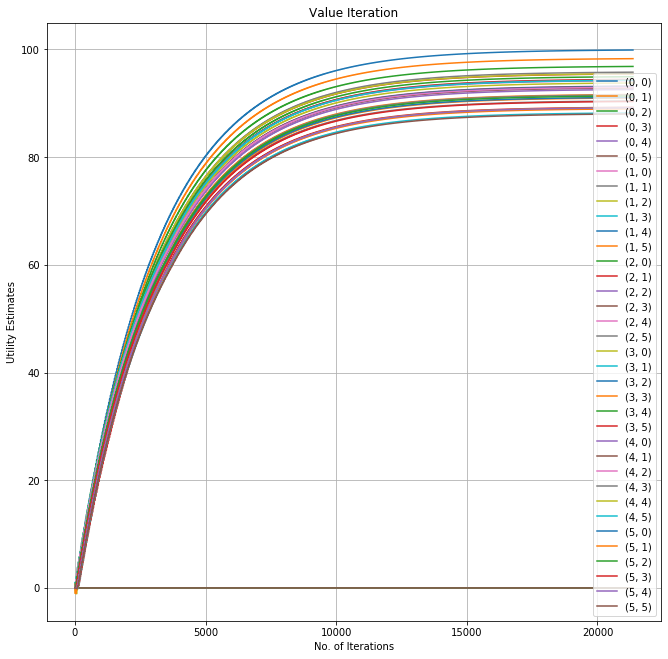

In [11]:
x = [i for i in range(num_iter)]

fig, ax = plt.subplots()
ax.plot(x, hist_0_0)
ax.plot(x, hist_0_1)
ax.plot(x, hist_0_2)
ax.plot(x, hist_0_3)
ax.plot(x, hist_0_4)
ax.plot(x, hist_0_5)

ax.plot(x, hist_1_0)
ax.plot(x, hist_1_1)
ax.plot(x, hist_1_2)
ax.plot(x, hist_1_3)
ax.plot(x, hist_1_4)
ax.plot(x, hist_1_5)

ax.plot(x, hist_2_0)
ax.plot(x, hist_2_1)
ax.plot(x, hist_2_2)
ax.plot(x, hist_2_3)
ax.plot(x, hist_2_4)
ax.plot(x, hist_2_5)

ax.plot(x, hist_3_0)
ax.plot(x, hist_3_1)
ax.plot(x, hist_3_2)
ax.plot(x, hist_3_3)
ax.plot(x, hist_3_4)
ax.plot(x, hist_3_5)

ax.plot(x, hist_4_0)
ax.plot(x, hist_4_1)
ax.plot(x, hist_4_2)
ax.plot(x, hist_4_3)
ax.plot(x, hist_4_4)
ax.plot(x, hist_4_5)

ax.plot(x, hist_5_0)
ax.plot(x, hist_5_1)
ax.plot(x, hist_5_2)
ax.plot(x, hist_5_3)
ax.plot(x, hist_5_4)
ax.plot(x, hist_5_5)

plt.legend(list_of_tuples, loc ="lower right")

ax.set(xlabel='No. of Iterations', ylabel='Utility Estimates', title='Value Iteration')
ax.grid()

fig.savefig("p2-e3-valueIter.png")
plt.show()

### Policy Iteration

In [12]:
SMALL_ENOUGH = 10e-4
GAMMA = 0.99
ALL_POSSIBLE_ACTIONS = ('U', 'D', 'L', 'R')

In [13]:
if __name__ == '__main__':
    
    grid = negative_grid()
    policy = {}
    
    for s in grid.actions.keys():
        policy[s] = np.random.choice(ALL_POSSIBLE_ACTIONS)
        
    hist = []
    
    V = {}
    states = grid.all_states()
    
    for s in states: 
        V[s] = 0
        
        if s in grid.actions:
            V[s] = 0
        
        else:
            V[s] = 0
            
    iter_no = 0
    
    while True:
        iter_no = iter_no + 1
        print("Iteration " + str(iter_no) + " :: ")
        
        # policy evaluation 
        while True:
            biggest_change = 0
            for s in states:
                old_v = V[s]
                
                if s in policy:
                    a = policy[s]
                    grid.set_state(s)
                    
                    try:
                        r = grid.move(a)
                    
                    except KeyError:
                        continue
                    
                    grid.set_state(s)
                    r = grid.rewards.get(grid.current_state(), 0)
                    _ = grid.move(a)
                    v_correct = V[grid.current_state()]
                    grid.set_state(s)
                    
                    if a == 'U':
                        r_clockwise = grid.move('R')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('L')
                    
                    elif a == 'R':
                        r_clockwise = grid.move('D')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('U')
                    
                    elif a == 'D':
                        r_clockwise = grid.move('L')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('R')
                    
                    elif a == 'L':
                        r_clockwise = grid.move('U')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('D')
                        
                    v_anticlockwise = V[grid.current_state()]
                    v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    V[s] = v
                    biggest_change = max(biggest_change, np.abs(old_v - V[s]))
                    
            if biggest_change < SMALL_ENOUGH:
                break
        
        print('Utilities:')
        print_values(True, V, grid)
        print('\n')
        
        #policy improvement
        is_policy_converged = True
        
        for s in states:
            
            if s in policy:
                old_a = policy[s]
                new_a = None
                best_value = float('-inf')
                
                for a in ALL_POSSIBLE_ACTIONS:
                    grid.set_state(s)
                    
                    try:
                        r = grid.move(a)
                        
                    except KeyError:
                        continue
                    
                    grid.set_state(s)
                    r = grid.rewards.get(grid.current_state(), 0)
                    _ = grid.move(a)
                    v_correct = V[grid.current_state()]
                    grid.set_state(s)
                    
                    if a == 'U':
                        r_clockwise = grid.move('R')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('L')
                    
                    elif a == 'R':
                        r_clockwise = grid.move('D')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('U')
                    
                    elif a == 'D':
                        r_clockwise = grid.move('L')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('R')
                    
                    elif a == 'L':
                        r_clockwise = grid.move('U')
                        v_clockwise = V[grid.current_state()]
                        grid.set_state(s)
                        r_anticlockwise = grid.move('D')
                        
                    v_anticlockwise = V[grid.current_state()]  
                    v = r + GAMMA * (0.8*v_correct + 0.1*v_clockwise + 0.1*v_anticlockwise)
                    
                    if v > best_value:
                        best_value = v
                        new_a = a
            
            policy[s] = new_a
            
            if new_a != old_a:
                is_policy_converged = False
        
        if is_policy_converged:
            break
            
    print('Optimal Utilities:')
    print_values(True, V, grid)
    print('\n')
    print('Optimal Policy:')
    print_policy(policy, grid)
    print('\n')

Iteration 1 :: 
Utilities:
+----------+------------+------------+------------+------------+------------+
 10.00279  |   0.00000  |  68.95980  |  68.06334  |  -19.92119 |  -20.12123 | 
+----------+------------+------------+------------+------------+------------+
  0.91223  |   0.23886  |  65.83432  |  68.17180  |   0.00000  |  -20.34969 | 
+----------+------------+------------+------------+------------+------------+
 -2.29533  |   4.97717  |  51.06389  |  58.46898  |  -5.43773  |  -12.52554 | 
+----------+------------+------------+------------+------------+------------+
 -3.18288  |   2.82651  |  -7.67983  |  -15.06915 |  -13.87137 |  -13.51816 | 
+----------+------------+------------+------------+------------+------------+
 -3.98890  |   0.00000  |   0.00000  |   0.00000  |  -13.71912 |  -12.64004 | 
+----------+------------+------------+------------+------------+------------+
 -3.98891  |  -3.98890  |  -3.98901  |  -13.35896 |  -13.47695 |  -12.61415 | 
+----------+------------+------

### Plot of utility estimates as a function of the number of iterations

In [14]:
num_iter = int(len(hist)/36)
print('Number of Iterations: ' + str(num_iter + 1))

Number of Iterations: 8


In [15]:
hist_0_0 = []
hist_0_1 = []
hist_0_2 = []
hist_0_3 = [] 
hist_0_4 = [] 
hist_0_5 = [] 

hist_1_0 = []
hist_1_1 = [] 
hist_1_2 = []
hist_1_3 = [] 
hist_1_4 = [] 
hist_1_5 = [] 

hist_2_0 = []
hist_2_1 = []
hist_2_2 = []
hist_2_3 = []
hist_2_4 = []
hist_2_5 = []

hist_3_0 = []
hist_3_1 = []
hist_3_2 = []
hist_3_3 = []
hist_3_4 = []
hist_3_5 = []

hist_4_0 = []
hist_4_1 = []
hist_4_2 = []
hist_4_3 = []
hist_4_4 = []
hist_4_5 = []

hist_5_0 = []
hist_5_1 = []
hist_5_2 = []
hist_5_3 = []
hist_5_4 = []
hist_5_5 = []

for i in range(num_iter):
    hist_0_0.append(hist[0+i*36])
    hist_1_0.append(hist[1+i*36])
    hist_2_0.append(hist[2+i*36])
    hist_3_0.append(hist[3+i*36]) 
    hist_4_0.append(hist[4+i*36])
    hist_5_0.append(hist[5+i*36]) 

    hist_0_1.append(hist[6+i*36])
    hist_1_1.append(hist[7+i*36]) 
    hist_2_1.append(hist[8+i*36]) 
    hist_3_1.append(hist[9+i*36]) 
    hist_4_1.append(hist[10+i*36]) 
    hist_5_1.append(hist[11+i*36]) 
    
    hist_0_2.append(hist[12+i*36])
    hist_1_2.append(hist[13+i*36]) 
    hist_2_2.append(hist[14+i*36])
    hist_3_2.append(hist[15+i*36])
    hist_4_2.append(hist[16+i*36])
    hist_5_2.append(hist[17+i*36])
    
    hist_0_3.append(hist[18+i*36])
    hist_1_3.append(hist[19+i*36]) 
    hist_2_3.append(hist[20+i*36])
    hist_3_3.append(hist[21+i*36])
    hist_4_3.append(hist[22+i*36])
    hist_5_3.append(hist[23+i*36])
    
    hist_0_4.append(hist[24+i*36])
    hist_1_4.append(hist[25+i*36]) 
    hist_2_4.append(hist[26+i*36])
    hist_3_4.append(hist[27+i*36])
    hist_4_4.append(hist[28+i*36])
    hist_5_4.append(hist[29+i*36])
    
    hist_0_5.append(hist[30+i*36])
    hist_1_5.append(hist[31+i*36]) 
    hist_2_5.append(hist[32+i*36])
    hist_3_5.append(hist[33+i*36])
    hist_4_5.append(hist[34+i*36])
    hist_5_5.append(hist[35+i*36])

In [16]:
list_of_tuples = [str((i,j)) for i in range(6) for j in range (6)]

In [17]:
from matplotlib.pyplot import figure

plt.rcParams["figure.figsize"]=11,11

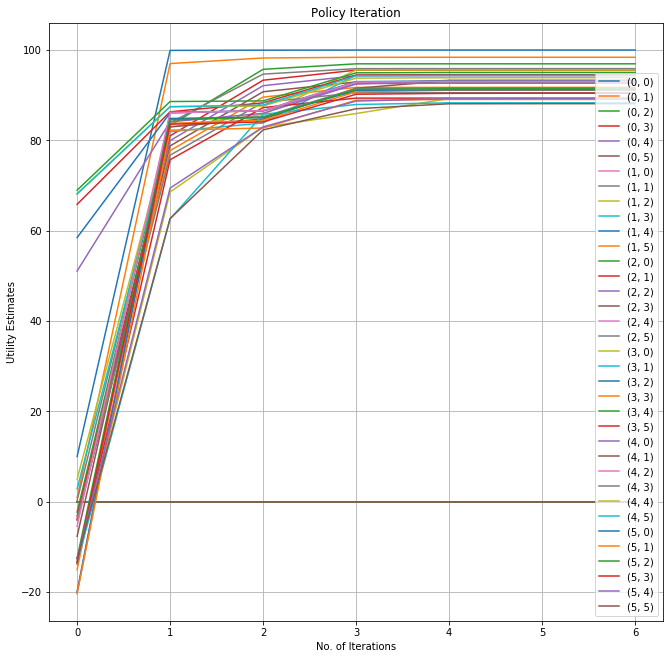

In [18]:
x = [i for i in range(num_iter)]

fig, ax = plt.subplots()
ax.plot(x, hist_0_0)
ax.plot(x, hist_0_1)
ax.plot(x, hist_0_2)
ax.plot(x, hist_0_3)
ax.plot(x, hist_0_4)
ax.plot(x, hist_0_5)

ax.plot(x, hist_1_0)
ax.plot(x, hist_1_1)
ax.plot(x, hist_1_2)
ax.plot(x, hist_1_3)
ax.plot(x, hist_1_4)
ax.plot(x, hist_1_5)

ax.plot(x, hist_2_0)
ax.plot(x, hist_2_1)
ax.plot(x, hist_2_2)
ax.plot(x, hist_2_3)
ax.plot(x, hist_2_4)
ax.plot(x, hist_2_5)

ax.plot(x, hist_3_0)
ax.plot(x, hist_3_1)
ax.plot(x, hist_3_2)
ax.plot(x, hist_3_3)
ax.plot(x, hist_3_4)
ax.plot(x, hist_3_5)

ax.plot(x, hist_4_0)
ax.plot(x, hist_4_1)
ax.plot(x, hist_4_2)
ax.plot(x, hist_4_3)
ax.plot(x, hist_4_4)
ax.plot(x, hist_4_5)

ax.plot(x, hist_5_0)
ax.plot(x, hist_5_1)
ax.plot(x, hist_5_2)
ax.plot(x, hist_5_3)
ax.plot(x, hist_5_4)
ax.plot(x, hist_5_5)

plt.legend(list_of_tuples, loc ="lower right")

ax.set(xlabel='No. of Iterations', ylabel='Utility Estimates', title='Policy Iteration')
ax.grid()

fig.savefig("p2-e3-policyIter.png")
plt.show()